# **LITHOLOGY CLASSIFICATION BY USING ML AND DL METHODS**

## **IMPORTING LIBRARIES**

In [ ]:
import numpy as np
import pandas as pd
import seaborn as sns
import pickle
import matplotlib.pyplot as plt
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go

from google.colab import drive   #Getting access to Google Drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#Setting format for dataframes
pd.set_option('display.float_format', lambda x: '%.2f' % x)

## **1. LOADING DATA**

### Training Data

In [ ]:
traindata_path = '/content/drive/MyDrive/Thesis_data/train.csv'
labeled_data = pd.read_csv(traindata_path, sep=';')
labeled_data = labeled_data.rename(columns={'FORCE_2020_LITHOFACIES_LITHOLOGY':'LITHO', 'FORCE_2020_LITHOFACIES_CONFIDENCE':'LIT_CONF'})
#labeled_data = labeled_data[labeled_data['LIT_CONF'] == 1]
labeled_data = labeled_data.drop(['LIT_CONF'], axis=1)
#labeled_data.head()

In [ ]:
#Changing the lithology labels to a range from 0 10 11
# KEYS: 0:Sandstone, 1:Sandstone/Shale, 2:Shale, 3:Marl, 4:Dolomite, 5:Limestone
# 6:Chalk, 7:Halite, 8:Anhydrite, 9:Tuff, 10:Coal, 11:Basement

lithology_numbers = {30000: 0, 65030: 1, 65000: 2, 80000: 3, 74000: 4, 70000: 5, 70032: 6,
                88000: 7, 86000: 8, 99000: 9, 90000: 10, 93000: 11}

labeled_data['LITHO'] = labeled_data["LITHO"].map(lithology_numbers)
#display(labeled_data.head(10))

### Test Data

In [ ]:
## Test Data
testdata_path = '/content/drive/MyDrive/Thesis_data/test.csv'
testlabels_path = '/content/drive/MyDrive/Thesis_data/test_target.csv'

unlabeled_data = pd.read_csv(testdata_path, sep=';')
labels = pd.read_csv(testlabels_path, sep=';')
#display(unlabeled_data.head())

In [ ]:
## Merging test features and labels
test_data = pd.merge(unlabeled_data, labels, on=['WELL', 'DEPTH_MD'])
test_data = test_data.rename(columns={'FORCE_2020_LITHOFACIES_LITHOLOGY':'LITHO'})
test_data['LITHO'] = test_data["LITHO"].map(lithology_numbers)
#display(test_data.head())

### Hidden Data

In [ ]:
## Test Data
hiddendata_path = '/content/drive/MyDrive/Thesis_data/hidden_test.csv'

hidden_data = pd.read_csv(hiddendata_path, sep=';')
hidden_data = hidden_data.rename(columns={'FORCE_2020_LITHOFACIES_LITHOLOGY':'LITHO'})
hidden_data = hidden_data.drop(['FORCE_2020_LITHOFACIES_CONFIDENCE'], axis=1)

#Mapping lithology numbers
hidden_data['LITHO'] = hidden_data['LITHO'].map(lithology_numbers)

#display(hidden_data.head())

In [ ]:
print('Train data contains: {} data points'.format(labeled_data.shape))
print('Test data contains: {} data points'.format(test_data.shape))
print('Hidden data contains: {} data points'.format(hidden_data.shape))

#print(raw_data.columns, raw_tets_data.columns)

Train data contains: (1170511, 28) data points
Test data contains: (136786, 28) data points
Hidden data contains: (122397, 28) data points


In [ ]:
#labeled_data = labeled_data[-((labeled_data.RSHA > 60) | (labeled_data.RMED > 100) |  (labeled_data.RDEP > 250))]
#test_data = test_data[-((test_data.RSHA > 60) | (test_data.RMED > 100) |  (test_data.RDEP > 250))]
#hidden_data = hidden_data[-((hidden_data.RSHA > 60) | (hidden_data.RMED > 100) |  (hidden_data.RDEP > 250))]

## **2. DATA DESCRIPTION AND FIRST INSPECTION**

### A. Data Description

There is a total of **98 wells in the training dataset and 10 wells in the test dataset**. The `WELL` column is included so the data can be separated by well. This will be necessary for any "windowed" approaches where we use non-local information in the ML features. 

The data contains the metadata columns
* WELL: well name
* DEPTH_MD: measured depth
* X_LOC: UTM X coordinate 
* Y_LOC: UTM Y coordinate
* Z_LOC: DEPTH
* GROUP: NPD lithostratigraphy group
* FORMATION: NPD lithostratgraphy formation

The data contains the well log curves. For example the following:
* BS: Bit Size
* CALI: Caliper
* RDEP: Deep Resistivity
* RHOB: Bulk Density
* GR: Raw gamma data
* SGR: Spectral Gamma Ray
* RMED: Medium Resistivity
* ROP: Rate of Penetration
* NPHI: Neutron Porosity
* PEF: Photoelectric Absorption Factor
* RSHA: Shallow Resistivity
* DTS: Sonic (Sheer Slowness)
* DTC: Sonic (Compressional Slowness)

See contest page for full list.

as well as the interpretation

* LITHO: lithology class label
* LIT_CONF: confidence in lithology interpretation (1: high, 2: medium, 3: low)

### B. Wells Inluded - Training Dataset

In [ ]:
#Inspecting wells available in the dataset
labeled_wells = labeled_data['WELL'].unique()
print(labeled_wells)

['15/9-13' '15/9-15' '15/9-17' '16/1-2' '16/1-6 A' '16/10-1' '16/10-2'
 '16/10-3' '16/10-5' '16/11-1 ST3' '16/2-11 A' '16/2-16' '16/2-6' '16/4-1'
 '16/5-3' '16/7-4' '16/7-5' '16/8-1' '17/11-1' '25/11-15' '25/11-19 S'
 '25/11-5' '25/2-13 T4' '25/2-14' '25/2-7' '25/3-1' '25/4-5' '25/5-1'
 '25/5-4' '25/6-1' '25/6-2' '25/6-3' '25/7-2' '25/8-5 S' '25/8-7' '25/9-1'
 '26/4-1' '29/6-1' '30/3-3' '30/3-5 S' '30/6-5' '31/2-1' '31/2-19 S'
 '31/2-7' '31/2-8' '31/2-9' '31/3-1' '31/3-2' '31/3-3' '31/3-4' '31/4-10'
 '31/4-5' '31/5-4 S' '31/6-5' '31/6-8' '32/2-1' '33/5-2' '33/6-3 S'
 '33/9-1' '33/9-17' '34/10-19' '34/10-21' '34/10-33' '34/10-35' '34/11-1'
 '34/11-2 S' '34/12-1' '34/2-4' '34/3-1 A' '34/4-10 R' '34/5-1 A'
 '34/5-1 S' '34/7-13' '34/7-20' '34/7-21' '34/8-1' '34/8-3' '34/8-7 R'
 '35/11-1' '35/11-10' '35/11-11' '35/11-12' '35/11-13' '35/11-15 S'
 '35/11-6' '35/11-7' '35/12-1' '35/3-7 S' '35/4-1' '35/8-4' '35/8-6 S'
 '35/9-10 S' '35/9-2' '35/9-5' '35/9-6 S' '36/7-3' '7/1-1' '7/1-2 S']


In [ ]:
#Number of wells contained in the train dataset
print("The data contains {} wells".format(len(labeled_wells)))

The data contains 98 wells


### C. Wells Inluded - Unlabeled Dataset

In [ ]:
#Inspecting wells available in the dataset
test_wells = test_data['WELL'].unique()
print(test_wells)

['15/9-14' '25/10-10' '25/11-24' '25/5-3' '29/3-1' '34/10-16 R' '34/3-3 A'
 '34/6-1 S' '35/6-2 S' '35/9-8']


In [ ]:
#Number of wells contained in the test dataset
print("The data contains {} wells".format(len(test_wells)))

The data contains 10 wells


### D. Wells Inluded - Hidden Dataset

In [ ]:
hidden_wells = hidden_data['WELL'].unique()
hidden_wells

array(['15/9-23', '16/2-7', '16/7-6', '17/4-1', '25/10-9', '31/2-10',
       '31/2-21 S', '34/3-2 S', '35/11-5', '35/9-7'], dtype=object)

In [ ]:
#Number of wells contained in the test dataset
print("The data contains {} wells".format(len(hidden_wells)))

The data contains 10 wells


### E. Visualizing well locations

Reference: https://github.com/brendonhall/FORCE-2020-Lithology/blob/master/notebooks/02-Map-View.ipynb

In [ ]:
#Visualizing Wells Location

well_names = np.concatenate((labeled_wells, test_wells, hidden_wells))
well_names_df = pd.DataFrame({'WELL':well_names})
#well_names_df

#NPD metadata containing important information for the wells
well_meta_csv = '/content/drive/MyDrive/Thesis_data/wellbore_exploration_all.csv'
well_meta_df = pd.read_csv(well_meta_csv)

#Rename columns of interest
well_meta_df.rename(columns={'wlbWellboreName': 'WELL',
                             'wlbWell': 'WELL_HEAD',
                            'wlbNsDecDeg': 'lat',
                            'wlbEwDesDeg': 'lon',
                            'wlbDrillingOperator': 'Drilling_Operator',
                            'wlbPurposePlanned': 'Purpose',
                            'wlbCompletionYear': 'Completion_Year',
                            'wlbFormationAtTd': 'Formation'}, inplace=True)

# get df of WELL_HEAD and the lat long
well_locations_df = well_meta_df[['WELL_HEAD', 'lat', 'lon']].drop_duplicates(subset=['WELL_HEAD'])

# we only need a few of the columns for the map plot
well_meta_df = well_meta_df[['WELL', 'Drilling_Operator', 'Purpose', 'Completion_Year', 'Formation']]

def base_well_name(row):
    well_name = row['WELL']
    return well_name.split()[0]

# apply the function to extract the WELL_HEAD base name from the well
well_names_df['WELL_HEAD'] = well_names_df.apply(lambda row: base_well_name(row), axis=1)

# merge with location data to get lat/lon
locations_df = well_names_df.merge(well_locations_df, how='inner', on='WELL_HEAD')
# merge with the meta data to get other data
locations_df = locations_df.merge(well_meta_df, how='left', on='WELL')

#Labeling train and test wells
locations_df.loc[locations_df['WELL'].isin(labeled_wells), 'Dataset'] = 'Train'
locations_df.loc[locations_df['WELL'].isin(test_wells), 'Dataset'] = 'Test'
locations_df.loc[locations_df['WELL'].isin(hidden_wells), 'Dataset'] = 'Hidden'

In [ ]:
#Visualization
import plotly.express as px
fig = px.scatter_mapbox(locations_df, lat="lat", lon="lon",
                        color='Dataset', 
                        zoom=5, height=600
                        )

fig.update_layout(mapbox_style="open-street-map" )
fig.update_layout(margin={"r":300,"t":10,"l":10,"b":50})
fig.show()

### F. Labels Distributions

In [ ]:
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

train_label_dict = dict(labeled_data['LITHO'].map(lithology_numbers2).value_counts())
train_label_counts = {key:np.round(value*100/labeled_data['LITHO'].count(), 1) for key, value in train_label_dict.items()}

test_label_dict = dict(test_data['LITHO'].map(lithology_numbers2).value_counts())
test_label_counts = {key:np.round(value*100/test_data['LITHO'].count(), 1) for key, value in test_label_dict.items()}

hidden_label_dict = dict(hidden_data['LITHO'].map(lithology_numbers2).value_counts())
hidden_label_counts = {key:np.round(value*100/hidden_data['LITHO'].count(), 1) for key, value in hidden_label_dict.items()}

total_conts = {'TRAIN':train_label_counts,
               'TEST':test_label_counts,
               'HIDDEN': hidden_label_counts}

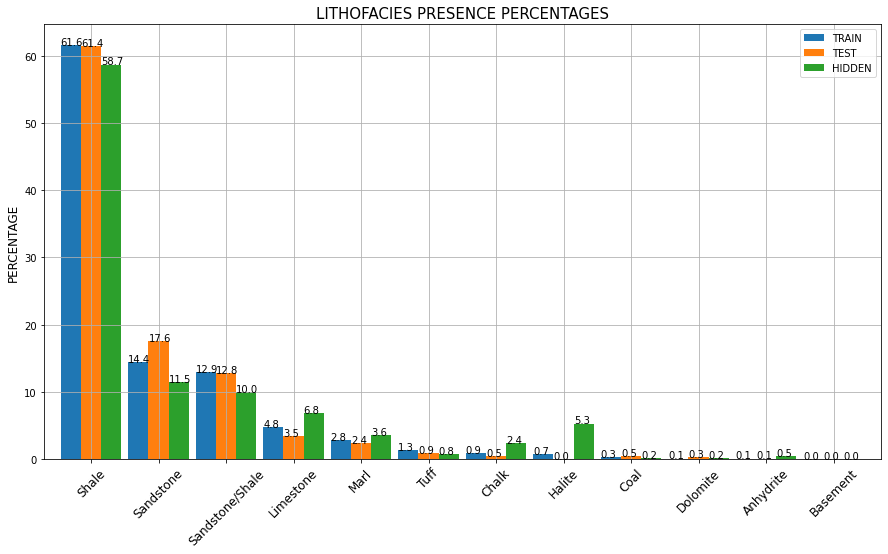

In [ ]:
ax = pd.DataFrame(total_conts).plot(kind='bar', figsize=(15,8), legend=True, width=0.9)
ax.set_title('LITHOFACIES PRESENCE PERCENTAGES', size=15)
ax.set_ylabel('PERCENTAGE', size=12)
plt.xticks(size=12, rotation=45, )
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.grid(True)
plt.show()


### G. Features Percentages in Datasets

#### Features - TRAINING DATASETS

**Notice that some of the curves are NaN. This is an imporant aspect of this dataset and of this competition.** The only log columns that are **guaranteed** to be present are WELL, DEPT, and GR. All other logs can (and will) be missing from some parts of the dataset.

In [ ]:
#labeled_data.isna().any()
#labeled_data.isna().sum()

The following plot shows how large a percentage of training data wells contain at least some depth interval with the given logs. As you can see a couple of logs like RT and DTS are present in less than half of the training wells. **Remember, the test data will have a similar distribution of available logs**

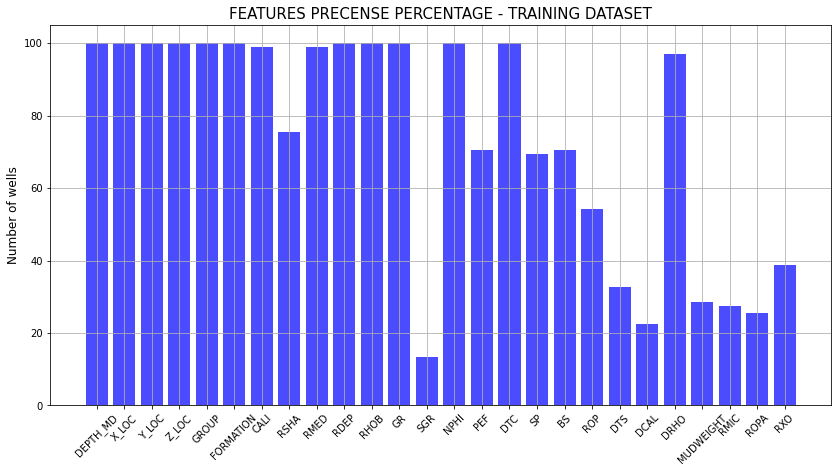

In [ ]:
occurences = np.zeros(26)
for well in labeled_data['WELL'].unique():
    occurences += labeled_data[labeled_data['WELL'] == well].isna().all().astype(int).values[1:-1]
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(occurences.shape[0]), height=(labeled_data.WELL.unique().shape[0]-occurences)/labeled_data.WELL.unique().shape[0]*100.0, color='b', alpha=0.7)
ax.set_xticklabels(labeled_data.columns[1:-1], rotation=45)
ax.set_xticks(np.arange(occurences.shape[0]))
ax.set_ylabel('Number of wells', size=12)
ax.set_title("FEATURES PRECENSE PERCENTAGE - TRAINING DATASET", size=15)
ax.grid()

#### Features - TEST DATASETS

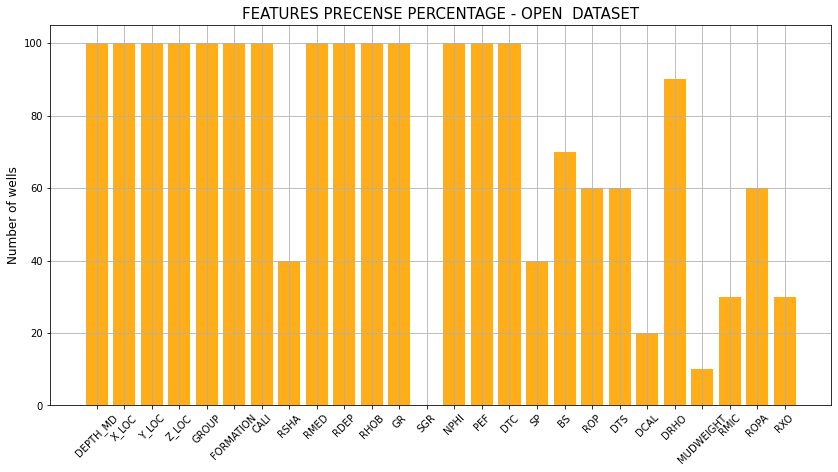

In [ ]:
occurences = np.zeros(26)
for well in test_data['WELL'].unique():
    occurences += test_data[test_data['WELL'] == well].isna().all().astype(int).values[1:-1]
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(occurences.shape[0]), height=(test_data.WELL.unique().shape[0]-occurences)/test_data.WELL.unique().shape[0]*100.0, color='orange', alpha=0.9)
ax.set_xticklabels(test_data.columns[1:-1], rotation=45)
ax.set_xticks(np.arange(occurences.shape[0]))
ax.set_ylabel('Number of wells', size=12)
ax.set_title("FEATURES PRECENSE PERCENTAGE - OPEN  DATASET", size=15)
ax.grid()

#### Features - HIDDEN DATASETS

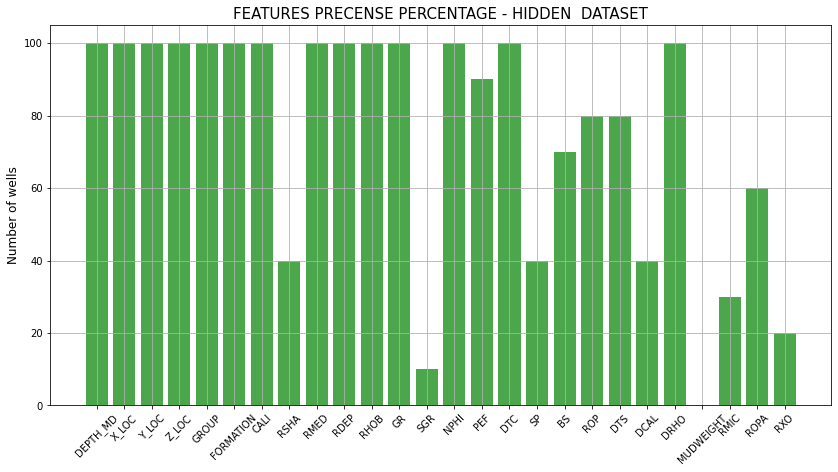

In [ ]:
occurences = np.zeros(26)
for well in hidden_data['WELL'].unique():
    occurences += hidden_data[hidden_data['WELL'] == well].isna().all().astype(int).values[1:-1]
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(occurences.shape[0]), height=(hidden_data.WELL.unique().shape[0]-occurences)/hidden_data.WELL.unique().shape[0]*100.0, color='green', alpha=0.7)
ax.set_xticklabels(hidden_data.columns[1:-1], rotation=45)
ax.set_xticks(np.arange(occurences.shape[0]))
ax.set_ylabel('Number of wells', size=12)
ax.set_title("FEATURES PRECENSE PERCENTAGE - HIDDEN  DATASET", size=15)
ax.grid()

### H. Misssing Values Visualization

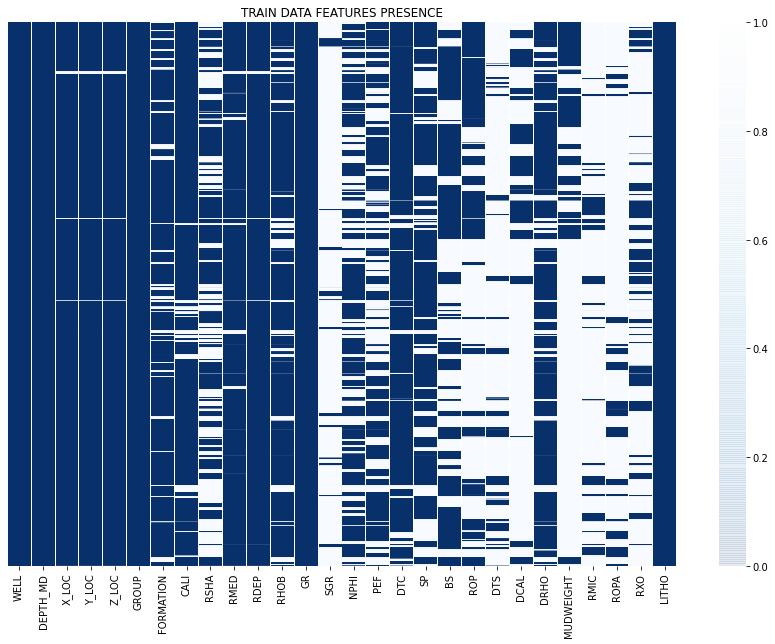

In [ ]:
#Missing values in labeled dataset
plt.subplots(figsize=(15,10))
plt.title('TRAIN DATA FEATURES PRESENCE')
sns.heatmap(labeled_data.isnull(), yticklabels=False, cmap='Blues_r', linecolor='black', alpha=0.1)

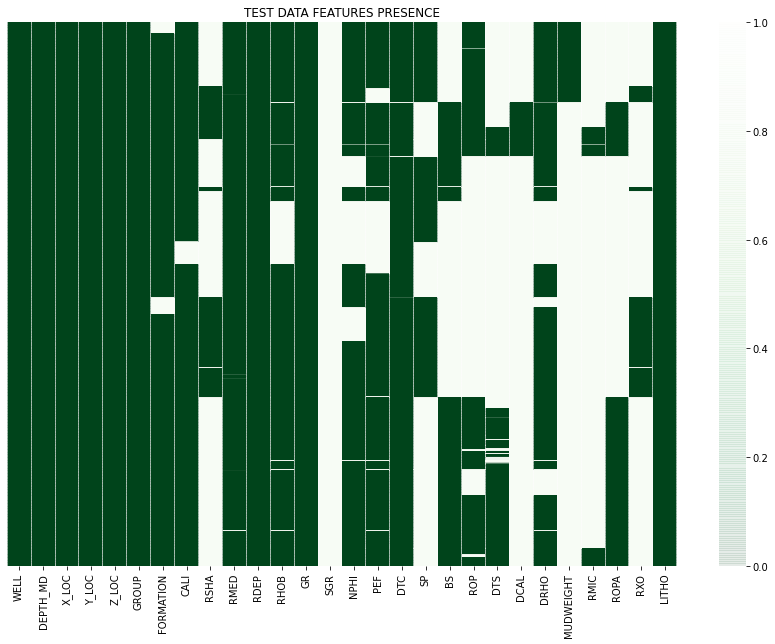

In [ ]:
#Missing values in labeled dataset
plt.subplots(figsize=(15,10))
plt.title('TEST DATA FEATURES PRESENCE')
sns.heatmap(test_data.isnull(), yticklabels=False, cmap='Greens_r', linecolor='black', alpha=0.1)

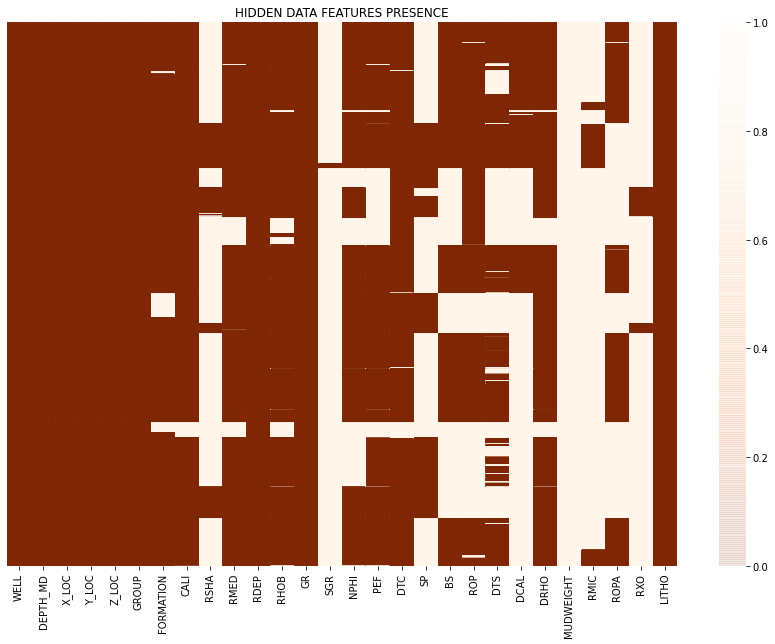

In [ ]:
#Missing values in labeled dataset
plt.subplots(figsize=(15,10))
plt.title('HIDDEN DATA FEATURES PRESENCE')
sns.heatmap(hidden_data.isnull(), yticklabels=False, cmap='Oranges_r', linecolor='black', alpha=0.1)

## **3. DATA ANALYSIS AND STATISTICS OVERVIEW**

### Sampling Raw Data for Visualization

In [ ]:
#Sampling data for statistical visualization
#data_sample = labeled_data.sample(n=150000, replace=False)      #Sampling raw_data for visualization
#Stratified Sample
x_sample, x_train_start2, y_sample, y_train_strat2 = train_test_split(labeled_data.drop(['LITHO'], axis=1), labeled_data['LITHO'], train_size=0.1, shuffle=True, stratify=labeled_data.LITHO)

In [ ]:
data_sample = pd.concat([x_sample, y_sample], axis=1)
#data_sample

### Pairplotting Sampled Raw-Data 

In [ ]:
data_sample.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR', 'NPHI', 'PEF',
       'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO', 'MUDWEIGHT', 'RMIC',
       'ROPA', 'RXO', 'LITHO'],
      dtype='object')

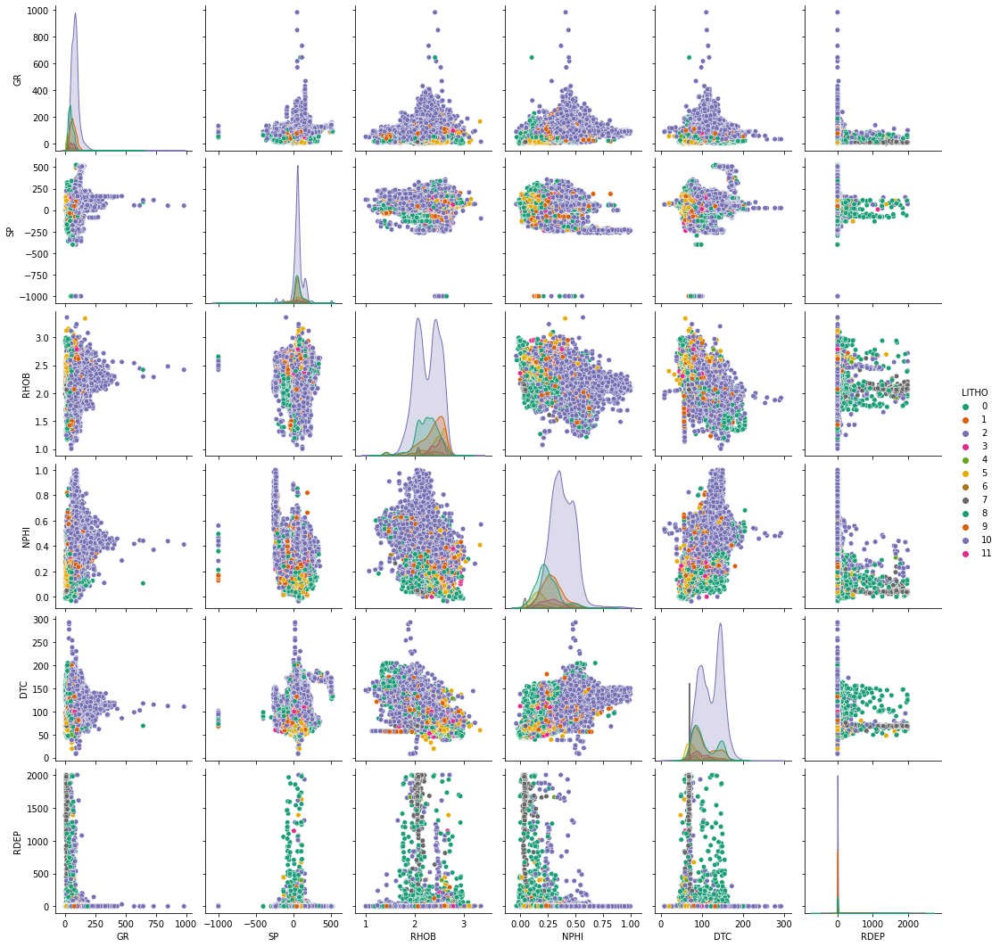

In [ ]:
#Creating a pair plot to analize data distibutions - ALL FEATURES
import seaborn as sns


sns.pairplot(data_sample, vars=['GR', 'SP', 'RHOB', 'NPHI', 'DTC', 'RDEP'], palette='Dark2', 
             hue='LITHO', diag_kind='kde', plot_kws = {'alpha': 1, 's': 30, 'marker':'o'})

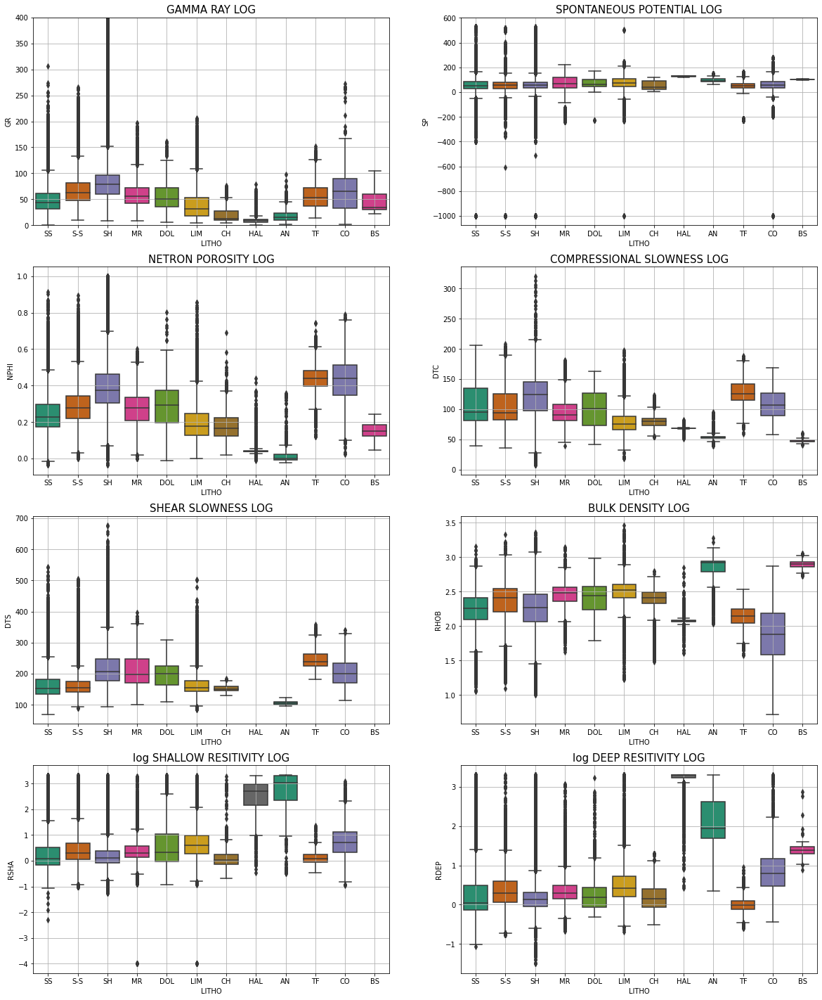

In [ ]:
plt.figure(figsize=(20,25))

plt.subplot(4,2,1)
sns.boxplot(y='GR', x='LITHO',data=labeled_data, palette='Dark2')
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('GAMMA RAY LOG', size=15)
plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,2)
sns.boxplot(y='SP', x='LITHO',data=labeled_data, palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('SPONTANEOUS POTENTIAL LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,3)
sns.boxplot(y='NPHI', x='LITHO',data=labeled_data, palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('NETRON POROSITY LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,4)
sns.boxplot(y='DTC', x='LITHO',data=labeled_data, palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('COMPRESSIONAL SLOWNESS LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,5)
sns.boxplot(y='DTS', x='LITHO',data=labeled_data, palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('SHEAR SLOWNESS LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,6)
sns.boxplot(y='RHOB', x='LITHO',data=labeled_data, palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('BULK DENSITY LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(4,2,7)
sns.boxplot(y=np.log10(labeled_data['RSHA']), x=labeled_data['LITHO'], palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('log SHALLOW RESITIVITY LOG', size=15)
#plt.ylim(0, 50)
plt.grid()

plt.subplot(4,2,8)
sns.boxplot(y=np.log10(labeled_data['RDEP']), x=labeled_data['LITHO'], palette='Dark2' )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('log DEEP RESITIVITY LOG', size=15)
#plt.ylim(0, 50)
plt.grid()

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:726: RuntimeWarning:

invalid value encountered in log10



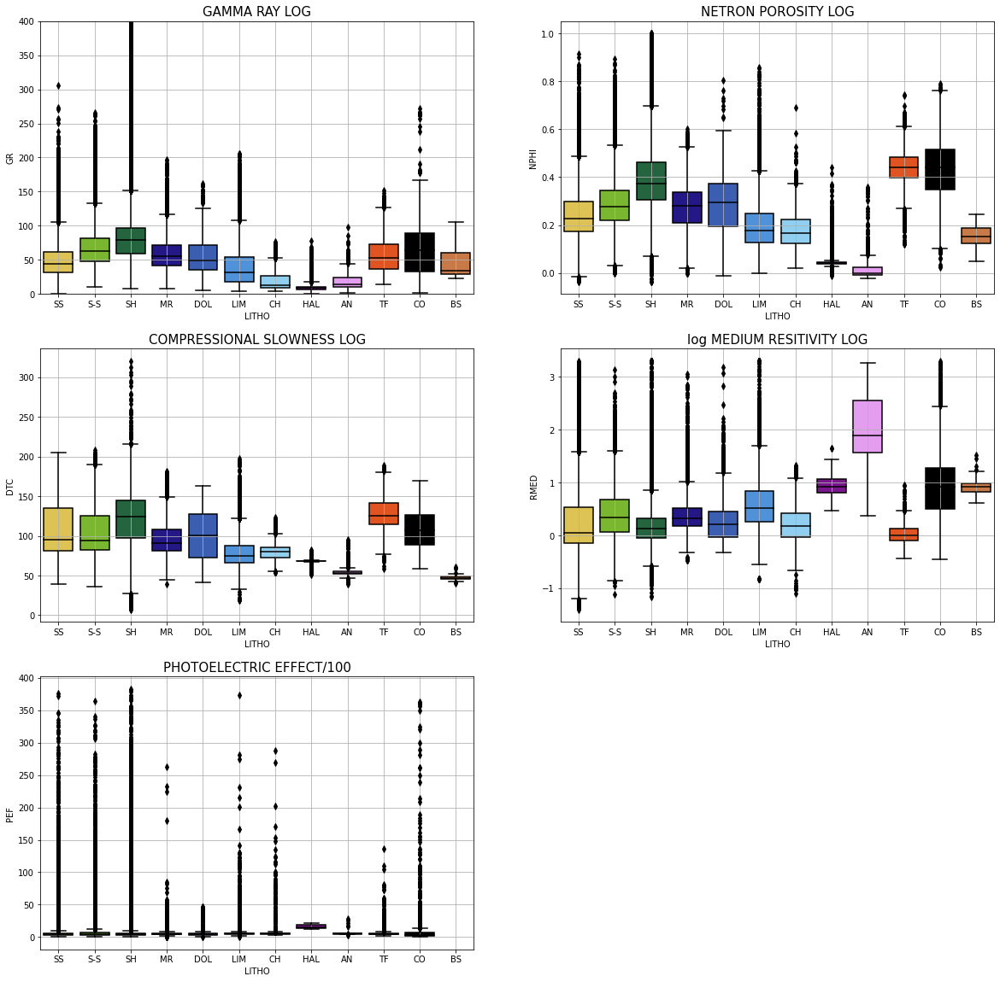

In [ ]:
plt.figure(figsize=(20,20))

plt.subplot(3,2,1)
sns.boxplot(y='GR', x='LITHO',data=labeled_data, palette=facies_colors )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('GAMMA RAY LOG', size=15)
plt.ylim(0, 400)
plt.grid()

plt.subplot(3,2,2)
sns.boxplot(y='NPHI', x='LITHO',data=labeled_data, palette=facies_colors )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('NETRON POROSITY LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(3,2,3)
sns.boxplot(y='DTC', x='LITHO',data=labeled_data, palette=facies_colors )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('COMPRESSIONAL SLOWNESS LOG', size=15)
#plt.ylim(0, 400)
plt.grid()

plt.subplot(3,2,5)
sns.boxplot(y=labeled_data['PEF'], x=labeled_data['LITHO'], palette=facies_colors )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('PHOTOELECTRIC EFFECT/100', size=15)
#plt.ylim(0, 50)
plt.grid()

plt.subplot(3,2,4)
sns.boxplot(y=np.log10(labeled_data['RMED']), x=labeled_data['LITHO'], palette=facies_colors )
plt.xticks(np.sort(labeled_data.LITHO.unique()), facies_labels)
plt.title('log MEDIUM RESITIVITY LOG', size=15)
#plt.ylim(0, 50)
plt.grid()



### Spearman's Correlation Raw-Data

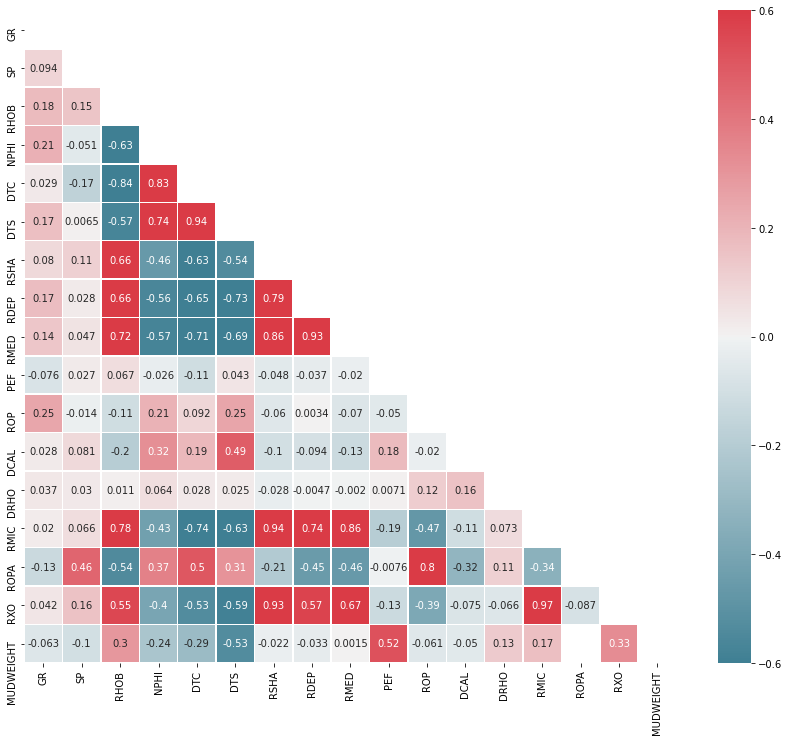

In [ ]:
well_train_only_features = labeled_data[['GR', 'SP', 'RHOB', 'NPHI', 'DTC', 'DTS', 'RSHA', 'RDEP', 'RMED', 'PEF', 'ROP', 'DCAL', 'DRHO', 'RMIC', 'ROPA', 'RXO', 'MUDWEIGHT']]

# Generate a mask for the upper triangle
mask = np.zeros_like(well_train_only_features.corr(method = 'spearman') , dtype=np.bool)
mask[np.triu_indices_from(mask)] = True

# Generate a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# Draw the heatmap with the mask and correct aspect ratio
plt.figure(figsize=(15,12))
sns.heatmap(well_train_only_features.corr(method = 'spearman') ,annot=True,  mask=mask, cmap=cmap, vmax=0.6, vmin=-0.6, square=True, linewidths=.5)
plt.show()

## **4. UTILITY FUNCTIONS**

### A1. Raw Data Plotting Function

In [ ]:
facies_colors = ['#F4D03F','#7ccc19','#196F3D','#160599','#2756c4','#3891f0','#80d4ff','#87039e','#ec90fc','#FF4500','#000000','#DC7633']
facies_labels = ['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']

#Facies_color_map
facies_color_map = {}
for ind, label in enumerate(facies_labels):
    facies_color_map[label] = facies_colors[ind]

In [ ]:
#Facies log Fuction
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

def facies_log(logs, well_num, facies_colors):
    wells = logs['WELL'].unique()
    logs = logs[logs['WELL'] == wells[well_num]]
    logs = logs.sort_values(by='DEPTH_MD')        #Sorting log by depth
    cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
    
    top = logs.DEPTH_MD.min()
    bot = logs.DEPTH_MD.max()
    
    real_label = np.repeat(np.expand_dims(logs['LITHO'].values, 1), 100, 1)

    f, ax = plt.subplots(nrows=1, ncols=17, figsize=(20, 12))
    log_colors = ['black', 'red', 'blue', 'green', 'purple','black', 'red', 'blue', 'green', 'purple', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black']

    for i in range(7,23):
      ax[i-7].plot(logs.iloc[:,i], logs.DEPTH_MD, color=log_colors[i])
      ax[i-7].set_ylim(top, bot)
      #ax[i-7].set_xlim(logs.iloc[:,i].min(), logs.iloc[:,i].max())

      ax[i-7].set_xlabel(str(logs.columns[i]))
      ax[i-7].invert_yaxis()
      ax[i-7].grid()

    im = ax[-1].imshow(real_label, interpolation='none', aspect='auto', cmap=cmap_facies, vmin=0, vmax=12)
    ax[-1].set_xlabel('LITHO')

    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']))
    
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
        
    f.suptitle('WELL LOGS '+str(wells[well_num]), fontsize=16,y=0.9)

In [ ]:
#Uncomment to plot
#facies_log(hidden_data, 3, facies_colors)

### A2. Plotting Predicted Logs Function

In [ ]:
#Facies log Fuction
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

def plot_predicted_logs(logs, well_num, facies_colors):
    wells = logs['WELL'].unique()
    logs = logs[logs['WELL'] == wells[well_num]]
    logs = logs.sort_values(by='DEPTH_MD')        #Sorting log by depth
    cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
    
    top = logs.DEPTH_MD.min()
    bot = logs.DEPTH_MD.max()
    
    real_label = np.repeat(np.expand_dims(logs['LITHO'].values, 1), 100, 1)

    f, ax = plt.subplots(nrows=1, ncols=13, figsize=(22, 12))
    log_colors = ['black', 'red', 'blue', 'green', 'purple','black', 'red', 'blue', 'green', 'purple', 
                  'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 
                  'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black']

    for i in range(3,15):
      ax[i-3].plot(logs.iloc[:,i], logs.DEPTH_MD, color=log_colors[i], linewidth=0.9)
      ax[i-3].set_ylim(top, bot)
      #ax[i-3].set_xlim(logs.iloc[:,i].min(), logs.iloc[:,i].max())

      ax[i-3].set_xlabel(str(logs.columns[i]))
      ax[i-3].invert_yaxis()
      ax[i-3].grid()

    im = ax[-1].imshow(real_label, interpolation='none', aspect='auto', cmap=cmap_facies, vmin=0, vmax=12)
    ax[-1].set_xlabel('LITHO')

    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']))
    
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
        
    f.suptitle('WELL LOGS '+str(wells[well_num]), fontsize=16,y=0.9)

### A3. Augmented Log Plotting Function

In [ ]:
#Facies log Fuction
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

def pred_log(logs, well_num, facies_colors, n_pred):
    wells = logs['WELL'].unique()
    logs = logs[logs['WELL'] == wells[well_num]]
    logs = logs.sort_values(by='DEPTH_MD')        #Sorting log by depth
    cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
    
    top = logs.DEPTH_MD.min()
    bot = logs.DEPTH_MD.max()
       
    f, ax = plt.subplots(nrows=1, ncols=(12+n_pred), figsize=(20, 12))
    log_colors = ['black', 'red', 'blue', 'green', 'purple','black', 'red', 'blue', 'green', 'purple', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black']

    for i in range(7,18):
      ax[i-7].plot(logs.iloc[:,i], logs.DEPTH_MD, color=log_colors[i])
      ax[i-7].set_ylim(top, bot)
      #ax[i-7].set_xlim(logs.iloc[:,i].min(), logs.iloc[:,i].max())

      ax[i-7].set_xlabel(str(logs.columns[i]))
      ax[i-7].invert_yaxis()
      ax[i-7].grid()

    for j in range((-1-n_pred), 0):
      label = np.repeat(np.expand_dims(logs.iloc[:,j].values, 1), 100, 0)
      im = ax[j].imshow(label, interpolation='none', aspect='auto', cmap=cmap_facies, vmin=0, vmax=12)
      ax[j].set_xlabel(str(logs.columns[j]))

    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']))
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
        
    f.suptitle('WELL LOGS '+str(wells[well_num]), fontsize=14,y=0.94)

In [ ]:
#Uncomment for plotting
#pred_log(labeled_data, 0, facies_colors)

### A4. Combined Pedictions Plotting Function

In [ ]:
#Facies log for all predictions
import matplotlib.colors as colors
from mpl_toolkits.axes_grid1 import make_axes_locatable

def all_models_plot(logs, well_num, facies_colors, n_pred):
    wells = logs['WELL'].unique()
    logs = logs[logs['WELL'] == wells[well_num]]
    logs = logs.sort_values(by='DEPTH_MD')        #Sorting log by depth
    cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
    
    top = logs.DEPTH_MD.min()
    bot = logs.DEPTH_MD.max()

    f, ax = plt.subplots(nrows=1, ncols=(8+n_pred), figsize=(20, 12))
    log_colors = ['black', 'red', 'blue', 'green', 'purple','black', 'red', 'blue', 'green', 'purple', 
                  'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green',
                  'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black']

    for i in range(2,9):
      ax[i-2].plot(logs.iloc[:,i], logs.DEPTH_MD, color=log_colors[i])
      ax[i-2].set_ylim(top, bot)
      #ax[i-2].set_xlim(logs.iloc[:,i].min(), logs.iloc[:,i].max())

      ax[i-2].set_xlabel(str(logs.columns[i]))
      ax[i-2].invert_yaxis()
      ax[i-2].grid()

    for j in range((-1-n_pred), 0):
      real_label = np.repeat(np.expand_dims(logs.iloc[:, j].values, 1), 100, 0)
      im = ax[j].imshow(real_label, interpolation='none', aspect='auto', cmap=cmap_facies, vmin=0, vmax=12)
      ax[j].set_xlabel(logs.columns[j])

    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']))
    
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
        
    f.suptitle('WELL LOGS '+str(wells[well_num]), fontsize=16,y=0.9)

### A4. Normalized Confusion Matrix Function

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics._plot.confusion_matrix import ConfusionMatrixDisplay
from itertools import product

def litho_confusion_matrix(y_true, y_pred):
  facies_dict = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 3:'Marl',
                 4:'Dolomite', 5:'Limestone', 6:'Chalk', 7:'Halite', 
                 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

  labels = list(set(list(y_pred.unique()) + list(y_true.unique())))
  label_names = [facies_dict[k] for k in labels]

  #Normalizing confusion matrix
  cm = pd.DataFrame(confusion_matrix(y_true.values, y_pred.values))
  summ = cm.sum(axis=0)
  cm_norm = pd.DataFrame(np.zeros(cm.shape))
  for i in range(cm.shape[1]):
    for j in range(cm.shape[0]):
      cm_norm[i][j] = cm[i][j]*100/summ[i]

  cm_final = cm_norm.fillna(0).to_numpy()

  #disp = ConfusionMatrixDisplay(confusion_matrix=cm_final, display_labels=labels)
  fig, ax = plt.subplots(figsize=(12,8))
  plt.imshow(cm_final, interpolation='nearest', cmap=plt.cm.Blues)
  plt.title('NORMALIZED CONFUSION MATRIX', size=15)
  tick_marks = np.arange(len(label_names))
  plt.xticks(tick_marks, label_names, rotation=90)
  plt.yticks(tick_marks, label_names)
  plt.colorbar()
      
  fmt = '.2f'
  thresh = cm_final.max() / 2.
  for i, j in product(range(cm_final.shape[0]),   range(cm_final.shape[1])):
    plt.text(j, i, format(cm_final[i, j], fmt),
                  horizontalalignment="center",
                  color="white" if cm_final[i, j] > thresh else "black")
          
  plt.ylabel('True label', size=14)
  plt.xlabel('Predicted label', size=14)

### A5. Classification Report Function

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, mean_squared_error
from sklearn import metrics

def metrics_report(model, x_test, y_test):
    y_pred = model.predict(x_test)
    report = metrics.classification_report(y_test, y_pred)
    print('Model metrics: ', report)

def metrics_report2(y_true, y_pred):
  ac = accuracy_score(y_true, y_pred)
  f_score = f1_score(y_true, y_pred, average='weighted')           ## Metric for imbalanced dataset
  recall = recall_score(y_true, y_pred, average='weighted')        ## Sensitivity 
  precision = precision_score(y_true, y_pred, average='weighted')  ## True predicted value
  m_score = score(y_true, y_pred)

  df = pd.DataFrame(np.around([ac*100, f_score*100, recall*100, precision*100, m_score], 2), ['Accuracy', 'F1 score', 'Recall', 'Precision', 'Matrix Score'], columns=['METRIC'])
  return df

def report_df(y_true, y_pred):
  test_report = metrics.classification_report(y_true, y_pred, output_dict=True)
  df_rep1 = pd.DataFrame(test_report).transpose()
  display(df_rep1)

#report_df(x_hidden[x_train.columns], y_hidden, modelxx)

## **5. SELECTING INITIAL DATA AND DATA ENCODING**

### Bad Hole Indicator Based on Caliper Log

In [ ]:
def BS_fix(bitsize):
    standard_bs_vals = [26, 17.5, 17, 14.75, 12.5, 12.25, 9.875, 8.5, 8.375, 6.5, 6]
    if bitsize >= 25 and bitsize <= 27:
        return 26
    elif bitsize >= 17.3 and bitsize <= 24:
        return 17.5
    elif bitsize >= 16.0 and bitsize < 17.3:
        return 17
    elif bitsize >= 14 and bitsize <= 15:
        return 14.75
    elif bitsize >= 12.3 and bitsize <= 13:
        return 12.5
    elif bitsize >= 11.8 and bitsize < 12.3:
        return 12.25
    elif bitsize >= 9.4 and bitsize <= 11.5:
        return 9.875
    elif bitsize >= 8.3 and bitsize < 9.4:
        return 8.5
    elif bitsize >= 8 and bitsize < 8.3:
        return 8.25
    elif bitsize >= 6.3 and bitsize <=7:
        return 6.75
    elif bitsize >= 5.8 and bitsize < 6.3:
        return 6
    else:
        return np.nan

In [ ]:
#TRAINING SET
#Creating a bad hole flag
labeled_data['BS_FIX'] = labeled_data.apply(lambda x: BS_fix(x.loc['BS']), axis=1)            #Fixing possible otliers in the BS LOG
labeled_data['CALI_R_MEAN'] = labeled_data['CALI'].rolling(5).mean()                          #Creating a most averaged caliper log in orded to correct for washouts
labeled_data['BS_FROM_CALI'] = labeled_data.apply(lambda x: BS_fix(x.loc['CALI']), axis=1)    #Creating aBS log based on the caliper maserements

#Combin Caliper log (BS_FROM_CALI AND BS_FIX INTO BS_COMB)
labeled_data['BS_COMB'] = labeled_data['BS_FIX']
labeled_data['BS_COMB'].fillna(labeled_data['BS_FROM_CALI'], inplace=True)
labeled_data['CALI_DIFF'] = labeled_data['CALI'] - labeled_data['BS_COMB']
labeled_data['BAD_HOLE'] = np.where(labeled_data['CALI_DIFF'] >= 1.5, 1,0)

In [ ]:
#TEST SET
#Creating a bad hole flag
#test_data['BS_FIX'] = test_data.apply(lambda x: BS_fix(x.loc['BS']), axis=1)            #Fixing possible otliers in the BS LOG
#test_data['CALI_R_MEAN'] = test_data['CALI'].rolling(5).mean()                          #Creating a most averaged caliper log in orded to correct for washouts
#test_data['BS_FROM_CALI'] = test_data.apply(lambda x: BS_fix(x.loc['CALI']), axis=1)    #Creating aBS log based on the caliper maserements

#Combin Caliper log (BS_FROM_CALI AND BS_FIX INTO BS_COMB)
#test_data['BS_COMB'] = test_data['BS_FIX']
#test_data['BS_COMB'].fillna(test_data['BS_FROM_CALI'], inplace=True)
#test_data['CALI_DIFF'] = test_data['CALI'] - test_data['BS_COMB']
#test_data['BAD_HOLE'] = np.where(test_data['CALI_DIFF'] >= 1.5, 1,0)

In [ ]:
#HIDDEN SET
#Creating a bad hole flag
#hidden_data['BS_FIX'] = hidden_data.apply(lambda x: BS_fix(x.loc['BS']), axis=1)            #Fixing possible otliers in the BS LOG
#hidden_data['CALI_R_MEAN'] = hidden_data['CALI'].rolling(5).mean()                          #Creating a most averaged caliper log in orded to correct for washouts
#hidden_data['BS_FROM_CALI'] = hidden_data.apply(lambda x: BS_fix(x.loc['CALI']), axis=1)    #Creating aBS log based on the caliper maserements

#Combin Caliper log (BS_FROM_CALI AND BS_FIX INTO BS_COMB)
#hidden_data['BS_COMB'] = hidden_data['BS_FIX']
#hidden_data['BS_COMB'].fillna(hidden_data['BS_FROM_CALI'], inplace=True)
#hidden_data['CALI_DIFF'] = hidden_data['CALI'] - hidden_data['BS_COMB']
#hidden_data['BAD_HOLE'] = np.where(hidden_data['CALI_DIFF'] >= 1.5, 1,0)

Text(0.5, 1.0, 'Training Set')

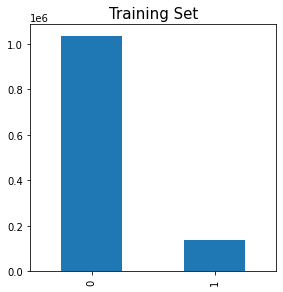

In [ ]:
#Plotting bad hole data - 3 sets
plt.figure(figsize=(15,10))
plt.subplot(2,3,1)
labeled_data.BAD_HOLE.value_counts().plot(kind='bar')
plt.title('Training Set', size=15)

#plt.subplot(2,3,2)
#test_data.BAD_HOLE.value_counts().plot(kind='bar')
#plt.title('Test Set', size=15)

#plt.subplot(2,3,3)
#hidden_data.BAD_HOLE.value_counts().plot(kind='bar')
#plt.title('Hidden Set', size=15)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



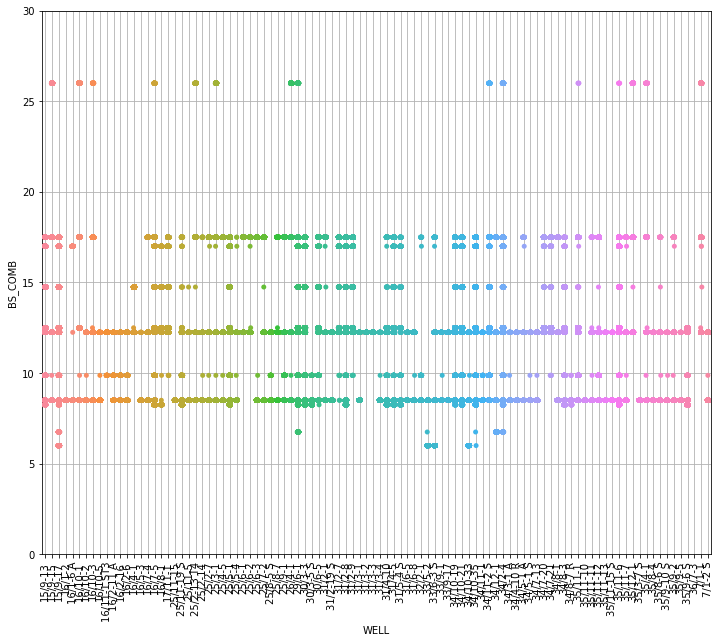

In [ ]:
#Inspecting Data
fig, x = plt.subplots(figsize=(12, 10))
sns.stripplot('WELL', 'BS_COMB', data=labeled_data, jitter=0.1 )
plt.ylim(0, 30)
plt.xticks(rotation=90)
plt.grid(True)

In [ ]:
#Dropping bad hole data

labeled_data2 = labeled_data[labeled_data.BAD_HOLE == 0]
#test_data2 = test_data[test_data.BAD_HOLE == 0]
#hidden_data2 = hidden_data[hidden_data.BAD_HOLE == 0]

In [ ]:
labeled_data.shape, labeled_data2.shape

((1170511, 34), (1033812, 34))

### Dropping Unnecessary Columns

In [ ]:
#Storing datasets lenghts
train_len = labeled_data.shape[0]
test_len = test_data.shape[0]
hidden_len = hidden_data.shape[0]

#Storing dataset wells and depths
train_well = labeled_data.WELL.values; train_depth = labeled_data.DEPTH_MD.values
test_well = test_data.WELL.values; test_depth = test_data.DEPTH_MD.values
hidden_well = hidden_data.WELL.values; hidden_depth = hidden_data.DEPTH_MD.values

df_concat = pd.concat((labeled_data, test_data, hidden_data)).reset_index(drop=True)

print('Shape of the whole data before droping', df_concat.shape)

Shape of the whole data before droping (1429694, 28)


In [ ]:
#drop_cols = ['SGR', 'ROPA', 'RXO', 'MUDWEIGHT', 'BS_FIX', 'CALI_R_MEAN', 'BS_FROM_CALI', 'BS_COMB', 'CALI_DIFF', 'BAD_HOLE']  #Columns to be dropped
drop_cols = ['SGR', 'ROPA', 'RXO', 'MUDWEIGHT']  #Columns to be dropped

df_drop = df_concat.drop(drop_cols, axis=1)
print('Shape of the whole data after droping', df_drop.shape)

Shape of the whole data after droping (1429694, 24)


### Encoding Categorical Features

In [ ]:
df_drop['GROUP_encoded'] = df_drop['GROUP'].astype('category')
df_drop['GROUP_encoded'] = df_drop['GROUP_encoded'].cat.codes

df_drop['FORMATION_encoded'] = df_drop['FORMATION'].astype('category')
df_drop['FORMATION_encoded'] = df_drop['FORMATION_encoded'].cat.codes

df_drop['WELL_encoded'] = df_drop['WELL'].astype('category')
df_drop['WELL_encoded'] = df_drop['WELL_encoded'].cat.codes

print('Shape of the whole data after encoding', df_drop.shape)

Shape of the whole data after encoding (1429694, 27)


### Incorporating Clustering into datasets

In [ ]:
#Clustering by usign K-MEANS
LonLat_df =  locations_df.drop(['WELL', 'WELL_HEAD', 'Drilling_Operator', 'Purpose', 'Completion_Year', 'Formation', 'Dataset'], axis=1)
location = LonLat_df[['lon', 'lat']].values

In [ ]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=3, init='k-means++', random_state=1)
labels = kmeans.fit_predict(location)

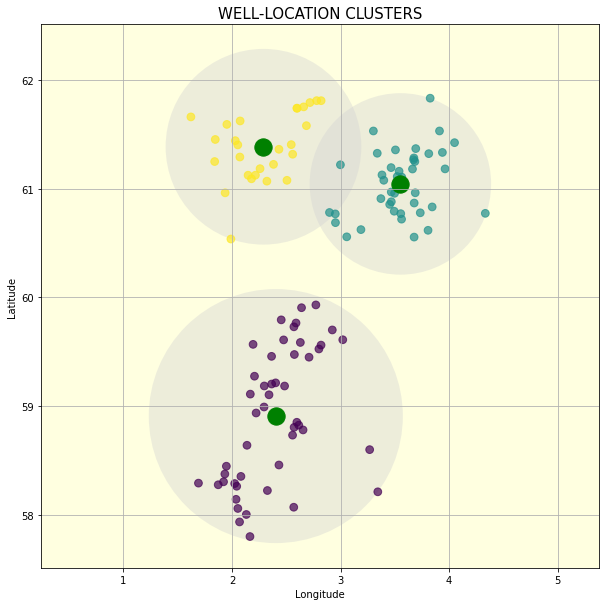

In [ ]:
#Plotting Clustered Wells
import matplotlib.pyplot as plt
from scipy.spatial.distance import cdist

fig = plt.figure(figsize=((10,10)))

#Plotting the input data
ax = None or plt.gca()
ax.axis('equal')
ax.scatter(location[:, 0], location[:, 1], c=labels, s=60, cmap='viridis', zorder=1, alpha=0.7)

#Plotting KMeans Model
centers = kmeans.cluster_centers_
ax.scatter(centers[:, 0], centers[:, 1], c='g', s=300, zorder=1)
#ax.scatter(centers[:, 0], centers[:, 1], c='g', s=300, zorder=2)
radii = [cdist(location[labels == i], [center]).max() for i, center in enumerate(centers)]

for c, r in zip(centers, radii):
  ax.add_patch(plt.Circle(c, r, fc='lightgray', lw=2, alpha=0.4, zorder=0))

ax = plt.gca()
ax.set_facecolor('lightyellow')
ax.set_title('WELL-LOCATION CLUSTERS', size=15)
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')
#ax.set_xlim(0,5)
#ax.set_ylim(55,65)
plt.grid()

In [ ]:
#Incorporating Clusters into the Dataset
df_drop = df_drop.rename(columns={'WELL':'Cluster'})
clust_map = dict(zip(locations_df.WELL.values, labels))
df_drop['Cluster'] = df_drop['Cluster'].map(clust_map)

In [ ]:
#Dropping not needed features
df_drop2 = df_drop.drop(['GROUP', 'FORMATION'], axis=1)

## **6. FEATURE AUGMENTATION**

### Standard Missing Values Imputation

#### A. Zeros Imputation

In [ ]:
# 1.Imoputing missing values with zeros
#dataset.fillna(0, inplace=True)                                  #Imputing values in the other logs
#display(dataset.head())

#### B. Median, Media, Mode Imputation

In [ ]:
# 2. Inputing missing values by introducing median - TRAIN DATASET 
from sklearn.impute import SimpleImputer
imp = SimpleImputer(missing_values=np.nan, strategy='median')
imp.fit(x_train.iloc[:,:])
x_train.iloc[:,:] = imp.fit_transform(x_train.iloc[:,:])
#display(x_train)

In [ ]:
# 2. Inputing missing values by introducing median - TRAIN DATASET 
from sklearn.impute import SimpleImputer
imp = SimpleImputer(missing_values=np.nan, strategy='median')
imp.fit(x_test.iloc[:,:])
x_test.iloc[:,:] = imp.fit_transform(x_test.iloc[:,:])
#display(x_test)

In [ ]:
# 3. Inputing missing values by introducing median - TRAIN DATASET
x_hidden = x_hidden.apply(lambda x: x.fillna(x.median()), axis=0)

In [ ]:
# 3. Inputing missing values by introducing median - TRAIN DATASET 
#from sklearn.impute import SimpleImputer
#imp = SimpleImputer(missing_values=np.nan, strategy='median')
#imp.fit(x_hidden.iloc[:,:])
#x_hidden.iloc[:,:] = imp.fit_transform(x_hidden.iloc[:,:])
#display(x_hidden.head())

### Prediction Priority Ranking Design

In [ ]:
new_dict = (labeled_data.isna().sum()/labeled_data.shape[0])*100
miss_logs = labeled_data.columns
miss_per = []
for key in miss_logs:
  miss_per.append(new_dict[key])

df_presence = pd.DataFrame({'LOG' : miss_logs,
                            'PERCENT': miss_per}).sort_values(by='PERCENT')

In [ ]:
labeled_data.columns

Index(['WELL', 'DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'GROUP', 'FORMATION',
       'CALI', 'RSHA', 'RMED', 'RDEP', 'RHOB', 'GR', 'SGR', 'NPHI', 'PEF',
       'DTC', 'SP', 'BS', 'ROP', 'DTS', 'DCAL', 'DRHO', 'MUDWEIGHT', 'RMIC',
       'ROPA', 'RXO', 'LITHO'],
      dtype='object')

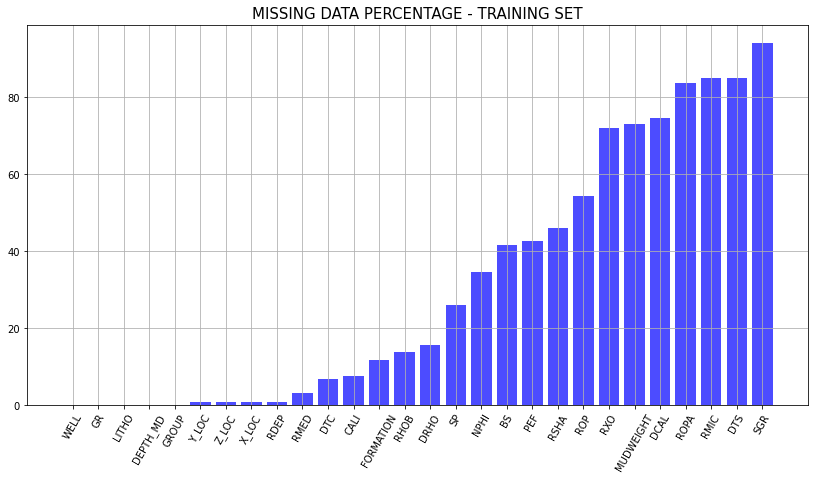

In [ ]:
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(len(df_presence.PERCENT)), height=df_presence.PERCENT, color='blue', alpha=0.7)
ax.set_xticklabels(df_presence.LOG, rotation=60)
ax.set_xticks(np.arange(len(df_presence.LOG)))
ax.set_title("MISSING DATA PERCENTAGE - TRAINING SET", size=15)
ax.grid()

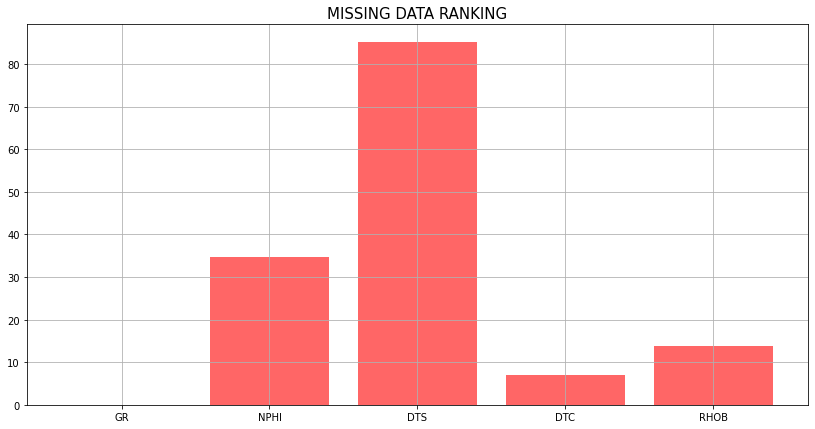

In [ ]:
#Prediction priority Ranking Design
fig, ax = plt.subplots(1, 1, figsize=(14, 7))
ax.bar(x=np.arange(len(miss_per)), height=miss_per, color='r', alpha=0.6)
ax.set_xticklabels(miss_logs)
ax.set_xticks(np.arange(len(miss_logs)))
ax.set_title("MISSING DATA RANKING", size=15)
ax.grid()

### Machine Learning-based Feature Augmentation

In [ ]:
#Complete Training and Validation sets
traindata = df_drop2[:train_len].copy()
testdata = df_drop2[train_len:(train_len+test_len)].copy()
hiddendata = df_drop2[(train_len+test_len):].copy()

#Cheching datasets shapes before argumentation
print('Raw Training data shape is {}'.format(traindata.shape))
print('Testing data shape is {}'.format(testdata.shape))
print('Hidden data shape is {}'.format(hiddendata.shape))

Raw Training data shape is (1170511, 25)
Testing data shape is (136786, 25)
Hidden data shape is (122397, 25)


In [ ]:
from sklearn.metrics import max_error, mean_absolute_error, mean_squared_error, explained_variance_score, r2_score
from xgboost import XGBRegressor
from lightgbm import LGBMRegressor
from catboost import CatBoostRegressor
from sklearn.ensemble import RandomForestRegressor

##### Predicting DTS 

In [ ]:
from sklearn.model_selection import train_test_split

# DTS training Data
traindata_dts = traindata[traindata.DTS.notna()]

#Labels and faatures
X_dts = traindata_dts.drop(['LITHO', 'DTS'], axis=1)
Y_dts = traindata_dts['DTS']

#Imputation
X_dts_inp = X_dts.apply(lambda x: x.fillna(x.median()), axis=0)

#Spliting into dts_train and dts_validation sets
X_dts_train, X_dts_val, Y_dts_train, Y_dts_val = train_test_split(X_dts_inp, Y_dts, test_size=0.3, random_state=42)

print('Splitted training data shape is {} and validation data shape is {}'.format(X_dts_train.shape, X_dts_val.shape))

Splitted training data shape is (122229, 23) and validation data shape is (52384, 23)


In [ ]:
#Test Set
testdata_dts = testdata[testdata.DTS.notna()]
X_dts = testdata_dts.drop(['LITHO', 'DTS'], axis=1)
X_dts_test = X_dts.apply(lambda x: x.fillna(x.median()), axis=0)
Y_dts_test = testdata_dts['DTS']

In [ ]:
#Comparing base models accuracies by using k-fold cross validation - 10 folds


estimators = [XGBRegressor(n_estimators=250, tree_method='gpu_hist', learning_rate=0.05), 
              CatBoostRegressor(task_type='GPU'),
              LGBMRegressor(device='gpu',gpu_platform_id=1, gpu_device_id=0), 
              ]

for estimator in estimators:
  estimator.fit(X_dts_train, Y_dts_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_dts_test, Y_dts_test)], verbose=100)

  train_pred = estimator.predict(X_dts_train)
  val_pred = estimator.predict(X_dts_val)
  test_pred = estimator.predict(X_dts_test)
  
  varinace_train = explained_variance_score(Y_dts_train, train_pred)
  max_eror_train = max_error(Y_dts_train, train_pred)
  ms_error_train = np.sqrt(mean_squared_error(Y_dts_train, train_pred))
  mabs_error_train = mean_absolute_error(Y_dts_train, train_pred)
  r2_train = r2_score(Y_dts_train, train_pred)

  varinace_val = explained_variance_score(Y_dts_val, val_pred)
  max_eror_val = max_error(Y_dts_val, val_pred)
  ms_error_val = np.sqrt(mean_squared_error(Y_dts_val, val_pred))
  mabs_error_val = mean_absolute_error(Y_dts_val, val_pred)
  r2_val = r2_score(Y_dts_val, val_pred)

  varinace_test = explained_variance_score(Y_dts_test, test_pred)
  max_eror_test = max_error(Y_dts_test, test_pred)
  ms_error_test = np.sqrt(mean_squared_error(Y_dts_test, test_pred))
  mabs_error_test = mean_absolute_error(Y_dts_test, test_pred)
  r2_test = r2_score(Y_dts_test, test_pred)

  print('---------------TRAINING MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_train, max_eror_train, ms_error_train, mabs_error_train, r2_train))
  print('---------------VALIDATION MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_val, max_eror_val, ms_error_val, mabs_error_val, r2_val))
  print('---------------TETS MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_test, max_eror_test, ms_error_test, mabs_error_test, r2_test))

[18:16:25] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:185.641
Will train until validation_0-rmse hasn't improved in 100 rounds.
[100]	validation_0-rmse:18.0697
[200]	validation_0-rmse:18.2223
Stopping. Best iteration:
[143]	validation_0-rmse:16.1557

---------------TRAINING MODEL METRICS 0.9429831306549395, 320.7644653285937, 17.016241900143637, 9.933835157182124, 0.9429799629120709---------------
---------------VALIDATION MODEL METRICS 0.9425555071199461, 239.83959960484378, 16.92516918597536, 9.914570046562535, 0.9425554614781396---------------
---------------TETS MODEL METRICS 0.9354966095563222, 154.86489868476565, 16.155745427952002, 10.54551043442265, 0.9345977431117889---------------
Learning rate set to 0.090392
0:	learn: 65.7450351	test: 61.1815090	best: 61.1815090 (0)	total: 5.57ms	remaining: 5.57s
100:	learn: 15.8944786	test: 20.3960315	best: 20.3411817 (92)	total: 470ms	remaining:

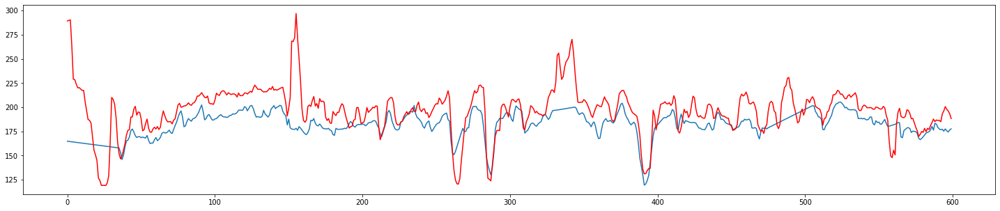

In [ ]:
#Kick Visual check on the predictions (Validation Set)
plt.figure(figsize=(25, 5))
plt.plot(list(range(600)), Y_dts_test[200:800])
plt.plot(list(range(600)), test_pred[200:800], color='r')

In [ ]:
#Predicting data
model1000 = XGBRegressor(n_estimators=250, tree_method='gpu_hist', learning_rate=0.05)
model1000.fit(X_dts_train, Y_dts_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_dts_test, Y_dts_test)], verbose=100)

[18:17:53] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:185.641
Will train until validation_0-rmse hasn't improved in 100 rounds.
[100]	validation_0-rmse:18.0697
[200]	validation_0-rmse:18.2223
Stopping. Best iteration:
[143]	validation_0-rmse:16.1557



XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, gamma=0,
             importance_type='gain', learning_rate=0.05, max_delta_step=0,
             max_depth=3, min_child_weight=1, missing=None, n_estimators=250,
             n_jobs=1, nthread=None, objective='reg:linear', random_state=0,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=None,
             silent=None, subsample=1, tree_method='gpu_hist', verbosity=1)

In [ ]:
# Filling nan values before predicting DTS
X_train_DTS = traindata.drop(['LITHO', 'DTS'], axis=1)
X_train_DTS2 = X_train_DTS.apply(lambda x: x.fillna(x.median()), axis=0)

X_test_DTS = testdata.drop(['LITHO', 'DTS'], axis=1)
X_test_DTS2 = X_test_DTS.apply(lambda x: x.fillna(x.median()), axis=0)

X_hidden_DTS = hiddendata.drop(['LITHO', 'DTS'], axis=1)
X_hidden_DTS2 = X_hidden_DTS.apply(lambda x: x.fillna(x.median()), axis=0)

#Predicting DTS (COMPLETE DATASETS)
traindata['DTS_pred'] = model1000.predict(X_train_DTS2)
testdata['DTS_pred'] = model1000.predict(X_test_DTS2)
hiddendata['DTS_pred'] = model1000.predict(X_hidden_DTS2)

#Inputing nan values in DTS with DTS_PREDICTED
traindata['DTS_COMB'] = traindata['DTS']
traindata['DTS_COMB'].fillna(traindata['DTS_pred'], inplace=True)

testdata['DTS_COMB'] = testdata['DTS']
testdata['DTS_COMB'].fillna(testdata['DTS_pred'], inplace=True)

hiddendata['DTS_COMB'] = hiddendata['DTS']
hiddendata['DTS_COMB'].fillna(hiddendata['DTS_pred'], inplace=True)

##### Predicting NPHI

In [ ]:
# NPHI training Data
traindata_nphi = traindata[traindata.NPHI.notna()]

#Labels and fatures
X_nphi = traindata_nphi.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI'], axis=1)
Y_nphi = traindata_nphi['NPHI']

#Imputation
X_nphi_inp = X_nphi.apply(lambda x: x.fillna(x.median()), axis=0)

#Spliting into dts_train and dts_validation sets
X_nphi_train, X_nphi_val, Y_nphi_train, Y_nphi_val = train_test_split(X_nphi_inp, Y_nphi, test_size=0.3, random_state=42)

print('Splitted training data shape is {} and validation data shape is {}'.format(X_nphi_train.shape, X_nphi_val.shape))

Splitted training data shape is (535786, 23) and validation data shape is (229623, 23)


In [ ]:
#Test Set
testdata_nphi = testdata[testdata.NPHI.notna()]
X_nphi = testdata_nphi.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI'], axis=1)
X_nphi_test = X_nphi.apply(lambda x: x.fillna(x.median()), axis=0)
Y_nphi_test = testdata_nphi['NPHI']

In [ ]:
#Comparing base models accuracies by using k-fold cross validation - 10 folds


estimators = [XGBRegressor(n_estimators=250, tree_method='gpu_hist', learning_rate=0.05), 
              CatBoostRegressor(task_type='GPU'),
              LGBMRegressor(device='gpu',gpu_platform_id=1, gpu_device_id=0), 
              #RandomForestRegressor(n_estimators=250)
              ]

for estimator in estimators:
  estimator.fit(X_nphi_train, Y_nphi_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_nphi_test, Y_nphi_test)], verbose=100)

  train_pred = estimator.predict(X_nphi_train)
  val_pred = estimator.predict(X_nphi_val)
  test_pred = estimator.predict(X_nphi_test)
  
  varinace_train = explained_variance_score(Y_nphi_train, train_pred)
  max_eror_train = max_error(Y_nphi_train, train_pred)
  ms_error_train = np.sqrt(mean_squared_error(Y_nphi_train, train_pred))
  mabs_error_train = mean_absolute_error(Y_nphi_train, train_pred)
  r2_train = r2_score(Y_nphi_train, train_pred)

  varinace_val = explained_variance_score(Y_nphi_val, val_pred)
  max_eror_val = max_error(Y_nphi_val, val_pred)
  ms_error_val = np.sqrt(mean_squared_error(Y_nphi_val, val_pred))
  mabs_error_val = mean_absolute_error(Y_nphi_val, val_pred)
  r2_val = r2_score(Y_nphi_val, val_pred)

  varinace_test = explained_variance_score(Y_nphi_test, test_pred)
  max_eror_test = max_error(Y_nphi_test, test_pred)
  ms_error_test = np.sqrt(mean_squared_error(Y_nphi_test, test_pred))
  mabs_error_test = mean_absolute_error(Y_nphi_test, test_pred)
  r2_test = r2_score(Y_nphi_test, test_pred)

  print('---------------TRAINING MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_train, max_eror_train, ms_error_train, mabs_error_train, r2_train))
  print('---------------VALIDATION MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_val, max_eror_val, ms_error_val, mabs_error_val, r2_val))
  print('---------------TETS MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_test, max_eror_test, ms_error_test, mabs_error_test, r2_test))


[18:17:57] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:0.211631
Will train until validation_0-rmse hasn't improved in 100 rounds.
[100]	validation_0-rmse:0.054357
[200]	validation_0-rmse:0.054938
Stopping. Best iteration:
[135]	validation_0-rmse:0.054173

---------------TRAINING MODEL METRICS 0.822858307063778, 0.5978547334873657, 0.054965593412954254, 0.039667366560681365, 0.8228568643246178---------------
---------------VALIDATION MODEL METRICS 0.8202612043832318, 0.5730647444997071, 0.05520695938996934, 0.03976048598658963, 0.8202599297144806---------------
---------------TETS MODEL METRICS 0.7946952513907591, 0.4580474793752105, 0.05417259400803016, 0.0405184636613938, 0.7946938251879162---------------
Learning rate set to 0.097468
0:	learn: 0.1220586	test: 0.1128483	best: 0.1128483 (0)	total: 7.41ms	remaining: 7.4s
100:	learn: 0.0472862	test: 0.0576039	best: 0.0549643 (36)	total: 694ms	re

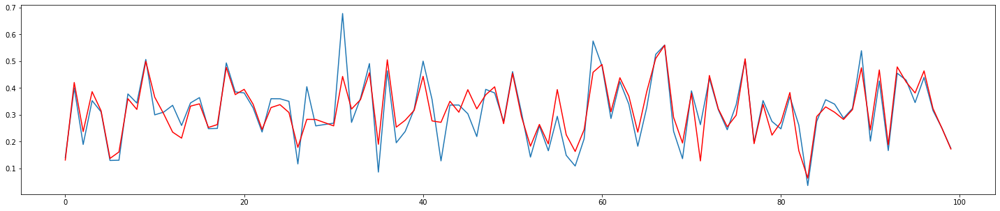

In [ ]:
#Visual check on the predictions (Validation Set)
plt.figure(figsize=(25, 5))
plt.plot(list(range(100)), Y_nphi_val[25000:25100])
plt.plot(list(range(100)), val_pred[25000:25100], color='r')

In [ ]:
model2000 = LGBMRegressor(device='gpu',gpu_platform_id=1, gpu_device_id=0)
model2000.fit(X_nphi_train, Y_nphi_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_nphi_test, Y_nphi_test)], verbose=100)

Training until validation scores don't improve for 100 rounds
[100]	valid_0's l2: 0.00317608
Did not meet early stopping. Best iteration is:
[31]	valid_0's l2: 0.00283211


LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
              device='gpu', gpu_device_id=0, gpu_platform_id=1,
              importance_type='split', learning_rate=0.1, max_depth=-1,
              min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
              n_estimators=100, n_jobs=-1, num_leaves=31, objective=None,
              random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
              subsample=1.0, subsample_for_bin=200000, subsample_freq=0)

In [ ]:
# Filling nan values before predicting NPHI
X_train_NPHI = traindata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI'], axis=1)
X_train_NPHI2 = X_train_NPHI.apply(lambda x: x.fillna(x.median()), axis=0)

X_test_NPHI = testdata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI'], axis=1)
X_test_NPHI2 = X_test_NPHI.apply(lambda x: x.fillna(x.median()), axis=0)

X_hidden_NPHI = hiddendata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI'], axis=1)
X_hidden_NPHI2 = X_hidden_NPHI.apply(lambda x: x.fillna(x.median()), axis=0)

#Predicting DTS (COMPLETE DATASETS)
traindata['NPHI_pred'] = model2000.predict(X_train_NPHI2)
testdata['NPHI_pred'] = model2000.predict(X_test_NPHI2)
hiddendata['NPHI_pred'] = model2000.predict(X_hidden_NPHI2)

#Inputing nan values in DTS with DTS_PREDICTED
traindata['NPHI_COMB'] = traindata['NPHI']
traindata['NPHI_COMB'].fillna(traindata['NPHI_pred'], inplace=True)

testdata['NPHI_COMB'] = testdata['NPHI']
testdata['NPHI_COMB'].fillna(testdata['NPHI_pred'], inplace=True)

hiddendata['NPHI_COMB'] = hiddendata['NPHI']
hiddendata['NPHI_COMB'].fillna(hiddendata['NPHI_pred'], inplace=True)

##### Predicting RHOB

In [ ]:
# RHOB training Data
traindata_rhob = traindata[traindata.RHOB.notna()]

#Labels and fatures
X_rhob = traindata_rhob.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB'], axis=1)
Y_rhob = traindata_rhob['RHOB']

#Imputation
X_rhob_inp = X_rhob.apply(lambda x: x.fillna(x.median()), axis=0)

#Spliting into dts_train and dts_validation sets
X_rhob_train, X_rhob_val, Y_rhob_train, Y_rhob_val = train_test_split(X_rhob_inp, Y_rhob, test_size=0.3, random_state=42)

print('Splitted training data shape is {} and validation data shape is {}'.format(X_rhob_train.shape, X_rhob_val.shape))

Splitted training data shape is (706469, 23) and validation data shape is (302773, 23)


In [ ]:
#Test Set
testdata_rhob = testdata[testdata.RHOB.notna()]
X_rhob = testdata_rhob.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB'], axis=1)
X_rhob_test = X_rhob.apply(lambda x: x.fillna(x.median()), axis=0)
Y_rhob_test = testdata_rhob['RHOB']

In [ ]:
#Comparing base models accuracies by using k-fold cross validation - 10 folds

estimators = [XGBRegressor(n_estimators=250, tree_method='gpu_hist', learning_rate=0.1), 
              CatBoostRegressor(task_type='GPU'),
              LGBMRegressor(device='gpu',gpu_platform_id=1, gpu_device_id=0), 
              #RandomForestRegressor(n_estimators=250)
              ]

for estimator in estimators:
  estimator.fit(X_rhob_train, Y_rhob_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_rhob_val, Y_rhob_val)], verbose=100)

  train_pred = estimator.predict(X_rhob_train)
  val_pred = estimator.predict(X_rhob_val)
  test_pred = estimator.predict(X_rhob_test)
  
  varinace_train = explained_variance_score(Y_rhob_train, train_pred)
  max_eror_train = max_error(Y_rhob_train, train_pred)
  ms_error_train = np.sqrt(mean_squared_error(Y_rhob_train, train_pred))
  mabs_error_train = mean_absolute_error(Y_rhob_train, train_pred)
  r2_train = r2_score(Y_rhob_train, train_pred)

  varinace_val = explained_variance_score(Y_rhob_val, val_pred)
  max_eror_val = max_error(Y_rhob_val, val_pred)
  ms_error_val = np.sqrt(mean_squared_error(Y_rhob_val, val_pred))
  mabs_error_val = mean_absolute_error(Y_rhob_val, val_pred)
  r2_val = r2_score(Y_rhob_val, val_pred)

  varinace_test = explained_variance_score(Y_rhob_test, test_pred)
  max_eror_test = max_error(Y_rhob_test, test_pred)
  ms_error_test = np.sqrt(mean_squared_error(Y_rhob_test, test_pred))
  mabs_error_test = mean_absolute_error(Y_rhob_test, test_pred)
  r2_test = r2_score(Y_rhob_test, test_pred)

  print('---------------TRAINING MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_train, max_eror_train, ms_error_train, mabs_error_train, r2_train))
  print('---------------VALIDATION MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_val, max_eror_val, ms_error_val, mabs_error_val, r2_val))
  print('---------------TETS MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_test, max_eror_test, ms_error_test, mabs_error_test, r2_test))


[18:18:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:1.62401
Will train until validation_0-rmse hasn't improved in 100 rounds.
[100]	validation_0-rmse:0.090424
[200]	validation_0-rmse:0.083326
[249]	validation_0-rmse:0.081192
---------------TRAINING MODEL METRICS 0.8978527210507097, 1.2775182127495117, 0.0809960434787058, 0.05488022324333211, 0.8978527210495243---------------
---------------VALIDATION MODEL METRICS 0.8969729863215667, 1.2356745004274414, 0.08119178686673097, 0.054869131456672146, 0.8969728991757834---------------
---------------TETS MODEL METRICS 0.8544590275218603, 1.0630896091243653, 0.09294279118145209, 0.06370729274759995, 0.854429246537812---------------
Learning rate set to 0.098852
0:	learn: 0.2352885	test: 0.2348132	best: 0.2348132 (0)	total: 8.16ms	remaining: 8.16s
100:	learn: 0.0832833	test: 0.0832247	best: 0.0832247 (100)	total: 773ms	remaining: 6.88s
200:	learn: 

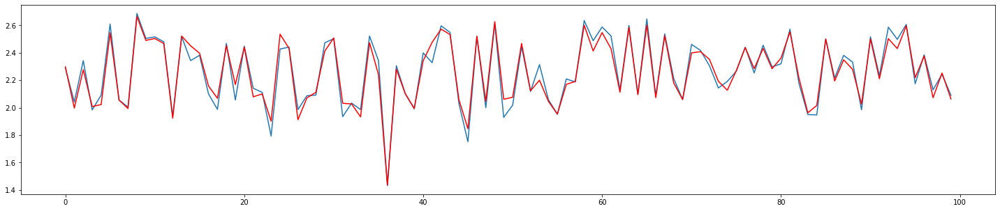

In [ ]:
#Visual check on the predictions (Validation Set)
plt.figure(figsize=(25, 5))
plt.plot(list(range(100)), Y_rhob_val[25000:25100])
plt.plot(list(range(100)), val_pred[25000:25100], color='r')

In [ ]:
model4000 = CatBoostRegressor(task_type='GPU')
model4000.fit(X_rhob_train, Y_rhob_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_rhob_val, Y_rhob_val)], verbose=100)

Learning rate set to 0.098852
0:	learn: 0.2352885	test: 0.2348132	best: 0.2348132 (0)	total: 8.55ms	remaining: 8.54s
100:	learn: 0.0832833	test: 0.0832247	best: 0.0832247 (100)	total: 788ms	remaining: 7.01s
200:	learn: 0.0741933	test: 0.0741912	best: 0.0741912 (200)	total: 1.57s	remaining: 6.23s
300:	learn: 0.0695059	test: 0.0695934	best: 0.0695934 (300)	total: 2.31s	remaining: 5.38s
400:	learn: 0.0665414	test: 0.0667391	best: 0.0667391 (400)	total: 3.08s	remaining: 4.59s
500:	learn: 0.0651803	test: 0.0654577	best: 0.0654577 (500)	total: 3.83s	remaining: 3.81s
600:	learn: 0.0643625	test: 0.0646926	best: 0.0646926 (600)	total: 4.57s	remaining: 3.04s
700:	learn: 0.0637070	test: 0.0640694	best: 0.0640694 (700)	total: 5.33s	remaining: 2.27s
800:	learn: 0.0634246	test: 0.0638023	best: 0.0638023 (800)	total: 6.07s	remaining: 1.51s
900:	learn: 0.0631988	test: 0.0635929	best: 0.0635929 (900)	total: 6.79s	remaining: 746ms
999:	learn: 0.0631784	test: 0.0635766	best: 0.0635766 (981)	total: 7.52s	

In [ ]:
# Filling nan values before predicting NPHI
X_train_RHOB = traindata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB'], axis=1)
X_train_RHOB2 = X_train_RHOB.apply(lambda x: x.fillna(x.median()), axis=0)

X_test_RHOB = testdata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB'], axis=1)
X_test_RHOB2 = X_test_RHOB.apply(lambda x: x.fillna(x.median()), axis=0)

X_hidden_RHOB = hiddendata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB'], axis=1)
X_hidden_RHOB2 = X_hidden_RHOB.apply(lambda x: x.fillna(x.median()), axis=0)

#Predicting DTS (COMPLETE DATASETS)
traindata['RHOB_pred'] = model4000.predict(X_train_RHOB2)
testdata['RHOB_pred'] = model4000.predict(X_test_RHOB2)
hiddendata['RHOB_pred'] = model4000.predict(X_hidden_RHOB2)

#Inputing nan values in DTS with DTS_PREDICTED
traindata['RHOB_COMB'] = traindata['RHOB']
traindata['RHOB_COMB'].fillna(traindata['RHOB_pred'], inplace=True)

testdata['RHOB_COMB'] = testdata['RHOB']
testdata['RHOB_COMB'].fillna(testdata['RHOB_pred'], inplace=True)

hiddendata['RHOB_COMB'] = hiddendata['RHOB']
hiddendata['RHOB_COMB'].fillna(hiddendata['RHOB_pred'], inplace=True)

##### Predicting DTC

In [ ]:
# DTC training Data
traindata_dtc = traindata[traindata.DTC.notna()]

#Labels and fatures
X_dtc = traindata_dtc.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB', 'RHOB_pred', 'DTC'], axis=1)
Y_dtc = traindata_dtc['DTC']

#Imputation
X_dtc_inp = X_dtc.apply(lambda x: x.fillna(x.median()), axis=0)

#Spliting into dts_train and dts_validation sets
X_dtc_train, X_dtc_val, Y_dtc_train, Y_dtc_val = train_test_split(X_dtc_inp, Y_dtc, test_size=0.3, random_state=42)

print('Splitted training data shape is {} and validation data shape is {}'.format(X_dtc_train.shape, X_dtc_val.shape))

Splitted training data shape is (762753, 23) and validation data shape is (326895, 23)


In [ ]:
#Test Set
testdata_dtc = testdata[testdata.DTC.notna()]
X_dtc = testdata_dtc.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB', 'RHOB_pred', 'DTC'], axis=1)
X_dtc_test = X_dtc.apply(lambda x: x.fillna(x.median()), axis=0)
Y_dtc_test = testdata_dtc['DTC']

In [ ]:
#Comparing base models accuracies by using k-fold cross validation - 10 folds

estimators = [XGBRegressor(n_estimators=250, tree_method='gpu_hist', learning_rate=0.1), 
              CatBoostRegressor(task_type='GPU'),
              LGBMRegressor(device='gpu',gpu_platform_id=1, gpu_device_id=0), 
              #RandomForestRegressor(n_estimators=250)
              ]

for estimator in estimators:
  estimator.fit(X_dtc_train, Y_dtc_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_dtc_val, Y_dtc_val)], verbose=100)

  train_pred = estimator.predict(X_dtc_train)
  val_pred = estimator.predict(X_dtc_val)
  test_pred = estimator.predict(X_dtc_test)
  
  varinace_train = explained_variance_score(Y_dtc_train, train_pred)
  max_eror_train = max_error(Y_dtc_train, train_pred)
  ms_error_train = np.sqrt(mean_squared_error(Y_dtc_train, train_pred))
  mabs_error_train = mean_absolute_error(Y_dtc_train, train_pred)
  r2_train = r2_score(Y_dtc_train, train_pred)

  varinace_val = explained_variance_score(Y_dtc_val, val_pred)
  max_eror_val = max_error(Y_dtc_val, val_pred)
  ms_error_val = np.sqrt(mean_squared_error(Y_dtc_val, val_pred))
  mabs_error_val = mean_absolute_error(Y_dtc_val, val_pred)
  r2_val = r2_score(Y_dtc_val, val_pred)

  varinace_test = explained_variance_score(Y_dtc_test, test_pred)
  max_eror_test = max_error(Y_dtc_test, test_pred)
  ms_error_test = np.sqrt(mean_squared_error(Y_dtc_test, test_pred))
  mabs_error_test = mean_absolute_error(Y_dtc_test, test_pred)
  r2_test = r2_score(Y_dtc_test, test_pred)

  print('---------------TRAINING MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_train, max_eror_train, ms_error_train, mabs_error_train, r2_train))
  print('---------------VALIDATION MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_val, max_eror_val, ms_error_val, mabs_error_val, r2_val))
  print('---------------TETS MODEL METRICS {}, {}, {}, {}, {}---------------'.format(varinace_test, max_eror_test, ms_error_test, mabs_error_test, r2_test))


[18:18:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:105.122
Will train until validation_0-rmse hasn't improved in 100 rounds.
[100]	validation_0-rmse:5.30855
[200]	validation_0-rmse:4.66288
[249]	validation_0-rmse:4.47106
---------------TRAINING MODEL METRICS 0.9778636752795874, 154.5787658732031, 4.46231169581841, 2.8332683333934736, 0.9778636752795027---------------
---------------VALIDATION MODEL METRICS 0.977768771411414, 113.3887329065625, 4.471056038005646, 2.83274049845536, 0.977768651452456---------------
---------------TETS MODEL METRICS 0.9748159157139578, 46.53684997060546, 4.36990140276971, 3.1264393219528697, 0.9742996446038116---------------
Learning rate set to 0.099239
0:	learn: 27.3198217	test: 27.3139079	best: 27.3139079 (0)	total: 8.68ms	remaining: 8.67s
100:	learn: 4.6228276	test: 4.6252795	best: 4.6252795 (100)	total: 789ms	remaining: 7.02s
200:	learn: 4.0064070	test: 4

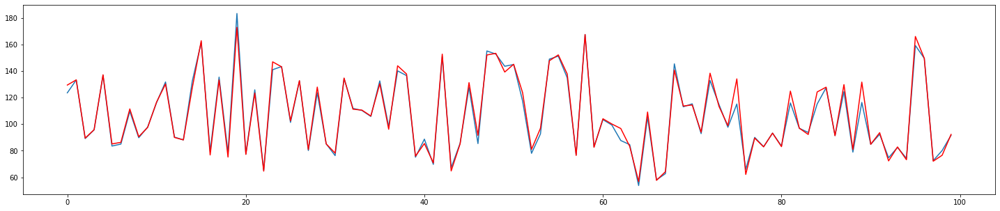

In [ ]:
#Visual check on the predictions (Validation Set)
plt.figure(figsize=(25, 5))
plt.plot(list(range(100)), Y_dtc_val[25000:25100])
plt.plot(list(range(100)), val_pred[25000:25100], color='r')

In [ ]:
model3000 = CatBoostRegressor(task_type='GPU')
model3000.fit(X_dtc_train, Y_dtc_train.values.ravel(), early_stopping_rounds=100, eval_set=[(X_dtc_val, Y_dtc_val)], verbose=100)

Learning rate set to 0.099239
0:	learn: 27.3198217	test: 27.3139079	best: 27.3139079 (0)	total: 10.6ms	remaining: 10.6s
100:	learn: 4.6228238	test: 4.6252790	best: 4.6252790 (100)	total: 833ms	remaining: 7.41s
200:	learn: 4.0064063	test: 4.0154889	best: 4.0154889 (200)	total: 1.62s	remaining: 6.45s
300:	learn: 3.6905844	test: 3.7075971	best: 3.7075971 (300)	total: 2.41s	remaining: 5.59s
400:	learn: 3.5216582	test: 3.5448092	best: 3.5448092 (400)	total: 3.21s	remaining: 4.79s
500:	learn: 3.4453656	test: 3.4723926	best: 3.4723926 (500)	total: 3.96s	remaining: 3.94s
600:	learn: 3.3704920	test: 3.3999609	best: 3.3999609 (600)	total: 4.74s	remaining: 3.15s
700:	learn: 3.3222516	test: 3.3531677	best: 3.3531677 (700)	total: 5.51s	remaining: 2.35s
800:	learn: 3.3199977	test: 3.3509545	best: 3.3509501 (752)	total: 6.28s	remaining: 1.56s
bestTest = 3.35095006
bestIteration = 752
Shrink model to first 753 iterations.


In [ ]:
# Filling nan values before predicting NPHI
X_train_DTC = traindata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB', 'RHOB_pred', 'DTC'], axis=1)
X_train_DTC2 = X_train_DTC.apply(lambda x: x.fillna(x.median()), axis=0)

X_test_DTC = testdata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB', 'RHOB_pred', 'DTC'], axis=1)
X_test_DTC2 = X_test_DTC.apply(lambda x: x.fillna(x.median()), axis=0)

X_hidden_DTC = hiddendata.drop(['LITHO', 'DTS', 'DTS_pred', 'NPHI', 'NPHI_pred', 'RHOB', 'RHOB_pred', 'DTC'], axis=1)
X_hidden_DTC2 = X_hidden_DTC.apply(lambda x: x.fillna(x.median()), axis=0)

#Predicting DTS (COMPLETE DATASETS)
traindata['DTC_pred'] = model3000.predict(X_train_DTC2)
testdata['DTC_pred'] = model3000.predict(X_test_DTC2)
hiddendata['DTC_pred'] = model3000.predict(X_hidden_DTC2)

#Inputing nan values in DTS with DTS_PREDICTED
traindata['DTC_COMB'] = traindata['DTC']
traindata['DTC_COMB'].fillna(traindata['DTC_pred'], inplace=True)

testdata['DTC_COMB'] = testdata['DTC']
testdata['DTC_COMB'].fillna(testdata['DTC_pred'], inplace=True)

hiddendata['DTC_COMB'] = hiddendata['DTC']
hiddendata['DTC_COMB'].fillna(hiddendata['DTC_pred'], inplace=True)

##### Ploting Predicted Logs

In [ ]:
#Dataframes containing the predicted logs
train_predicted_logs = pd.concat((labeled_data[['WELL', 'DEPTH_MD']], 
                                  traindata[['DTS', 'DTS_pred', 'DTS_COMB', 'NPHI', 'NPHI_pred', 'NPHI_COMB', 'RHOB', 'RHOB_pred', 'RHOB_COMB', 'DTC', 'DTC_pred', 'DTC_COMB', 'LITHO']].reset_index()), 
                                  axis=1)

test_predicted_logs = pd.concat((test_data[['WELL', 'DEPTH_MD']], 
                                testdata[['DTS', 'DTS_pred', 'DTS_COMB', 'NPHI', 'NPHI_pred', 'NPHI_COMB', 'RHOB', 'RHOB_pred', 'RHOB_COMB', 'DTC', 'DTC_pred', 'DTC_COMB', 'LITHO']].reset_index()), 
                                axis=1)

hidden_predicted_logs = pd.concat((hidden_data[['WELL', 'DEPTH_MD']], 
                                  hiddendata[['DTS', 'DTS_pred', 'DTS_COMB', 'NPHI', 'NPHI_pred', 'NPHI_COMB', 'RHOB', 'RHOB_pred', 'RHOB_COMB', 'DTC', 'DTC_pred', 'DTC_COMB', 'LITHO']].reset_index()), 
                                  axis=1)

In [ ]:
#Predicted Logs Visualization
for i in range(0,100):
  plot_predicted_logs(train_predicted_logs, i, facies_colors )

In [ ]:
#Predicted Logs Visualization
for i in range(0,10):
  plot_predicted_logs(hidden_predicted_logs, i, facies_colors )

In [ ]:
#Predicted Logs Visualization
for i in range(0,10):
  plot_predicted_logs(test_predicted_logs, i, facies_colors )

## **7 ADDITIONAL WELL LOG-BASED FEATURES**

In [ ]:
#Train Set
traindata['AI'] = traindata.RHOB_COMB * (1e6/traindata.DTS_COMB)
traindata['AI_P'] = traindata.RHOB_COMB * (1e6/traindata.DTC_COMB)
traindata['DT_R'] = traindata.DTC_COMB / traindata.DTS_COMB
traindata['GM'] = ((1e6/traindata.DTS_COMB)**2) * traindata.RHOB_COMB
traindata['K'] = (((1e6/traindata.DTC_COMB)**2) * traindata.RHOB_COMB) - (4 * traindata.GM/3)
traindata['MD_TVD'] = -(traindata.DEPTH_MD/traindata.Z_LOC)

#Test Set
testdata['AI'] = testdata.RHOB_COMB * (1e6/testdata.DTS_COMB)
testdata['AI_P'] = testdata.RHOB_COMB * (1e6/testdata.DTC_COMB)
testdata['DT_R'] = testdata.DTC_COMB / testdata.DTS_COMB
testdata['GM'] = ((1e6/testdata.DTS_COMB)**2) * testdata.RHOB_COMB
testdata['K'] = (((1e6/testdata.DTC_COMB)**2) * testdata.RHOB_COMB) - (4 * testdata.GM/3)
testdata['MD_TVD'] = -(testdata.DEPTH_MD/testdata.Z_LOC)

#Hidden Set
hiddendata['AI'] = hiddendata.RHOB_COMB * (1e6/hiddendata.DTS_COMB)
hiddendata['AI_P'] = hiddendata.RHOB_COMB * (1e6/hiddendata.DTC)
hiddendata['DT_R'] = hiddendata.DTC / hiddendata.DTS_COMB
hiddendata['GM'] = ((1e6/hiddendata.DTS_COMB)**2) * hiddendata.RHOB_COMB
hiddendata['K'] = (((1e6/hiddendata.DTC)**2) * hiddendata.RHOB_COMB) - (4 * hiddendata.GM/3)
hiddendata['MD_TVD'] = -(hiddendata.DEPTH_MD/hiddendata.Z_LOC)

In [ ]:
print('Training dataset shape {}, test dataset shape {}, hidden dataset shape {}'.format(traindata.shape, testdata.shape, hiddendata.shape))

Training dataset shape (1170511, 39), test dataset shape (136786, 39), hidden dataset shape (122397, 39)


## **8. NORMALIZATION**

In [ ]:
#Complete Set of features
features_names = ['DEPTH_MD', 'X_LOC', 'Y_LOC', 'Z_LOC', 'CALI', 'RSHA',
                  'RMED', 'RDEP', 'RHOB', 'GR', 'NPHI', 'PEF', 'DTC', 'SP', 'BS', 'ROP',
                  'DTS', 'DCAL', 'DRHO', 'RMIC', 'GROUP_encoded',
                  'FORMATION_encoded', 'WELL_encoded']

In [ ]:
labeled_data1 = traindata.drop(traindata[(traindata.RMED < 0)].index)

In [ ]:
#Features prior Normalization
train_features = labeled_data1[features_names]
train_labels = labeled_data1['LITHO']

test_features = testdata[features_names]
test_labels = testdata['LITHO']

hidden_features = hiddendata[features_names]
hidden_labels = hiddendata['LITHO']

In [ ]:
#Filling nan values in the non-predicted logs
train_features_inp = train_features.apply(lambda x: x.fillna(x.median()), axis=0)
test_features_inp = test_features.apply(lambda x: x.fillna(x.median()), axis=0)
hidden_features_inp = hidden_features.apply(lambda x: x.fillna(x.median()), axis=0)

In [ ]:
train_features_inp = train_features_inp.copy()
train_features_inp['RSHA'] = np.log10(train_features_inp.RSHA)
train_features_inp['RMED'] = np.log10(train_features_inp.RMED)
train_features_inp['RDEP'] = np.log10(train_features_inp.RDEP)

test_features_inp = test_features_inp.copy()
test_features_inp['RSHA'] = np.log10(test_features_inp.RSHA)
test_features_inp['RMED'] = np.log10(test_features_inp.RMED)
test_features_inp['RDEP'] = np.log10(test_features_inp.RDEP)

hidden_features_inp = hidden_features_inp.copy()
hidden_features_inp['RSHA'] = np.log10(hidden_features_inp.RSHA)
hidden_features_inp['RMED'] = np.log10(hidden_features_inp.RMED)
hidden_features_inp['RDEP'] = np.log10(hidden_features_inp.RDEP)

In [ ]:
train_features_inp.shape, test_features_inp.shape, hidden_features_inp.shape

((1170504, 23), (136786, 23), (122397, 23))

### Normalization Methods

In [ ]:
### Normalization Methods

from sklearn.linear_model import LogisticRegression
import warnings 
warnings.filterwarnings('ignore', category=FutureWarning)
from sklearn.preprocessing import StandardScaler, Normalizer, MinMaxScaler
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import PowerTransformer

n = train_features.shape[1]

##Min-Max scaler 
scaler = MinMaxScaler()
x_train_scaled = train_features_inp.copy()
x_test_scaled = test_features_inp.copy()
x_hidden_scaled = hidden_features_inp.copy()

x_train_scaled.iloc[:,:n] = scaler.fit_transform(x_train_scaled.iloc[:,:n])
x_test_scaled.iloc[:,:n] = scaler.transform(x_test_scaled.iloc[:,:n])
x_hidden_scaled.iloc[:,:n] = scaler.transform(x_hidden_scaled.iloc[:,:n])

##Standardization (Z-score Normalization -> better handling oitliers)
std = StandardScaler()
x_train_std = train_features_inp.copy()
x_test_std = test_features_inp.copy()
x_hidden_std = hidden_features_inp.copy()

x_train_std.iloc[:,:n] = std.fit_transform(x_train_std.iloc[:,:n])
x_test_std.iloc[:,:n] = std.transform(x_test_std.iloc[:,:n])
x_hidden_std.iloc[:,:n] = std.transform(x_hidden_std.iloc[:,:n])

##Normalization
normalizer = Normalizer()
x_train_norm = train_features_inp.copy()
x_test_norm = test_features_inp.copy()
x_hidden_norm = hidden_features_inp.copy()

x_train_norm.iloc[:,:n] = normalizer.fit_transform(x_train_norm.iloc[:,:n])
x_test_norm.iloc[:,:n] = normalizer.transform(x_test_norm.iloc[:,:n])
x_hidden_norm.iloc[:,:n] = normalizer.transform(x_hidden_norm.iloc[:,:n])

In [ ]:
#Saving treated data

cleaned_traindata = pd.concat([x_train_std, train_labels], axis=1)
cleaned_testdata = pd.concat([x_test_std.reset_index(), test_labels.reset_index()], axis=1)
cleaned_hiddendata = pd.concat([x_hidden_std.reset_index(), hidden_labels.reset_index()], axis=1)

cleaned_traindata.to_csv('/content/drive/MyDrive/Thesis_data/cleaned_traindata.csv', index=False)
cleaned_testdata.to_csv('/content/drive/MyDrive/Thesis_data/cleaned_testdata.csv', index=False)
cleaned_hiddendata.to_csv('/content/drive/MyDrive/Thesis_data/cleaned_hiddendata.csv', index=False)



### Boxplotting Normalized Data

/usr/local/lib/python3.7/dist-packages/numpy/core/_asarray.py:83: VisibleDeprecationWarning:

Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray



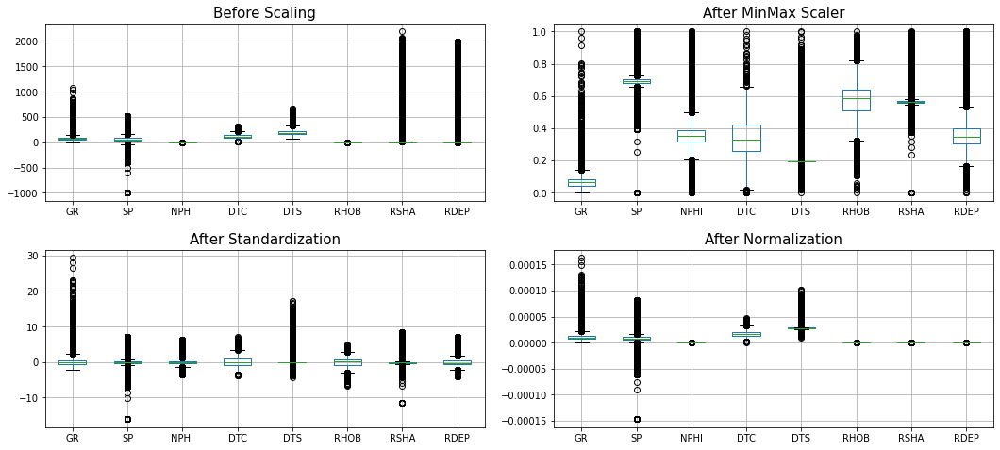

In [ ]:
#Box plotting data after Scaling ---- NO LOG

box_features = ['GR', 'SP', 'NPHI','DTC', 'DTS', 'RHOB', 'RSHA', 'RDEP']
plt.figure(figsize=(15,10))

#Before Normalization
plt.subplot(3,2,1)
train_features[box_features].boxplot()
plt.title('Before Scaling', size=15)

# 1. After MinMax Scaler
plt.subplot(3,2,2)
x_train_scaled[box_features].boxplot()
plt.title('After MinMax Scaler', size=15)

# 2. After Standardization
plt.subplot(3,2,3)
x_train_std[box_features].boxplot()
#plt.ylim([-15, 40])
plt.title('After Standardization', size=15)

# 3. After Normalization
plt.subplot(3,2,4)
x_train_norm[box_features].boxplot()
plt.title('After Normalization', size=15)

plt.tight_layout(1.7)
plt.show()

### Comparing Normalization Methods Peformance 

In [ ]:
#Fitting Non-scaled Data
x_sample, a, y_sample, b = train_test_split(train_features_inp, train_labels, train_size=0.1, shuffle=True, stratify=labeled_data1.LITHO)
model_std = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_std.fit(test_features_inp, test_labels)
pred_std = model_std.predict(test_features_inp)
print('The acuracy score with no standardization', accuracy_score(pred_std, test_labels))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


max_iter reached after 949 seconds
The acuracy score with no standardization 0.6139151667568319


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:330: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 15.8min finished


In [ ]:
#Fitting Normalized data 
x_norm_sample, a, y_norm_sample, b = train_test_split(x_train_norm, train_labels, train_size=0.25, shuffle=True)

model_std = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_std.fit(x_norm_sample, y_norm_sample)
pred_std = model_std.predict(x_test_norm)
print('The acuracy score with normalized data', accuracy_score(pred_std, test_labels))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   16.2s finished


In [ ]:
#Fitting Standardized data 
x_std_sample, a, y_std_sample, b = train_test_split(x_train_std, train_labels, train_size=0.25, shuffle=True)
model_std = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_std.fit(x_std_sample, y_std_sample)
pred_std = model_std.predict(x_test_std)
print('The acuracy score with standardize data', accuracy_score(pred_std, test_labels))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 1077 epochs took 667 seconds
The acuracy score with standardize data 0.6944789671457605


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 11.1min finished


In [ ]:
#Fitting Sacaled Data 
x_scaled_sample, a, y_scaled_sample, b = train_test_split(x_train_scaled, train_labels, train_size=0.25, shuffle=True)
model_std = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_std.fit(x_scaled_sample, y_scaled_sample)
pred_std = model_std.predict(x_test_scaled)
print('The acuracy score with min-max scaled data', accuracy_score(pred_std, test_labels))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...
rescaling...

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.5s finished


In [ ]:
#Fitting a logistic regression model  #### KEEP THIS ONE

model_lr = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
#model_lr = LogisticRegression()

#Score with no Scale/Normalization
model_lr.fit(x_train, y_train.values.ravel())
print('The acuracy score withouth Normalization/scaling', model_lr.score(x_test, y_test))

# 1. Score after Scaling
model_lr.fit(x_train_scaled, y_train.values.ravel())
print('1. The accuracy score after Scaling', model_lr.score(x_test_scaled, y_test))

# 2. Score after Standardization
model_lr.fit(x_train_std, y_train.values.ravel())
print('2. The acuracy score after Standardization', model_lr.score(x_test_std, y_test))

# 3. Score after Normalization
model_lr.fit(x_train_norm, y_train.values.ravel())
print('3. The accuracy score after Normalization', model_lr.score(x_test_norm, y_test))

# 4. Normalization - Yeo-Johnson method
#model_lr.fit(x_train_yj, y_train.values.ravel())
#print('4. The accuracy score after Yeo-Johnson Standardization', model_lr.score(x_test_yj, y_test))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


max_iter reached after 11332 seconds
The acuracy score withouth Normalization/scaling 0.6139151667568319


/usr/local/lib/python3.7/dist-packages/sklearn/linear_model/_sag.py:330: ConvergenceWarning:

The max_iter was reached which means the coef_ did not converge

[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 188.9min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 625 epochs took 1811 seconds
1. The accuracy score after Scaling 0.6400801251590075


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 30.2min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 1239 epochs took 3589 seconds
2. The acuracy score after Standardization 0.7024549295980583


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 59.8min finished
[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 1254 epochs took 3582 seconds
3. The accuracy score after Normalization 0.6139151667568319


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed: 59.7min finished


### Pairplotting Best Normalization Method (HAS TO BE RERUN)

As shown before the YEO-JOHNSON NORMALIZATION METHOD does better than the others. Hence, we will use this method for feature selection.

In [ ]:
#Sampling data for statistical visualization
x_sample, x_train_start2, y_sample, y_train_strat2 = train_test_split(x_train_std, train_labels, train_size=0.1, shuffle=True, stratify=labeled_data1.LITHO, random_state=0)
data_sample = pd.concat([x_sample, y_sample], axis=1)
data_sample.shape

(117050, 24)

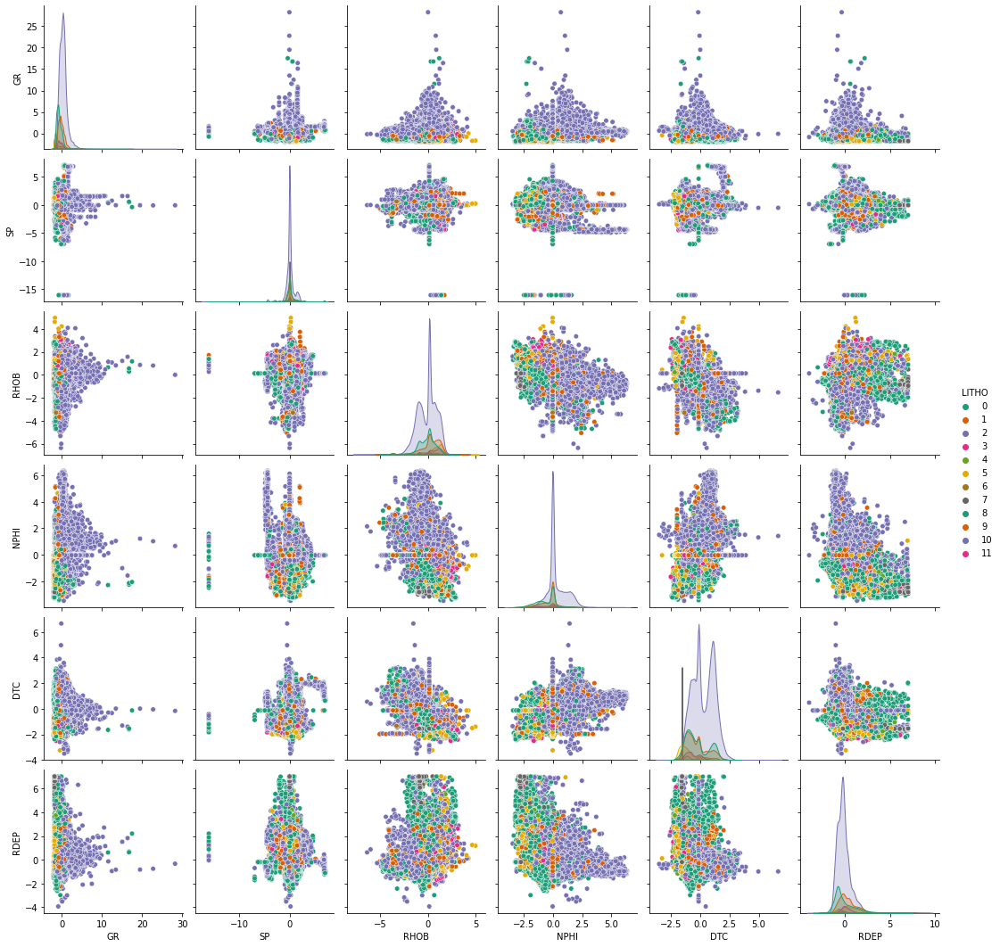

In [ ]:
#Creating a pair plot to analize data distibutions - ALL FEATURES
import seaborn as sns
sns.pairplot(data_sample, vars=['GR', 'SP', 'RHOB', 'NPHI', 'DTC', 'RDEP'], palette='Dark2', 
             hue='LITHO', diag_kind='kde', plot_kws = {'alpha': 1, 's': 30, 'marker':'o'})

## **9. OUTLIER REMOVAL**

### Outliers Removal Method

In [ ]:
from sklearn.ensemble import IsolationForest
from sklearn.covariance import EllipticEnvelope
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM

In [ ]:
#Creating a 10% sample of the standarrdized data
xs_sample, a, ys_sample, b = train_test_split(x_train_std, train_labels, train_size=0.10, shuffle=True, stratify=labeled_data1.LITHO, random_state=0)
train_data_drop = pd.concat([xs_sample, ys_sample], axis=1)
print('Data shape before removing outliers', train_data_drop.shape)
#train_data_drop

Data shape before removing outliers (117050, 24)


In [ ]:
#Base Model
model_od0 = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_od0.fit(train_data_drop.drop(['LITHO'], axis=1), train_data_drop.LITHO)
pred_od0 = model_od0.predict(x_test_std)
print('Accuracy', accuracy_score(pred_od0, test_labels))

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 85 epochs took 24 seconds
Accuracy 0.696935358881757


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   24.4s finished


In [ ]:
#Method 1: Standard Deviation Method (traditional)
train_data_std = train_data_drop[np.abs(train_data_drop-train_data_drop.mean()) <= (7*train_data_drop.std())]
train_data_std = train_data_std.dropna()           #Delete rows that have nan values if there are some
print('Shape after SD outlier removal', train_data_std.shape)

#Fitting model
model_od1 = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_od1.fit(train_data_std.drop(['LITHO'], axis=1), train_data_std.LITHO)
pred_od1 = model_od1.predict(x_test_std)
print('Accuracy', accuracy_score(pred_od1, test_labels))

Shape after SD outlier removal (113860, 24)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 15 epochs took 4 seconds
Accuracy 0.6928852367932391


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    4.4s finished


In [ ]:
#Method 2: Isolation Forest
iso = IsolationForest(contamination=0.01)
yhat = iso.fit_predict(train_data_drop)
mask = yhat != -1
train_data_iso = train_data_drop[mask]
print('Shape after IF outlier removal', train_data_iso.shape)

#Fitting model
model_od2 = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_od2.fit(train_data_iso.drop(['LITHO'], axis=1), train_data_iso.LITHO)
pred_od2 = model_od2.predict(x_test_std)
print('Accuracy', accuracy_score(pred_od2, test_labels))

Shape after IF outlier removal (115879, 24)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 311 epochs took 78 seconds
Accuracy 0.6966209992250669


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:  1.3min finished


In [ ]:
#Method 3: Local Oultlier Factor
lof = LocalOutlierFactor(contamination=0.01)
yhat = lof.fit_predict(train_data_drop)
mask = yhat != -1
train_data_lof = train_data_drop[mask]
print('Shape after LOF outlier removal', train_data_lof.shape)

#Fitting model
model_od3 = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_od3.fit(train_data_lof.drop(['LITHO'], axis=1), train_data_lof.LITHO)
pred_od3 = model_od3.predict(x_test_std)
print('Accuracy', accuracy_score(pred_od3, test_labels))

Shape after LOF outlier removal (115879, 24)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 94 epochs took 28 seconds
Accuracy 0.697220475779685


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   28.5s finished


In [ ]:
#Method 4: One-class SVM
svm = OneClassSVM(nu=0.01)
yhat = svm.fit_predict(train_data_drop)
mask = yhat != -1
train_data_svm = train_data_drop[mask]
print('Shape after SVM outlier removal', train_data_svm.shape)

#Fitting model
model_od4 = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
model_od4.fit(train_data_svm.drop(['LITHO'], axis=1), train_data_svm.LITHO)
pred_od4 = model_od4.predict(x_test_std)
print('Accuracy', accuracy_score(pred_od4, test_labels))

Shape after SVM outlier removal (115885, 24)


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


convergence after 46 epochs took 12 seconds
Accuracy 0.6946471130086412


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.3s finished


### Boxplotting Outlier Removed Data

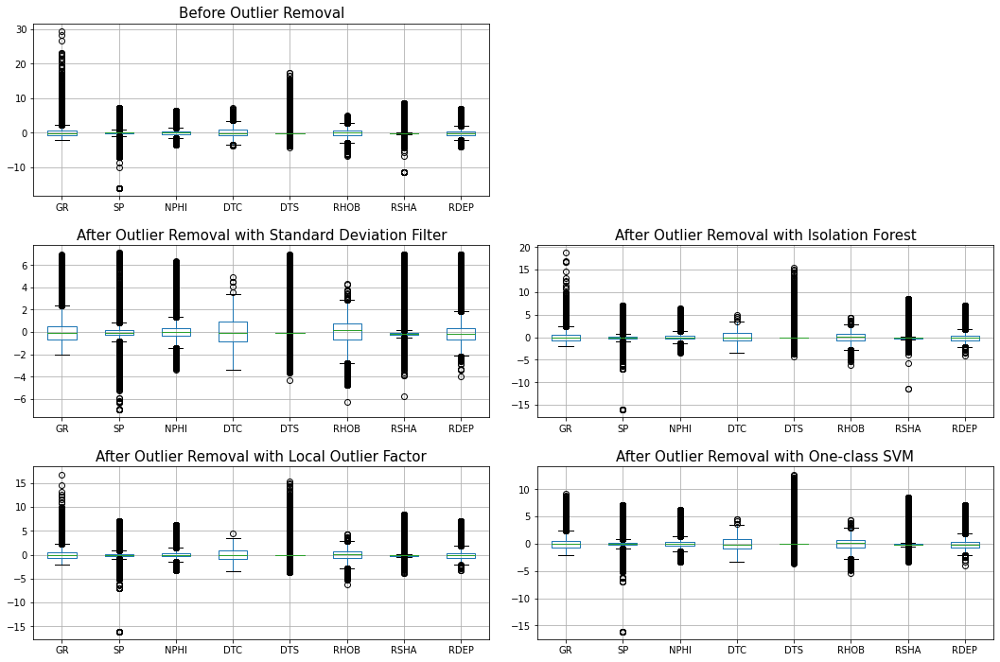

In [ ]:
#Box plotting data
box_features = ['GR', 'SP', 'NPHI', 'DTC', 'DTS', 'RHOB', 'RSHA', 'RDEP']
plt.figure(figsize=(15,10))

#Before outliers removal
plt.subplot(3,2,1)
x_train_std[box_features].boxplot()
#plt.ylim([-15, 15])
plt.title('Before Outlier Removal', size=15)

#Methods of outlier removal
plt.subplot(3,2,3)
train_data_std[box_features].boxplot()
plt.title('After Outlier Removal with Standard Deviation Filter', size=15)

plt.subplot(3,2,4)
train_data_iso[box_features].boxplot()
#plt.ylim([-10, 10])
plt.title('After Outlier Removal with Isolation Forest', size=15)

#plt.subplot(3,2,4)
#data_train_ee.boxplot()
#plt.title('After Outlier Removal with Min. Covariance', size=15)

plt.subplot(3,2,5)
train_data_lof[box_features].boxplot()
plt.title('After Outlier Removal with Local Outlier Factor', size=15)

plt.subplot(3,2,6)
train_data_svm[box_features].boxplot()
plt.title('After Outlier Removal with One-class SVM', size=15)

plt.tight_layout(1.7)
plt.show()

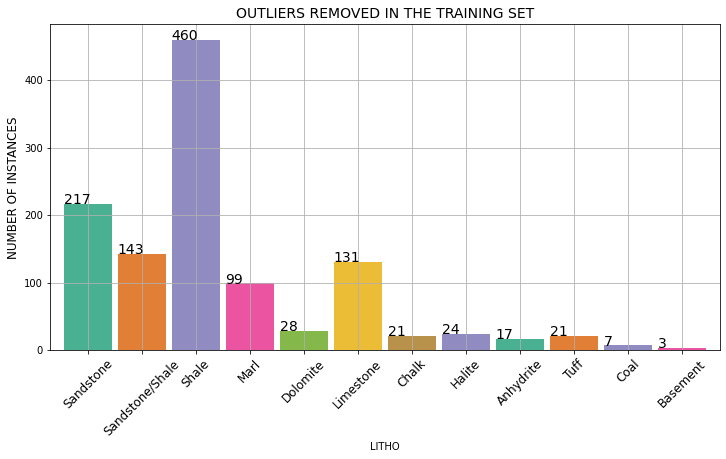

In [ ]:
#PLotting
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

lof = dict(train_data_lof.LITHO.value_counts())
raw = dict(train_data_drop.LITHO.value_counts())
new_dict = {}
for i in range(len(lof)):
  new_dict[i] = raw[i]-lof[i]

out_df = pd.DataFrame({'LITHO': new_dict.keys(),
                       'out_removed':new_dict.values(),
                      })
out_df.LITHO = out_df.LITHO.map(lithology_numbers2)

import matplotlib
cmapxx = matplotlib.cm.get_cmap('Dark2')
colors_i = []
for i in range(7):
  colors_i.append(cmapxx(i))
colors_i.append(cmapxx(2))
colors_i.append(cmapxx(0))
colors_i.append(cmapxx(1))
colors_i.append(cmapxx(2))
colors_i.append(cmapxx(3))
#print(colors_i)

ax = out_df.plot(x='LITHO', y='out_removed', kind='bar', figsize=(12,6), legend=False, width=0.9, alpha=0.8, color=colors_i)
ax.set_title('OUTLIERS REMOVED IN THE TRAINING SET', size=14)
ax.set_ylabel('NUMBER OF INSTANCES', size=12)
plt.xticks(size=12, rotation=45)
for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=14)
plt.grid(True)
plt.show()

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.

/usr/local/lib/python3.7/dist-packages/seaborn/distributions.py:306: UserWarning:

Dataset has 0 variance; skipping density estimate.



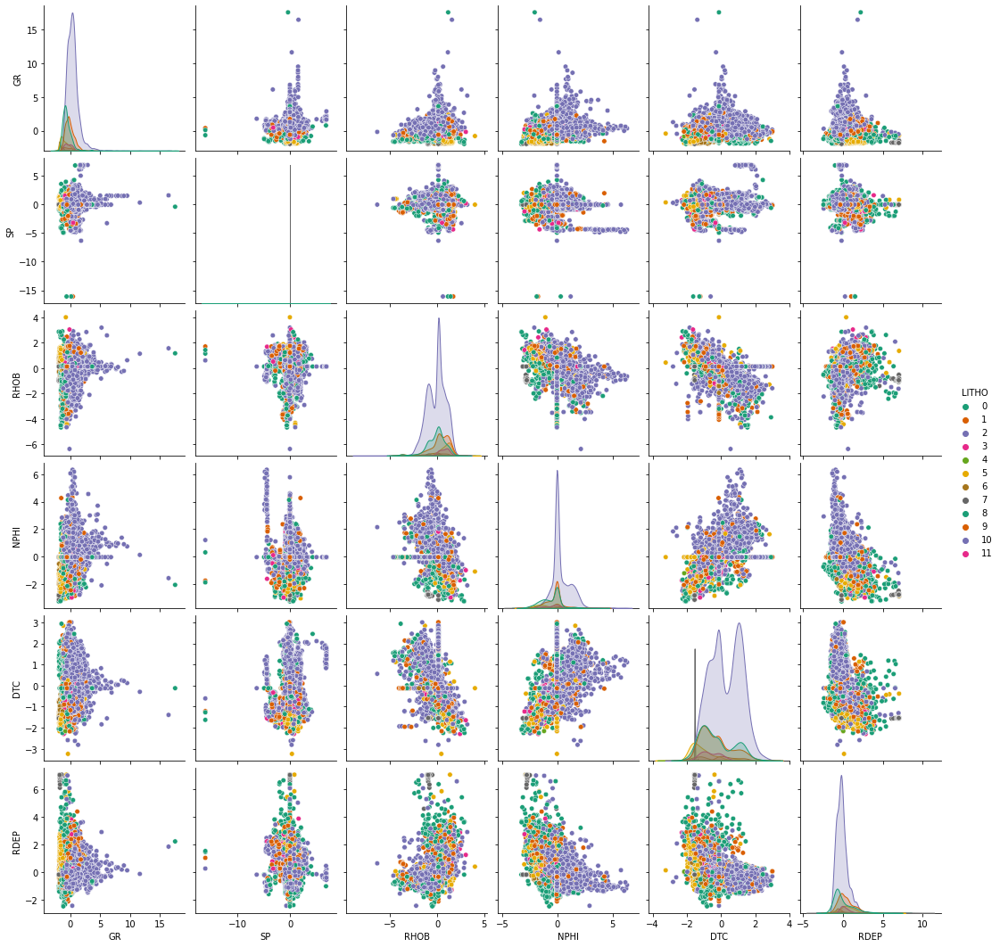

In [ ]:
#Best outlier removal method plotted
x_samp, a, y_samp, b = train_test_split(train_data_lof.drop(['LITHO'], axis=1), train_data_lof['LITHO'], train_size=0.1, shuffle=True, stratify=train_data_lof.LITHO)
data_sample = pd.concat([x_samp, y_samp], axis=1)
sns.pairplot(data_sample, vars=['GR', 'SP', 'RHOB', 'NPHI', 'DTC', 'RDEP'], palette='Dark2',
             hue='LITHO', diag_kind='kde', plot_kws = {'alpha': 1, 's': 30, 'marker':'o'})

We choose the best method: One-class SVM. Make pair-plot of data after outliers removed.

## **9.1. FEATURE SELECTION (1st attempt)**

In [ ]:
#Importing processed data
train_clean = pd.read_csv('/content/drive/MyDrive/Thesis_data/cleaned_traindata.csv')
test_clean = pd.read_csv('/content/drive/MyDrive/Thesis_data/cleaned_testdata.csv')
hidden_clean = pd.read_csv('/content/drive/MyDrive/Thesis_data/cleaned_hiddendata.csv')

In [ ]:
features_train = train_clean.drop(['NPHI', 'DTC_COMB', 'RHOB_COMB', 'DTS', 'LITHO'], axis=1)
labels_train = train_clean['LITHO']

features_test = test_clean.drop(['NPHI', 'DTC_COMB', 'RHOB_COMB', 'DTS', 'LITHO'], axis=1)
labels_test = test_clean['LITHO']

features_hidden = hidden_clean.drop(['NPHI', 'DTC_COMB', 'RHOB_COMB', 'DTS', 'LITHO'], axis=1)
labels_hidden = hidden_clean['LITHO']

#### K-Best Feature Selection

In [ ]:
#Ranking Features based on the K-Best Method
from sklearn.feature_selection import SelectKBest, chi2, f_classif
selected_features = SelectKBest(f_classif, k=5 ).fit(features_train, labels_train.values.ravel())

selected_features_df = pd.DataFrame({'feature': list(features_train.columns),
                                     'scores': selected_features.scores_})
df_new = selected_features_df.sort_values(by='scores', ascending=False)
#df_new

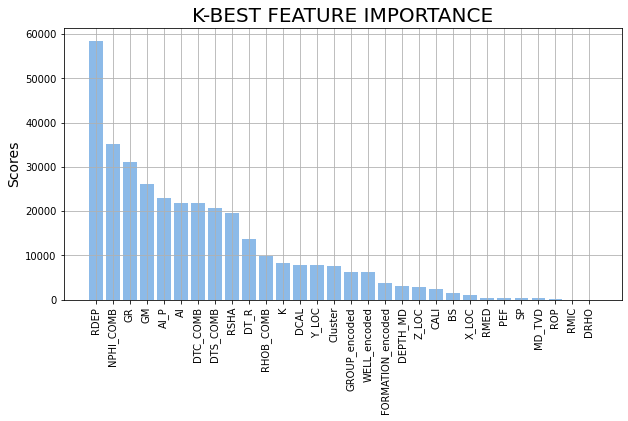

In [ ]:
#Ploting K-Best Feature Importances
#Visualizing Accuracies
f, ax = plt.subplots(figsize=(10,5))
x_pos = np.arange(len(features_train.columns))

#Create Bars
ax.bar(x_pos, df_new.scores, color=(0.5, 0.7, 0.9, 0.9))
ax.set_ylabel('Scores', size=14)
ax.set_title('K-BEST FEATURE IMPORTANCE', size=20)

plt.xticks(x_pos, df_new.feature, rotation=90)
plt.grid(True)
plt.show()

#### PCA's

In [ ]:
#PCA's IMPLEMENTATION
from sklearn.decomposition import PCA

pca = PCA()
pca_data = pca.fit_transform(x_train)
pca_test = pca.transform(x_test)
pca_hidden = pca.transform(x_hidden)
#pca_data = pca.transform(x_train)

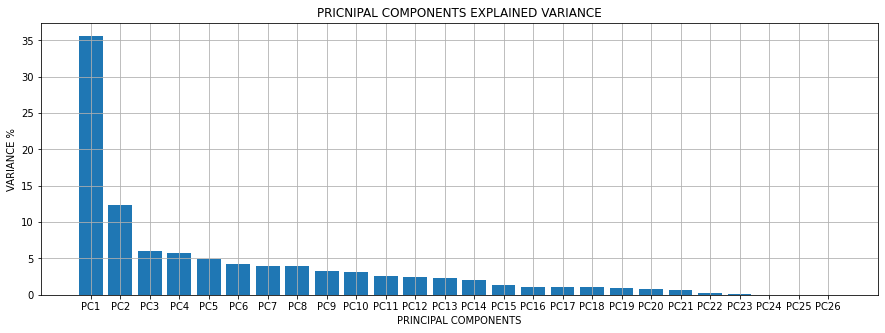

In [ ]:
per_var = np.round(pca.explained_variance_ratio_*100, decimals=1)
labels = ['PC' + str(x) for x in range(1, len(per_var)+1)]
plt.figure(figsize=(15, 5))
plt.bar(x=range(1, len(per_var)+1), height=per_var, tick_label=labels)
plt.title('PRICNIPAL COMPONENTS EXPLAINED VARIANCE')
plt.xlabel('PRINCIPAL COMPONENTS')
plt.ylabel('VARIANCE %')
plt.grid()
plt.show()

In [ ]:
pca_df_train = pd.DataFrame(pca_data, columns=labels)
pca_df_test = pd.DataFrame(pca_test, columns=labels)
pca_df_hidden = pd.DataFrame(pca_hidden, columns=labels)

In [ ]:
pca_df_hidden.columns, pca_df_test.columns

(Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
        'PC11', 'PC12', 'PC13', 'PC14', 'PC15', 'PC16', 'PC17', 'PC18', 'PC19',
        'PC20', 'PC21', 'PC22', 'PC23', 'PC24', 'PC25', 'PC26'],
       dtype='object'),
 Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
        'PC11', 'PC12', 'PC13', 'PC14', 'PC15', 'PC16', 'PC17', 'PC18', 'PC19',
        'PC20', 'PC21', 'PC22', 'PC23', 'PC24', 'PC25', 'PC26'],
       dtype='object'))

In [ ]:
x_train = pca_df_train[['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
        'PC11', 'PC12', 'PC13', 'PC14', 'PC15', 'PC16', 'PC17', 'PC18', 'PC19',
        'PC20', 'PC21', 'PC22', 'PC23', 'PC24', 'PC25', 'PC26']]
x_test = pca_df_test[['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
        'PC11', 'PC12', 'PC13', 'PC14', 'PC15', 'PC16', 'PC17', 'PC18', 'PC19',
        'PC20', 'PC21', 'PC22', 'PC23', 'PC24', 'PC25', 'PC26']]
x_hidden = pca_df_hidden[['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
        'PC11', 'PC12', 'PC13', 'PC14', 'PC15', 'PC16', 'PC17', 'PC18', 'PC19',
        'PC20', 'PC21', 'PC22', 'PC23', 'PC24', 'PC25', 'PC26']]

In [ ]:
#Predicting Lithology

from xgboost import XGBClassifier

model_500 = XGBClassifier()

model_500.fit(x_train, y_train.values, early_stopping_rounds=100, eval_set=[(x_test, y_test)], verbose=100)

train_pred_xgb = model_500.predict(x_train)
open_pred_xgb = model_500.predict(x_test)
hidden_pred_xgb = model_500.predict(x_hidden)

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_xgb))
print('Open set report:', metrics_report2(y_train.values, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_xgb))
print('Open set report:', metrics_report2(y_test.values, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_xgb))
print('Hidden set report:', metrics_report2(y_hidden.values, hidden_pred_xgb))

[0]	validation_0-mlogloss:2.20586
Will train until validation_0-mlogloss hasn't improved in 100 rounds.
[99]	validation_0-mlogloss:0.765824
-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.30787984905737753


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Open set report:               METRIC
Accuracy       88.39
F1 score       87.92
Recall         88.39
Precision      88.04
Matrix Score   -0.31
-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.6201484435541649


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Open set report:               METRIC
Accuracy       76.42
F1 score       74.03
Recall         76.42
Precision      73.53
Matrix Score   -0.62
-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.6176427935325213
Hidden set report:               METRIC
Accuracy       76.38
F1 score       74.46
Recall         76.38
Precision      74.04
Matrix Score   -0.62


## **10. MACHINE LEARNING AND DEEP LEARNING FOR CLASSIFICATION IMPLEMENTATION**

In [ ]:
#pip install PyLMNN

In [ ]:
#Supervised Algorithms
from sklearn import model_selection
from sklearn.model_selection import train_test_split, GridSearchCV, RandomizedSearchCV
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier
from sklearn.svm import SVC
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import mean_squared_error, accuracy_score, recall_score, precision_score, f1_score
from sklearn.neighbors import KNeighborsRegressor
from pprint import pprint
from sklearn.model_selection import StratifiedKFold
from sklearn.naive_bayes import GaussianNB
import xgboost
from xgboost import XGBClassifier
from sklearn import neighbors

In [ ]:
#K-Best Feature Selection 
all_features = ['RDEP','GR', 'NPHI_COMB', 'GM', 'AI_P', 'AI', 'DTC', 'DTS_COMB', 'RSHA', 'DT_R', 'RHOB', 
                  'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded', 'WELL_encoded', 'FORMATION_encoded', 
                  'DEPTH_MD', 'Z_LOC', 'CALI', 'BS', 'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'ROP','RMIC','DRHO'
                  ]

x_train = train_clean[all_features]
y_train = train_clean['LITHO']

x_test = test_clean[all_features]
y_test = test_clean['LITHO']

x_hidden = hidden_clean[all_features]
y_hidden = hidden_clean['LITHO']

### **OVERVIEW - BASE MODELS**


In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

#### Base Models Comparition

In [ ]:
#Comparing base models accuracies by using k-fold cross validation - 10 folds
from sklearn.model_selection import cross_val_score, KFold

estimators = [neighbors.KNeighborsClassifier(), LogisticRegression(C=1e-3, solver='saga', max_iter=4000), DecisionTreeClassifier(), RandomForestClassifier(), XGBClassifier(), SVC()]
kf = KFold(n_splits=10)

acc_train_scores = []
i=1
for estimator in estimators:
  acc_score_i = cross_val_score(estimator, x_train_strat, y_train_strat, cv=kf, scoring='accuracy').mean()
  acc_train_scores.append(acc_score_i)

  print('---------------MODEL {} ACCURACY {}---------------'.format(i, acc_score_i))
  i += 1
#print(f1_train_scores)

---------------MODEL 1 ACCURACY 0.8911414731402049---------------
---------------MODEL 2 ACCURACY 0.7172941794162009---------------
---------------MODEL 3 ACCURACY 0.8674680366691474---------------
---------------MODEL 4 ACCURACY 0.9160024260916739---------------
---------------MODEL 5 ACCURACY 0.8260416331402283---------------
---------------MODEL 6 ACCURACY 0.8478526424817978---------------


In [ ]:
model_names = ['K-Nearest Neighbor', 'Logistic Regression', 'Decision Trees', 'Random Forest', 'XGBoosting', 'Support Vector Machines', 'Neural Network', 'CatBoosting', 'LightBoosting']
f1_train_scores = [0.920, 0.717, 0.867, 0.92, 0.826, 0.847, 0.763, 0.93, 0.84]
base_models = pd.DataFrame(np.around(f1_train_scores,3), model_names, columns=['ACCURACY']).sort_values('ACCURACY', ascending=False)
base_models

,ACCURACY
CatBoosting,0.93
K-Nearest Neighbor,0.92
Random Forest,0.92
Decision Trees,0.87
Support Vector Machines,0.85
LightBoosting,0.84
XGBoosting,0.83
Neural Network,0.76
Logistic Regression,0.72


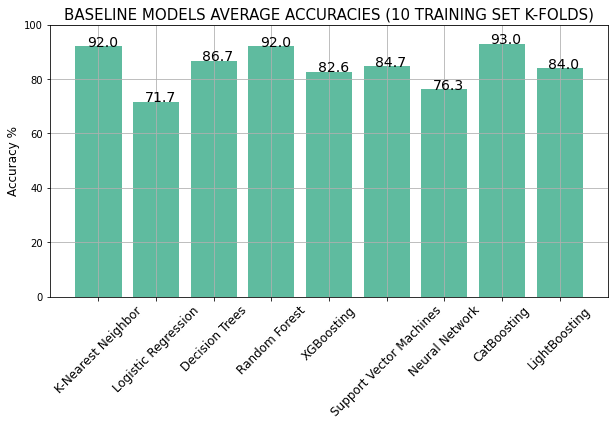

In [ ]:
#Visualizing Accuracies
import matplotlib
f, ax = plt.subplots(figsize=(10,5))
x_pos = np.arange(len(model_names))

#Create Bars
ax.bar(x_pos, np.array(f1_train_scores)*100, color=matplotlib.cm.get_cmap('Dark2')(0), alpha=.7)
ax.set_ylabel('Accuracy %', size=12)
ax.set_ylim(0, 100)
ax.set_title('BASELINE MODELS AVERAGE ACCURACIES (10 TRAINING SET K-FOLDS)', size=15)
plt.xticks(x_pos, model_names, rotation=45, size=12)

for p in ax.patches:
    ax.annotate(str(p.get_height()), (p.get_x()+0.2, p.get_height()), size=14)
plt.grid(True)
plt.show()


### **A. STANDARD METHODS**


#### **A1. LOGISTIC REGRESSION (FINISHED)**



##### Base Model

In [1]:
#from sklearn.utils.class_weight import compute_class_weight
#weights = compute_class_weight('balanced', y_train_strat.unique(), y_train_strat)
#class_weight = dict(zip(y_train_strat.unique(), weights))
#class_weight

In [ ]:
#Base Model
base_lr = LogisticRegression(C=1e-3, solver="saga", max_iter=4000, verbose=1)
base_lr.fit(x_train_strat, y_train_strat)

train_pred = base_lr.predict(x_train_strat)
test_pred = base_lr.predict(x_test)
hidden_pred = base_lr.predict(x_hidden)

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, train_pred))
print('Training set report:', metrics.classification_report(y_train_strat.values, train_pred))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred))
print('Open set report:', metrics.classification_report(y_test, test_pred))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred))

Feature Selection

In [ ]:
#Feature selection by recursive feature elimination
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
import warnings
warnings.filterwarnings('ignore')

base_cat = LogisticRegression(solver='saga', max_iter=40000, verbose=1)
rfe_cat = RFECV(estimator=base_cat, step=1, min_features_to_select=2, cv=StratifiedKFold(10), scoring='accuracy', verbose=1)
rfe_cat.fit(x_train_strat, y_train_strat)

In [ ]:
print('Optimal number of features: {}'.format(rfe_cat.n_features_))

#Plotting Data
plt.figure(figsize=(8, 8))
num_features = list(range(1, len(rfe_cat.grid_scores_)+1))
scores = list(rfe_cat.grid_scores_)
plt.plot(num_features, rfe_cat.grid_scores_, color='#303F9F', linewidth=3, label='Train Accuracy')
plt.axvline(num_features[scores.index(np.array(scores).max())], c='g', ls='--', label='Optimal number of features = 29')
plt.title('LOGISTIC REGRESSION FEATURE ELIMINATION')
plt.xlabel('NUMBER OF FEATURES')
plt.ylabel('ACURACY')
plt.xlim(0,30)
plt.legend()
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

In [ ]:
x_train.columns

In [ ]:
rfe_cat.estimator_.coef_.shape

In [ ]:
dset = pd.DataFrame()
dset['attr'] = x_train.columns
dset['importance'] = abs(rfe_cat.estimator_.coef_[0])
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(10, 8))
plt.barh(y=dset['attr'], width=dset['importance'])
plt.title('LOGISTIC REGRESSION RECURSIVE FEATURE IMPORTANCE')
plt.xlabel('Score')
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
#new_set = x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)
for i in range(12):
  dset = pd.DataFrame()
  dset['attr'] = x_train.columns
  dset['importance'] = rfe_cat.estimator_.coef_[i]
  dset = dset.sort_values(by='importance', ascending=False)

  plt.figure(figsize=(10, 8))
  plt.barh(y=dset['attr'], width=dset['importance'])
  plt.title('LOGISTIC REGRESSION RECURSIVE FEATURE IMPORTANCE')
  plt.xlabel('Score')
  plt.grid()

In [ ]:
#Permutation Feature Importance
from sklearn.inspection import permutation_importance

model1 = LogisticRegression(C=1000, solver='saga', max_iter=40000, verbose=1)
model1.fit(x_train_strat, y_train_strat)
results = permutation_importance(model1, x_train_strat, y_train_strat, scoring='accuracy')
importance = results.importances_mean

#Plotting feature importance
df_lf_import = pd.DataFrame({'feature': list(x_train_strat.columns),
                             'importances': importance}).sort_values(by='importances', ascending=False)

f, ax = plt.subplots(figsize=(10,5))
ax.bar(np.arange(len(x_train_strat.columns)), df_lf_import.importances, color=(0.5, 0.7, 0.9, 0.9))
ax.set_ylabel('Importance scores', size=14)
ax.set_title('LOGISTIC REGRESSION PERMUTATION FEATURE IMPORTANCE', size=20)
plt.xticks(np.arange(len(x_train_strat.columns)), df_lf_import.feature, rotation=90)
plt.grid(); plt.show()

In [ ]:
#Feature elimination 
from mlxtend.feature_selection import SequentialFeatureSelector
sbs = SequentialFeatureSelector(model1, k_features = (3, 30), forward=True, floating=False, cv=0)
sbs.fit(x_train_strat, y_train_strat)
sbs.k_feature_names_

In [ ]:
from mlxtend.plotting import plot_sequential_feature_selection as plot_sfs
import matplotlib.pyplot as plt

fig1 = plot_sfs(sbs.get_metric_dict(), kind='std_dev')
plt.title('Sequential Forward Selection (w. StdErr)')
plt.grid()
plt.show()

##### Hyper-parameters tuning

In [ ]:
features_selected_lr = ['DTS_COMB', 'GM', 'AI_P', 'GR', 
                        'NPHI_COMB', 'DTC', 'RHOB', 'DT_R', 
                        'Z_LOC', 'AI','K
                        ]

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train[features_selected_lr], y_train, train_size=0.01, shuffle=True, stratify=y_train)

In [ ]:
#Tunning C parameter

c_values = [0.0001, 0.0005, 0.001, 0.005, 0.01, 0.05, 0.1, 0.5, 1, 3, 7, 10, 50, 100, 500, 1000]

train_accuracies = []
test_accuracies = []
for c_i in c_values:
  print('-------------------INVERSE OF REGULARIZATION STRENGHT: {}---------------------'.format(c_i))
  model_i = LogisticRegression(C = c_i, solver='saga', 
                               max_iter=40000, 
                               verbose=1 
                               )

  model_i.fit(x_train_strat, y_train_strat)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[features_selected_lr]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[features_selected_lr]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Inverse Regularization Strenght: {}, Train accuracy {} and test accuracy {}'.format(c_i, acc_train, acc_test))

In [ ]:
#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
log_c = np.log(c_values)
ax.plot(log_c, train_accuracies, '-b', label = 'train')
ax.plot(log_c, test_accuracies, '--r', label = 'test')
plt.axvline(log_c[test_accuracies.index(np.array(test_accuracies).max())], 
                                                              c='g', ls='--', label='Optimal C Factor = 0.1')
ax.legend(loc='lower right', fontsize=13)
plt.title('LOG INVERSE OF REGULARIZATION STRENGHT FACTOR (C) vs. ACCURACY', size=14)
plt.xlabel('Log Inverse Regularization Factor -- log(C)', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

##### Tuned Model

In [ ]:
#Tunned model performance
model_lr_tuned = LogisticRegression(C=0.1, solver='saga', max_iter=4000, verbose=1)
model_lr_tuned.fit(x_train_strat, y_train_strat)

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, model_lr_tuned.predict(x_train_strat)))
print('Training set report:', metrics.classification_report(y_train_strat, model_lr_tuned.predict(x_train_strat)))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, model_lr_tuned.predict(x_test)))
print('Open set report:', metrics.classification_report(y_test, model_lr_tuned.predict(x_test)))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, model_lr_tuned.predict(x_hidden)))
print('Hidden set report:', metrics.classification_report(y_hidden, model_lr_tuned.predict(x_hidden)))

In [ ]:
train_lr_res = labeled_data.copy()
test_lr_res = test_data.copy()
hidden_lr_res = hidden_data.copy()

In [ ]:
train_lr_res['LR_TM'] = model_lr_tuned.predict(x_train)
test_lr_res['LR_TM'] = model_lr_tuned.predict(x_test)
hidden_lr_res['LR_TM'] = model_lr_tuned.predict(x_hidden)

In [ ]:
#Saving results 3 methods
train_lr_res.to_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/train_lr_f_res.csv', index=False)
test_lr_res.to_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/test_lr_f_res.csv', index=False)
hidden_lr_res.to_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/hidden_lr_f_res.csv', index=False)

##### Plotting Results

In [ ]:
#Importing files
train_lr_res = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/train_lr_f_res.csv')
test_lr_res = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/test_lr_f_res.csv')
hidden_lr_res = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/hidden_lr_f_res.csv')

In [ ]:
litho_confusion_matrix(hidden_lr_res.LITHO, hidden_lr_res.LR_TM)

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_lr_res, i, facies_colors, 1)

#### **A2. K-NEAREST NEIGHBOUR (FINISEHD)**

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

#####Base Model


In [ ]:
#Base Model
model_knn = neighbors.KNeighborsClassifier()
model_knn.fit(x_train_strat, y_train_strat)

train_pred_knn = model_knn.predict(x_train_strat)
test_pred_knn = model_knn.predict(x_test)
hidden_pred_knn = model_knn.predict(x_hidden)

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, train_pred_knn))
print('Training set report:', metrics.classification_report(y_train_strat.values, train_pred_knn))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred_knn))
print('Open set report:', metrics.classification_report(y_test, test_pred_knn))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_knn))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_knn))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.20182441841590418
Training set report:               precision    recall  f1-score   support

           0       0.89      0.90      0.90     16894
           1       0.85      0.82      0.84     15045
           2       0.95      0.97      0.96     72080
           3       0.89      0.86      0.88      3333
           4       0.80      0.38      0.51       169
           5       0.91      0.74      0.82      5632
           6       0.97      0.92      0.94      1051
           7       0.99      0.99      0.99       821
           8       0.92      0.88      0.90       109
           9       0.89      0.94      0.91      1525
          10       0.87      0.59      0.70       382
          11       1.00      0.70      0.82        10

    accuracy                           0.92    117051
   macro avg       0.91      0.81      0.85    117051
weighted avg       0.92      0.92      0.92    117

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.6750196083237334
Hidden set report:               precision    recall  f1-score   support

           0       0.61      0.62      0.61     14045
           1       0.38      0.38      0.38     12283
           2       0.85      0.87      0.86     71827
           3       0.43      0.35      0.39      4396
           4       0.00      0.00      0.00       287
           5       0.54      0.53      0.54      8374
           6       0.62      0.46      0.53      2905
           7       0.99      0.94      0.96      6498
           8       0.67      0.70      0.68       597
           9       0.52      0.51      0.52       941
          10       0.90      0.53      0.67       244

    accuracy                           0.74    122397
   macro avg       0.59      0.54      0.56    122397
weighted avg       0.74      0.74      0.74    122397



#####Feature Importance

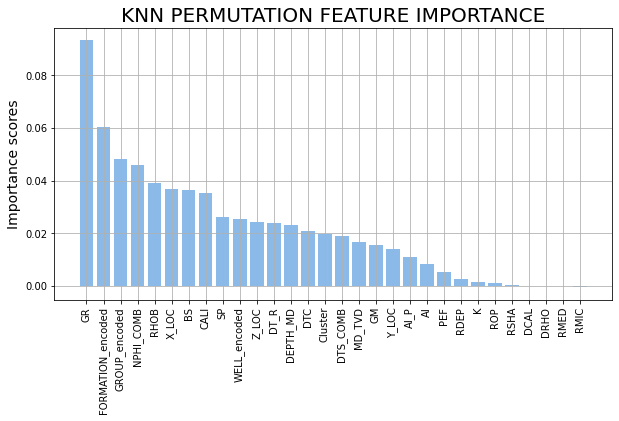

In [ ]:
#Base Model
model_knn = neighbors.KNeighborsClassifier()
model_knn.fit(x_train_strat, y_train_strat)

#Permutation Feature Importance
from sklearn.inspection import permutation_importance

results = permutation_importance(model_knn, x_train_strat, y_train_strat, scoring='accuracy')
importance = results.importances_mean

#Plotting feature importance
df_lf_import = pd.DataFrame({'feature': list(x_train_strat.columns),
                             'importances': importance}).sort_values(by='importances', ascending=False)

f, ax = plt.subplots(figsize=(10,5))
ax.bar(np.arange(len(x_train_strat.columns)), df_lf_import.importances, color=(0.5, 0.7, 0.9, 0.9))
ax.set_ylabel('Importance scores', size=14)
ax.set_title('KNN PERMUTATION FEATURE IMPORTANCE', size=20)
plt.xticks(np.arange(len(x_train_strat.columns)), df_lf_import.feature, rotation=90)
plt.grid(); plt.show()

#####New Base model with selected features

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

In [ ]:
selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster', 'DTS_COMB', 'MD_TVD', 'GM', 'Y_LOC', 'AI_P', 'AI', 'PEF', 'RDEP', 'K', 'ROP', 'RSHA', 'DCAL', 'DRHO', 'RMED', 'RMIC']

train_acc = []; test_ac=[]
for i in list(np.arange(5, 35, 5)):
  features_sub = selectedfeatures_knn[0:i]
  model_knn = neighbors.KNeighborsClassifier()
  model_knn.fit(x_train_strat[features_sub], y_train_strat)

  train_acc_i = accuracy_score(y_train_strat, model_knn.predict(x_train_strat[features_sub])); train_acc.append(train_acc_i)
  test_acc_i = accuracy_score(y_test, model_knn.predict(x_test[features_sub])); test_ac.append(test_ac)
  print('Number of fetaures {}, treain accuracy {}, test accuracy {}'.format(i, train_acc_i, test_acc_i))

Number of fetaures 5, treain accuracy 0.8718934481550777, test accuracy 0.6652873832117322
Number of fetaures 10, treain accuracy 0.9234179972832355, test accuracy 0.7217624610705774
Number of fetaures 15, treain accuracy 0.927843418680746, test accuracy 0.7222815200386005
Number of fetaures 20, treain accuracy 0.9267755081118487, test accuracy 0.7282616642054012
Number of fetaures 25, treain accuracy 0.9251693706162271, test accuracy 0.7213018876200781
Number of fetaures 30, treain accuracy 0.9248190959496287, test accuracy 0.7215650724489349


In [ ]:
train_acc = [0.6936036428565326,0.7884597312282681,0.8013600909005476,0.8422055343397322,0.8718934481550777, 0.9083391000504054, 0.9118418467163886,
             0.9168652980324815, 0.9221621344542122, 0.9234179972832355, 0.9268011379655022, 0.9266131857053763, 0.9274077111686359, 0.9278263321116437, 0.927843418680746,
             0.9267755081118487, 0.9251693706162271, 0.9248190959496287]
test_acc = [0.6024154518737298, 0.6710408959981284, 0.6695787580600354, 0.6617782521603088, 0.6652873832117322,0.7328600880207039,0.7232684631468133,
            0.7184287865717252, 0.7038147178804849, 0.7217624610705774, 0.7221937917623149, 0.7055327299577442, 0.7032079306361763, 0.7110669220534265, 0.7222815200386005,
            0.7282616642054012, 0.7213018876200781, 0.7215650724489349]
num_features = [1,2,3,4,5,6,7,8,9,10,11,12,13,14,15, 20, 25, 30]


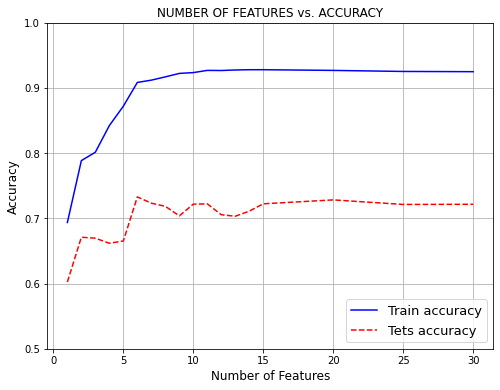

In [ ]:
  #Plotting results 
  fig, ax = plt.subplots(figsize=(8, 6))
  ax.plot(num_features, train_acc, '-b', label = 'Train accuracy')
  ax.plot(num_features, test_acc, '--r', label = 'Tets accuracy')
  ax.legend(loc='lower right', fontsize=13)
  plt.title('NUMBER OF FEATURES vs. ACCURACY')
  plt.ylim(0.5, 1)
  plt.xlabel('Number of Features', size=12)
  plt.ylabel('Accuracy', size=12)
  plt.grid()

In [ ]:
selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']
 
#Base Model
model_knn = neighbors.KNeighborsClassifier()
model_knn.fit(x_train_strat[selectedfeatures_knn], y_train_strat)

train_pred_knn = model_knn.predict(x_train_strat[selectedfeatures_knn])
test_pred_knn = model_knn.predict(x_test[selectedfeatures_knn])
hidden_pred_knn = model_knn.predict(x_hidden[selectedfeatures_knn])

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, train_pred_knn))
print('Training set report:', metrics.classification_report(y_train_strat.values, train_pred_knn))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred_knn))
print('Open set report:', metrics.classification_report(y_test, test_pred_knn))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_knn))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_knn))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.19350005553134958
Training set report:               precision    recall  f1-score   support

           0       0.90      0.91      0.90     16894
           1       0.85      0.83      0.84     15045
           2       0.95      0.97      0.96     72080
           3       0.89      0.87      0.88      3333
           4       0.78      0.42      0.55       169
           5       0.92      0.74      0.82      5632
           6       0.96      0.93      0.95      1051
           7       1.00      1.00      1.00       821
           8       0.94      0.94      0.94       109
           9       0.89      0.94      0.91      1525
          10       0.88      0.62      0.73       382
          11       1.00      0.80      0.89        10

    accuracy                           0.93    117051
   macro avg       0.91      0.83      0.86    117051
weighted avg       0.93      0.93      0.93    117

##### Hyper parameter optimization



In [ ]:
selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

train_acc = []; test_ac=[]
for i in np.arange(10, 250, 10):
  model_knn = neighbors.KNeighborsClassifier(n_neighbors=i)
  model_knn.fit(x_train_strat[selectedfeatures_knn], y_train_strat)

  train_acc_i = accuracy_score(y_train_strat, model_knn.predict(x_train_strat[selectedfeatures_knn])); train_acc.append(train_acc_i)
  test_acc_i = accuracy_score(y_test, model_knn.predict(x_test[selectedfeatures_knn])); test_ac.append(test_ac)
  print('Number of neighbors {}, treain accuracy {}, test accuracy {}'.format(i, train_acc_i, test_acc_i))

Number of neighbors 10, treain accuracy 0.9064339475954926, test accuracy 0.7296141417981372
Number of neighbors 20, treain accuracy 0.8885272231762223, test accuracy 0.7361791411401751
Number of neighbors 30, treain accuracy 0.8758831620404781, test accuracy 0.7318219700846578
Number of neighbors 40, treain accuracy 0.8671860983673784, test accuracy 0.7357478104484377
Number of neighbors 50, treain accuracy 0.859326276580294, test accuracy 0.7395274370184083
Number of neighbors 60, treain accuracy 0.8533716072481227, test accuracy 0.7373196087318877
Number of neighbors 70, treain accuracy 0.8476390633142818, test accuracy 0.7390229994297662
Number of neighbors 80, treain accuracy 0.8430256896566454, test accuracy 0.741610983580191
Number of neighbors 90, treain accuracy 0.8390872354785521, test accuracy 0.7417498866843097
Number of neighbors 100, treain accuracy 0.8354221664060965, test accuracy 0.7405070694369307
Number of neighbors 110, treain accuracy 0.832859181040743, test accura

In [ ]:
selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

train_acc = []; test_ac=[]
for i in np.arange(1,11, 1):
  model_knn = neighbors.KNeighborsClassifier(n_neighbors=i)
  model_knn.fit(x_train_strat[selectedfeatures_knn], y_train_strat)

  train_acc_i = accuracy_score(y_train_strat, model_knn.predict(x_train_strat[selectedfeatures_knn])); train_acc.append(train_acc_i)
  test_acc_i = accuracy_score(y_test, model_knn.predict(x_test[selectedfeatures_knn])); test_ac.append(test_ac)
  print('Number of neighbors {}, treain accuracy {}, test accuracy {}'.format(i, train_acc_i, test_acc_i))

Number of neighbors 1, treain accuracy 1.0, test accuracy 0.6748863187753132
Number of neighbors 2, treain accuracy 0.9483985613108816, test accuracy 0.6866126650388198
Number of neighbors 3, treain accuracy 0.9451264833277802, test accuracy 0.7090784144576199
Number of neighbors 4, treain accuracy 0.932772893866776, test accuracy 0.7080549179009548
Number of neighbors 5, treain accuracy 0.927843418680746, test accuracy 0.7222815200386005
Number of neighbors 6, treain accuracy 0.9217007970884487, test accuracy 0.7197593320953899
Number of neighbors 7, treain accuracy 0.9174975010892688, test accuracy 0.7291462576579475
Number of neighbors 8, treain accuracy 0.9126705453178529, test accuracy 0.7275232845466642
Number of neighbors 9, treain accuracy 0.9095607897412239, test accuracy 0.7315076104279677
Number of neighbors 10, treain accuracy 0.9064339475954926, test accuracy 0.7296141417981372


In [ ]:
train_acc = [1.0, 0.9451264833277802, 0.927843418680746, 0.9174975010892688, 0.9064339475954926, 0.8885272231762223, 0.8758831620404781, 0.8671860983673784, 0.859326276580294, 0.8533716072481227, 0.8476390633142818,
             0.8430256896566454, 0.8390872354785521, 0.8354221664060965, 0.832859181040743, 0.8290317895618149, 0.8258366011396742, 0.8224705470265098,
             0.8201980333358964, 0.816831979222732, 0.814106671450906, 0.8119793935976626, 0.8099033754517262, 0.8064946049158059, 0.8048372077128773, 
             0.8027270164287362, 0.8016761924289413, 0.800377613177162]

test_acc = [0.6748863187753132, 0.7090784144576199, 0.7222815200386005, 0.7291462576579475, 0.7296141417981372, 0.7361791411401751, 0.7318219700846578, 0.7357478104484377, 0.7395274370184083, 0.7373196087318877,  0.7390229994297662,
            0.741610983580191, 0.7417498866843097, 0.7405070694369307, 0.7395420583977892, 0.7391180383957423, 0.741186963578144, 0.7434167239337359,
            0.7449007939409004, 0.7457561446346849, 0.7451201146316143, 0.7445571915254485, 0.7440746860058778, 0.7434898308306406, 0.7427148977234512, 
            0.7422689456523328, 0.7421739066863567, 0.7411357887503107]

n_neighboors = [1, 3, 5, 7, 10,  20,  30,  40,  50,  60,  70,  80,  90, 100, 110, 120, 130,
                140, 150, 160, 170, 180, 190, 200, 210, 220, 230, 240]

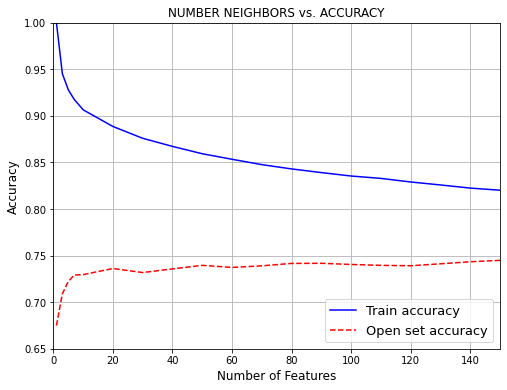

In [ ]:
  #Plotting results 
  fig, ax = plt.subplots(figsize=(8, 6))
  ax.plot(n_neighboors, train_acc, '-b', label = 'Train accuracy')
  ax.plot(n_neighboors, test_acc, '--r', label = 'Open set accuracy')
  ax.legend(loc='lower right', fontsize=13)
  plt.title('NUMBER NEIGHBORS vs. ACCURACY')
  plt.ylim(0.65, 1)
  plt.xlim(0,150)
  plt.xlabel('Number of Features', size=12)
  plt.ylabel('Accuracy', size=12)
  plt.grid()

In [ ]:
#Hyper-parameter tuning (10%)

selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']

model_knn = neighbors.KNeighborsClassifier(n_neighbors=80)
grid_knn = {
            'weights': ['uniform', 'distance'],
            'metric': ['euclidean', 'manhattan', 'minkowski']
           }

kf_knn = StratifiedKFold(n_splits=5, shuffle=True, random_state=0)
clf_knn = GridSearchCV(estimator=model_knn, param_grid=grid_knn, cv=kf_knn, n_jobs=1, scoring='accuracy', verbose=1)
clf_knn.fit(x_train_strat[selectedfeatures_knn], y_train_strat)

print("Best score is: {}".format(clf_knn.best_score_))
print("Tuned Model Parameter: {}".format(clf_knn.best_params_))

Fitting 5 folds for each of 6 candidates, totalling 30 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done  30 out of  30 | elapsed:  7.8min finished


Best score is: 0.8672800996388096
Tuned Model Parameter: {'metric': 'manhattan', 'weights': 'distance'}


##### Optimized model

In [ ]:
#Stratified Sample
selectedfeatures_knn = ['GR', 'FORMATION_encoded', 'GROUP_encoded', 'NPHI_COMB', 'RHOB', 'X_LOC', 'BS', 'CALI', 'SP', 'WELL_encoded', 'Z_LOC', 'DT_R', 'DEPTH_MD',
                        'DTC', 'Cluster']
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

#Base Model
model_knn = neighbors.KNeighborsClassifier(n_neighbors=80, weights='distance', metric='manhattan')
model_knn.fit(x_train_strat[selectedfeatures_knn], y_train_strat)

train_pred_knn = model_knn.predict(x_train_strat[selectedfeatures_knn])
test_pred_knn = model_knn.predict(x_test[selectedfeatures_knn])
hidden_pred_knn = model_knn.predict(x_hidden[selectedfeatures_knn])

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, train_pred_knn))
print('Training set report:', metrics.classification_report(y_train_strat.values, train_pred_knn))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred_knn))
print('Open set report:', metrics.classification_report(y_test, test_pred_knn))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_knn))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_knn))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: 0.0
Training set report:               precision    recall  f1-score   support

           0       1.00      1.00      1.00     16894
           1       1.00      1.00      1.00     15045
           2       1.00      1.00      1.00     72080
           3       1.00      1.00      1.00      3333
           4       1.00      1.00      1.00       169
           5       1.00      1.00      1.00      5632
           6       1.00      1.00      1.00      1051
           7       1.00      1.00      1.00       821
           8       1.00      1.00      1.00       109
           9       1.00      1.00      1.00      1525
          10       1.00      1.00      1.00       382
          11       1.00      1.00      1.00        10

    accuracy                           1.00    117051
   macro avg       1.00      1.00      1.00    117051
weighted avg       1.00      1.00      1.00    117051

------------

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.5599330457445852
Hidden set report:               precision    recall  f1-score   support

           0       0.75      0.69      0.72     14045
           1       0.47      0.27      0.34     12283
           2       0.84      0.94      0.89     71827
           3       0.66      0.29      0.40      4396
           4       0.00      0.00      0.00       287
           5       0.53      0.64      0.58      8374
           6       0.68      0.47      0.55      2905
           7       0.97      1.00      0.99      6498
           8       0.93      0.49      0.64       597
           9       0.51      0.46      0.49       941
          10       0.93      0.37      0.53       244

    accuracy                           0.78    122397
   macro avg       0.66      0.51      0.56    122397
weighted avg       0.76      0.78      0.76    122397



In [ ]:
#Storing results
train_knn_res = labeled_data.copy()
test_knn_res = test_data.copy()
hidden_knn_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_knn_res['KNN_TM'] = train_pred_knn
test_knn_res['KNN_TM'] = test_pred_knn
hidden_knn_res['KNN_TM'] = hidden_pred_knn

In [ ]:
#Saving results 3 methods
train_knn_res.to_csv('/content/drive/MyDrive/Results_folder/KNN/train_knn_final_res.csv', index=False)
test_knn_res.to_csv('/content/drive/MyDrive/Results_folder/KNN/test_knn_final_res.csv', index=False)
hidden_knn_res.to_csv('/content/drive/MyDrive/Results_folder/KNN/hidden_knn_final_res.csv', index=False)

#####Plotting results

In [ ]:
#Importing results csv files
train_knn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/train_knn_RES.csv')
test_knn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/test_knn_RES.csv')
hidden_knn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/hidden_knn_RES.csv')

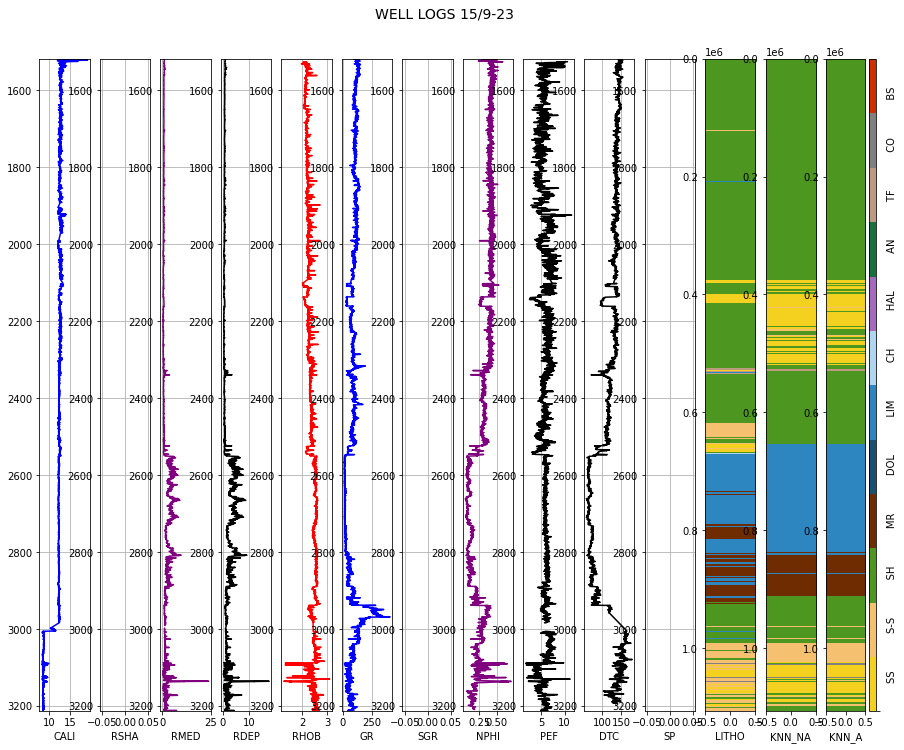

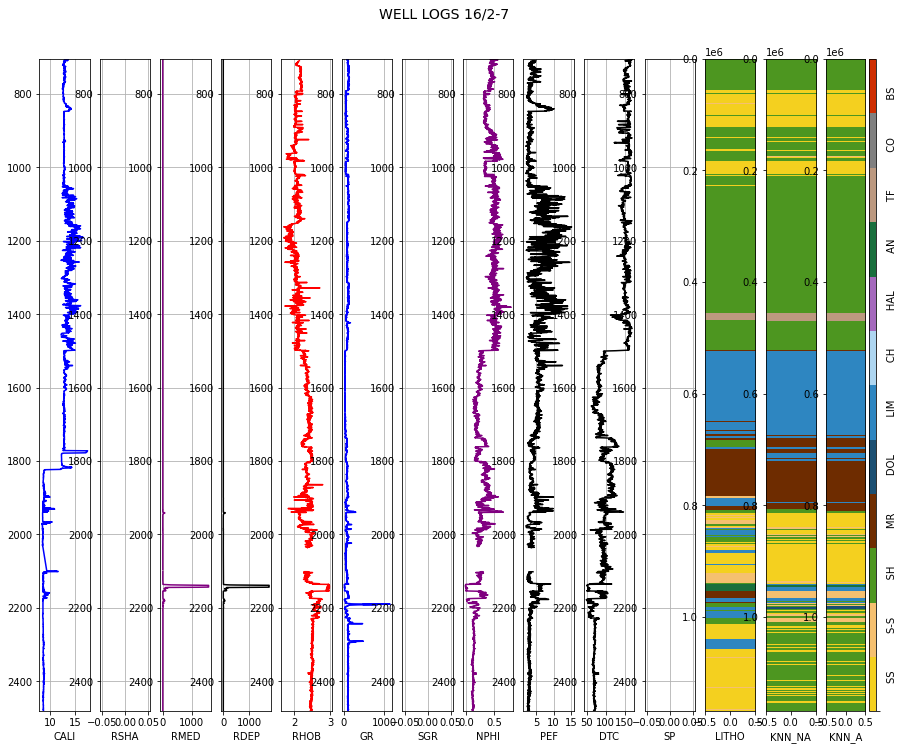

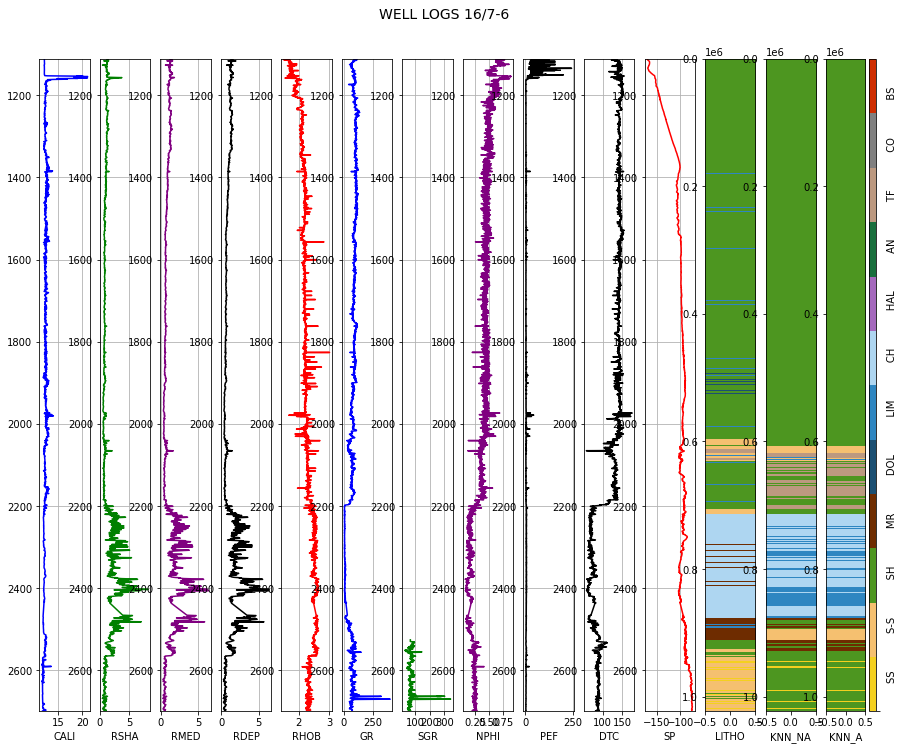

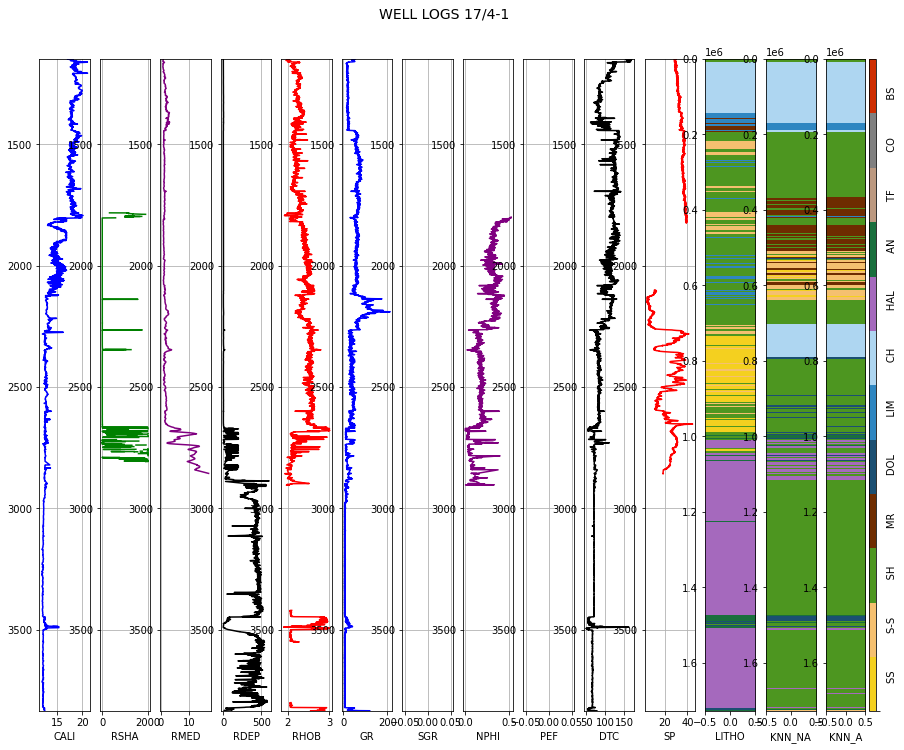

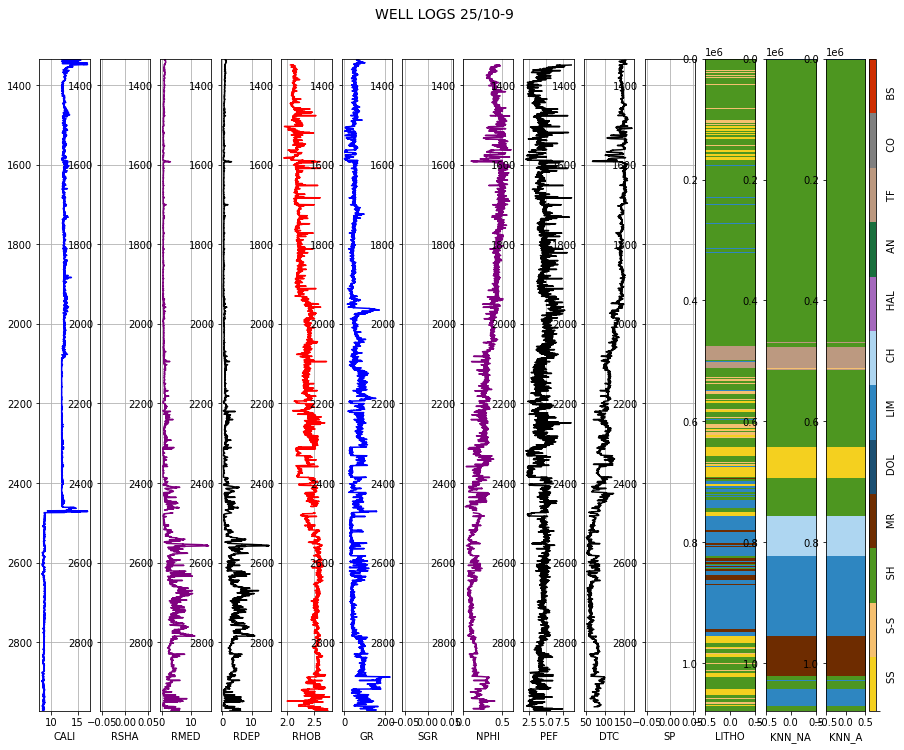

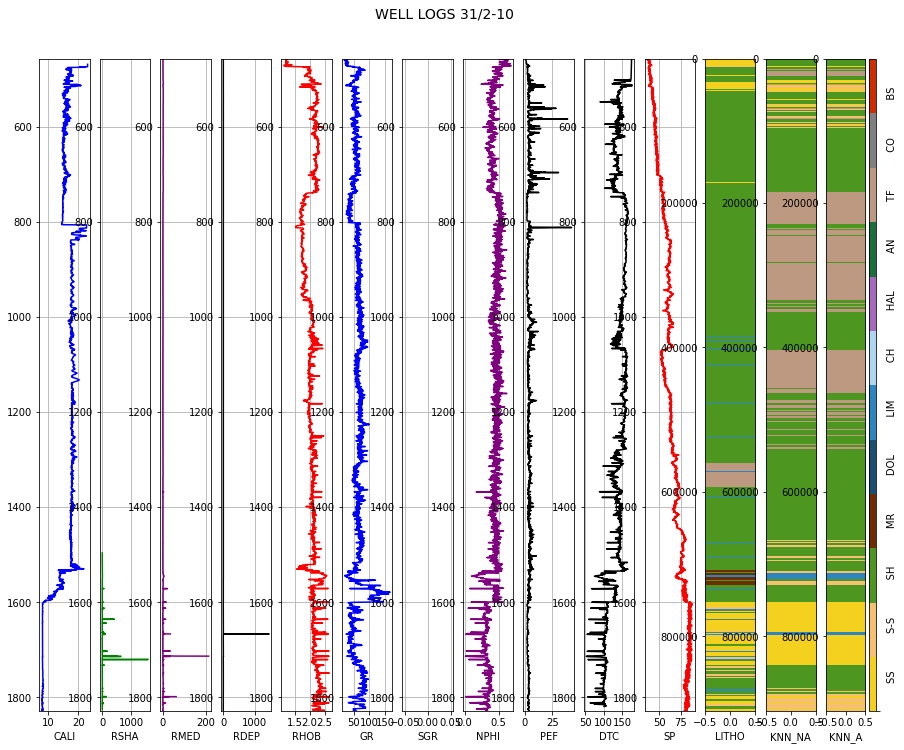

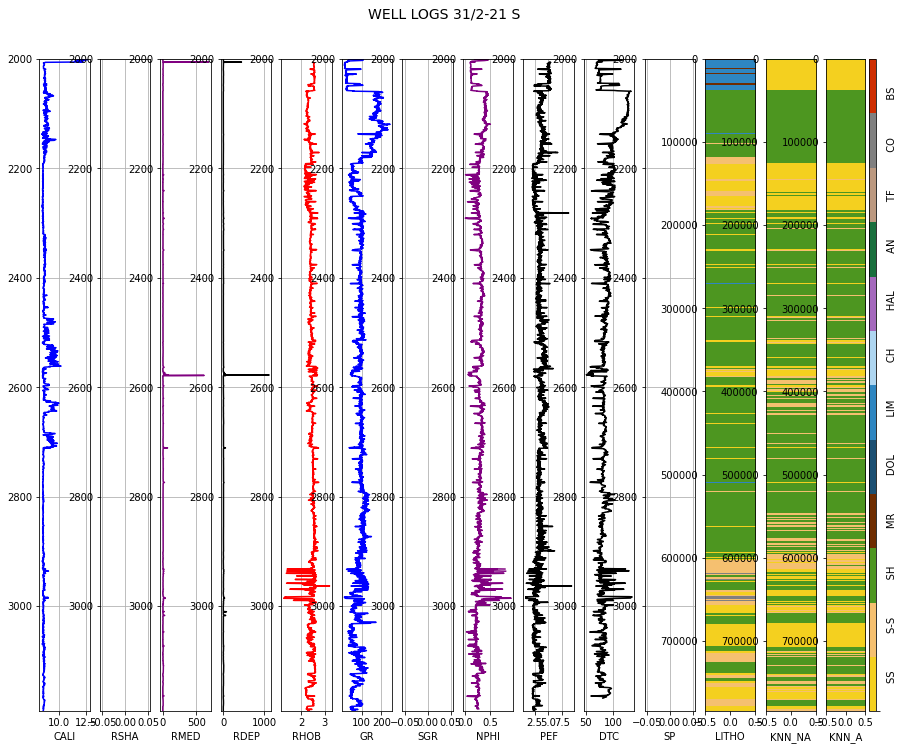

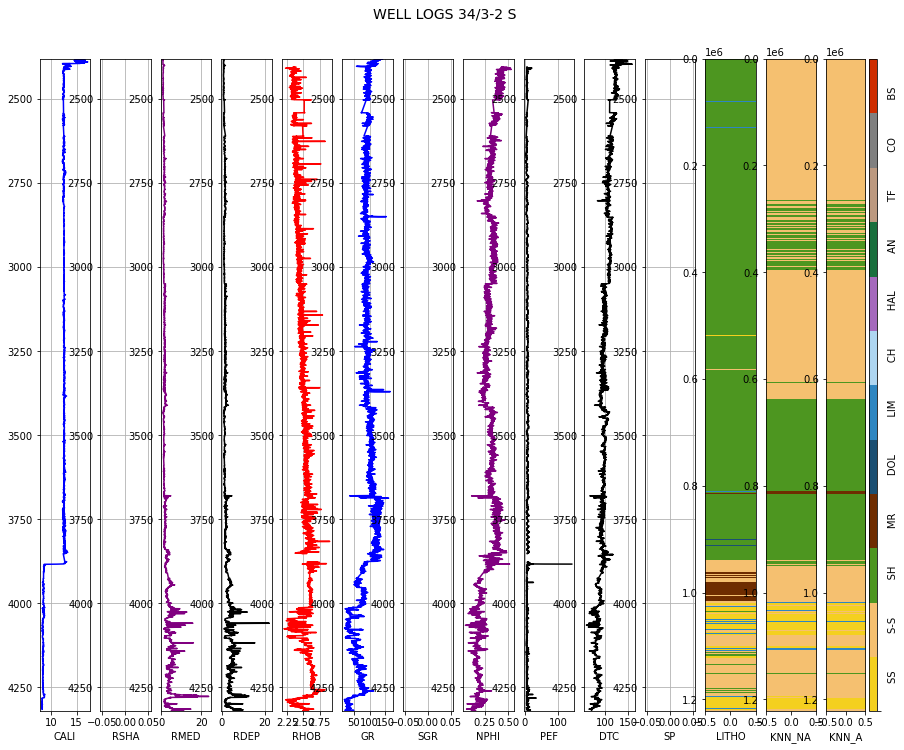

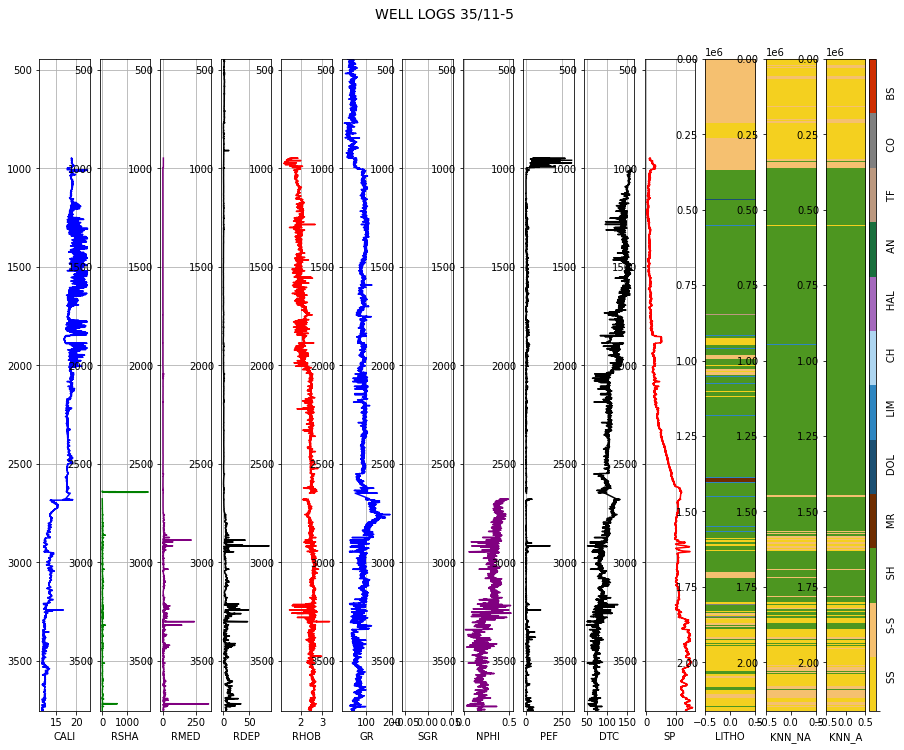

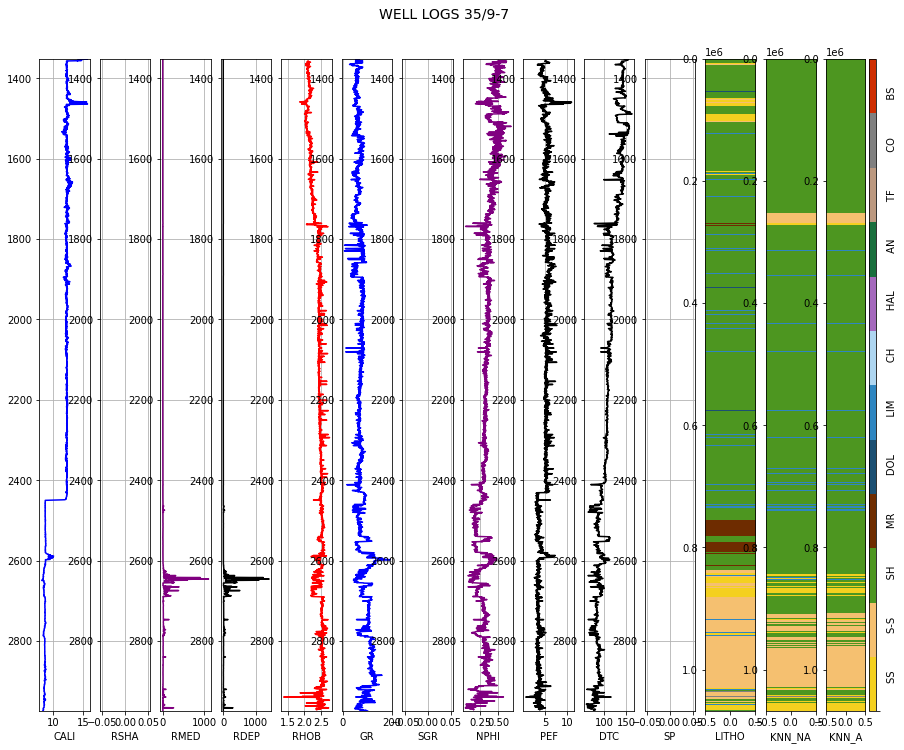

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_knn_res, i, facies_colors, 2)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning:

invalid value encountered in long_scalars



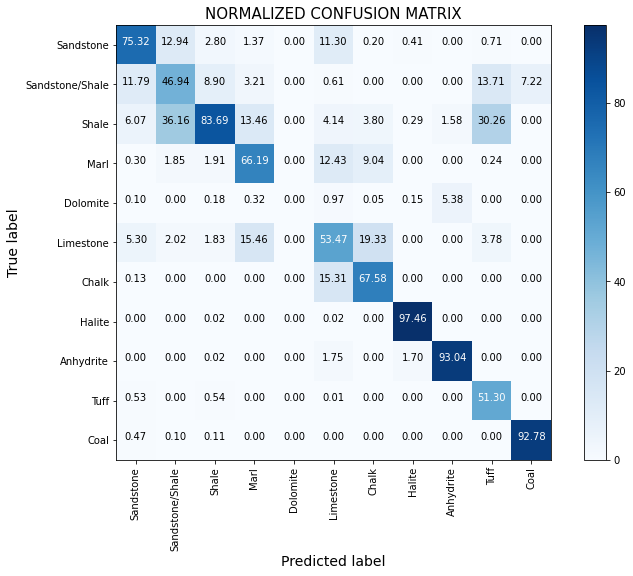

In [ ]:
litho_confusion_matrix(hidden_knn_res.LITHO, hidden_knn_res.KNN_TM)

#### **A3. SUPPORT VECTOR MACHINES (FINISHED)** 


In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

##### Base Model

In [ ]:
#Base Model
model_svm = SVC(kernel='linear')
model_svm.fit(x_train_strat, y_train_strat)

train_pred_svm = model_svm.predict(x_train_strat)
test_pred_svm = model_svm.predict(x_test)
hidden_pred_svm = model_svm.predict(x_hidden)

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train_strat.values, train_pred_svm))
print('Training set report:', metrics.classification_report(y_train_strat.values, train_pred_svm))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred_svm))
print('Open set report:', metrics.classification_report(y_test, test_pred_svm))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_svm))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_svm))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.6924535031738303


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Training set report:               precision    recall  f1-score   support

           0       0.66      0.66      0.66     16894
           1       0.59      0.07      0.13     15045
           2       0.76      0.97      0.85     72080
           3       0.48      0.06      0.11      3333
           4       0.00      0.00      0.00       169
           5       0.70      0.58      0.64      5632
           6       0.88      0.67      0.76      1051
           7       0.97      1.00      0.98       821
           8       0.96      0.92      0.94       109
           9       0.00      0.00      0.00      1525
          10       0.84      0.35      0.49       382
          11       1.00      0.90      0.95        10

    accuracy                           0.74    117051
   macro avg       0.65      0.51      0.54    117051
weighted avg       0.71      0.74      0.69    117051

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.7201413156317167
O

##### Hyper-parameter tunning

In [ ]:
## Analizing C

x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

train_acc = []; test_ac=[]
for i in [0.01,   0.1, 1.0,  10.0, 100]:
  model_knn = SVC(C=i)
  model_knn.fit(x_train_strat, y_train_strat)

  train_acc_i = accuracy_score(y_train_strat, model_knn.predict(x_train_strat)); train_acc.append(train_acc_i)
  test_acc_i = accuracy_score(y_test, model_knn.predict(x_test)); test_ac.append(test_ac)
  print('C: {}, treain accuracy {}, test accuracy {}'.format(i, train_acc_i, test_acc_i))

C: 0.01, treain accuracy 0.7304764589794193, test accuracy 0.7145687424151594
C: 0.1, treain accuracy 0.8049140972738379, test accuracy 0.7620224291959703
C: 1.0, treain accuracy 0.8535082998009415, test accuracy 0.7593978915970933
C: 10.0, treain accuracy 0.8849475869492786, test accuracy 0.7349143918237246
C: 100, treain accuracy 0.9119614527001051, test accuracy 0.6759683008495021


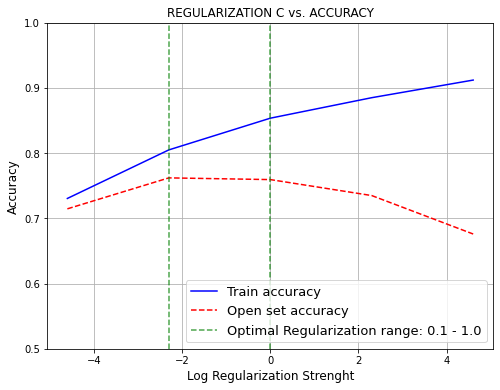

In [ ]:
c = [0.01, 0.1, 1, 10, 100]
train_acc = [0.7304764589794193, 0.8049140972738379, 0.8535082998009415, 0.8849475869492786, 0.9119614527001051]
test_acc = [0.7145687424151594, 0.7620224291959703, 0.7593978915970933, 0.7349143918237246, 0.6759683008495021]

#Plotting results 
fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(np.log(c), train_acc, '-b', label = 'Train accuracy')
ax.plot(np.log(c), test_acc, '--r', label = 'Open set accuracy')
plt.axvline(np.log(0.1), c='g', ls='--', label='Optimal Regularization range: 0.1 - 1.0', alpha=0.7)
plt.axvline(np.log(1), c='g', ls='--', alpha=0.7)
ax.legend(loc='lower right', fontsize=13)
plt.title('REGULARIZATION C vs. ACCURACY')
plt.ylim(0.5, 1)
plt.xlabel('Log Regularization Strenght', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

##### Tuned Model

In [ ]:
#Base Model
model_svm = SVC(kernel='rbf', C=0.5)
model_svm.fit(x_train_strat, y_train_strat)

train_pred_svm = model_svm.predict(x_train)
test_pred_svm = model_svm.predict(x_test)
hidden_pred_svm = model_svm.predict(x_hidden)

print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train.values, train_pred_svm))
print('Training set report:', metrics.classification_report(y_train.values, train_pred_svm))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test, test_pred_svm))
print('Open set report:', metrics.classification_report(y_test, test_pred_svm))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_svm))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_svm))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.4251913266940678


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Training set report:               precision    recall  f1-score   support

           0       0.80      0.78      0.79    168937
           1       0.72      0.54      0.62    150455
           2       0.87      0.96      0.91    720803
           3       0.77      0.44      0.56     33329
           4       0.00      0.00      0.00      1688
           5       0.78      0.63      0.70     56320
           6       0.89      0.70      0.78     10513
           7       0.98      0.98      0.98      8213
           8       0.94      0.67      0.78      1085
           9       0.77      0.66      0.71     15245
          10       0.87      0.40      0.54      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.84   1170511
   macro avg       0.70      0.56      0.61   1170511
weighted avg       0.83      0.84      0.83   1170511

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.6212925664907227
O

In [ ]:
#Storing results
train_svm_res = labeled_data.copy()
test_svm_res = test_data.copy()
hidden_svm_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_svm_res['SVM_TM'] = train_pred_svm
test_svm_res['SVM_TM'] = test_pred_svm
hidden_svm_res['SVM_TM'] = hidden_pred_svm

In [ ]:
#Saving results 2 methods
train_svm_res.to_csv('/content/drive/MyDrive/Results_folder/SVM/train_svm_final_res.csv', index=False)
test_svm_res.to_csv('/content/drive/MyDrive/Results_folder/SVM/test_svm_final_res.csv', index=False)
hidden_svm_res.to_csv('/content/drive/MyDrive/Results_folder/SVM/hidden_svm_final_res.csv', index=False)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning:

invalid value encountered in long_scalars



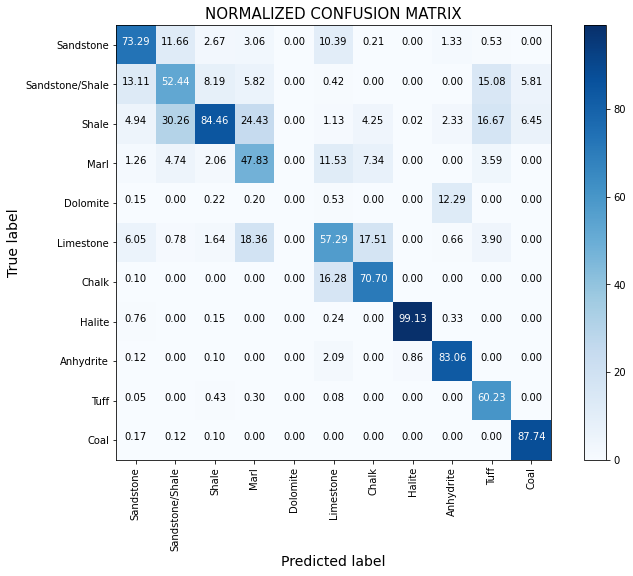

In [ ]:
litho_confusion_matrix(hidden_svm_res.LITHO, hidden_svm_res.SVM_TM)

#### **A4. DECISION TREES (FINISHED)**

##### Base Model

In [ ]:
#Base Model
model_dt = DecisionTreeClassifier()
model_dt.fit(x_train_strat, y_train_strat)

train_pred_dt = model_dt.predict(x_train_strat)
open_pred_dt = model_dt.predict(x_test)
hidden_pred_dt = model_dt.predict(x_hidden)

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print("Open set RMSE:", np.sqrt(mean_squared_error(y_train_strat, train_pred_dt)))
print('Open set penalty matrix score:', score(y_train_strat.values, train_pred_dt))
print('Open set report:', metrics.classification_report(y_train_strat, train_pred_dt))
print('-----------------------OPEN SET REPORT---------------------')
print("Open set RMSE:", np.sqrt(mean_squared_error(y_test, open_pred_dt)))
print('Open set penalty matrix score:', score(y_test.values, open_pred_dt))
print('Open set report:', metrics.classification_report(y_test, open_pred_dt))
print('-----------------------HIDDEN SET REPORT---------------------')
print("Hidden set RMSE:", np.sqrt(mean_squared_error(y_hidden, hidden_pred_dt)))
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_dt))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_dt))


-----------------------TRAIN SET REPORT---------------------
Open set RMSE: 0.6899196321086338
Open set penalty matrix score: -0.18706055480089875
Open set report:               precision    recall  f1-score   support

           0       0.94      0.91      0.92     16894
           1       0.89      0.80      0.84     15045
           2       0.93      0.98      0.96     72080
           3       0.94      0.77      0.84      3333
           4       0.96      0.39      0.55       169
           5       0.98      0.80      0.88      5632
           6       0.97      0.96      0.97      1051
           7       1.00      1.00      1.00       821
           8       1.00      0.98      0.99       109
           9       0.92      0.80      0.85      1525
          10       0.98      0.66      0.79       382
          11       1.00      0.90      0.95        10

    accuracy                           0.93    117051
   macro avg       0.96      0.83      0.88    117051
weighted avg       0.93 

##### Decision Tree Prunning

*The logistic regression seems to be a decent classifier for the majority classes but when it comes to the minoriy ones it does not do well. For instance with depth of 2 it separates accurately the majority classes ( accuracies = 67 and 64%). One approach to solve this might be to balance the dataset and see how it performs.*

In [ ]:
# Create the regressor
model_dt2 = DecisionTreeClassifier(max_depth=15)

# Fit the regressor to the training data
model_dt2.fit(x_train_strat, y_train_strat)

train_pred_dt = model_dt2.predict(x_train_strat)
open_pred_dt = model_dt2.predict(x_test)
hidden_pred_dt = model_dt2.predict(x_hidden)

print('Training accuracy', accuracy_score(train_pred_dt, y_train_strat))
print('Test accuracy', accuracy_score(open_pred_dt, y_test))
print('Hidden accuracy', accuracy_score(hidden_pred_dt, y_hidden))

Training accuracy 0.9300304995258477
Test accuracy 0.6215109733452254
Hidden accuracy 0.616134382378653


In [ ]:
#Decision tree pruning - COST COMPLEXITY PRUNING
#from sklearn import tree
#plt.figure(figsize=(25, 25))
#tree.plot_tree(model_dt2, filled=True, fontsize=6, max_depth=10 )

In [ ]:
path = model_dt2.cost_complexity_pruning_path(x_train_strat, y_train_strat)
ccp_alphas, impurities = path.ccp_alphas, path.impurities

In [ ]:
#Indexes to take impurities and ccp_alphas
indexes = np.arange(0, 3162, 20)
ccp_alphas_s = ccp_alphas[indexes]
impurities_s = impurities[indexes]

In [ ]:
#Fitting models
clfs =[]

for ccp_alpha in ccp_alphas_s:
  clf = DecisionTreeClassifier(random_state=0, ccp_alpha=ccp_alpha)
  clf.fit(x_train_strat, y_train_strat)
  clfs.append(clf)

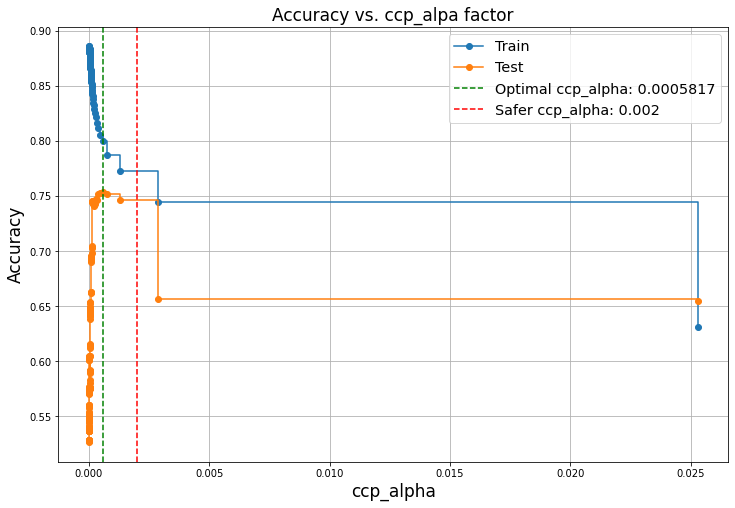

In [ ]:
#Accuracy vs alpha for training and test sets

#train_scores = [clf.score(x_train, y_train) for clf in clfs]
#test_scores = [clf.score(x_test, y_test) for clf in clfs]

plt.subplots(figsize=(12, 8))
plt.xlabel('ccp_alpha', size=17)
plt.ylabel('Accuracy', size=17)
plt.title('Accuracy vs. ccp_alpa factor', size=17)
optimal_ccp_alpha = ccp_alphas_s[test_scores.index(np.array(test_scores).max())]

plt.plot(ccp_alphas_s, train_scores, marker='o', label='Train', drawstyle='steps-post')
plt.plot(ccp_alphas_s, test_scores, marker='o', label='Test', drawstyle='steps-post')
plt.axvline(optimal_ccp_alpha, c='g', ls='--', label='Optimal ccp_alpha: '+str(np.round(optimal_ccp_alpha, 7)))
plt.axvline(0.002, c='r', ls='--', label='Safer ccp_alpha: 0.002')

plt.legend(fontsize='x-large')
plt.grid( )
plt.show()

In [ ]:
# Create the regressor
tunned_dt = DecisionTreeClassifier(max_depth=15, ccp_alpha=0.002)

# Fit the regressor to the training data
tunned_dt.fit(x_train_strat, y_train_strat)

train_pred_dtp = tunned_dt.predict(x_train)
open_pred_dtp = tunned_dt.predict(x_test)
hidden_pred_dtp = tunned_dt.predict(x_hidden)

#Printing Reports 

print('-----------------------TRAIN SET REPORT---------------------')
print("Open set RMSE:", np.sqrt(mean_squared_error(y_train, train_pred_dtp)))
print('Open set penalty matrix score:', score(y_train.values, train_pred_dtp))
print('Open set report:', metrics.classification_report(y_train, train_pred_dtp))
print('-----------------------OPEN SET REPORT---------------------')
print("Open set RMSE:", np.sqrt(mean_squared_error(y_test, open_pred_dtp)))
print('Open set penalty matrix score:', score(y_test.values, open_pred_dtp))
print('Open set report:', metrics.classification_report(y_test, open_pred_dtp))
print('-----------------------HIDDEN SET REPORT---------------------')
print("Hidden set RMSE:", np.sqrt(mean_squared_error(y_hidden, hidden_pred_dtp)))
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_dtp))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_dtp))

-----------------------TRAIN SET REPORT---------------------
Open set RMSE: 1.3143150977899347
Open set penalty matrix score: -0.6663225505783371
Open set report:               precision    recall  f1-score   support

           0       0.68      0.67      0.67    168937
           1       0.75      0.21      0.33    150455
           2       0.77      0.96      0.86    720803
           3       0.62      0.17      0.26     33329
           4       0.00      0.00      0.00      1688
           5       0.80      0.47      0.59     56320
           6       0.78      0.61      0.69     10513
           7       0.77      1.00      0.87      8213
           8       0.00      0.00      0.00      1085
           9       0.00      0.00      0.00     15245
          10       0.00      0.00      0.00      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.76   1170511
   macro avg       0.43      0.34      0.36   1170511
weighted avg       0.74  

In [ ]:
train_dt_res = labeled_data.copy()
test_dt_res = test_data.copy()
hidden_dt_res = hidden_data.copy()

train_dt_res['DT_PRU'] = train_pred_dtp
test_dt_res['DT_PRU'] = open_pred_dtp
hidden_dt_res['DT_PRU'] = hidden_pred_dtp

In [ ]:
#Saving results 2 methods
train_dt_res.to_csv('/content/drive/MyDrive/Results_folder/DT/train_dt_f_res.csv', index=False)
test_dt_res.to_csv('/content/drive/MyDrive/Results_folder/DT/test_dt_f_res.csv', index=False)
hidden_dt_res.to_csv('/content/drive/MyDrive/Results_folder/DT/hidden_dt_f_res.csv', index=False)

##### C4. Plotting Results

In [ ]:
#Importing files
train_dt_res = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/train_dt_f_res.csv')
test_dt_res = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/test_dt_f_res.csv')
hidden_dt_res = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/hidden_dt_f_res.csv')

In [ ]:
print(classification_report(hidden_dt_res.LITHO, hidden_dt_res.DT_PRU))

              precision    recall  f1-score   support

           0       0.60      0.61      0.60     14045
           1       0.78      0.11      0.19     12283
           2       0.77      0.98      0.86     71827
           3       0.48      0.03      0.06      4396
           4       0.00      0.00      0.00       287
           5       0.57      0.56      0.56      8374
           6       0.00      0.00      0.00      2905
           7       0.87      1.00      0.93      6498
           8       0.00      0.00      0.00       597
           9       0.00      0.00      0.00       941
          10       0.00      0.00      0.00       244

    accuracy                           0.75    122397
   macro avg       0.37      0.30      0.29    122397
weighted avg       0.70      0.75      0.69    122397



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning:

invalid value encountered in long_scalars



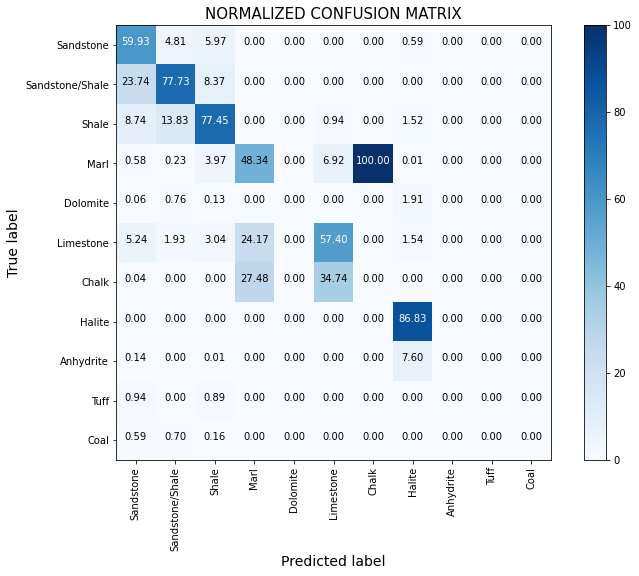

In [ ]:
litho_confusion_matrix(hidden_dt_res.LITHO, hidden_dt_res.DT_PRU)

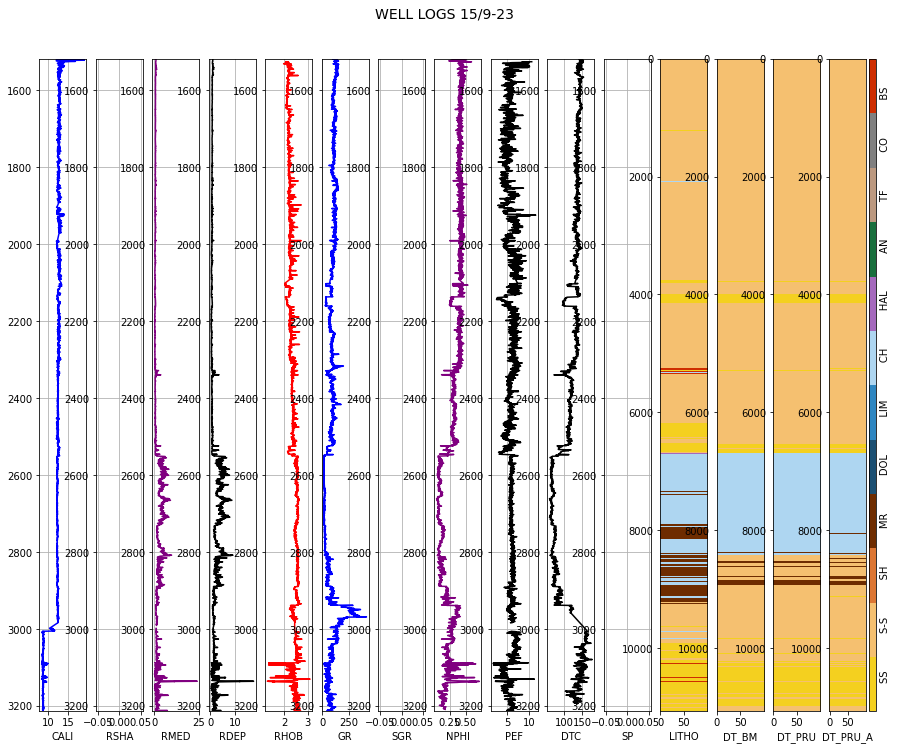

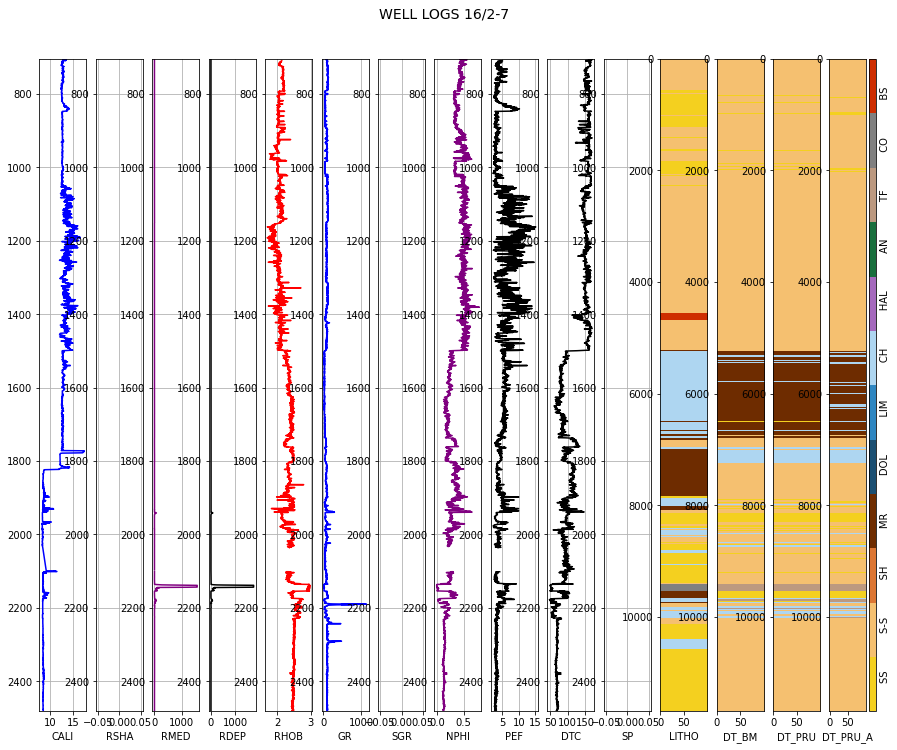

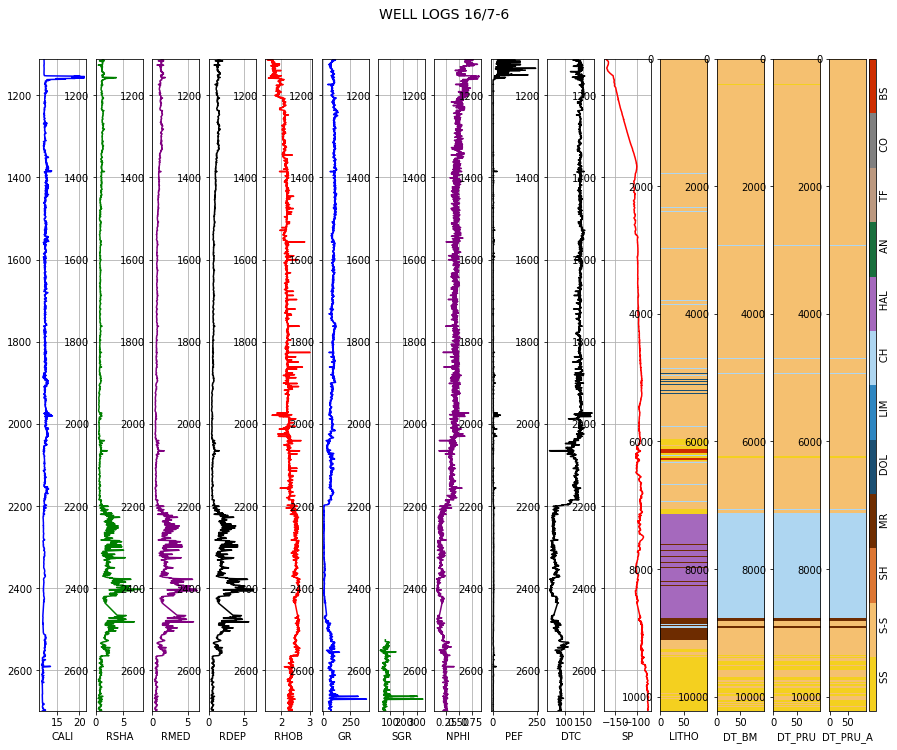

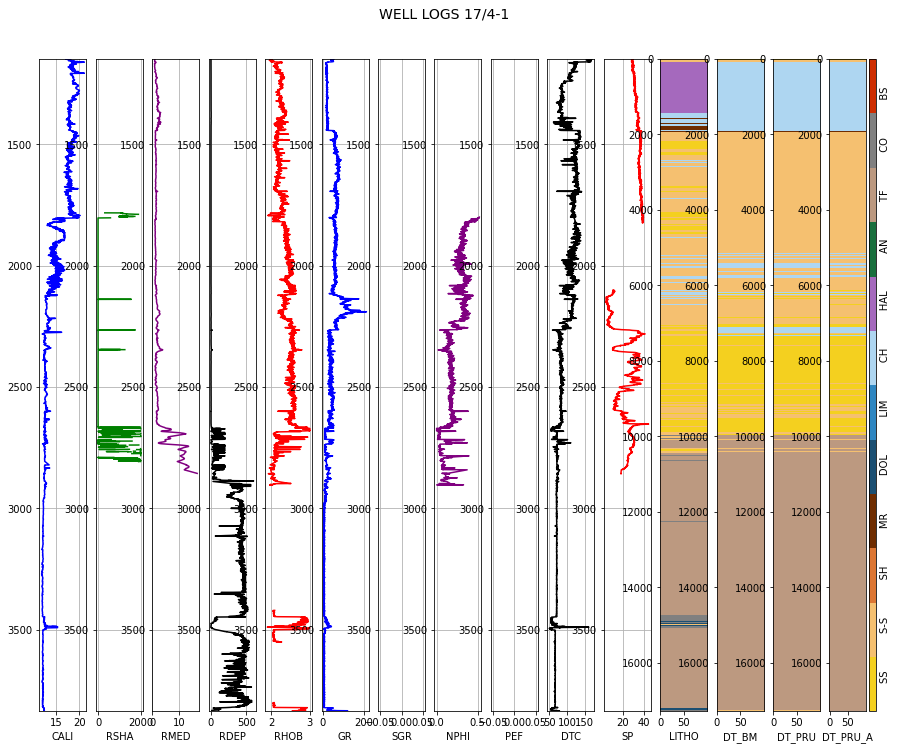

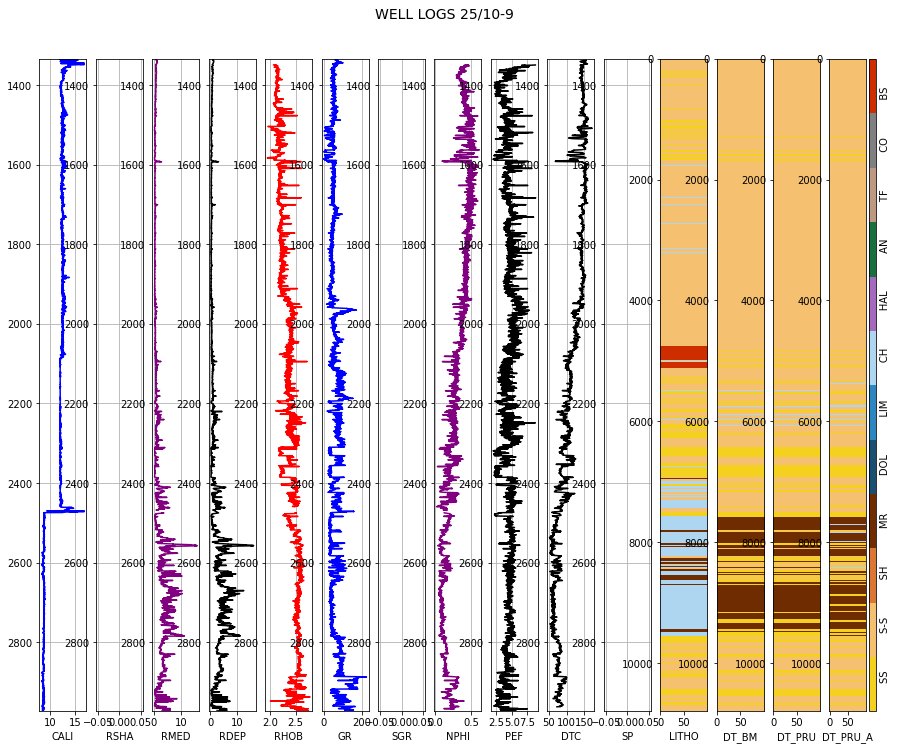

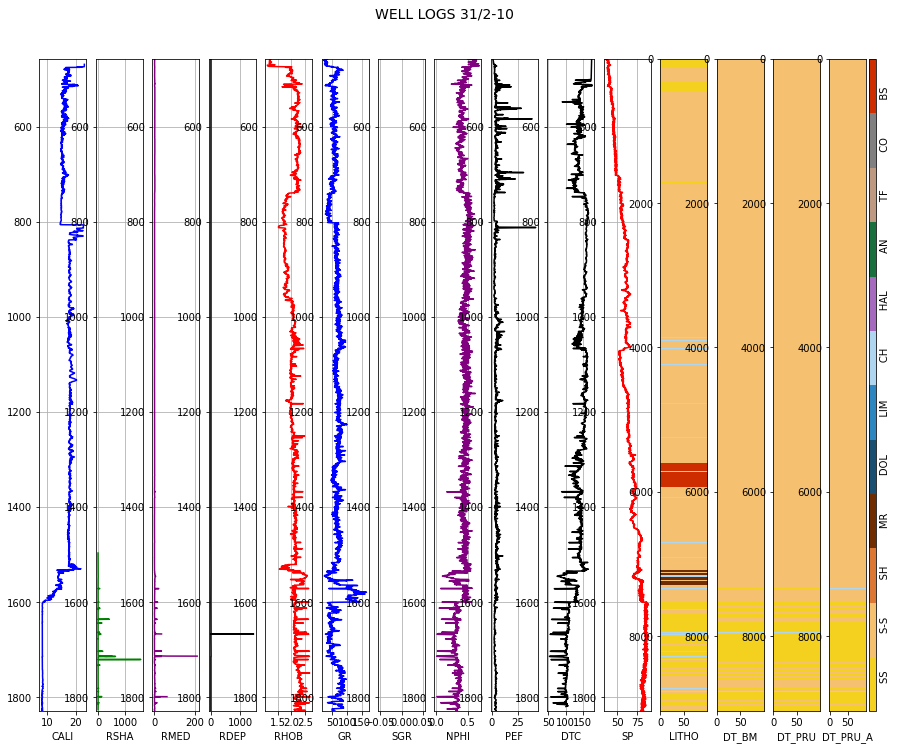

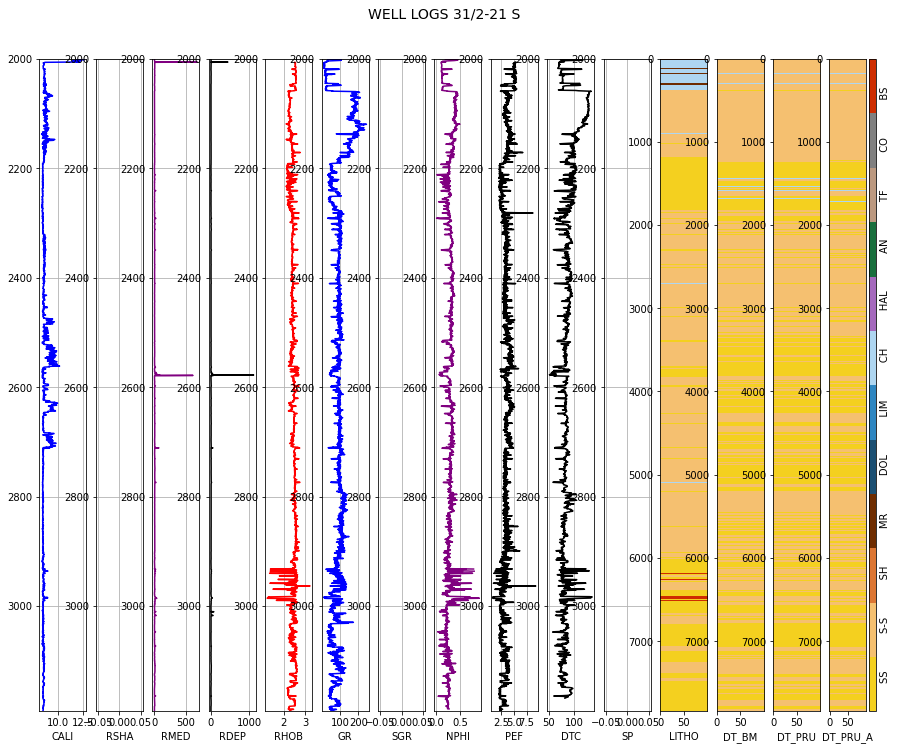

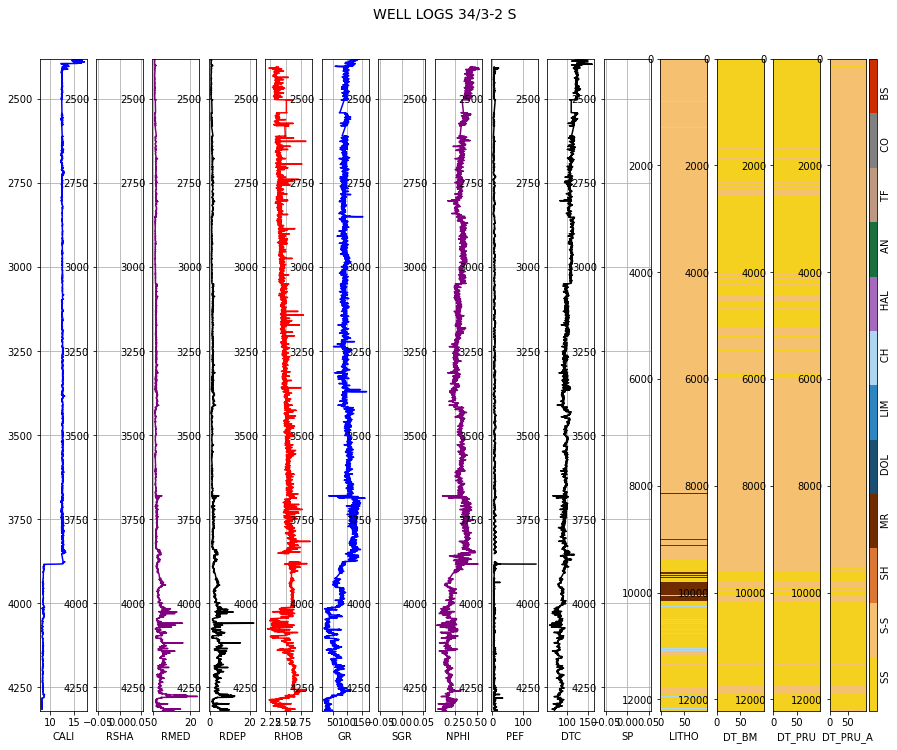

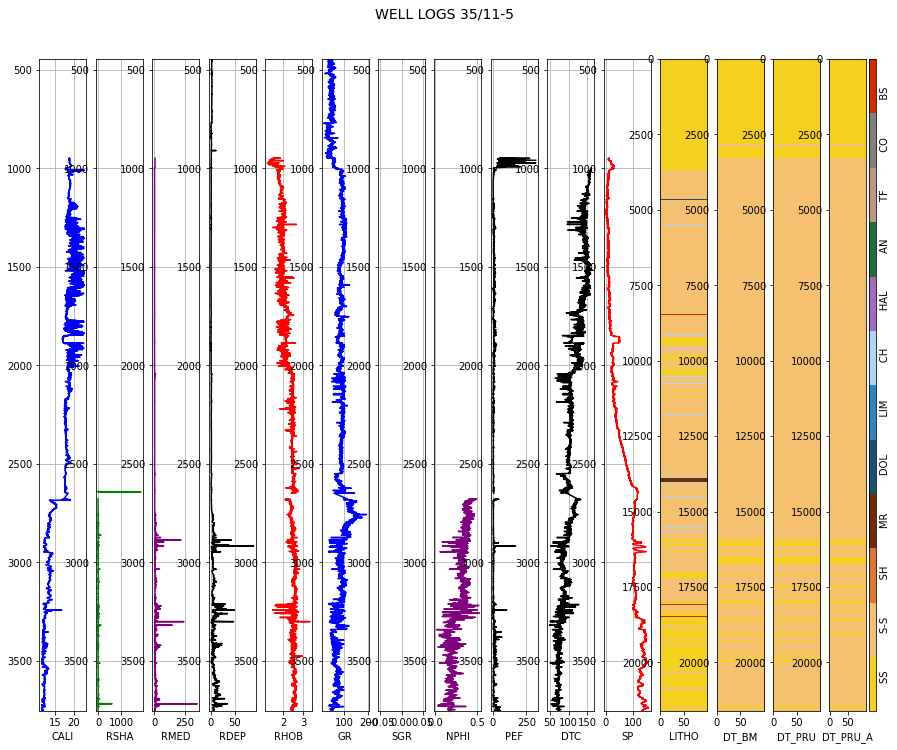

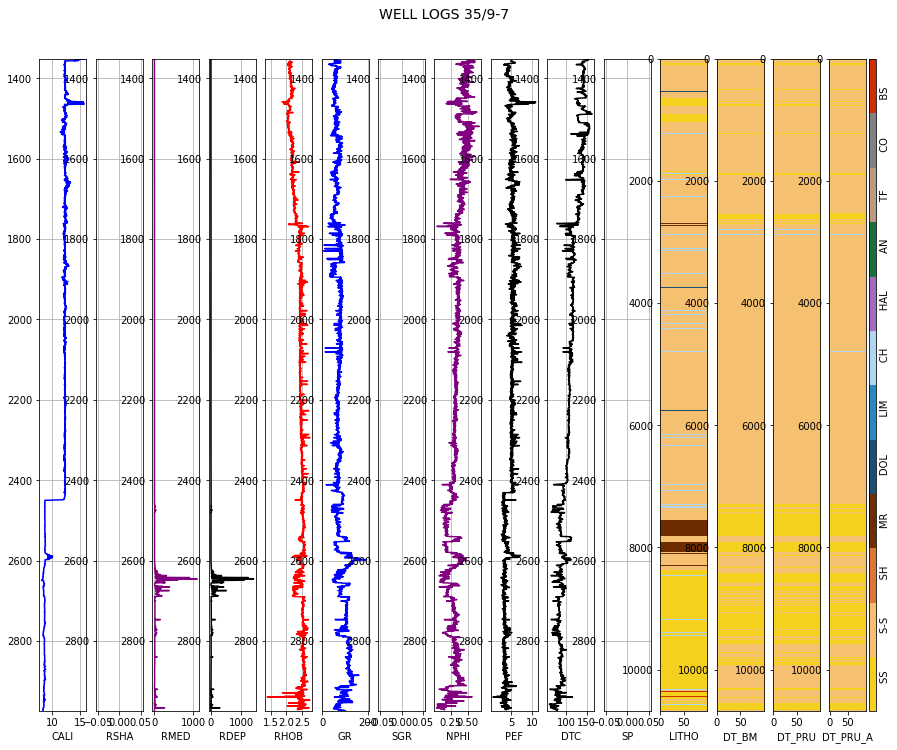

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_dt_res, i, facies_colors, 3)

*The logistic regression seems to be a decent classifier for the majority classes but when it comes to the minoriy ones it does not do well. For instance with depth of 2 it separates accurately the majority classes ( accuracies = 67 and 64%). One approach to solve this might be to balance the dataset and see how it performs.*

### **B. ENSEMBLE AND BOOSTING METHODS**

#### **B1. CATBOOST (Boosting Method) (FINISHED)**

In [ ]:
#!pip install catboost
import catboost
from catboost import CatBoostClassifier
print(catboost.__version__)

0.26


##### Base Model

In [ ]:
model_catboost = CatBoostClassifier(task_type='GPU')
 
model_catboost.fit(x_train, y_train.values.ravel(), verbose=100)

train_pred_cat = model_catboost.predict(x_train)
open_pred_cat = model_catboost.predict(x_test)
hidden_pred_cat = model_catboost.predict(x_hidden)

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_cat))
print('Open set report:', metrics.classification_report(y_train, train_pred_cat))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_cat))
print('Open set report:', metrics.classification_report(y_test, open_pred_cat))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_cat))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_cat))


Learning rate set to 0.274304
0:	learn: 1.2970675	total: 34.8ms	remaining: 34.8s
100:	learn: 0.3645911	total: 3.08s	remaining: 27.4s
200:	learn: 0.3015829	total: 6.05s	remaining: 24s
300:	learn: 0.2711879	total: 9.02s	remaining: 20.9s
400:	learn: 0.2517763	total: 12s	remaining: 17.9s
500:	learn: 0.2379605	total: 14.9s	remaining: 14.8s
600:	learn: 0.2263717	total: 17.8s	remaining: 11.8s
700:	learn: 0.2174188	total: 20.8s	remaining: 8.86s
800:	learn: 0.2093711	total: 23.7s	remaining: 5.89s
900:	learn: 0.2027903	total: 26.7s	remaining: 2.93s
999:	learn: 0.1969908	total: 29.6s	remaining: 0us
-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: [-0.17970239]
Open set report:               precision    recall  f1-score   support

           0       0.92      0.91      0.91    168937
           1       0.87      0.82      0.84    150455
           2       0.95      0.98      0.96    720803
           3       0.91      0.88      0.89     33329
           

##### Random Search Tunning

In [ ]:
model_catboost = CatBoostClassifier(task_type='GPU')

grid_catboost = {'depth':[3,1,2,6,4,5,7,8,9,10],
                  'iterations':[250,100,500,1000],
                  'learning_rate':[0.03,0.001,0.01,0.1,0.2,0.3], 
                  'l2_leaf_reg':[3,1,5,10,100],
                  'border_count':[32,5,10,20,50,100,200],
                  #'ctr_border_count':[50,5,10,20,100,200],
                  #'thread_count':4,
                  'random_strength' : 10.0**np.arange(0,4),
                  'grow_policy' : ['SymmetricTree', 'Lossguide', 'Depthwise']
                  }

kf_cb = StratifiedKFold(n_splits=3, shuffle=True, random_state=0)
clf_cb = RandomizedSearchCV(estimator=model_catboost, param_distributions=grid_catboost, cv=kf_cb, n_jobs=-1, scoring='accuracy', verbose=100)
clf_cb.fit(x_train, y_train)

print("Best score is: {}".format(clf_cb.best_score_))
print("Tuned Model Parameter: {}".format(clf_cb.best_params_))

Fitting 3 folds for each of 10 candidates, totalling 30 fits
[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:   12.8s


/usr/local/lib/python3.7/dist-packages/joblib/externals/loky/process_executor.py:691: UserWarning:

A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.



[Parallel(n_jobs=-1)]: Done   2 tasks      | elapsed:   13.2s
[Parallel(n_jobs=-1)]: Done   3 tasks      | elapsed:   26.7s
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:   30.2s
[Parallel(n_jobs=-1)]: Done   5 tasks      | elapsed:   38.5s
[Parallel(n_jobs=-1)]: Done   6 tasks      | elapsed:   40.9s
[Parallel(n_jobs=-1)]: Done   7 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   8 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  2.3min
[Parallel(n_jobs=-1)]: Done  10 tasks      | elapsed:  2.4min
[Parallel(n_jobs=-1)]: Done  11 tasks      | elapsed:  3.1min
[Parallel(n_jobs=-1)]: Done  12 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  13 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  15 tasks      | elapsed:  3.5min
[Parallel(n_jobs=-1)]: Done  16 tasks      | elapsed:  4.7min
[Parallel(n_jobs=-1)]: Done  17 tasks      | elapsed:  4.7min
[Paralle

In [ ]:
train_pred_cat = clf_cb.predict(x_train)
open_pred_cat = clf_cb.predict(x_test)
hidden_pred_cat = clf_cb.predict(x_hidden)

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_cat))
print('Open set report:', metrics.classification_report(y_train, train_pred_cat))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_cat))
print('Open set report:', metrics.classification_report(y_test, open_pred_cat))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_cat))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_cat))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: [-0.11935065]
Open set report:               precision    recall  f1-score   support

           0       0.95      0.94      0.95    168937
           1       0.92      0.89      0.90    150455
           2       0.97      0.98      0.97    720803
           3       0.94      0.92      0.93     33329
           4       0.91      0.61      0.73      1688
           5       0.95      0.83      0.89     56320
           6       0.97      0.97      0.97     10513
           7       1.00      1.00      1.00      8213
           8       0.97      0.97      0.97      1085
           9       0.93      0.96      0.95     15245
          10       0.95      0.89      0.92      3820
          11       0.99      1.00      1.00       103

    accuracy                           0.96   1170511
   macro avg       0.95      0.91      0.93   1170511
weighted avg       0.96      0.96      0.96   1170511

----------

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: [-0.58872869]
Hidden set report:               precision    recall  f1-score   support

           0       0.61      0.80      0.69     14045
           1       0.56      0.37      0.44     12283
           2       0.88      0.93      0.90     71827
           3       0.35      0.27      0.30      4396
           4       0.00      0.00      0.00       287
           5       0.53      0.64      0.58      8374
           6       0.55      0.17      0.26      2905
           7       0.99      0.63      0.77      6498
           8       0.76      0.62      0.69       597
           9       0.60      0.49      0.54       941
          10       0.87      0.53      0.66       244

    accuracy                           0.77    122397
   macro avg       0.61      0.49      0.53    122397
weighted avg       0.76      0.77      0.76    122397



##### Recursive Feature Selection

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train)

In [ ]:
#Feature selection by recursive feature elimination
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
import warnings
warnings.filterwarnings('ignore')

base_cat = CatBoostClassifier(task_type='GPU', verbose=0)
rfe_cat = RFECV(estimator=base_cat, step=1, cv=StratifiedKFold(10), scoring='accuracy', verbose=1)
rfe_cat.fit(x_train_strat, y_train_strat)

Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.
Fitting estimator with 3 features.

RFECV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
      estimator=<catboost.core.CatBoostClassifier object at 0x7f627a549090>,
      min_features_to_select=1, n_jobs=None, scoring='accuracy', step=1,
      verbose=1)

Optimal number of features: 16


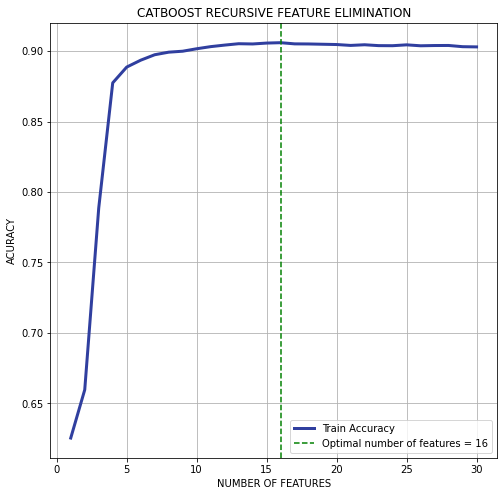

In [ ]:
print('Optimal number of features: {}'.format(rfe_cat.n_features_))

#Plotting Data
plt.figure(figsize=(8, 8))
num_features = list(range(1, len(rfe_cat.grid_scores_)+1))
scores = list(rfe_cat.grid_scores_)
plt.plot(num_features, rfe_cat.grid_scores_, color='#303F9F', linewidth=3, label='Train Accuracy')
plt.axvline(num_features[scores.index(np.array(scores).max())], c='g', ls='--', label='Optimal number of features = 16')
plt.title('CATBOOST RECURSIVE FEATURE ELIMINATION')
plt.xlabel('NUMBER OF FEATURES')
plt.ylabel('ACURACY')
plt.legend()
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

In [ ]:
x_train.columns

Index(['GR', 'NPHI_COMB', 'DTC', 'DTS_COMB', 'RHOB', 'Y_LOC', 'GROUP_encoded',
       'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI',
       'X_LOC', 'RMED', 'SP', 'MD_TVD'],
      dtype='object')

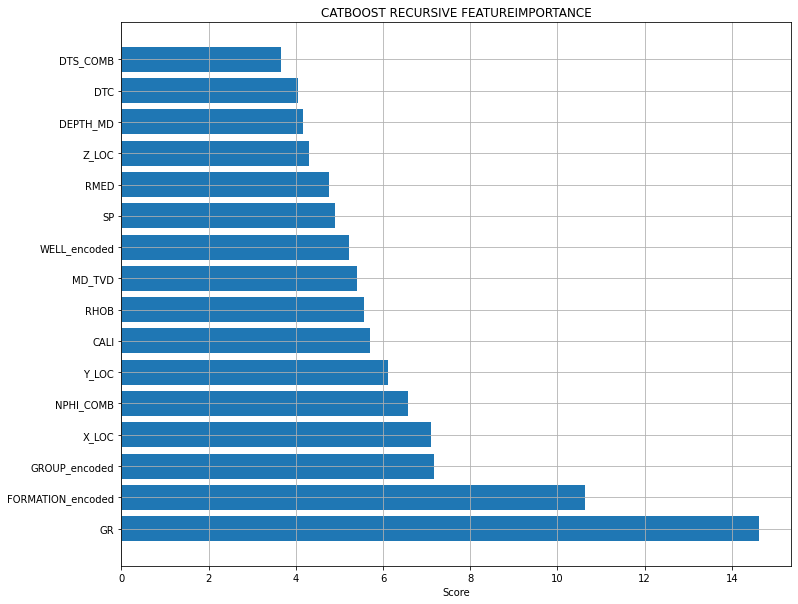

In [ ]:
#Ploting Feature Importance after recursive feature selection
#new_set = x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

dset = pd.DataFrame()
dset['attr'] = x_train.columns
dset['importance'] = rfe_cat.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(12, 10))
plt.barh(y=dset['attr'], width=dset['importance'])
plt.title('CATBOOST RECURSIVE FEATURE IMPORTANCE')
plt.xlabel('Score')
plt.grid()

In [ ]:
x_train.columns

Index(['GR', 'NPHI_COMB', 'DTC', 'DTS_COMB', 'RHOB', 'Y_LOC', 'GROUP_encoded',
       'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI',
       'X_LOC', 'RMED', 'SP', 'MD_TVD'],
      dtype='object')

##### Hper-parameter Tuning - MANUAL TUNING

-------------------NUMBER OF TREES: 1000---------------------
Learning Rate: 0.001, Train accuracy 0.7521450033361498 and test accuracy 0.7509174915561534
Learning Rate: 0.005, Train accuracy 0.8137420323260525 and test accuracy 0.7823900106736069
Learning Rate: 0.01, Train accuracy 0.8450035924480847 and test accuracy 0.7900516134692147
Learning Rate: 0.025, Train accuracy 0.8469822154597436 and test accuracy 0.7891012238094541
Learning Rate: 0.05, Train accuracy 0.8632896230791509 and test accuracy 0.7897299431228342
Learning Rate: 0.075, Train accuracy 0.862536106025488 and test accuracy 0.790731507610428
Learning Rate: 0.1, Train accuracy 0.8612076264127377 and test accuracy 0.792427587618616
Learning Rate: 0.125, Train accuracy 0.8608060923818742 and test accuracy 0.7862939189683155
Learning Rate: 0.15, Train accuracy 0.8505746635443836 and test accuracy 0.7870615413858143
Learning Rate: 0.175, Train accuracy 0.8563926353532774 and test accuracy 0.7856505782755545
Learning Rate: 0

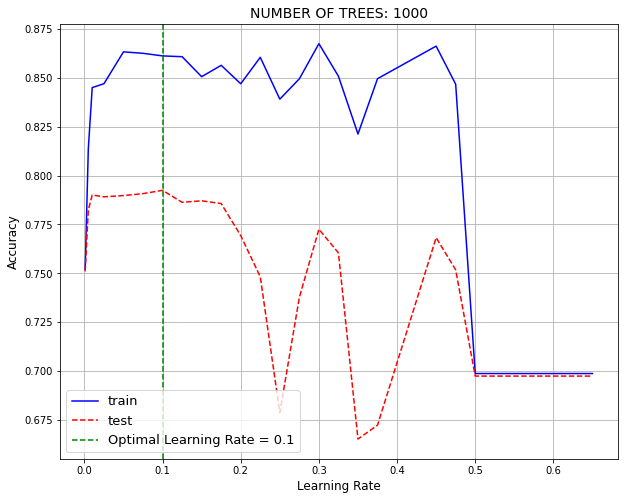

In [ ]:
#Tunning Learning rate and n_trees

learning_rates = np.array([0.001, 0.005, 0.01, 0.025, 0.05 , 0.075, 0.1  , 0.125, 0.15 , 0.175, 0.2,
                            0.225, 0.25 , 0.275, 0.3  , 0.325, 0.35 , 0.375, 0.45 , 0.475, 0.5, 
                           0.525, 0.55 , 0.575, 0.6  , 0.625, 0.65  ])

n_trees = np.array([1000]) #, 250, 500, 1000, 2500])

for i in n_trees:
  train_accuracies = []
  test_accuracies = []
  print('-------------------NUMBER OF TREES: {}---------------------'.format(i))
  for l_rate in learning_rates:
    model_i = CatBoostClassifier(iterations=i, 
                                 learning_rate=l_rate, 
                                 task_type='GPU',
                                 verbose=0)  #od_type='Iter', od_wait=50, 

    model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
    acc_train = accuracy_score(y_train, model_i.predict(x_train))
    acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
    test_accuracies.append(acc_test), train_accuracies.append(acc_train)
    print('Learning Rate: {}, Train accuracy {} and test accuracy {}'.format(l_rate, acc_train, acc_test))

  #Plotting results 
  fig, ax = plt.subplots(figsize=(10, 8))
  ax.plot(learning_rates, train_accuracies, '-b', label = 'train')
  ax.plot(learning_rates, test_accuracies, '--r', label = 'test')
  plt.axvline(learning_rates[test_accuracies.index(np.array(test_accuracies).max())], 
              c='g', ls='--', label='Optimal Learning Rate = 0.1')
  ax.legend(loc='lower left', fontsize=13)
  plt.title('NUMBER OF TREES: ' + str(i), size=14)
  plt.xlabel('Learning Rate', size=12)
  plt.ylabel('Accuracy', size=12)
  plt.grid()
    

-------------------TREE DEPTH: 2---------------------
Tree Depth: 2, Train accuracy 0.8206595239173319 and test accuracy 0.7784568596201366
-------------------TREE DEPTH: 3---------------------
Tree Depth: 3, Train accuracy 0.8224775333166454 and test accuracy 0.7846343924085798
-------------------TREE DEPTH: 4---------------------
Tree Depth: 4, Train accuracy 0.8425781560361244 and test accuracy 0.7847806062023891
-------------------TREE DEPTH: 5---------------------
Tree Depth: 5, Train accuracy 0.8552384385964762 and test accuracy 0.7915064407176173
-------------------TREE DEPTH: 6---------------------
Tree Depth: 6, Train accuracy 0.8612076264127377 and test accuracy 0.792427587618616
-------------------TREE DEPTH: 7---------------------
Tree Depth: 7, Train accuracy 0.8692160945091503 and test accuracy 0.7886918251867882
-------------------TREE DEPTH: 8---------------------
Tree Depth: 8, Train accuracy 0.8699063913111453 and test accuracy 0.791674586580498
-------------------TRE

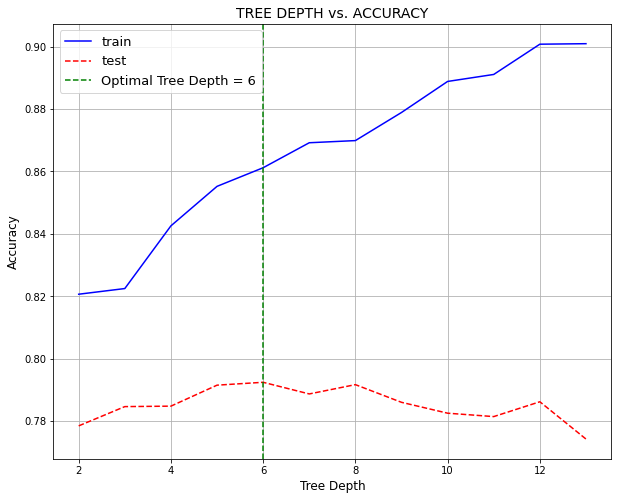

In [ ]:
#Tunning Tree depth

tree_depths = np.arange(2, 14, 1)
train_accuracies = []
test_accuracies = []
for depth_i in tree_depths:
  print('-------------------TREE DEPTH: {}---------------------'.format(depth_i))
  model_i = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.10,
                               depth = depth_i,
                               task_type='GPU',
                               verbose=0)  #od_type='Iter', od_wait=50, 

  model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
  acc_train = accuracy_score(y_train, model_i.predict(x_train))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Tree Depth: {}, Train accuracy {} and test accuracy {}'.format(depth_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(tree_depths, train_accuracies, '-b', label = 'train')
ax.plot(tree_depths, test_accuracies, '--r', label = 'test')
plt.axvline(tree_depths[test_accuracies.index(np.array(test_accuracies).max())], 
            c='g', ls='--', label='Optimal Tree Depth = 6')
ax.legend(loc='upper left', fontsize=13)
plt.title('TREE DEPTH vs. ACCURACY', size=14)
plt.xlabel('Tree Depth', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

-------------------L2 REGULARIZATION: 25---------------------
L2_regularization: 25, Train accuracy 0.8556177601064834 and test accuracy 0.7881727662187651
-------------------L2 REGULARIZATION: 50---------------------
L2_regularization: 50, Train accuracy 0.8593101645349766 and test accuracy 0.7948839793546123
-------------------L2 REGULARIZATION: 75---------------------
L2_regularization: 75, Train accuracy 0.8612682836812299 and test accuracy 0.7957320193587063
-------------------L2 REGULARIZATION: 100---------------------
L2_regularization: 100, Train accuracy 0.8675544270835558 and test accuracy 0.7910239351980466
-------------------L2 REGULARIZATION: 125---------------------
L2_regularization: 125, Train accuracy 0.8578227799653314 and test accuracy 0.7920693638237831
-------------------L2 REGULARIZATION: 150---------------------
L2_regularization: 150, Train accuracy 0.8630862930805434 and test accuracy 0.7900516134692147
-------------------L2 REGULARIZATION: 200-----------------

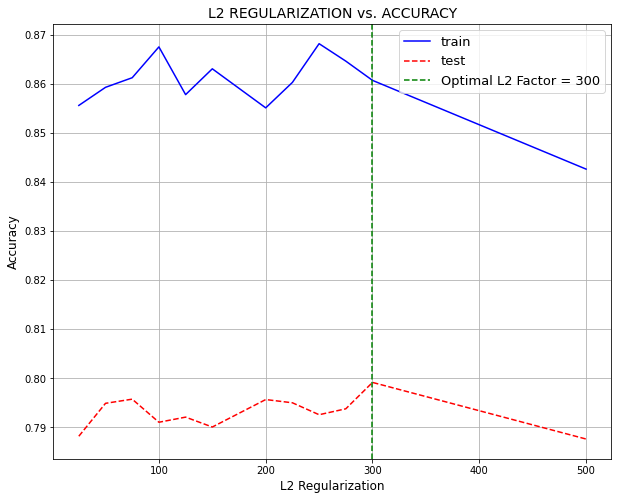

In [ ]:
#Tunning L2 Regularization Factor

l2_regularization = np.array([25, 50, 75, 100, 125, 150, 200, 225, 250, 275, 300, 500])
train_accuracies = []
test_accuracies = []
for l2_i in l2_regularization:
  print('-------------------L2 REGULARIZATION: {}---------------------'.format(l2_i))
  model_i = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = l2_i,
                               task_type='GPU',
                               verbose=0, 
                               #border_count=254
                               )  #od_type='Iter', od_wait=50, 

  model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
  acc_train = accuracy_score(y_train, model_i.predict(x_train))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('L2_regularization: {}, Train accuracy {} and test accuracy {}'.format(l2_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(l2_regularization, train_accuracies, '-b', label = 'train')
ax.plot(l2_regularization, test_accuracies, '--r', label = 'test')
plt.axvline(l2_regularization[test_accuracies.index(np.array(test_accuracies).max())], 
            c='g', ls='--', label='Optimal L2 Factor = 300')
ax.legend(loc='upper right', fontsize=13)
plt.title('L2 REGULARIZATION vs. ACCURACY', size=14)
plt.xlabel('L2 Regularization', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

-------------------BORDER COUNT: 32---------------------
L2_regularization: 32, Train accuracy 0.8549778686402776 and test accuracy 0.7902636234702382
-------------------BORDER COUNT: 64---------------------
L2_regularization: 64, Train accuracy 0.8505345101412972 and test accuracy 0.7920693638237831
-------------------BORDER COUNT: 128---------------------
L2_regularization: 128, Train accuracy 0.8607292028866025 and test accuracy 0.7991461114441536
-------------------BORDER COUNT: 254---------------------
L2_regularization: 254, Train accuracy 0.8665565723004739 and test accuracy 0.7955200093576829


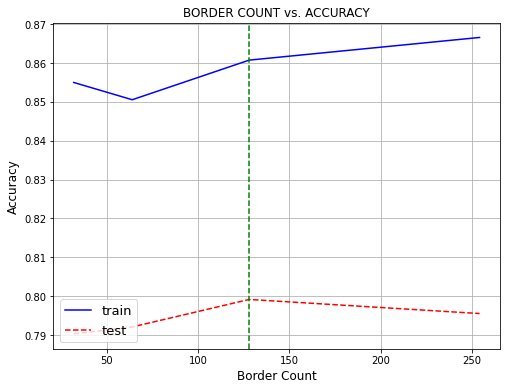

In [ ]:
#Border Count

border_counts = np.array([32, 64, 128, 254])
train_accuracies = []
test_accuracies = []
for bc_i in border_counts:
  print('-------------------BORDER COUNT: {}---------------------'.format(bc_i))
  model_i = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = 300,
                               border_count = bc_i,
                               task_type='GPU',
                               verbose=0)  #od_type='Iter', od_wait=50, 

  model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
  acc_train = accuracy_score(y_train, model_i.predict(x_train))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('L2_regularization: {}, Train accuracy {} and test accuracy {}'.format(bc_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(border_counts, train_accuracies, '-b', label = 'train')
ax.plot(border_counts, test_accuracies, '--r', label = 'test')
plt.axvline(border_counts[test_accuracies.index(np.array(test_accuracies).max())], c='g', ls='--', )
ax.legend(loc='lower left', fontsize=13)
plt.title('BORDER COUNT vs. ACCURACY')
plt.xlabel('Border Count', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

-------------------BAGGING TEMPERATURE: 2---------------------
Bagging Temperature: 2, Train accuracy 0.8634476737083205 and test accuracy 0.7939409003845422
-------------------BAGGING TEMPERATURE: 4---------------------
Bagging Temperature: 4, Train accuracy 0.8524806686993971 and test accuracy 0.7914187124413317
-------------------BAGGING TEMPERATURE: 6---------------------
Bagging Temperature: 6, Train accuracy 0.8449608760618226 and test accuracy 0.7937435117628997
-------------------BAGGING TEMPERATURE: 8---------------------
Bagging Temperature: 8, Train accuracy 0.8521790910123869 and test accuracy 0.7956442910824207
-------------------BAGGING TEMPERATURE: 10---------------------
Bagging Temperature: 10, Train accuracy 0.8505293841749458 and test accuracy 0.801178483178103
-------------------BAGGING TEMPERATURE: 12---------------------
Bagging Temperature: 12, Train accuracy 0.8391053138330182 and test accuracy 0.7926249762402585
-------------------BAGGING TEMPERATURE: 15-------

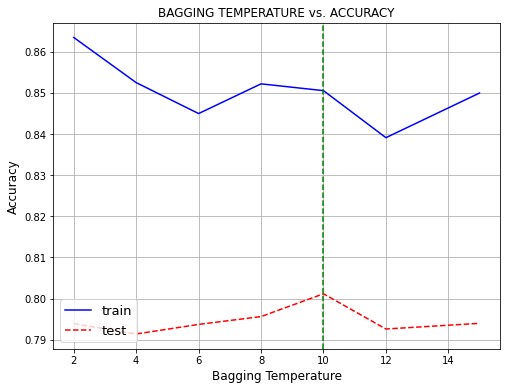

In [ ]:
#Bagging temperature

bagging_temperatures = np.array([2, 4, 6, 8, 10, 12, 15])
train_accuracies = []
test_accuracies = []
for bt_i in bagging_temperatures:
  print('-------------------BAGGING TEMPERATURE: {}---------------------'.format(bt_i))
  model_i = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = 300,
                               border_count = 128,
                               bagging_temperature = bt_i, 
                               task_type='GPU',
                               verbose=0)  #od_type='Iter', od_wait=50, 

  model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
  acc_train = accuracy_score(y_train, model_i.predict(x_train))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Bagging Temperature: {}, Train accuracy {} and test accuracy {}'.format(bt_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(bagging_temperatures, train_accuracies, '-b', label = 'train')
ax.plot(bagging_temperatures, test_accuracies, '--r', label = 'test')
plt.axvline(bagging_temperatures[test_accuracies.index(np.array(test_accuracies).max())], c='g', ls='--', )
ax.legend(loc='lower left', fontsize=13)
plt.title('BAGGING TEMPERATURE vs. ACCURACY')
plt.xlabel('Bagging Temperature', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

-------------------GROW POLICYT: SymmetricTree---------------------
Grow Policy: SymmetricTree, Train accuracy 0.8607292028866025 and test accuracy 0.7991461114441536
-------------------GROW POLICYT: Lossguide---------------------
Grow Policy: Lossguide, Train accuracy 0.8602627399486207 and test accuracy 0.7899858172620005
-------------------GROW POLICYT: Depthwise---------------------
Grow Policy: Depthwise, Train accuracy 0.8635356694640204 and test accuracy 0.7907168862310471


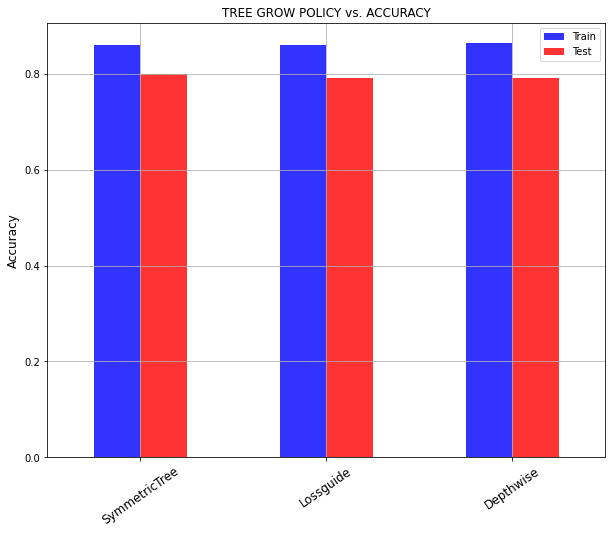

In [ ]:
#Tree growth policy


growth_policies = ['SymmetricTree', 'Lossguide', 'Depthwise']
train_accuracies = []
test_accuracies = []
for policy_i in growth_policies:
  print('-------------------GROW POLICYT: {}---------------------'.format(policy_i))
  model_i = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = 300,
                               #border_count = 128,
                               #bagging_temperature = 10,
                               grow_policy = policy_i,
                               task_type='GPU',
                               verbose=0)  #od_type='Iter', od_wait=50,  

  model_i.fit(x_train, y_train, early_stopping_rounds=25, eval_set=[(x_test[x_train.columns], y_test)])
  acc_train = accuracy_score(y_train, model_i.predict(x_train))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[x_train.columns]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Grow Policy: {}, Train accuracy {} and test accuracy {}'.format(policy_i, acc_train, acc_test))

#Plotting
dictionaryy1 = dict(zip(growth_policies, train_accuracies))
dictionaryy2 = dict(zip(growth_policies, test_accuracies))
total_dict = {'Train':dictionaryy1,
              'Test': dictionaryy2}

pd.DataFrame(total_dict).plot(kind='bar', figsize=(10,8), color=['blue', 'red'], alpha=0.8)
plt.title('TREE GROW POLICY vs. ACCURACY')
plt.ylabel('Accuracy', size=12)
plt.xticks(size=12, rotation=35)
plt.grid(True)
plt.show()


##### Final Tuned Model

In [ ]:
modelxx = CatBoostClassifier(iterations=1000, 
                               learning_rate=0.1,
                               depth = 6,
                               l2_leaf_reg = 300,
                               #border_count = 128,
                               #bagging_temperature = 10,
                               grow_policy = 'SymmetricTree',
                               task_type='GPU',
                               verbose=0)

modelxx.fit(x_train, y_train, 
            early_stopping_rounds=25, 
            eval_set=[(x_test[x_train.columns], y_test)])

train_pred_catxx = modelxx.predict(x_train)
open_pred_catxx = modelxx.predict(x_test[x_train.columns])
hidden_pred_catxx = modelxx.predict(x_hidden[x_train.columns])

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_catxx))
print('Open set report:', metrics.classification_report(y_train, train_pred_catxx))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_catxx))
print('Open set report:', metrics.classification_report(y_test, open_pred_catxx))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_catxx))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_catxx))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: [-0.36609726]
Open set report:               precision    recall  f1-score   support

           0       0.83      0.81      0.82    168937
           1       0.77      0.58      0.66    150455
           2       0.89      0.96      0.92    720803
           3       0.79      0.60      0.68     33329
           4       0.64      0.03      0.05      1688
           5       0.82      0.63      0.71     56320
           6       0.88      0.85      0.87     10513
           7       0.98      0.99      0.98      8213
           8       0.86      0.81      0.83      1085
           9       0.78      0.79      0.79     15245
          10       0.86      0.45      0.59      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.86   1170511
   macro avg       0.76      0.63      0.66   1170511
weighted avg       0.85      0.86      0.85   1170511

----------

In [ ]:
#Storing results
train_cat_res = labeled_data.copy()
tes_cat_res = test_data.copy()
hidden_cat_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_cat_res['KNN_NA'] = train_pred_catxx
tes_cat_res['KNN_NA'] = open_pred_catxx
hidden_cat_res['KNN_NA'] = hidden_pred_catxx

In [ ]:
#Saving results 3 methods
train_cat_res.to_csv('/content/drive/MyDrive/Results_folder/CAT/train_cat_f_res.csv', index=False)
tes_cat_res.to_csv('/content/drive/MyDrive/Results_folder/CAT/tes_cat_f_res.csv', index=False)
hidden_cat_res.to_csv('/content/drive/MyDrive/Results_folder/CAT/hidden_cat_f_res.csv', index=False)

##### Plotting Results

In [ ]:
#Importing files
train_cat_res = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/train_cat_f_res.csv')
test_cat_res = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/tes_cat_f_res.csv')
hidden_cat_res = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/hidden_cat_f_res.csv')

In [ ]:
print(classification_report(hidden_cat_res.LITHO, hidden_cat_res.KNN_NA))

              precision    recall  f1-score   support

           0       0.75      0.79      0.77     14045
           1       0.67      0.43      0.52     12283
           2       0.88      0.95      0.91     71827
           3       0.30      0.29      0.30      4396
           4       0.00      0.00      0.00       287
           5       0.63      0.61      0.62      8374
           6       0.70      0.44      0.54      2905
           7       0.99      1.00      0.99      6498
           8       0.80      0.77      0.78       597
           9       0.59      0.56      0.57       941
          10       0.83      0.61      0.71       244

    accuracy                           0.81    122397
   macro avg       0.65      0.59      0.61    122397
weighted avg       0.80      0.81      0.80    122397



/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning:

invalid value encountered in long_scalars



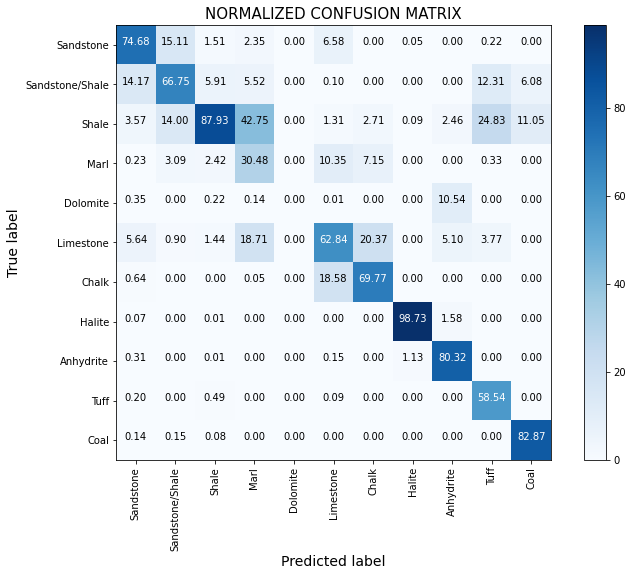

In [ ]:
litho_confusion_matrix(hidden_cat_res.LITHO, hidden_cat_res.KNN_NA)

#### **B2. LIGHT GRADIENT BOOSTING CLASSIFIER (Boosting Method) (FINISHED)**

##### Setting Light XGB in Google Colab with GPU support

In [ ]:
pip uninstall lightgbm -y

Uninstalling lightgbm-2.2.3:
  Successfully uninstalled lightgbm-2.2.3


In [ ]:
! git clone --recursive https://github.com/Microsoft/LightGBM

Cloning into 'LightGBM'...
remote: Enumerating objects: 22229, done.
remote: Counting objects: 100% (775/775), done.
remote: Compressing objects: 100% (420/420), done.
remote: Total 22229 (delta 475), reused 538 (delta 341), pack-reused 21454
Receiving objects: 100% (22229/22229), 17.56 MiB | 18.21 MiB/s, done.
Resolving deltas: 100% (16185/16185), done.
Submodule 'include/boost/compute' (https://github.com/boostorg/compute) registered for path 'external_libs/compute'
Submodule 'eigen' (https://gitlab.com/libeigen/eigen.git) registered for path 'external_libs/eigen'
Submodule 'external_libs/fast_double_parser' (https://github.com/lemire/fast_double_parser.git) registered for path 'external_libs/fast_double_parser'
Submodule 'external_libs/fmt' (https://github.com/fmtlib/fmt.git) registered for path 'external_libs/fmt'
Cloning into '/content/LightGBM/external_libs/compute'...
remote: Enumerating objects: 21731, done.        
remote: Counting objects: 100% (3/3), done.        
remote: Co

In [ ]:
! cd LightGBM && rm -rf build && mkdir build && cd build && cmake -DUSE_GPU=1 ../../LightGBM && make -j4 && cd ../python-package && python3 setup.py install --precompile --gpu;

-- The C compiler identification is GNU 7.5.0
-- The CXX compiler identification is GNU 7.5.0
-- Check for working C compiler: /usr/bin/cc
-- Check for working C compiler: /usr/bin/cc -- works
-- Detecting C compiler ABI info
-- Detecting C compiler ABI info - done
-- Detecting C compile features
-- Detecting C compile features - done
-- Check for working CXX compiler: /usr/bin/c++
-- Check for working CXX compiler: /usr/bin/c++ -- works
-- Detecting CXX compiler ABI info
-- Detecting CXX compiler ABI info - done
-- Detecting CXX compile features
-- Detecting CXX compile features - done
-- Found OpenMP_C: -fopenmp (found version "4.5") 
-- Found OpenMP_CXX: -fopenmp (found version "4.5") 
-- Found OpenMP: TRUE (found version "4.5")  
-- Looking for CL_VERSION_2_2
-- Looking for CL_VERSION_2_2 - found
-- Found OpenCL: /usr/lib/x86_64-linux-gnu/libOpenCL.so (found version "2.2") 
-- OpenCL include directory: /usr/include
-- Boost version: 1.65.1
-- Found the following Boost libraries:
--

In [ ]:
import lightgbm as lgbm

##### Base Model

In [ ]:
#Base Model
base_lgxb = lgbm.LGBMClassifier(device='gpu', random_state=42,
                                gpu_platform_id=1, gpu_device_id=0,
                                verbose=1)

base_lgxb.fit(x_train, y_train.values.ravel(), verbose=1)

#Predicting
train_pred_xgb = base_lgxb.predict(x_train)
open_pred_xgb = base_lgxb.predict(x_test)
hidden_pred_xgb = base_lgxb.predict(x_hidden)

[LightGBM] [Info] This is the GPU trainer!!
[LightGBM] [Info] Total Bins 6584
[LightGBM] [Info] Number of data points in the train set: 1170511, number of used features: 30
[LightGBM] [Info] Using GPU Device: Tesla K80, Vendor: NVIDIA Corporation
[LightGBM] [Info] Compiling OpenCL Kernel with 256 bins...
[LightGBM] [Info] GPU programs have been built
[LightGBM] [Info] Size of histogram bin entry: 8
[LightGBM] [Info] 28 dense feature groups (31.26 MB) transferred to GPU in 0.049002 secs. 1 sparse feature groups
[LightGBM] [Info] Start training from score -1.935670
[LightGBM] [Info] Start training from score -2.051532
[LightGBM] [Info] Start training from score -0.484830
[LightGBM] [Info] Start training from score -3.558768
[LightGBM] [Info] Start training from score -6.541651
[LightGBM] [Info] Start training from score -3.034146
[LightGBM] [Info] Start training from score -4.712583
[LightGBM] [Info] Start training from score -4.959477
[LightGBM] [Info] Start training from score -6.98361

In [ ]:
#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(y_train, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(y_test, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.4257913851300842
Open set report:               precision    recall  f1-score   support

           0       0.79      0.77      0.78    168937
           1       0.73      0.59      0.65    150455
           2       0.89      0.94      0.92    720803
           3       0.73      0.71      0.72     33329
           4       0.36      0.38      0.37      1688
           5       0.77      0.61      0.68     56320
           6       0.76      0.83      0.80     10513
           7       0.96      0.92      0.94      8213
           8       0.42      0.42      0.42      1085
           9       0.68      0.88      0.77     15245
          10       0.55      0.56      0.56      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.84   1170511
   macro avg       0.64      0.63      0.63   1170511
weighted avg       0.84      0.84      0.84   1170511

----

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Open set report:               precision    recall  f1-score   support

           0       0.77      0.78      0.77     24048
           1       0.49      0.25      0.33     17558
           2       0.87      0.85      0.86     83975
           3       0.31      0.58      0.40      3306
           4       0.02      0.02      0.02       416
           5       0.41      0.39      0.40      4798
           6       0.01      0.15      0.02       625
           7       0.00      0.00      0.00         0
           8       0.68      0.10      0.18       125
           9       0.44      0.44      0.44      1245
          10       0.23      0.32      0.27       690

    accuracy                           0.72    136786
   macro avg       0.38      0.35      0.34    136786
weighted avg       0.76      0.72      0.73    136786

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.9821063833263887
Hidden set report:               precision    recall  f

##### Recursive Feature Selection

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train)

In [ ]:
#Feature selection by recursive feature elimination
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
import warnings
warnings.filterwarnings('ignore')

base_cat = lgbm.LGBMClassifier(device='gpu', gpu_platform_id=1, gpu_device_id=0, verbose=0)
rfe_cat = RFECV(estimator=base_cat, step=1, min_features_to_select=2, cv=StratifiedKFold(10), scoring='accuracy', verbose=1)
rfe_cat.fit(x_train_strat, y_train_strat)

Se han truncado las últimas 5000 líneas del flujo de salida.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
Fitting estimator with 14 features.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[Li

RFECV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
      estimator=LGBMClassifier(boosting_type='gbdt', class_weight=None,
                               colsample_bytree=1.0, device='gpu',
                               gpu_device_id=0, gpu_platform_id=1,
                               importance_type='split', learning_rate=0.1,
                               max_depth=-1, min_child_samples=20,
                               min_child_weight=0.001, min_split_gain=0.0,
                               n_estimators=100, n_jobs=-1, num_leaves=31,
                               objective=None, random_state=None, reg_alpha=0.0,
                               reg_lambda=0.0, silent=True, subsample=1.0,
                               subsample_for_bin=200000, subsample_freq=0,
                               verbose=0),
      min_features_to_select=2, n_jobs=None, scoring='accuracy', step=1,
      verbose=1)

Optimal number of features: 24


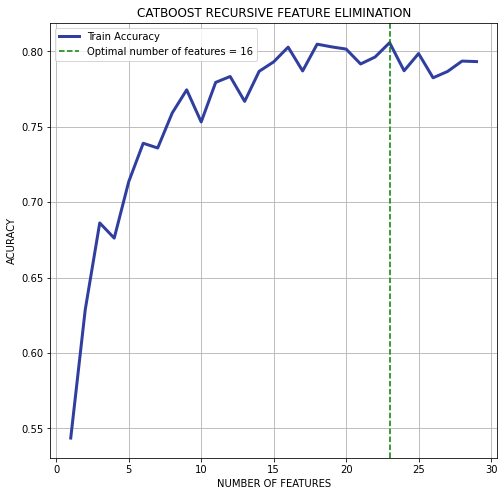

In [ ]:
print('Optimal number of features: {}'.format(rfe_cat.n_features_))

#Plotting Data
plt.figure(figsize=(8, 8))
num_features = list(range(1, len(rfe_cat.grid_scores_)+1))
scores = list(rfe_cat.grid_scores_)
plt.plot(num_features, rfe_cat.grid_scores_, color='#303F9F', linewidth=3, label='Train Accuracy')
plt.axvline(num_features[scores.index(np.array(scores).max())], c='g', ls='--', label='Optimal number of features = 16')
plt.title('CATBOOST RECURSIVE FEATURE ELIMINATION')
plt.xlabel('NUMBER OF FEATURES')
plt.ylabel('ACURACY')
plt.legend()
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

In [ ]:
x_train.columns

Index(['RDEP', 'GR', 'NPHI_COMB', 'GM', 'DTC', 'DTS_COMB', 'RSHA', 'DT_R',
       'RHOB', 'K', 'DCAL', 'Y_LOC', 'GROUP_encoded', 'WELL_encoded',
       'DEPTH_MD', 'Z_LOC', 'CALI', 'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD',
       'ROP', 'DRHO'],
      dtype='object')

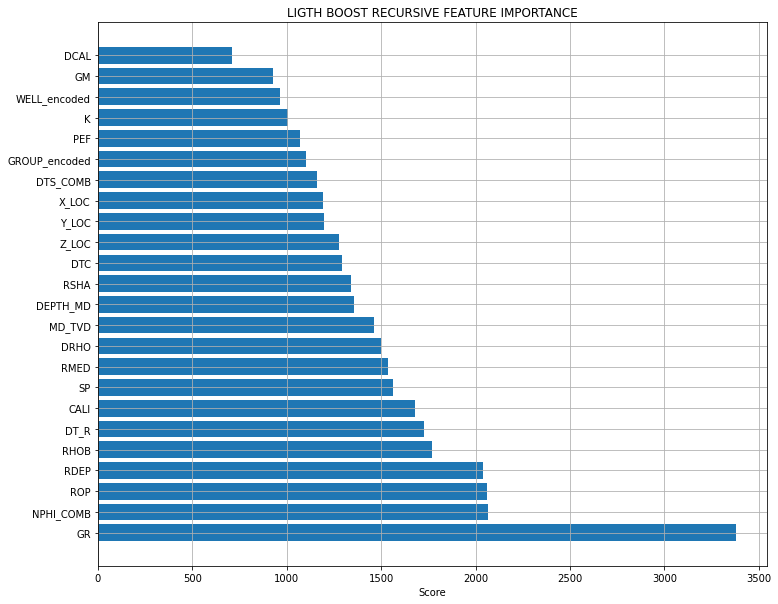

In [ ]:
#Ploting Feature Importance after recursive feature selection
#new_set = x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

dset = pd.DataFrame()
dset['attr'] = x_train.columns
dset['importance'] = rfe_cat.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(12, 10))
plt.barh(y=dset['attr'], width=dset['importance'])
plt.title('LIGTH BOOST RECURSIVE FEATURE IMPORTANCE')
plt.xlabel('Score')
plt.grid()

##### Tuning Model

In [ ]:
selected_fetures_lgbm = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'DTC', 'DTS_COMB', 'RSHA', 'DT_R',
                        'RHOB', 'K', 'DCAL', 'Y_LOC', 'GROUP_encoded', 'WELL_encoded',
                        'DEPTH_MD', 'Z_LOC', 'CALI', 'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD',
                        'ROP', 'DRHO']

In [ ]:
#Tunning Learning rate and n_trees
import lightgbm as lgbm

learning_rates = np.array([0.005, 0.010, 0.015, 0.020, 0.025, 0.030, 0.035, 0.040, 0.045, 0.05, 
                           0.065, 0.075, 0.10, 0.15, 0.25 , 0.35 , 0.45, 0.5])

train_accuracies = []
test_accuracies = []
for l_rate in learning_rates:
  model_i = lgbm.LGBMClassifier(n_estimators=1000, learning_rate=l_rate, 
                                  is_unbalance=True, random_state=42,
                                  device='gpu', gpu_platform_id=1,
                                  gpu_device_id=0, verbose=0)

  model_i.fit(x_train[selected_fetures_lgbm], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_lgbm], y_test)], verbose=True)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[selected_fetures_lgbm]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[selected_fetures_lgbm]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Learning Rate: {}, Train accuracy {} and test accuracy {}'.format(l_rate, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(learning_rates, train_accuracies, '-b', label = 'train')
ax.plot(learning_rates, test_accuracies, '--r', label = 'test')
plt.axvline(learning_rates[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Learning Rate = 0.015')
ax.legend(loc='lower left', fontsize=13)
plt.title('LEARNING RATE vs. ACCURACY', size=14)
plt.xlabel('Learning Rate', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

[1]	valid_0's multi_logloss: 1.20106
Training until validation scores don't improve for 25 rounds
[2]	valid_0's multi_logloss: 1.19391
[3]	valid_0's multi_logloss: 1.18727
[4]	valid_0's multi_logloss: 1.1806
[5]	valid_0's multi_logloss: 1.17419
[6]	valid_0's multi_logloss: 1.16819
[7]	valid_0's multi_logloss: 1.16246
[8]	valid_0's multi_logloss: 1.15675
[9]	valid_0's multi_logloss: 1.15147
[10]	valid_0's multi_logloss: 1.14601
[11]	valid_0's multi_logloss: 1.14053
[12]	valid_0's multi_logloss: 1.13533
[13]	valid_0's multi_logloss: 1.13033
[14]	valid_0's multi_logloss: 1.12521
[15]	valid_0's multi_logloss: 1.12049
[16]	valid_0's multi_logloss: 1.11552
[17]	valid_0's multi_logloss: 1.11128
[18]	valid_0's multi_logloss: 1.10697
[19]	valid_0's multi_logloss: 1.10254
[20]	valid_0's multi_logloss: 1.09813
[21]	valid_0's multi_logloss: 1.09387
[22]	valid_0's multi_logloss: 1.08971
[23]	valid_0's multi_logloss: 1.08571
[24]	valid_0's multi_logloss: 1.08187
[25]	valid_0's multi_logloss: 1.07796

Se han truncado las últimas 5000 líneas del flujo de salida.
[320]	valid_0's multi_logloss: 0.788281
[321]	valid_0's multi_logloss: 0.788093
[322]	valid_0's multi_logloss: 0.787867
[323]	valid_0's multi_logloss: 0.787314
[324]	valid_0's multi_logloss: 0.787042
[325]	valid_0's multi_logloss: 0.787242
[326]	valid_0's multi_logloss: 0.787036
[327]	valid_0's multi_logloss: 0.786809
[328]	valid_0's multi_logloss: 0.786613
[329]	valid_0's multi_logloss: 0.786313
[330]	valid_0's multi_logloss: 0.78612
[331]	valid_0's multi_logloss: 0.785412
[332]	valid_0's multi_logloss: 0.7851
[333]	valid_0's multi_logloss: 0.785021
[334]	valid_0's multi_logloss: 0.784438
[335]	valid_0's multi_logloss: 0.78417
[336]	valid_0's multi_logloss: 0.783925
[337]	valid_0's multi_logloss: 0.783739
[338]	valid_0's multi_logloss: 0.783702
[339]	valid_0's multi_logloss: 0.783544
[340]	valid_0's multi_logloss: 0.783253
[341]	valid_0's multi_logloss: 0.783051
[342]	valid_0's multi_logloss: 0.782887
[343]	valid_0's multi_l

NameError: ignored

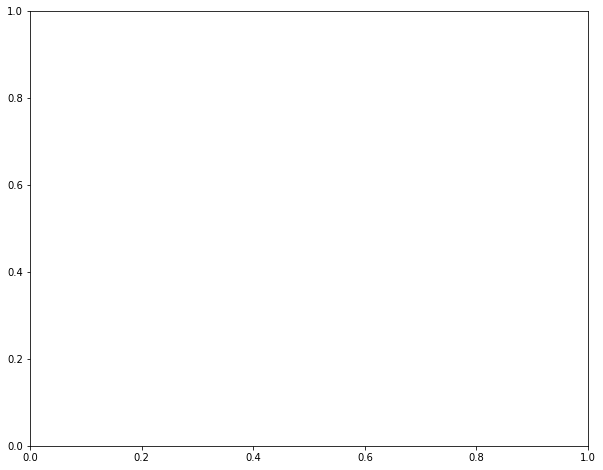

In [ ]:
#Tunning Maximum Tree Depth
import lightgbm as lgbm

tree_depths = np.array([2, 4, 6, 8, 10, 12, 15, 18, 20, 22, 25, 28, 30])

train_accuracies = []
test_accuracies = []
for depth_i in tree_depths:
  print('-------------------MAXIMUM DEPTH: {}---------------------'.format(depth_i))
  model_i = lgbm.LGBMClassifier(n_estimators=1000, learning_rate=0.015, 
                                is_unbalance=True, random_state=42,
                                max_depth = depth_i,
                                device='gpu', gpu_platform_id=1,
                                gpu_device_id=0, verbose=0)

  model_i.fit(x_train[selected_fetures_lgbm], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_lgbm], y_test)], verbose=True)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[selected_fetures_lgbm]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[selected_fetures_lgbm]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Maximum Depth: {}, Train accuracy {} and test accuracy {}'.format(depth_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(learning_rates, train_accuracies, '-b', label = 'train')
ax.plot(learning_rates, test_accuracies, '--r', label = 'test')
plt.axvline(learning_rates[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Maximum Depth')
ax.legend(loc='lower left', fontsize=13)
plt.title('MAXIMUM DEPTH vs. ACCURACY', size=14)
plt.xlabel('Maximum Depth', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

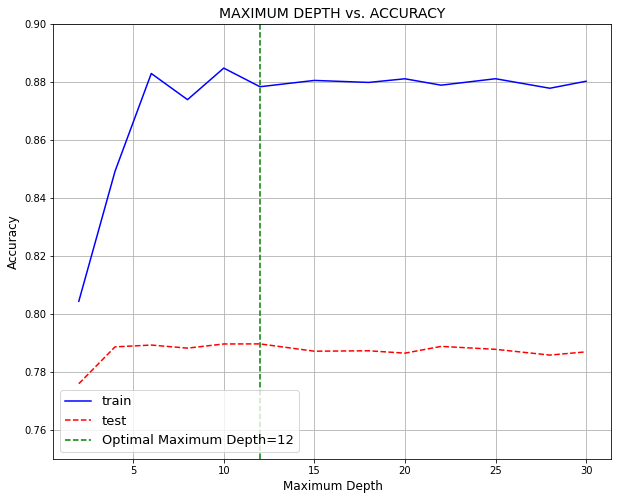

In [ ]:
#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(tree_depths, train_accuracies, '-b', label = 'train')
ax.plot(tree_depths, test_accuracies, '--r', label = 'test')
plt.axvline(tree_depths[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Maximum Depth=12')
ax.legend(loc='lower left', fontsize=13)
plt.ylim(0.75, 0.90)
plt.title('MAXIMUM DEPTH vs. ACCURACY', size=14)
plt.xlabel('Maximum Depth', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

Se han truncado las últimas 5000 líneas del flujo de salida.
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits 

NameError: ignored

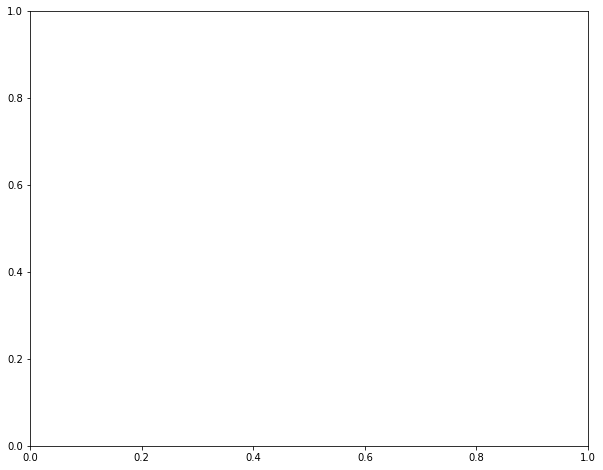

In [ ]:
#Tunning Regularization Factor
import lightgbm as lgbm

lambdas = np.array([1, 10, 50, 100, 250, 500])

train_accuracies = []
test_accuracies = []
for lambda_i in lambdas:
  print('-------------------LAMBDA: {}---------------------'.format(lambda_i))
  model_i = lgbm.LGBMClassifier(n_estimators=1000, learning_rate=0.015,
                                random_state=42,
                                max_depth = 8, reg_lambda=lambda_i,
                                device='gpu', gpu_platform_id=1,
                                gpu_device_id=0, verbose=0)


  model_i.fit(x_train[selected_fetures_lgbm], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_lgbm], y_test)], verbose=False)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[selected_fetures_lgbm]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[selected_fetures_lgbm]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Lambda Regularization Factor: {}, Train accuracy {} and test accuracy {}'.format(lambda_i, acc_train, acc_test))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(min_samples_splits, train_accuracies, '-b', label = 'train')
ax.plot(min_samples_splits, test_accuracies, '--r', label = 'test')
plt.axvline(min_samples_splits[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Lambda Factor')
ax.legend(loc='lower left', fontsize=13)
plt.title('LAMBDA FACTOR vs. ACCURACY', size=14)
plt.xlabel('Lambda Factor', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

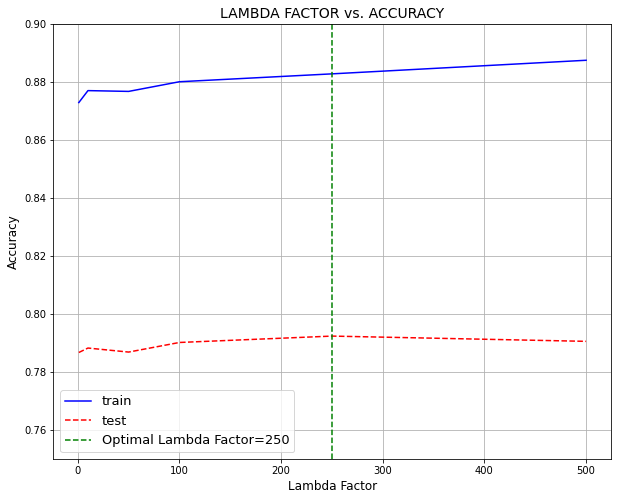

In [ ]:
#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(lambdas, train_accuracies, '-b', label = 'train')
ax.plot(lambdas, test_accuracies, '--r', label = 'test')
plt.axvline(lambdas[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Lambda Factor=250')
ax.legend(loc='lower left', fontsize=13)
plt.title('LAMBDA FACTOR vs. ACCURACY', size=14)
plt.xlabel('Lambda Factor', size=12)
plt.ylabel('Accuracy', size=12)
plt.ylim(0.75, 0.9)
plt.grid()

##### Final Tuned Model

In [ ]:
#Base Model
light_tunned = lgbm.LGBMClassifier(n_estimators=1000, learning_rate=0.015, 
                                  random_state=42, max_depth=8, 
                                  reg_lambda=250, verbose=0,
                                  objective='multi:softprob',
                                  device='gpu', gpu_platform_id=1,
                                  gpu_device_id=0)

light_tunned.fit(x_train[selected_fetures_lgbm], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_lgbm], y_test)], verbose=False)

#Predicting
train_pred_light = light_tunned.predict(x_train[selected_fetures_lgbm])
open_pred_light = light_tunned.predict(x_test[selected_fetures_lgbm])
hidden_pred_light = light_tunned.predict(x_hidden[selected_fetures_lgbm])

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_light))
print('Open set report:', metrics.classification_report(y_train, train_pred_light))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_light))
print('Open set report:', metrics.classification_report(y_test, open_pred_light))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_light))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_light))

NameError: ignored

In [ ]:
#Storing results
train_light_res = labeled_data.copy()
test_light_res = test_data.copy()
hidden_light_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_light_res['LGBM_TM'] = train_pred_light
test_light_res['LGBM_TM'] = open_pred_light
hidden_light_res['LGBM_TM'] = hidden_pred_light

In [ ]:
#Saving results 3 methods
train_light_res.to_csv('/content/drive/MyDrive/Results_folder/LGBM/train_light_f_res.csv', index=False)
test_light_res.to_csv('/content/drive/MyDrive/Results_folder/LGBM/tes_light_f_res.csv', index=False)
hidden_light_res.to_csv('/content/drive/MyDrive/Results_folder/LGBM/hidden_light_f_res.csv', index=False)

##### Plotting Results

In [ ]:
#Importing files
train_lgbm_res = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/train_light_f_res.csv')
test_lgbm_res = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/tes_light_f_res.csv')
hidden_lgbm_res = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/hidden_light_f_res.csv')

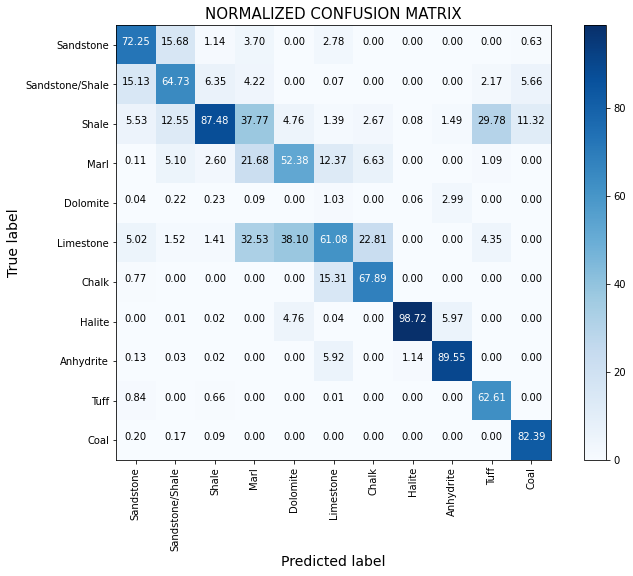

In [ ]:
litho_confusion_matrix(hidden_lgbm_res.LITHO, hidden_lgbm_res.LGBM_TM)

#### **B3. XGBOOSTING CLASSIFIER (Boosting Method) (FINISHED)**

##### Base Model

In [ ]:
#Base Model
%%time
model_xgb = XGBClassifier(tree_method='gpu_hist', 
                          predictor='gpu_predictor',
                          random_state=42)

model_xgb.fit(x_train, y_train.values.ravel(), verbose=1)

train_pred_xgb = model_xgb.predict(x_train)
open_pred_xgb = model_xgb.predict(x_test)
hidden_pred_xgb = model_xgb.predict(x_hidden)

#Printing Reports 

print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(y_train, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(y_test, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.4586058994746739
Open set report:               precision    recall  f1-score   support

           0       0.80      0.76      0.78    168937
           1       0.73      0.40      0.52    150455
           2       0.84      0.96      0.90    720803
           3       0.76      0.46      0.57     33329
           4       0.66      0.13      0.22      1688
           5       0.81      0.61      0.70     56320
           6       0.85      0.88      0.86     10513
           7       0.99      1.00      0.99      8213
           8       0.91      0.91      0.91      1085
           9       0.72      0.83      0.77     15245
          10       0.82      0.50      0.62      3820
          11       0.99      0.98      0.99       103

    accuracy                           0.83   1170511
   macro avg       0.82      0.70      0.74   1170511
weighted avg       0.82      0.83      0.81   1170511

----

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.5077575430770362
Hidden set report:               precision    recall  f1-score   support

           0       0.76      0.68      0.72     14045
           1       0.59      0.38      0.46     12283
           2       0.86      0.96      0.91     71827
           3       0.27      0.15      0.19      4396
           4       0.44      0.08      0.14       287
           5       0.53      0.65      0.58      8374
           6       0.69      0.32      0.44      2905
           7       0.98      1.00      0.99      6498
           8       0.75      0.57      0.65       597
           9       0.66      0.55      0.60       941
          10       0.82      0.66      0.73       244

    accuracy                           0.80    122397
   macro avg       0.67      0.54      0.58    122397
weighted avg       0.78      0.80      0.78    122397

CPU times: user 35.9 s, sys: 607 ms, total: 36.6 s
Wall time: 37.1 s


##### Recursive Feature Selection

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train)

In [ ]:
#Feature selection by recursive feature elimination
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
import warnings
warnings.filterwarnings('ignore')

base_cat = XGBClassifier(tree_method='gpu_hist', predictor='gpu_predictor')
rfe_cat = RFECV(estimator=base_cat, step=1, min_features_to_select=2, cv=StratifiedKFold(10), scoring='accuracy', verbose=1)
rfe_cat.fit(x_train_strat, y_train_strat)

Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.
Fitting estimator with 3 features.

RFECV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
      estimator=XGBClassifier(base_score=0.5, booster='gbtree',
                              colsample_bylevel=1, colsample_bynode=1,
                              colsample_bytree=1, gamma=0, learning_rate=0.1,
                              max_delta_step=0, max_depth=3, min_child_weight=1,
                              missing=None, n_estimators=100, n_jobs=1,
                              nthread=None, objective='binary:logistic',
                              predictor='gpu_predictor', random_state=0,
                              reg_alpha=0, reg_lambda=1, scale_pos_weight=1,
                              seed=None, silent=None, subsample=1,
                              tree_method='gpu_hist', verbosity=1),
      min_features_to_select=2, n_jobs=None, scoring='accuracy', step=1,
      verbose=1)

Optimal number of features: 28


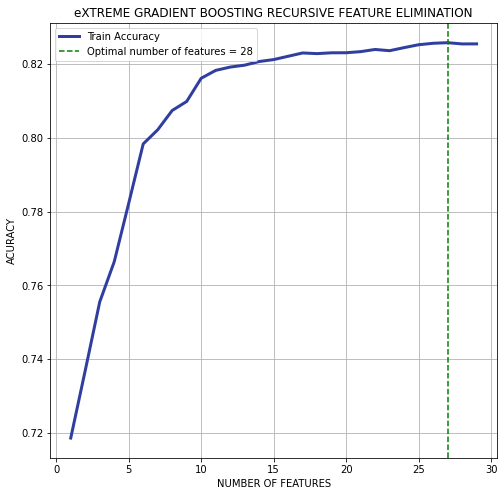

In [ ]:
print('Optimal number of features: {}'.format(rfe_cat.n_features_))

#Plotting Data
plt.figure(figsize=(8, 8))
num_features = list(range(1, len(rfe_cat.grid_scores_)+1))
scores = list(rfe_cat.grid_scores_)
plt.plot(num_features, rfe_cat.grid_scores_, color='#303F9F', linewidth=3, label='Train Accuracy')
plt.axvline(num_features[scores.index(np.array(scores).max())], c='g', ls='--', label='Optimal number of features = 28')
plt.title('eXTREME GRADIENT BOOSTING RECURSIVE FEATURE ELIMINATION')
plt.xlabel('NUMBER OF FEATURES')
plt.ylabel('ACURACY')
plt.legend()
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

In [ ]:
x_train.columns

Index(['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'DTC', 'DTS_COMB', 'RSHA',
       'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
       'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
       'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO'],
      dtype='object')

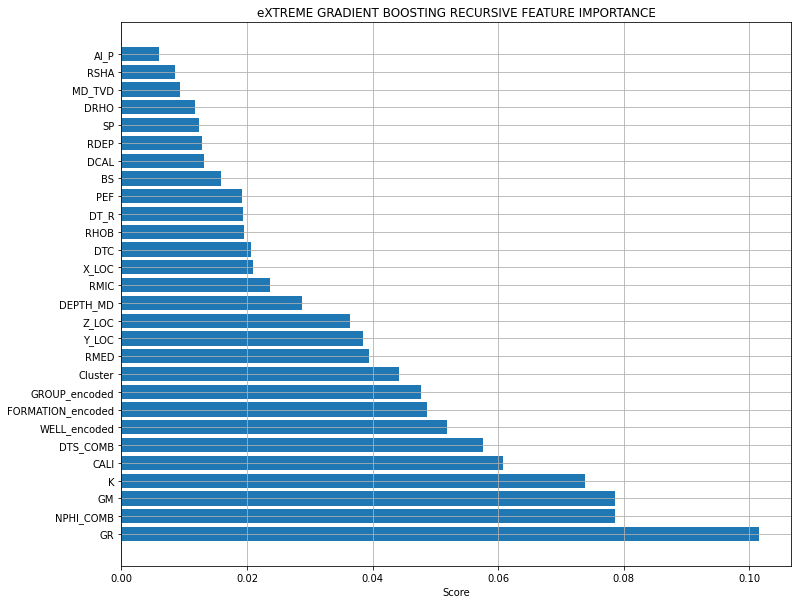

In [ ]:
#Ploting Feature Importance after recursive feature selection
#new_set = x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

dset = pd.DataFrame()
dset['attr'] = x_train.columns
dset['importance'] = rfe_cat.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(12, 10))
plt.barh(y=dset['attr'], width=dset['importance'])
plt.title('eXTREME GRADIENT BOOSTING RECURSIVE FEATURE IMPORTANCE')
plt.xlabel('Score')
plt.grid()

##### Tuning Model

In [ ]:
selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']

-------------------LEARNING RATE: 0.001---------------------
Learning Rate: 0.001, Train accuracy 0.7502125140216538 and test accuracy 0.7377801821823871 and hidden accuracy 0.7009730630652712
-------------------LEARNING RATE: 0.005---------------------
Learning Rate: 0.005, Train accuracy 0.7540330676089332 and test accuracy 0.7437822584182592 and hidden accuracy 0.7049845992957344
-------------------LEARNING RATE: 0.01---------------------
Learning Rate: 0.01, Train accuracy 0.7542645904224736 and test accuracy 0.7440893073852587 and hidden accuracy 0.7046741341699552
-------------------LEARNING RATE: 0.025---------------------
Learning Rate: 0.025, Train accuracy 0.8425738843974981 and test accuracy 0.7913967803722604 and hidden accuracy 0.8091946698039985
-------------------LEARNING RATE: 0.05---------------------
Learning Rate: 0.05, Train accuracy 0.8437613999355837 and test accuracy 0.7924422089979969 and hidden accuracy 0.8068580112257654
-------------------LEARNING RATE: 0.075

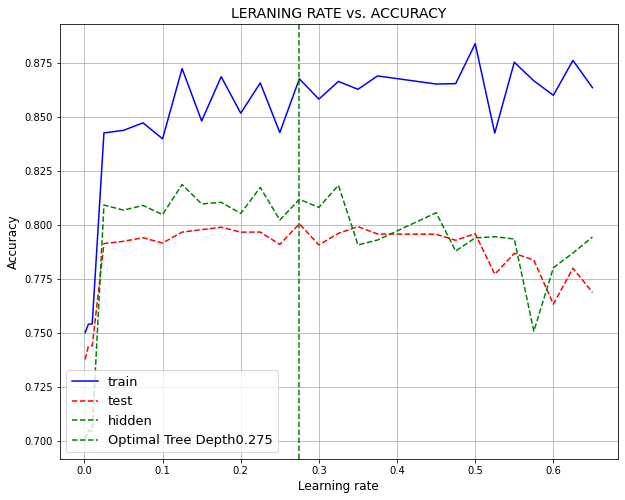

In [ ]:
learning_rates = np.array([0.001, 0.005, 0.01, 0.025, 0.05 , 0.075, 0.1  , 0.125, 0.15 , 0.175, 0.2,
                            0.225, 0.25 , 0.275, 0.3  , 0.325, 0.35 , 0.375, 0.45 , 0.475, 0.5, 
                           0.525, 0.55 , 0.575, 0.6  , 0.625, 0.65  ])

train_accuracies = []
test_accuracies = []
hidden_accuracies = []
for lr_i in learning_rates:
  print('-------------------LEARNING RATE: {}---------------------'.format(lr_i))
  model_i = XGBClassifier(random_state=42, n_estimators=1000,
                          objective='multi:softprob', learning_rate=lr_i,
                          tree_method='gpu_hist', predictor='gpu_predictor')

  model_i.fit(x_train[selected_fetures_xgb], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_xgb], y_test)], verbose=0)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[selected_fetures_xgb]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[selected_fetures_xgb]))
  acc_hidden = accuracy_score(y_hidden, model_i.predict(x_hidden[selected_fetures_xgb]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train), hidden_accuracies.append(acc_hidden)
  print('Learning Rate: {}, Train accuracy {} and test accuracy {} and hidden accuracy {}'.format(lr_i, acc_train, acc_test, acc_hidden))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(learning_rates, train_accuracies, '-b', label = 'train')
ax.plot(learning_rates, test_accuracies, '--r', label = 'test')
ax.plot(learning_rates, hidden_accuracies, '--g', label = 'hidden')

plt.axvline(learning_rates[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Tree Depth'+str(learning_rates[test_accuracies.index(np.array(test_accuracies).max())]))
ax.legend(loc='lower left', fontsize=13)
plt.title('LERANING RATE vs. ACCURACY', size=14)
plt.xlabel('Learning rate', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

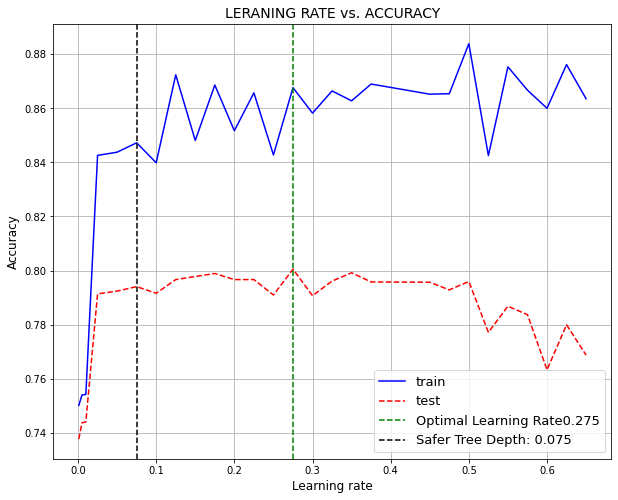

In [ ]:
#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(learning_rates, train_accuracies, '-b', label = 'train')
ax.plot(learning_rates, test_accuracies, '--r', label = 'test')
#ax.plot(learning_rates, hidden_accuracies, '--g', label = 'hidden')

plt.axvline(learning_rates[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Learning Rate'+str(learning_rates[test_accuracies.index(np.array(test_accuracies).max())]))
plt.axvline(0.075, c='black', ls='--', label='Safer Tree Depth: 0.075')
ax.legend(loc='lower right', fontsize=13)
plt.title('LERANING RATE vs. ACCURACY', size=14)
plt.xlabel('Learning rate', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

-------------------MAXIMUM TREE DEPTH: 2---------------------
Max Tree Depth: 2, Train accuracy 0.7125452046157619 and test accuracy 0.7412746918544295 and hidden accuracy 0.6794365874980596
-------------------MAXIMUM TREE DEPTH: 3---------------------
Max Tree Depth: 3, Train accuracy 0.8532666502066192 and test accuracy 0.7942333279721608 and hidden accuracy 0.8105264017908935
-------------------MAXIMUM TREE DEPTH: 4---------------------
Max Tree Depth: 4, Train accuracy 0.8645685516838373 and test accuracy 0.8011565511090316 and hidden accuracy 0.821776677532946
-------------------MAXIMUM TREE DEPTH: 5---------------------
Max Tree Depth: 5, Train accuracy 0.8594929906681783 and test accuracy 0.7941602210752562 and hidden accuracy 0.809358072501777
-------------------MAXIMUM TREE DEPTH: 6---------------------
Max Tree Depth: 6, Train accuracy 0.8811561787971236 and test accuracy 0.7843273434415803 and hidden accuracy 0.8007467503288479
-------------------MAXIMUM TREE DEPTH: 7-------

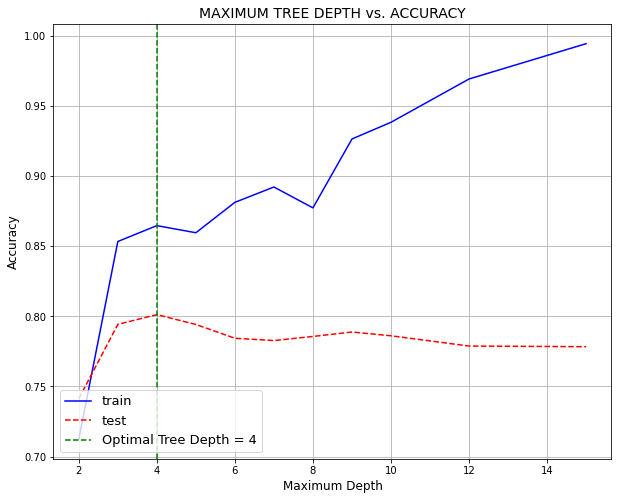

In [ ]:
depths = np.array([2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 15])

train_accuracies = []
test_accuracies = []
for depth_i in depths:
  print('-------------------MAXIMUM TREE DEPTH: {}---------------------'.format(depth_i))
  model_i = XGBClassifier(random_state=42, n_estimators=1000,
                          objective='multi:softprob', max_depth=depth_i, 
                          tree_method='gpu_hist', predictor='gpu_predictor')

  model_i.fit(x_train[selected_fetures_xgb], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_xgb], y_test)], verbose=0)
  acc_train = accuracy_score(y_train, model_i.predict(x_train[selected_fetures_xgb]))
  acc_test = accuracy_score(y_test, model_i.predict(x_test[selected_fetures_xgb]))
  acc_hidden = accuracy_score(y_hidden, model_i.predict(x_hidden[selected_fetures_xgb]))
  test_accuracies.append(acc_test), train_accuracies.append(acc_train)
  print('Max Tree Depth: {}, Train accuracy {} and test accuracy {} and hidden accuracy {}'.format(depth_i, acc_train, acc_test, acc_hidden))

#Plotting results 
fig, ax = plt.subplots(figsize=(10, 8))
ax.plot(depths, train_accuracies, '-b', label = 'train')
ax.plot(depths, test_accuracies, '--r', label = 'test')
plt.axvline(depths[test_accuracies.index(np.array(test_accuracies).max())], 
             c='g', ls='--', label='Optimal Tree Depth = 4')
ax.legend(loc='lower left', fontsize=13)
plt.title('MAXIMUM TREE DEPTH vs. ACCURACY', size=14)
plt.xlabel('Maximum Depth', size=12)
plt.ylabel('Accuracy', size=12)
plt.grid()

##### Tunned Model

In [ ]:
selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']


In [ ]:
#Tuned Model

xgb_tunned = XGBClassifier(n_estimators=1000, max_depth=4, booster='gbtree',
                          objective='multi:softprob', learning_rate=0.075, random_state=42,
                          subsample=1, colsample_bytree=1, tree_method='gpu_hist', 
                          predictor='gpu_predictor', verbose=2020, reg_lambda=1500)

xgb_tunned.fit(x_train[selected_fetures_xgb], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_xgb], y_test)], verbose=100)

#Predicting
train_pred_xgb = xgb_tunned.predict(x_train[selected_fetures_xgb])
open_pred_xgb = xgb_tunned.predict(x_test[selected_fetures_xgb])
hidden_pred_xgb = xgb_tunned.predict(x_hidden[selected_fetures_xgb])

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(y_train, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(y_test, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_xgb))

[0]	validation_0-merror:0.272579
Will train until validation_0-merror hasn't improved in 25 rounds.
[100]	validation_0-merror:0.213041
[200]	validation_0-merror:0.206783
[300]	validation_0-merror:0.204129
Stopping. Best iteration:
[295]	validation_0-merror:0.203881

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.35456586909478
Open set report:               precision    recall  f1-score   support

           0       0.83      0.82      0.82    168937
           1       0.77      0.58      0.66    150455
           2       0.89      0.96      0.93    720803
           3       0.80      0.66      0.72     33329
           4       0.58      0.11      0.19      1688
           5       0.83      0.65      0.73     56320
           6       0.89      0.90      0.90     10513
           7       0.99      0.99      0.99      8213
           8       0.91      0.88      0.90      1085
           9       0.82      0.86      0.84     15245
          1

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.4322828582399895
Hidden set report:               precision    recall  f1-score   support

           0       0.75      0.83      0.78     14045
           1       0.64      0.46      0.53     12283
           2       0.89      0.94      0.92     71827
           3       0.31      0.29      0.30      4396
           4       0.41      0.11      0.17       287
           5       0.72      0.61      0.66      8374
           6       0.82      0.74      0.78      2905
           7       0.99      0.99      0.99      6498
           8       0.73      0.65      0.69       597
           9       0.64      0.55      0.59       941
          10       0.81      0.69      0.75       244

    accuracy                           0.83    122397
   macro avg       0.70      0.62      0.65    122397
weighted avg       0.82      0.83      0.82    122397



In [ ]:
#Storing results
train_xgb_res = labeled_data.copy()
test_xgb_res = test_data.copy()
hidden_xgb_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_xgb_res['XGB_TM'] = train_pred_xgb
test_xgb_res['XGB_TM'] = open_pred_xgb
hidden_xgb_res['XGB_TM'] = hidden_pred_xgb

In [ ]:
#Saving results 3 methods
train_xgb_res.to_csv('/content/drive/MyDrive/Results_folder/XGB/train_xgb_final_res.csv', index=False)
test_xgb_res.to_csv('/content/drive/MyDrive/Results_folder/XGB/test_xgb_final_res.csv', index=False)
hidden_xgb_res.to_csv('/content/drive/MyDrive/Results_folder/XGB/hidden_xgb_final_res.csv', index=False)

##### Model Explanation

In [ ]:
#pip install shap

In [ ]:
import shap
explainer = shap.TreeExplainer(xgb_tunned)

In [ ]:
shape_values = explainer.shap_values(x_test[selected_fetures_xgb])

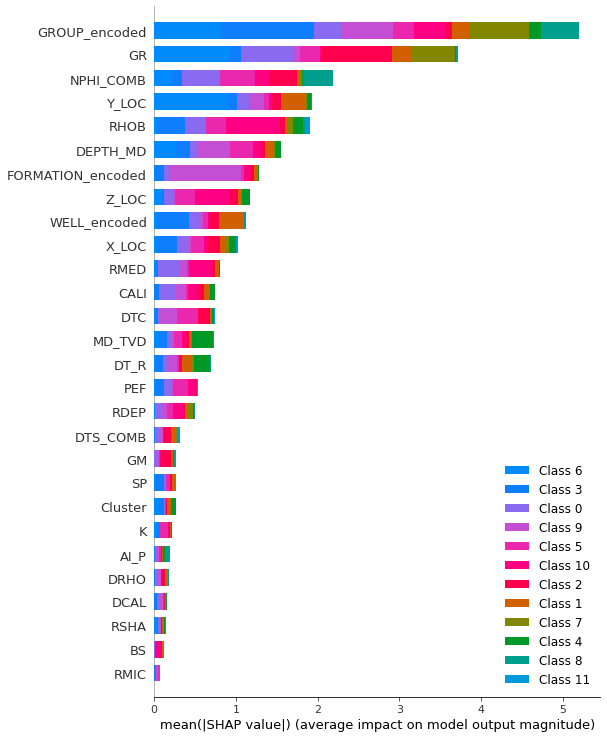

In [ ]:
# summarize the effects of all the features
shap.summary_plot(shape_values, x_test[selected_fetures_xgb], max_display=30)

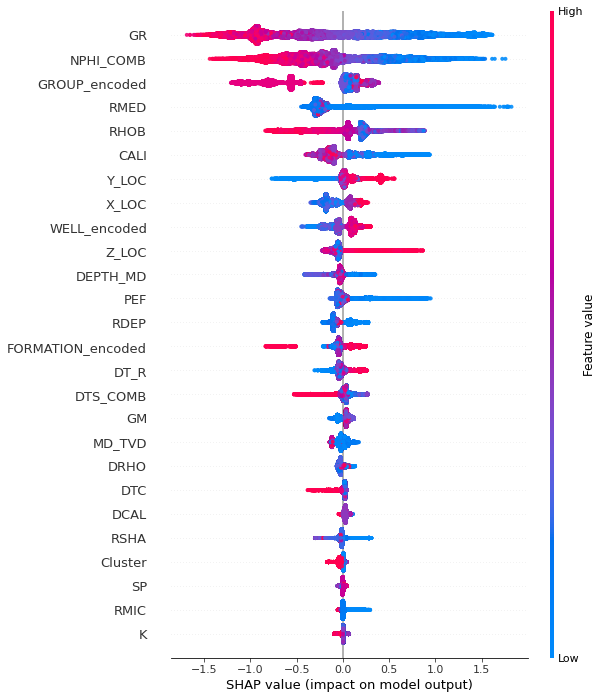

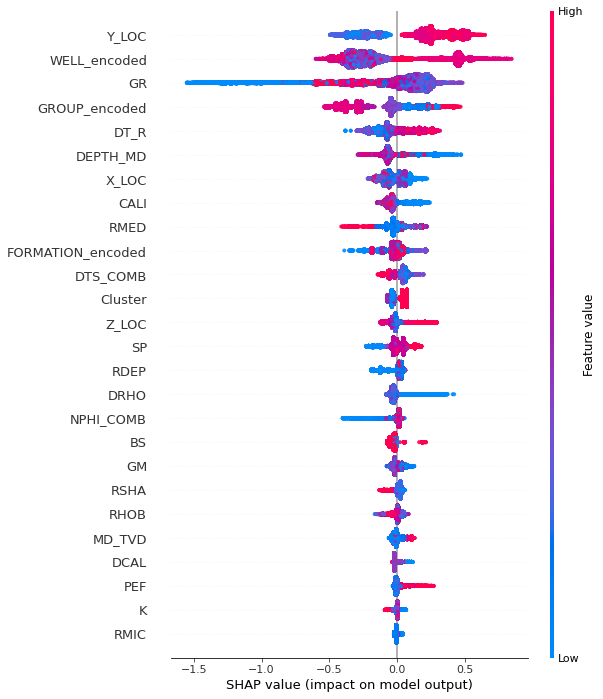

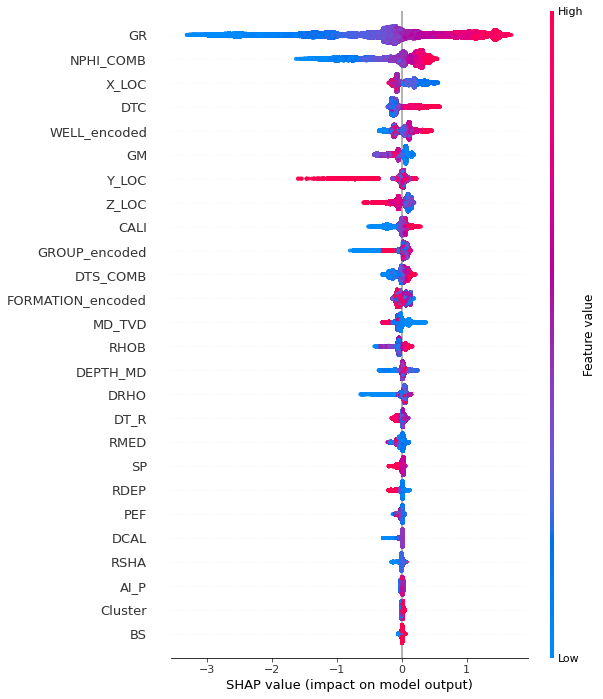

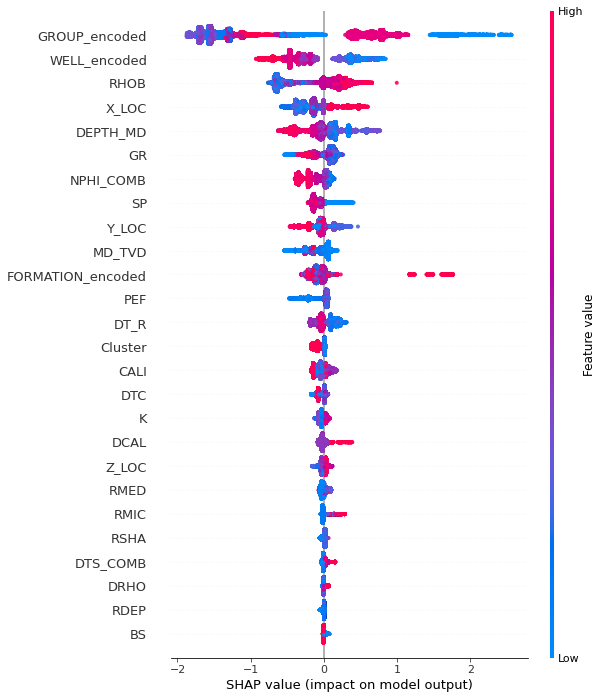

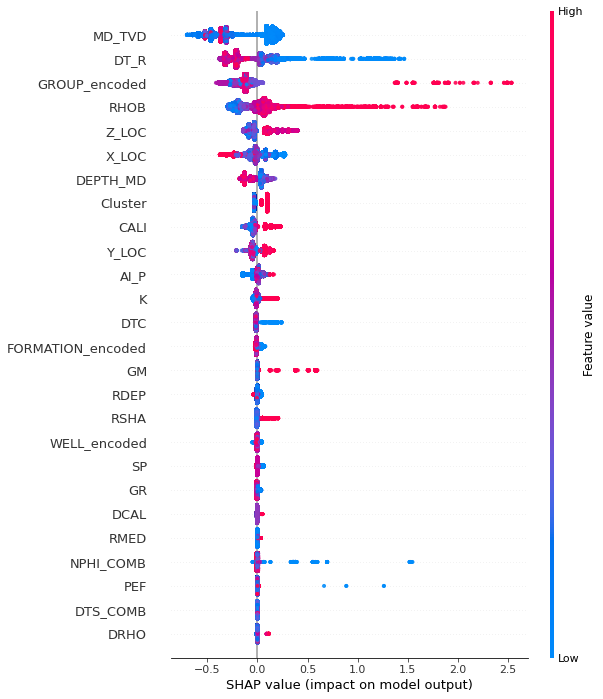

...

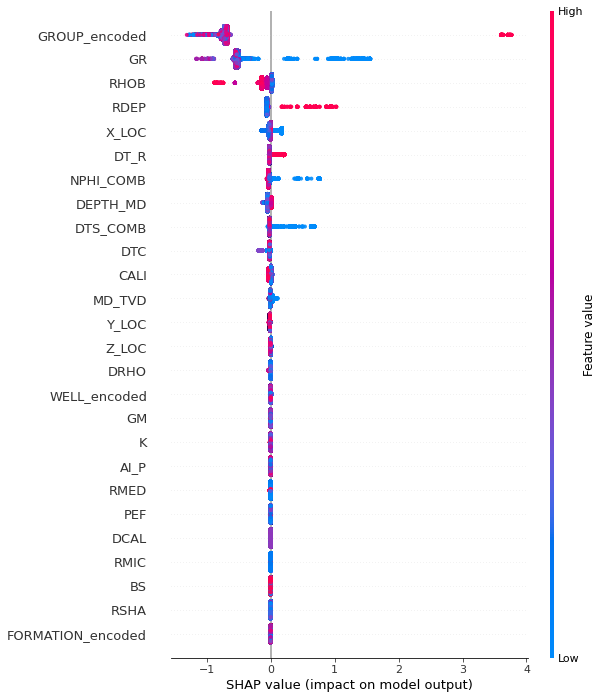

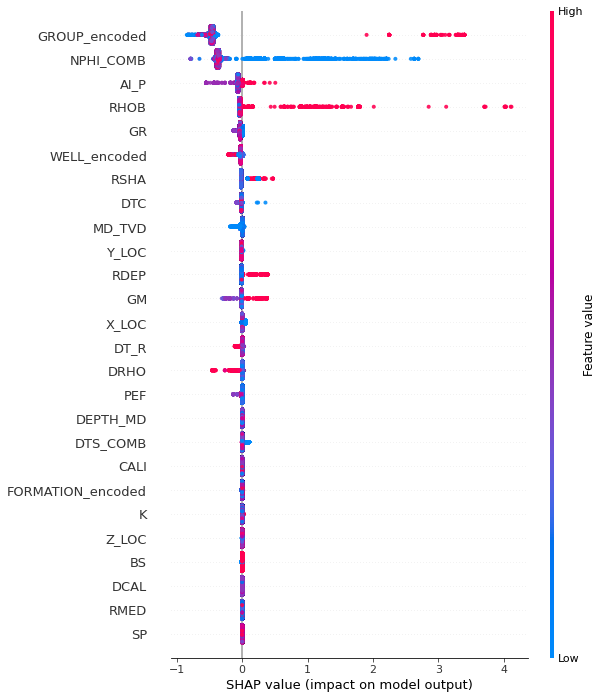

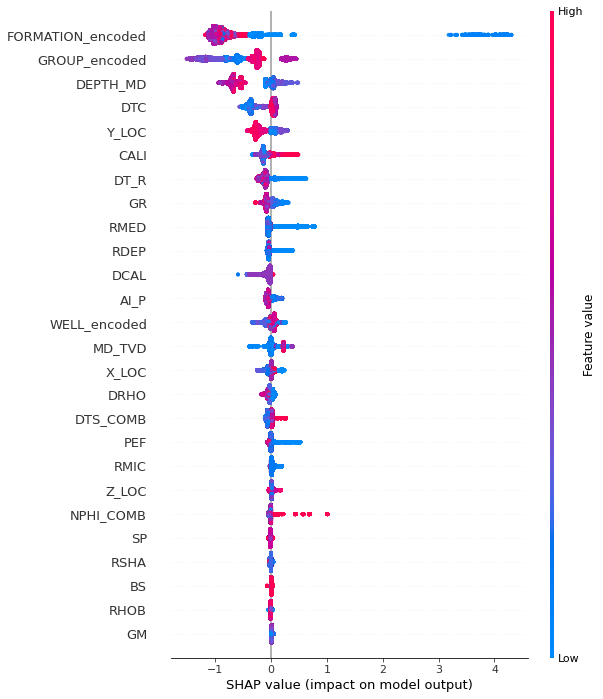

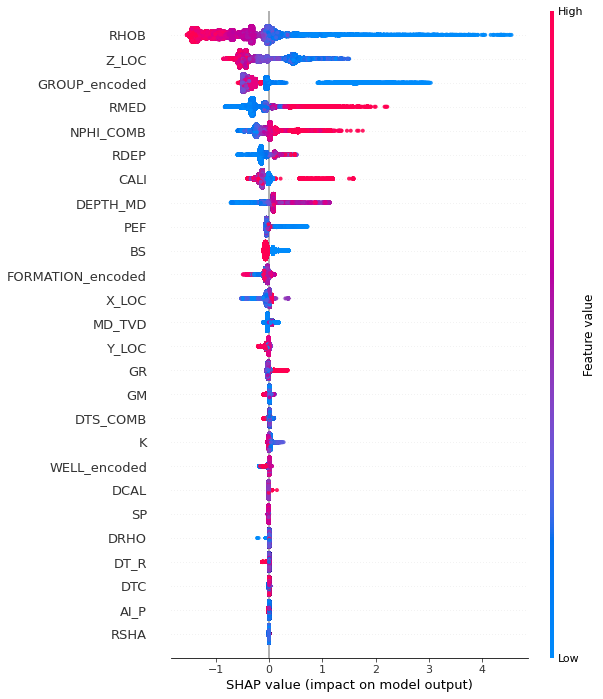

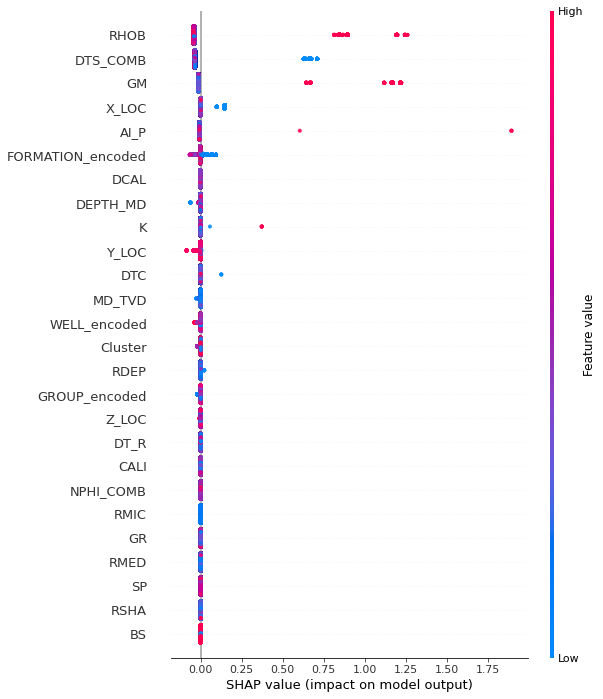

In [ ]:
for i in range(12):
  shap.summary_plot(shape_values[i], x_test[selected_fetures_xgb], alpha=0.89, max_display=30)

##### H4. Ploting Prediction results

In [ ]:
#Importing results csv files
train_xgb_res = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/train_xgb_final_res.csv')
test_xgb_res = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/test_xgb_final_res.csv')
hidden_xgb_res = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/hidden_xgb_final_res.csv')

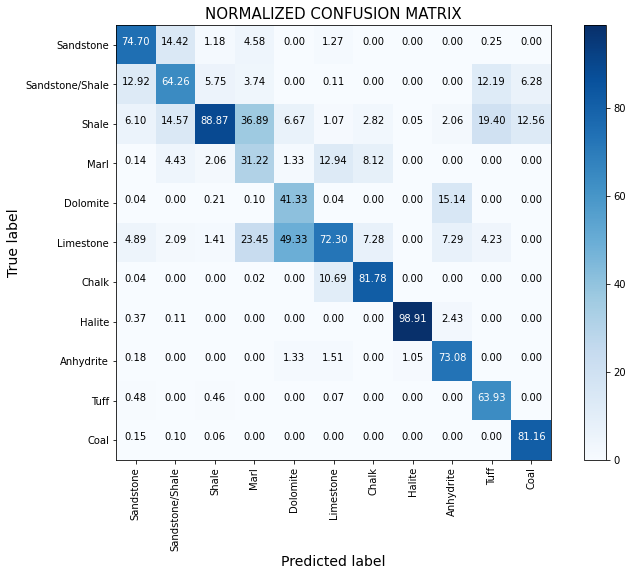

In [ ]:
litho_confusion_matrix(hidden_xgb_res.LITHO, hidden_xgb_res.XGB_TM)

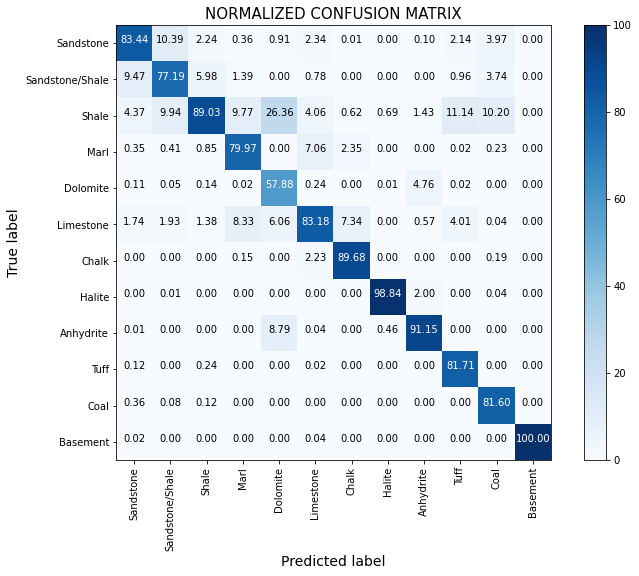

In [ ]:
litho_confusion_matrix(train_xgb_res.LITHO, train_xgb_res.XGB_TM)

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics._plot.confusion_matrix import ConfusionMatrixDisplay
from itertools import product

def litho_confusion_matrix(y_true, y_pred):
  facies_dict = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 3:'Marl',
                 4:'Dolomite', 5:'Limestone', 6:'Chalk', 7:'Halite', 
                 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

  labels = list(set(list(y_pred.unique()) + list(y_true.unique())))
  label_names = [facies_dict[k] for k in labels]

  #Normalizing confusion matrix
  cm = pd.DataFrame(confusion_matrix(y_true.values, y_pred.values))
  summ = cm.sum(axis=0)
  cm_norm = pd.DataFrame(np.zeros(cm.shape))
  for i in range(cm.shape[1]):
    for j in range(cm.shape[0]):
      cm_norm[i][j] = cm[i][j]*100/summ[i]

  cm_final = cm_norm.fillna(0).to_numpy()

  #disp = ConfusionMatrixDisplay(confusion_matrix=cm_final, display_labels=labels)
  fig, ax = plt.subplots(figsize=(12,8))
  plt.imshow(cm_final, interpolation='nearest', cmap=plt.cm.Blues)
  plt.title('NORMALIZED CONFUSION MATRIX', size=15)
  tick_marks = np.arange(len(label_names))
  plt.xticks(tick_marks, label_names, rotation=90)
  plt.yticks(tick_marks, label_names)
  plt.colorbar()
      
  fmt = '.2f'
  thresh = cm_final.max() / 2.
  for i, j in product(range(cm_final.shape[0]),   range(cm_final.shape[1])):
    plt.text(j, i, format(cm_final[i, j], fmt),
                  horizontalalignment="center",
                  color="white" if cm_final[i, j] > thresh else "black")
          
  plt.ylabel('True label', size=14)
  plt.xlabel('Predicted label', size=14)

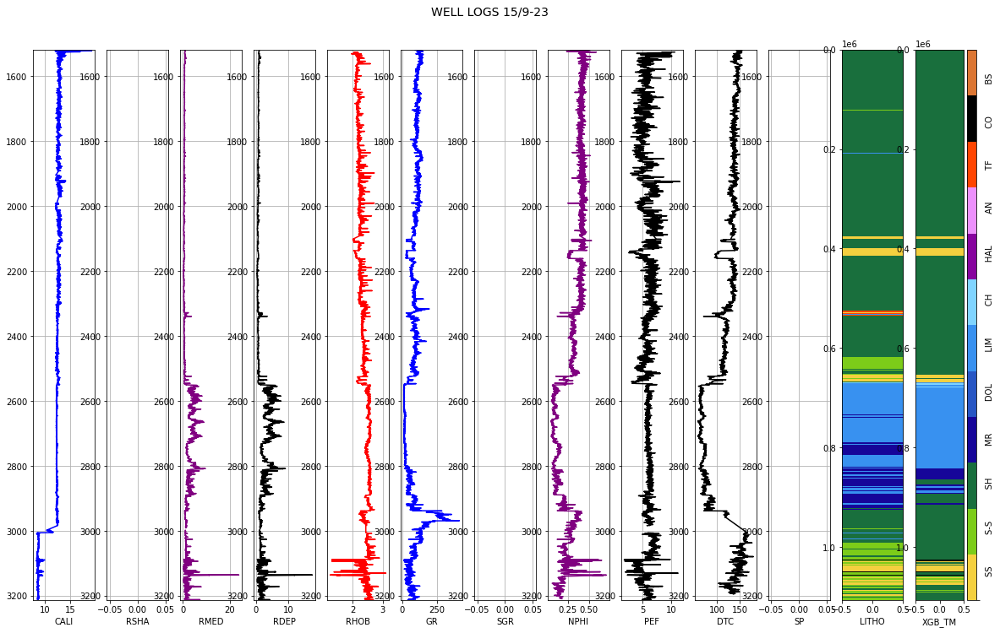

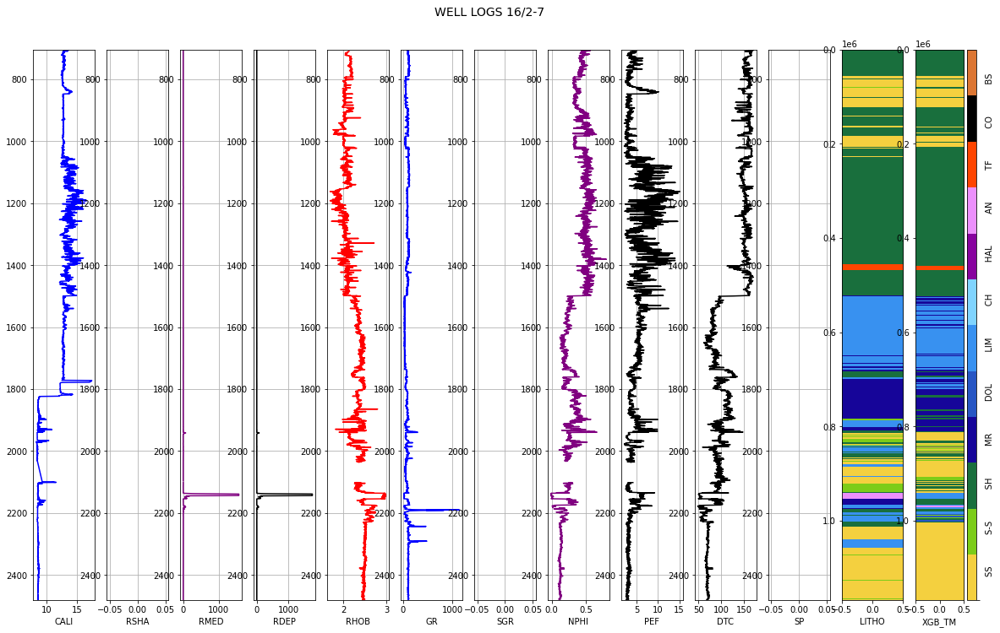

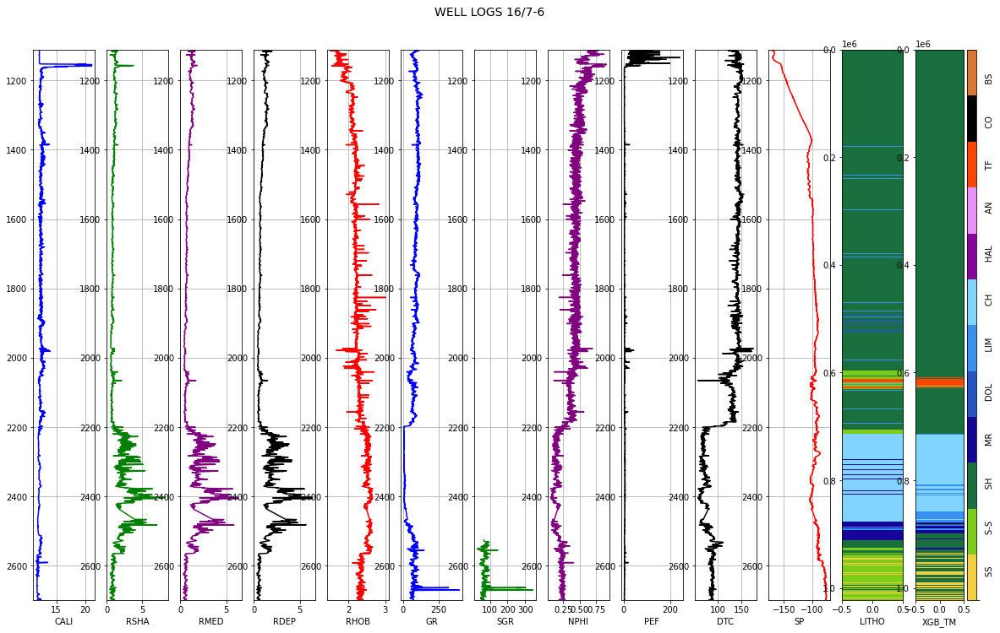

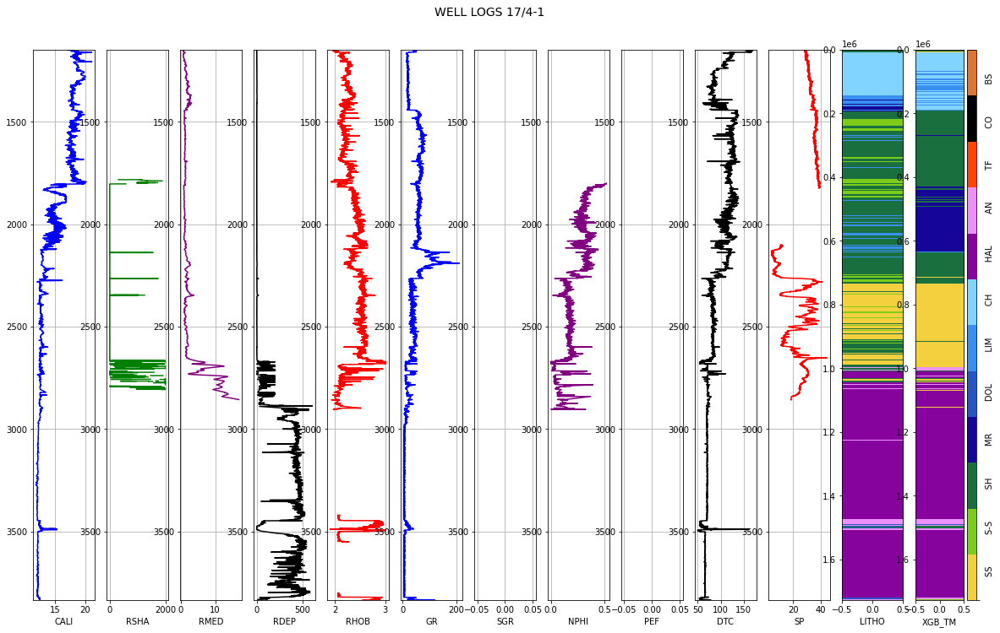

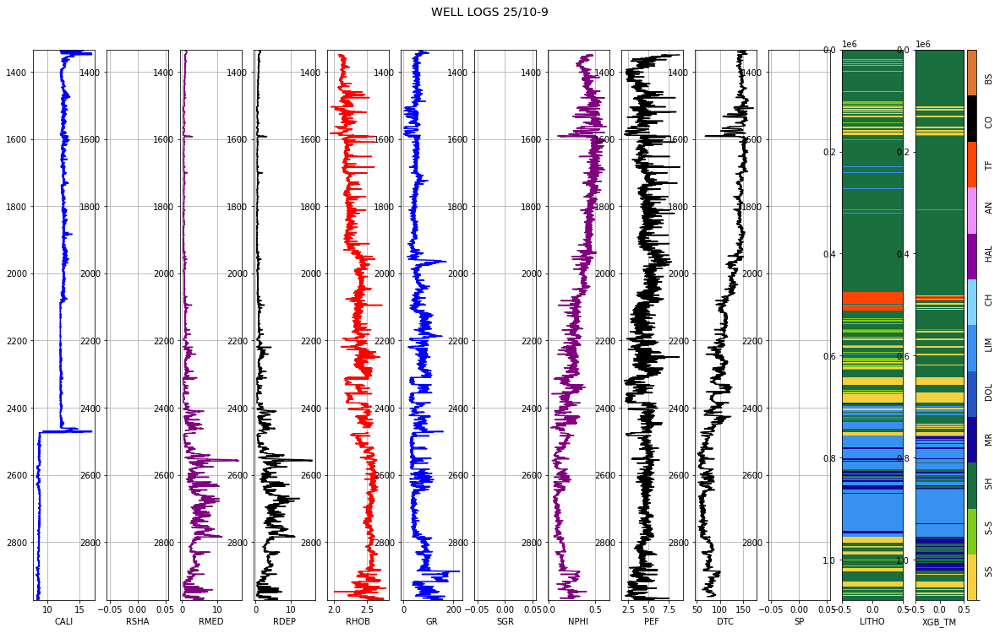

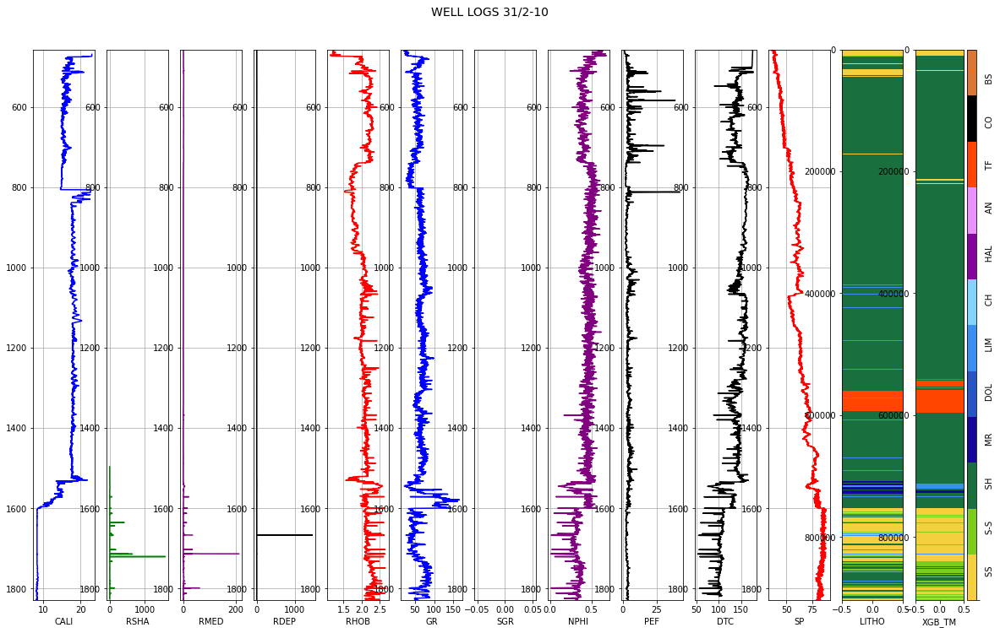

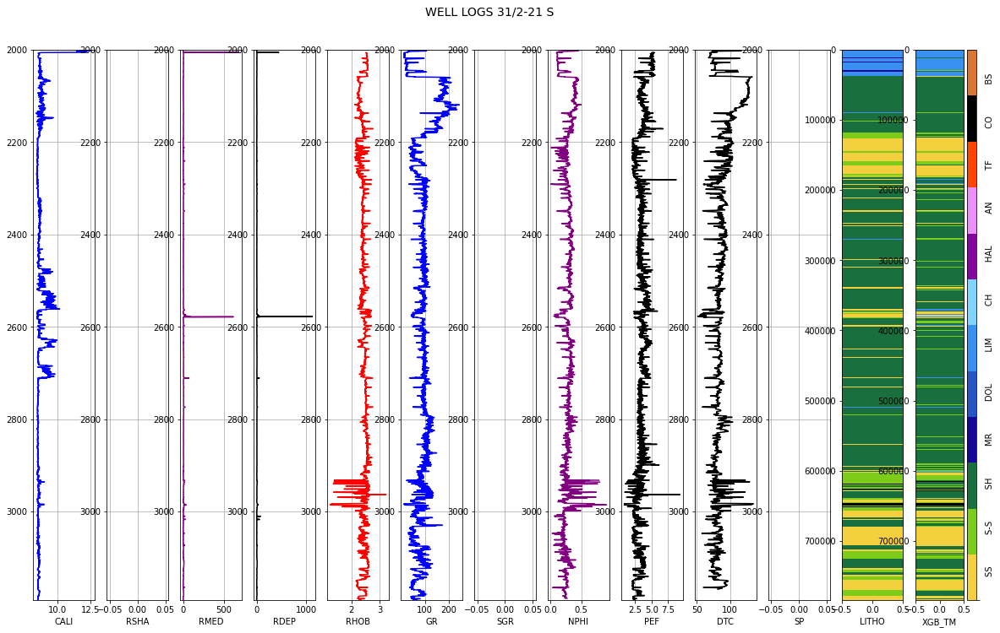

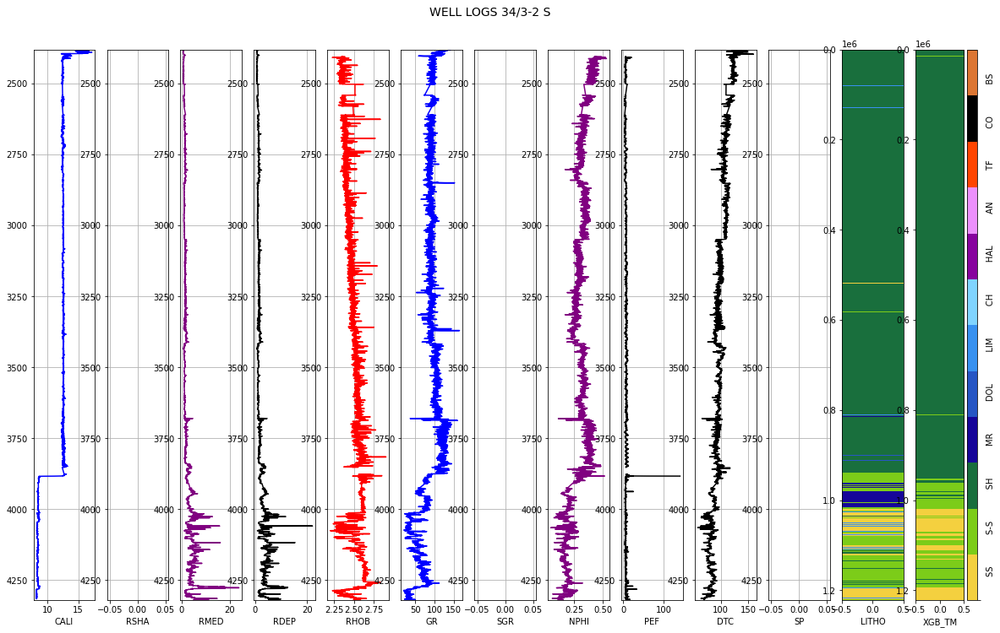

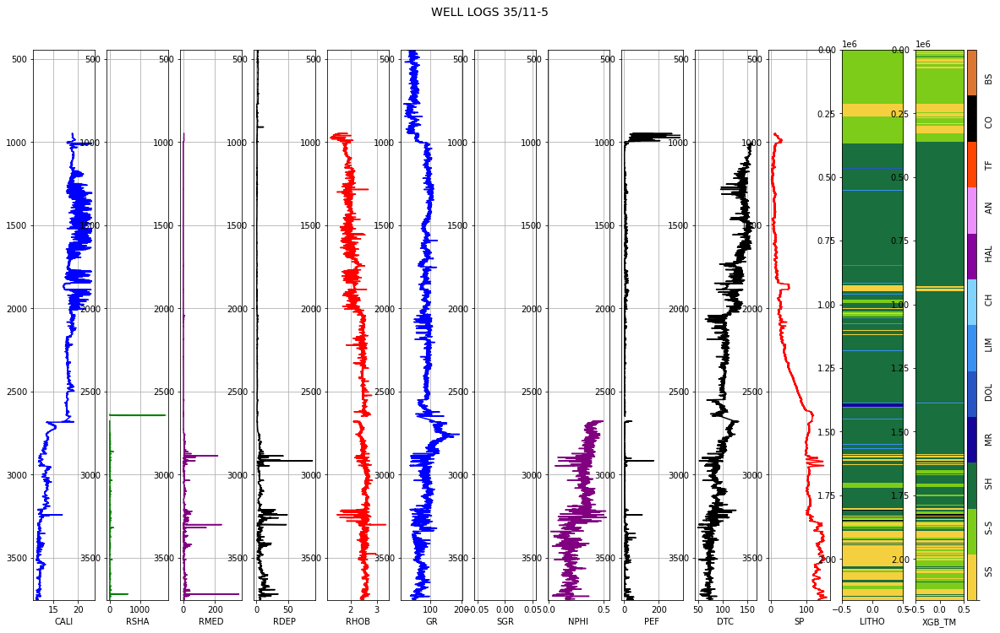

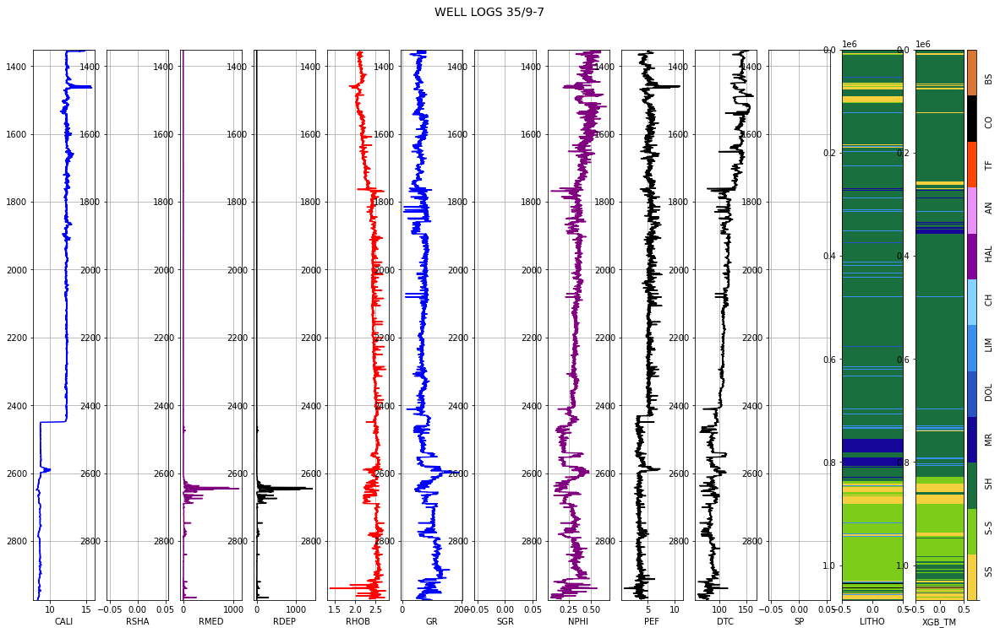

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_xgb_res, i, facies_colors, 1)

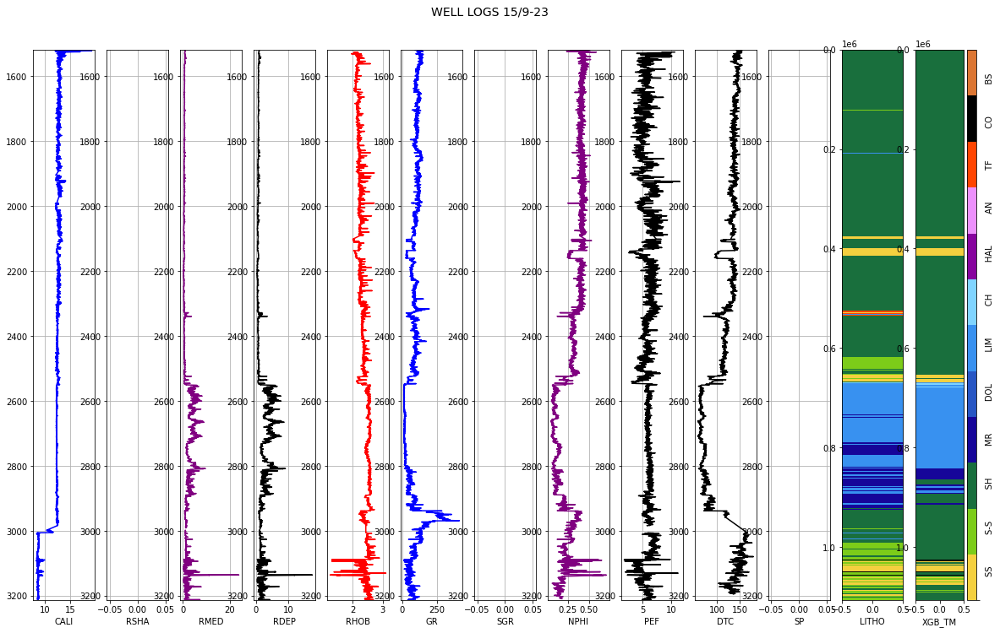

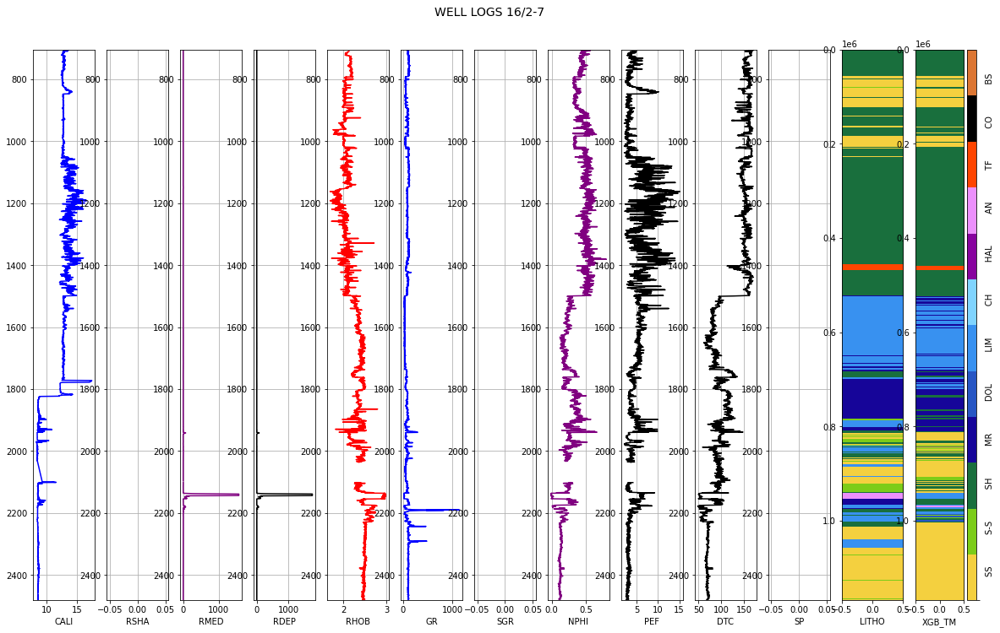

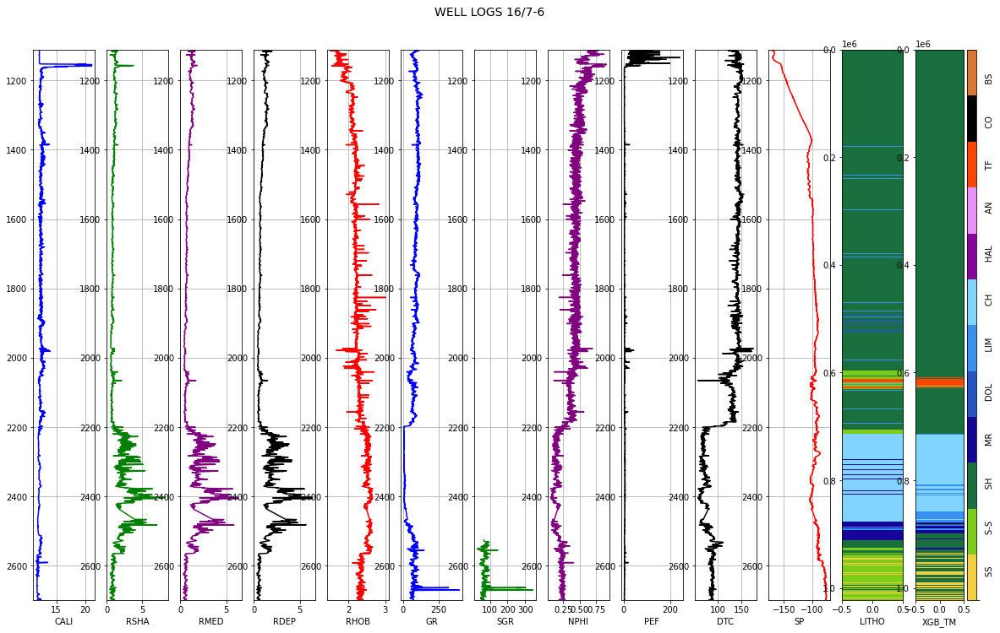

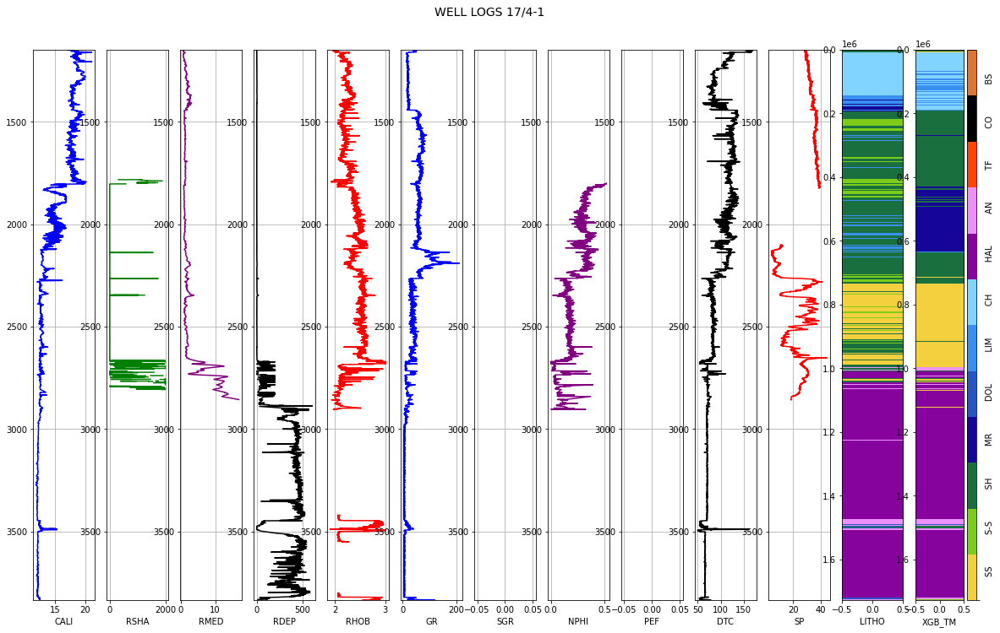

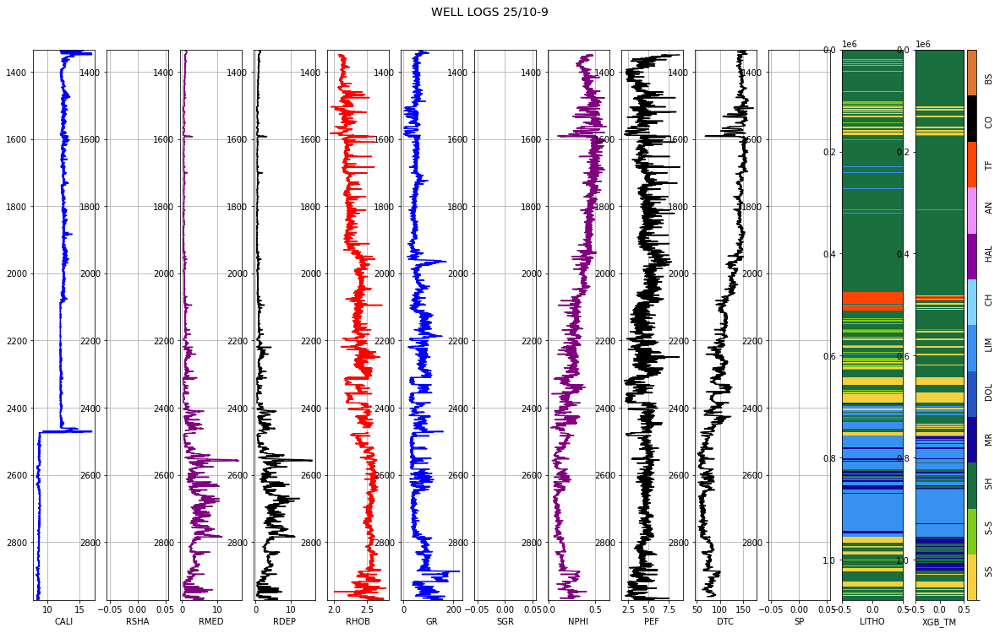

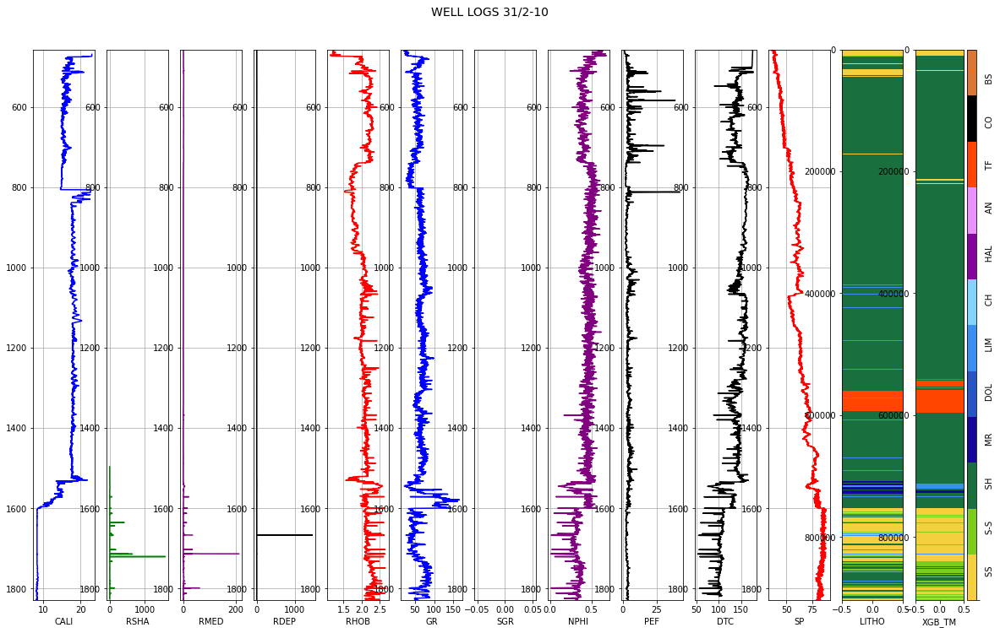

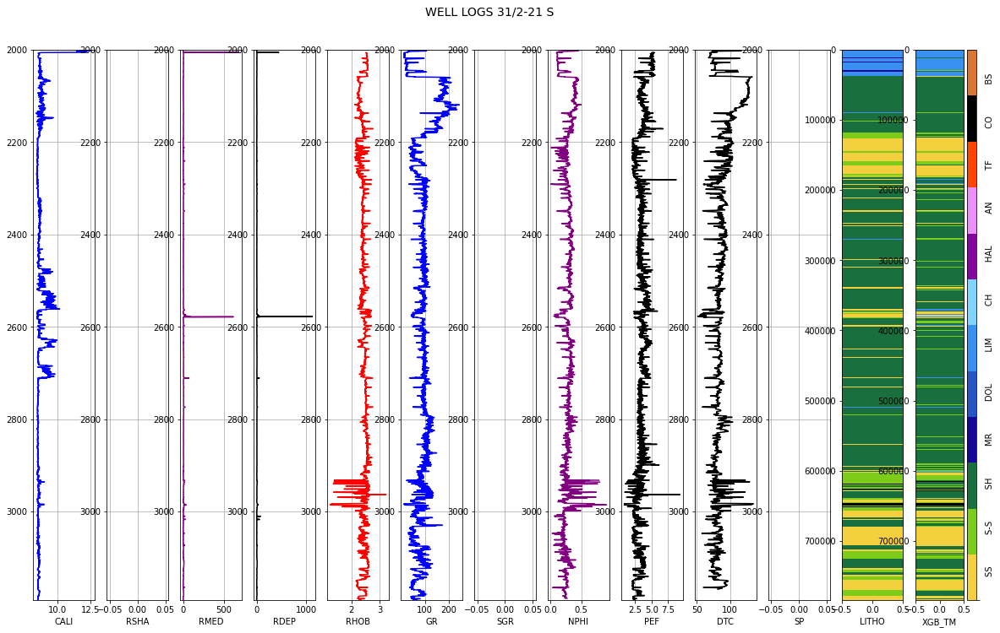

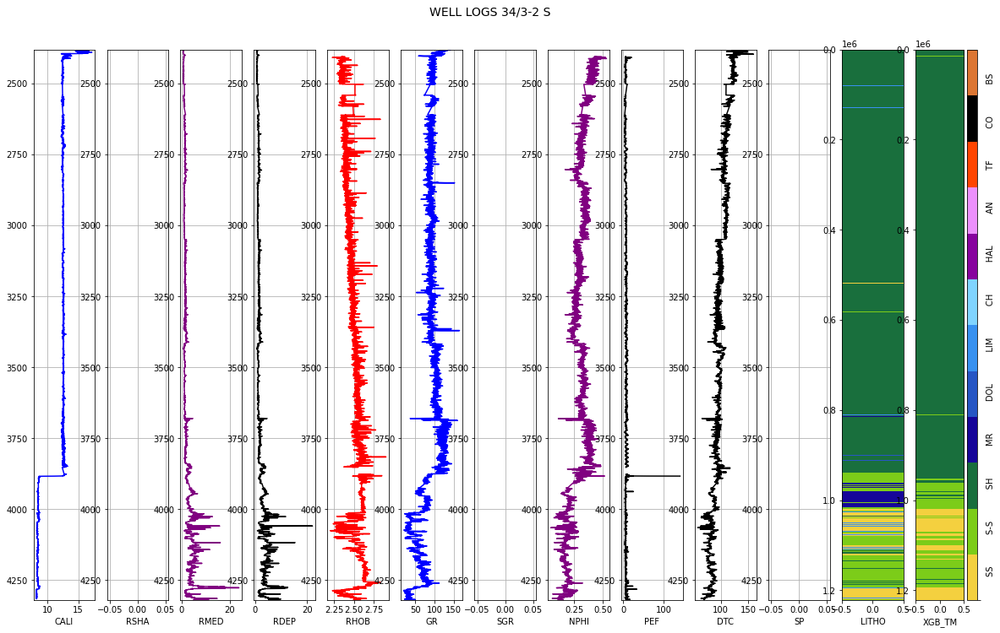

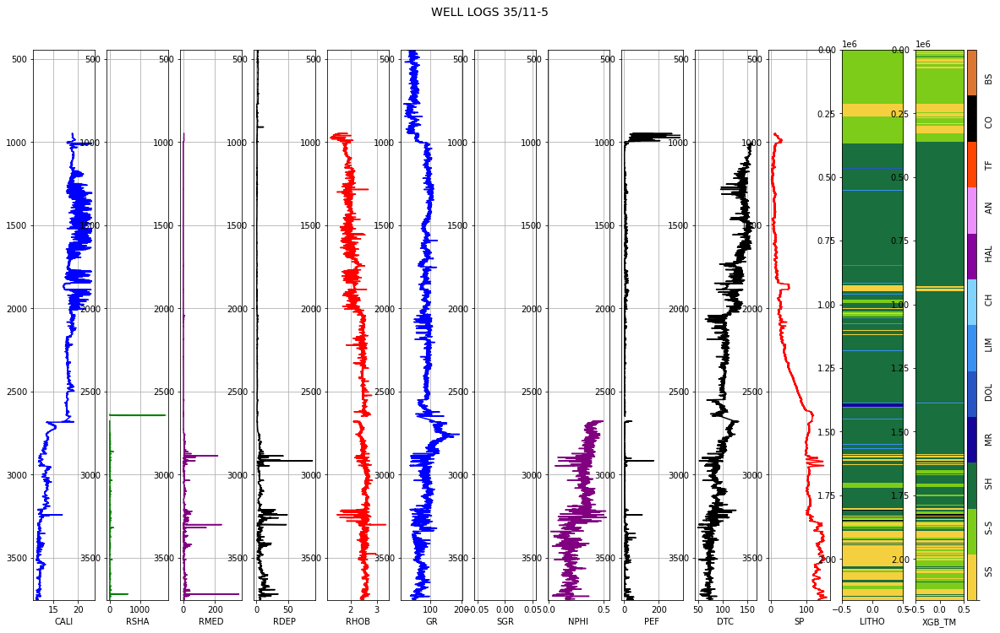

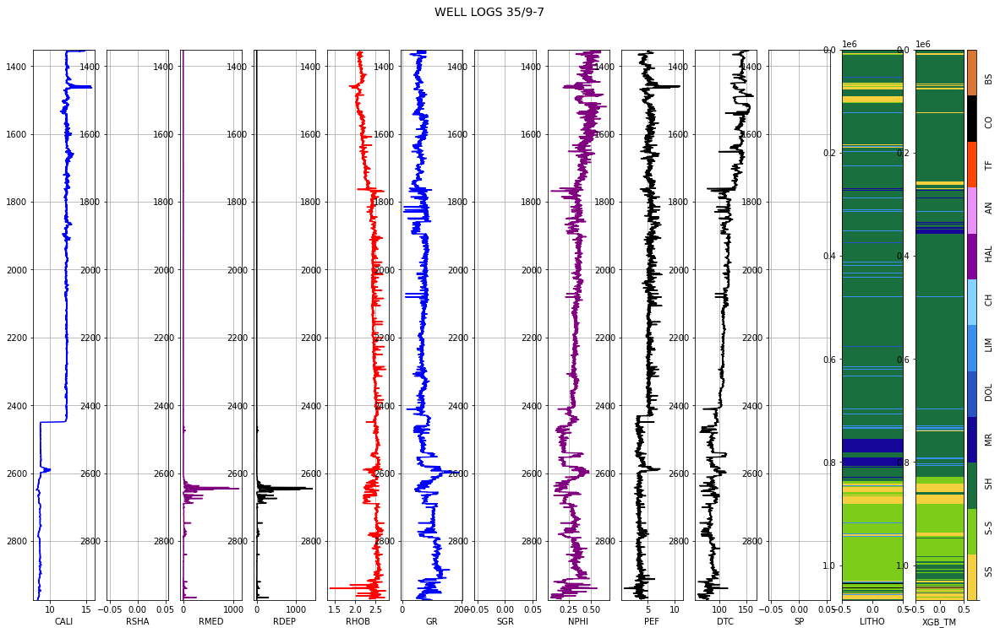

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_xgb_res, i, facies_colors, 1)

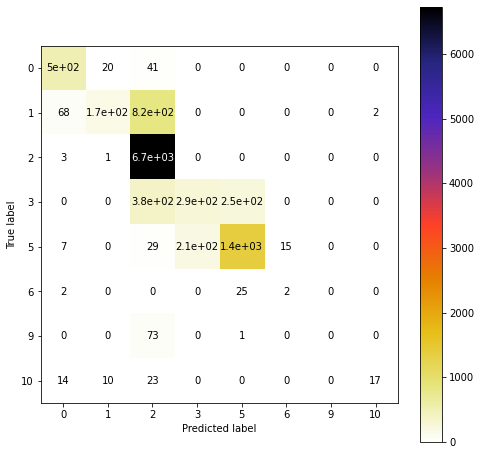

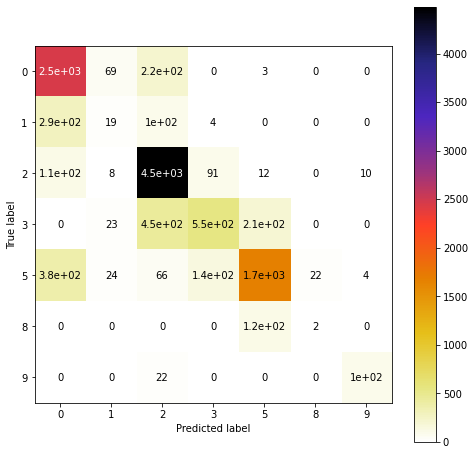

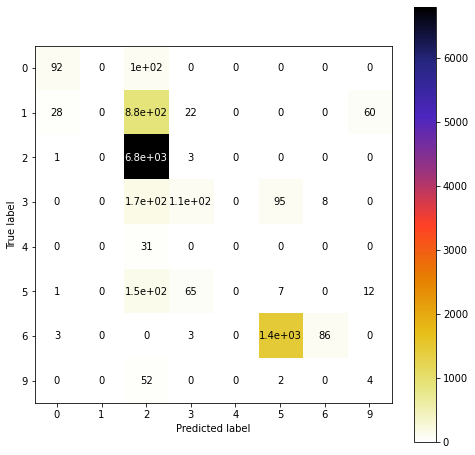

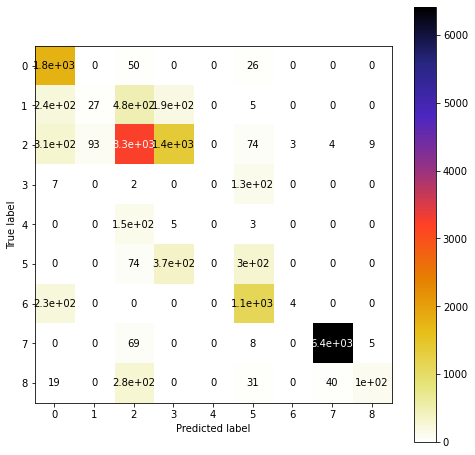

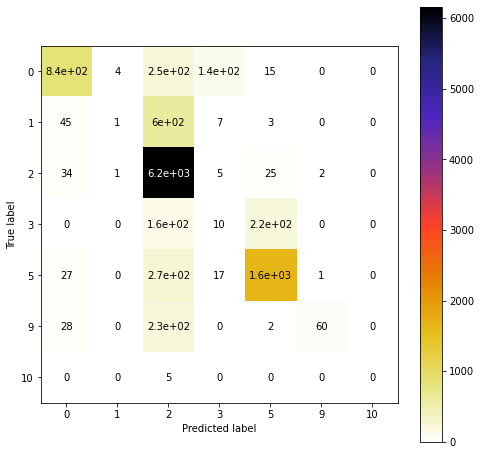

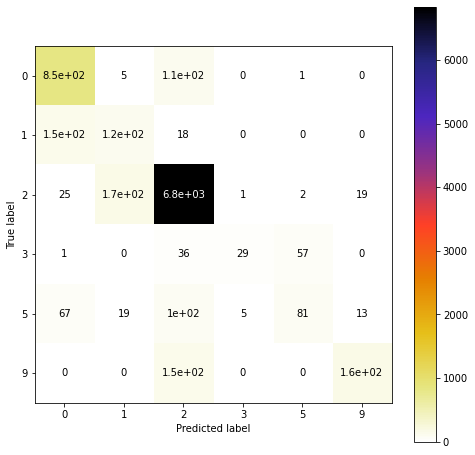

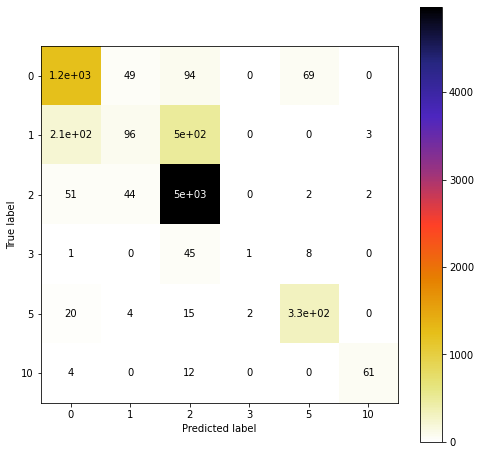

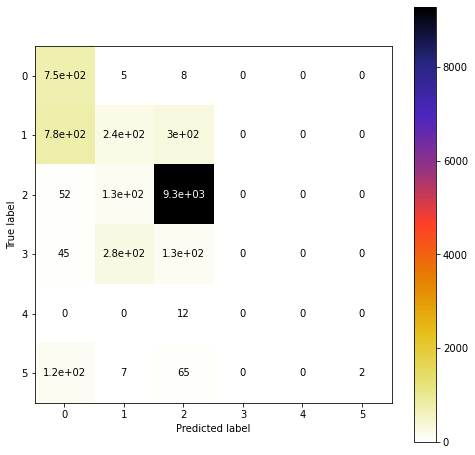

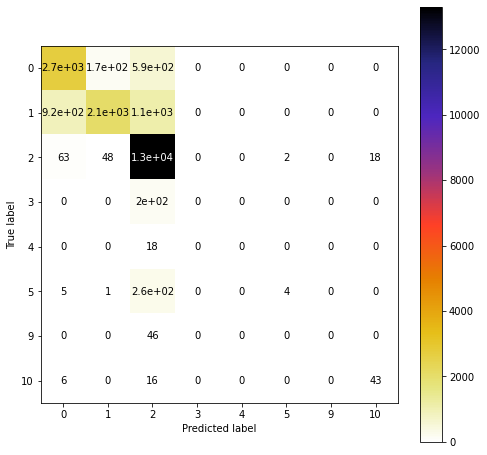

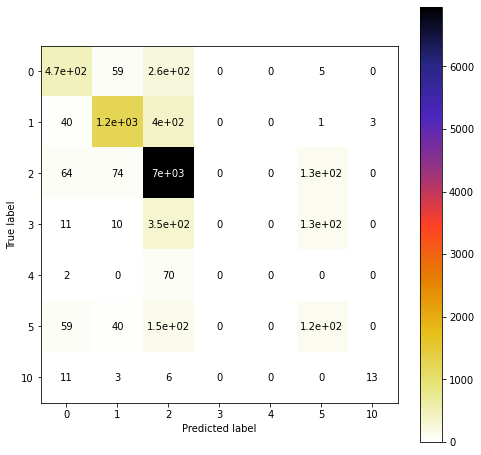

In [ ]:
#Displaying confusion matrixes for each well - HIDDEN SET
for i in range(10):
  well = hidden_xgb_res[hidden_xgb_res.WELL == hidden_xgb_res.WELL.unique()[i]]
  my_confusion_matrix(well.LITHO, well.XGB_BM)

#### **B4. RANDOM FOREST CLASSIFIER (Ensemble Method)**

In [ ]:
#Stratified Sample
x_train_strat, x_train_start2, y_train_strat, y_train_strat2 = train_test_split(x_train, y_train, train_size=0.1, shuffle=True, stratify=y_train, random_state=0)

##### Base Model with non-argumented data


In [ ]:
# PREDICTION ON THE VALIDATION SET
model_rf = RandomForestClassifier(n_estimators=250)

# Fit the regressor to the training data
model_rf.fit(x_train_strat, y_train_strat.values.ravel())

# Prediction
train_rf = model_rf.predict(x_train_strat)
open_rf = model_rf.predict(x_test)
hidden_rf = model_rf.predict(x_hidden)

#Printing Reports
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train_strat.values, train_rf))
print('Open set report:', metrics.classification_report(y_train_strat, train_rf))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_rf))
print('Open set report:', metrics.classification_report(y_test, open_rf))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_rf))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_rf))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: 0.0
Open set report:               precision    recall  f1-score   support

           0       1.00      1.00      1.00     16894
           1       1.00      1.00      1.00     15045
           2       1.00      1.00      1.00     72080
           3       1.00      1.00      1.00      3333
           4       1.00      1.00      1.00       169
           5       1.00      1.00      1.00      5632
           6       1.00      1.00      1.00      1051
           7       1.00      1.00      1.00       821
           8       1.00      1.00      1.00       109
           9       1.00      1.00      1.00      1525
          10       1.00      1.00      1.00       382
          11       1.00      1.00      1.00        10

    accuracy                           1.00    117051
   macro avg       1.00      1.00      1.00    117051
weighted avg       1.00      1.00      1.00    117051

--------------------

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Open set report:               precision    recall  f1-score   support

           0       0.80      0.85      0.82     24048
           1       0.47      0.29      0.36     17558
           2       0.83      0.92      0.87     83975
           3       0.63      0.04      0.08      3306
           4       0.00      0.00      0.00       416
           5       0.44      0.54      0.48      4798
           6       0.44      0.01      0.02       625
           8       0.00      0.00      0.00       125
           9       0.81      0.49      0.61      1245
          10       0.90      0.39      0.54       690

    accuracy                           0.78    136786
   macro avg       0.53      0.35      0.38    136786
weighted avg       0.75      0.78      0.75    136786

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.5255888624721194
Hidden set report:               precision    recall  f1-score   support

           0       0.72      0.78  

##### Feature Selection

In [ ]:
# PREDICTION ON THE VALIDATION SET
model_rf = RandomForestClassifier(n_estimators=250)

# Fit the regressor to the training data
model_rf.fit(x_train_strat, y_train_strat.values.ravel())

# Prediction
train_rf = model_rf.predict(x_train_strat)
open_rf = model_rf.predict(x_test)
hidden_rf = model_rf.predict(x_hidden)

#Printing Reports
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train_strat.values, train_rf))
print('Open set report:', metrics.classification_report(y_train_strat, train_rf))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_rf))
print('Open set report:', metrics.classification_report(y_test, open_rf))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_rf))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_rf))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: 0.0
Open set report:               precision    recall  f1-score   support

           0       1.00      1.00      1.00      3379
           1       1.00      1.00      1.00      3009
           2       1.00      1.00      1.00     14416
           3       1.00      1.00      1.00       667
           4       1.00      1.00      1.00        34
           5       1.00      1.00      1.00      1126
           6       1.00      1.00      1.00       210
           7       1.00      1.00      1.00       164
           8       1.00      1.00      1.00        22
           9       1.00      1.00      1.00       305
          10       1.00      1.00      1.00        76
          11       1.00      1.00      1.00         2

    accuracy                           1.00     23410
   macro avg       1.00      1.00      1.00     23410
weighted avg       1.00      1.00      1.00     23410

--------------------

In [ ]:
#Feature selection by recursive feature elimination
from sklearn.model_selection import StratifiedKFold
from sklearn.feature_selection import RFECV
import warnings
warnings.filterwarnings('ignore')

base_rf = RandomForestClassifier()
rfe_rf = RFECV(estimator=base_rf, step=1, min_features_to_select=2, cv=StratifiedKFold(10), scoring='accuracy', verbose=1)
rfe_rf.fit(x_train_strat, y_train_strat)

Fitting estimator with 30 features.
Fitting estimator with 29 features.
Fitting estimator with 28 features.
Fitting estimator with 27 features.
Fitting estimator with 26 features.
Fitting estimator with 25 features.
Fitting estimator with 24 features.
Fitting estimator with 23 features.
Fitting estimator with 22 features.
Fitting estimator with 21 features.
Fitting estimator with 20 features.
Fitting estimator with 19 features.
Fitting estimator with 18 features.
Fitting estimator with 17 features.
Fitting estimator with 16 features.
Fitting estimator with 15 features.
Fitting estimator with 14 features.
Fitting estimator with 13 features.
Fitting estimator with 12 features.
Fitting estimator with 11 features.
Fitting estimator with 10 features.
Fitting estimator with 9 features.
Fitting estimator with 8 features.
Fitting estimator with 7 features.
Fitting estimator with 6 features.
Fitting estimator with 5 features.
Fitting estimator with 4 features.
Fitting estimator with 3 features.

RFECV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
      estimator=RandomForestClassifier(bootstrap=True, ccp_alpha=0.0,
                                       class_weight=None, criterion='gini',
                                       max_depth=None, max_features='auto',
                                       max_leaf_nodes=None, max_samples=None,
                                       min_impurity_decrease=0.0,
                                       min_impurity_split=None,
                                       min_samples_leaf=1, min_samples_split=2,
                                       min_weight_fraction_leaf=0.0,
                                       n_estimators=100, n_jobs=None,
                                       oob_score=False, random_state=None,
                                       verbose=0, warm_start=False),
      min_features_to_select=2, n_jobs=None, scoring='accuracy', step=1,
      verbose=1)

Optimal number of features: 27


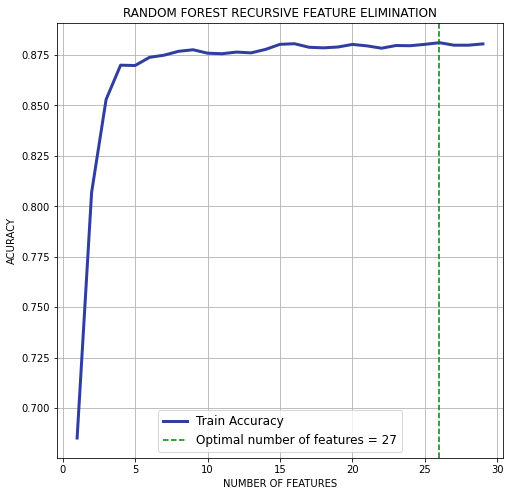

In [ ]:
print('Optimal number of features: {}'.format(rfe_rf.n_features_))

#Plotting Data
plt.figure(figsize=(8, 8))
num_features = list(range(1, len(rfe_rf.grid_scores_)+1))
scores = list(rfe_rf.grid_scores_)
plt.plot(num_features, rfe_rf.grid_scores_, color='#303F9F', linewidth=3, label='Train Accuracy')
plt.axvline(num_features[scores.index(np.array(scores).max())], c='g', ls='--', label='Optimal number of features = 27')
plt.title('RANDOM FOREST RECURSIVE FEATURE ELIMINATION')
plt.xlabel('NUMBER OF FEATURES')
plt.ylabel('ACURACY')
plt.legend(fontsize=12)
plt.grid()

In [ ]:
#Ploting Feature Importance after recursive feature selection
x_train.drop(x_train.columns[np.where(rfe_rf.support_ == False)[0]], axis=1, inplace=True)

In [ ]:
x_train.columns

Index(['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'AI', 'DTC', 'DTS_COMB',
       'RSHA', 'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'GROUP_encoded',
       'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI',
       'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'ROP', 'DRHO'],
      dtype='object')

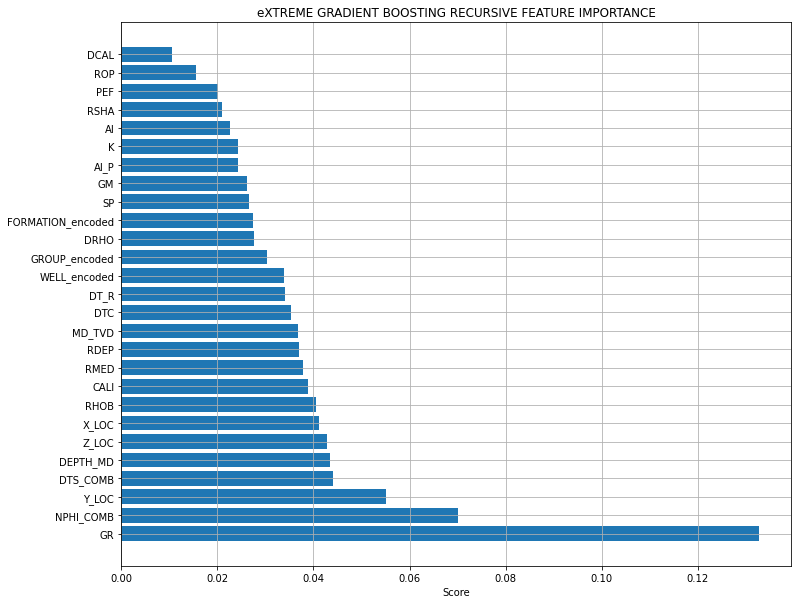

In [ ]:
#Ploting Feature Importance after recursive feature selection
#new_set = x_train.drop(x_train.columns[np.where(rfe_cat.support_ == False)[0]], axis=1, inplace=True)

dset = pd.DataFrame()
dset['attr'] = x_train.columns
dset['importance'] = rfe_rf.estimator_.feature_importances_
dset = dset.sort_values(by='importance', ascending=False)

plt.figure(figsize=(12, 10))
plt.barh(y=dset['attr'], width=dset['importance'])
plt.title('RANDOM FOREST RECURSIVE FEATURE IMPORTANCE')
plt.xlabel('Score')
plt.grid()

##### Tuning Model

In [ ]:
selected_feat = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'AI', 'DTC', 'DTS_COMB',
                  'RSHA', 'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'GROUP_encoded',
                  'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI',
                  'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'ROP', 'DRHO']

In [ ]:
rf_base = RandomForestClassifier()
param_grid = {'n_estimators': np.arange(100, 500, 50),
              'max_features' : ['auto', 'sqrt'],
              'max_depth': np.arange(1, 50, 2),
              'bootstrap': [True, False]}

folds = StratifiedKFold(10)
rf_search = RandomizedSearchCV(estimator=rf_base, param_distributions=param_grid, 
                               n_iter=25, scoring='accuracy', verbose=10, n_jobs=-1, cv=folds)
rf_search.fit(x_train_strat[selected_feat], y_train_strat)

Fitting 10 folds for each of 25 candidates, totalling 250 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done   1 tasks      | elapsed:  1.1min
[Parallel(n_jobs=-1)]: Done   4 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done   9 tasks      | elapsed:  5.4min
[Parallel(n_jobs=-1)]: Done  14 tasks      | elapsed:  5.9min
[Parallel(n_jobs=-1)]: Done  21 tasks      | elapsed:  7.8min
[Parallel(n_jobs=-1)]: Done  28 tasks      | elapsed: 11.4min
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed: 13.9min
[Parallel(n_jobs=-1)]: Done  46 tasks      | elapsed: 15.7min
[Parallel(n_jobs=-1)]: Done  57 tasks      | elapsed: 19.5min
[Parallel(n_jobs=-1)]: Done  68 tasks      | elapsed: 22.7min
[Parallel(n_jobs=-1)]: Done  81 tasks      | elapsed: 24.8min
[Parallel(n_jobs=-1)]: Done  94 tasks      | elapsed: 32.3min
[Parallel(n_jobs=-1)]: Done 109 tasks      | elapsed: 42.2min
[Parallel(n_jobs=-1)]: Done 124 tasks      | elapsed: 47.6min
[Parallel(n_jobs=-1)]: Done 141 tasks      | elapsed: 50

RandomizedSearchCV(cv=StratifiedKFold(n_splits=10, random_state=None, shuffle=False),
                   error_score=nan,
                   estimator=RandomForestClassifier(bootstrap=True,
                                                    ccp_alpha=0.0,
                                                    class_weight=None,
                                                    criterion='gini',
                                                    max_depth=None,
                                                    max_features='auto',
                                                    max_leaf_nodes=None,
                                                    max_samples=None,
                                                    min_impurity_decrease=0.0,
                                                    min_impurity_split=None,
                                                    min_samples_leaf=1,
                                                    min_samples_s...
                   ii

In [ ]:
rf_search.best_params_

{'bootstrap': False,
 'max_depth': 45,
 'max_features': 'sqrt',
 'n_estimators': 350}

##### Tunned model

In [ ]:
selected_feat = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'AI', 'DTC', 'DTS_COMB',
                  'RSHA', 'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'GROUP_encoded',
                  'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI',
                  'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'ROP', 'DRHO']

In [ ]:
# PREDICTION ON THE VALIDATION SET
model_rf = RandomForestClassifier(n_estimators=350, bootstrap=False, max_depth=45, max_features='sqrt')

# Fit the regressor to the training data
model_rf.fit(x_train[selected_feat], y_train.values.ravel())

# Prediction
train_rf = model_rf.predict(x_train[selected_feat])
open_rf = model_rf.predict(x_test[selected_feat])
hidden_rf = model_rf.predict(x_hidden[selected_feat])

#Printing Reports
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train.values, train_rf))
print('Open set report:', metrics.classification_report(y_train, train_rf))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_rf))
print('Open set report:', metrics.classification_report(y_test, open_rf))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_rf))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_rf))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.06081660061289471
Open set report:               precision    recall  f1-score   support

           0       0.97      0.97      0.97    168937
           1       0.96      0.95      0.95    150455
           2       0.98      0.99      0.99    720803
           3       0.97      0.96      0.97     33329
           4       0.95      0.77      0.85      1688
           5       0.97      0.91      0.94     56320
           6       0.99      0.99      0.99     10513
           7       1.00      1.00      1.00      8213
           8       0.97      0.98      0.98      1085
           9       0.98      0.98      0.98     15245
          10       0.95      0.88      0.91      3820
          11       1.00      1.00      1.00       103

    accuracy                           0.98   1170511
   macro avg       0.97      0.95      0.96   1170511
weighted avg       0.98      0.98      0.98   1170511

---

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Open set report:               precision    recall  f1-score   support

           0       0.79      0.85      0.82     24048
           1       0.50      0.27      0.35     17558
           2       0.83      0.92      0.87     83975
           3       0.48      0.01      0.03      3306
           4       0.00      0.00      0.00       416
           5       0.42      0.57      0.48      4798
           6       0.00      0.00      0.00       625
           8       0.00      0.00      0.00       125
           9       0.81      0.41      0.55      1245
          10       0.84      0.53      0.65       690

    accuracy                           0.78    136786
   macro avg       0.47      0.36      0.38    136786
weighted avg       0.75      0.78      0.75    136786

-----------------------HIDDEN SET REPORT---------------------
Hidden set penalty matrix score: -0.49686368946951315
Hidden set report:               precision    recall  f1-score   support

           0       0.72      0.80 

In [ ]:
#Storing results
train_rf_res = labeled_data.copy()
test_rf_res = test_data.copy()
hidden_rf_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_rf_res['RF_TM'] = train_rf
test_rf_res['RF_TM'] = open_rf
hidden_rf_res['RF_TM'] = hidden_rf

In [ ]:
#Saving results 3 methods
train_rf_res.to_csv('/content/drive/MyDrive/Results_folder/RF/train_rf_final_res.csv', index=False)
test_rf_res.to_csv('/content/drive/MyDrive/Results_folder/RF/tes_rf_final_res.csv', index=False)
hidden_rf_res.to_csv('/content/drive/MyDrive/Results_folder/RF/hidden_rf_final_res.csv', index=False)

##### Ploting Prediction Results

In [ ]:
#Importing files
train_rf_res = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/train_rf_final_res.csv')
test_rf_res = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/tes_rf_final_res.csv')
hidden_rf_res = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/hidden_rf_final_res.csv')

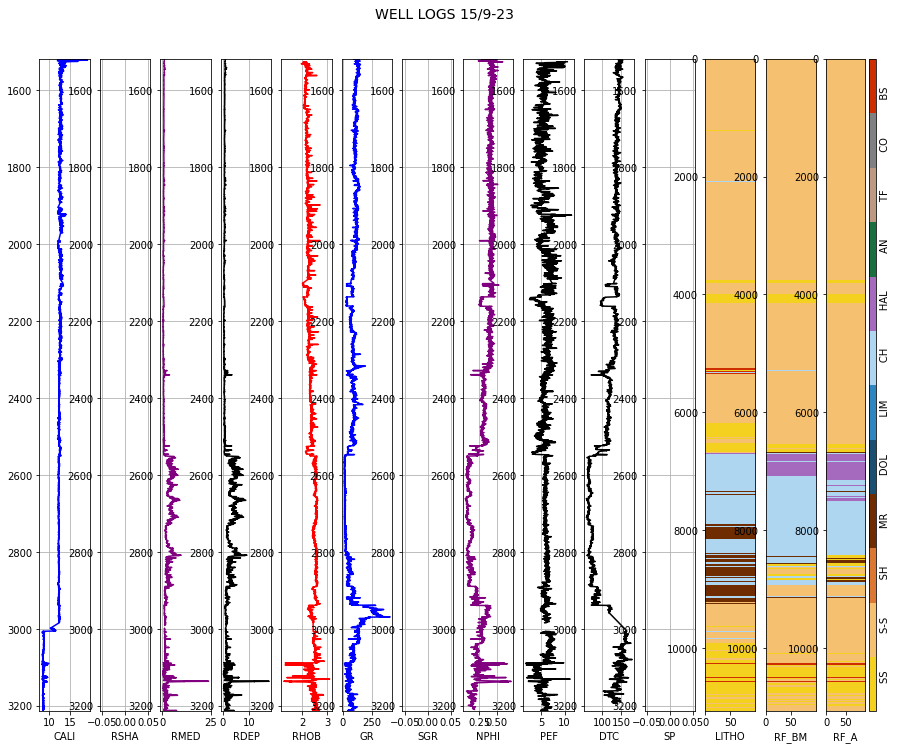

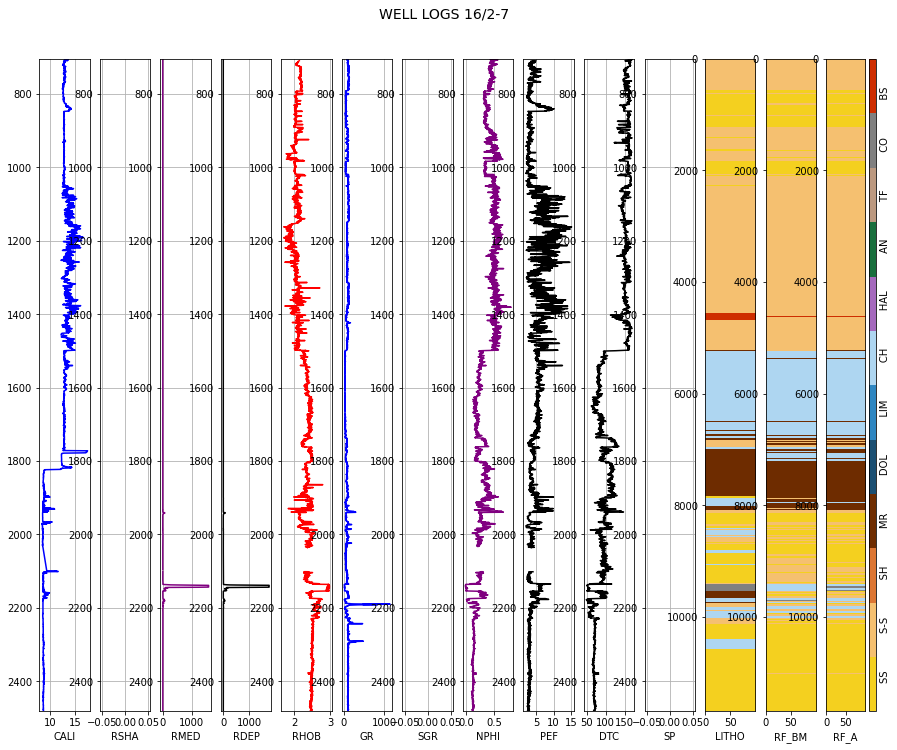

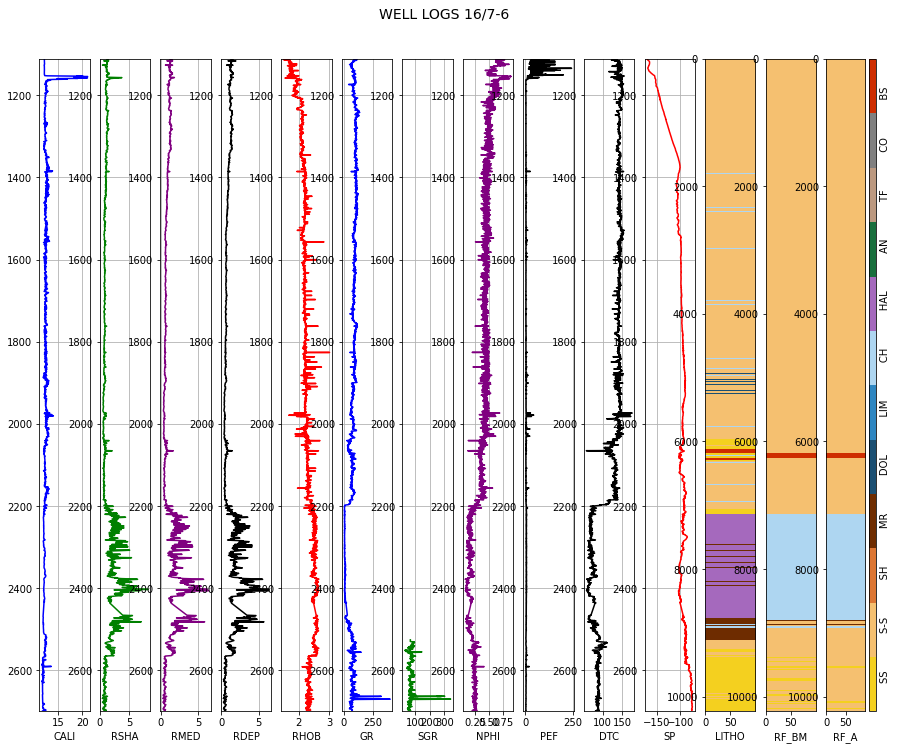

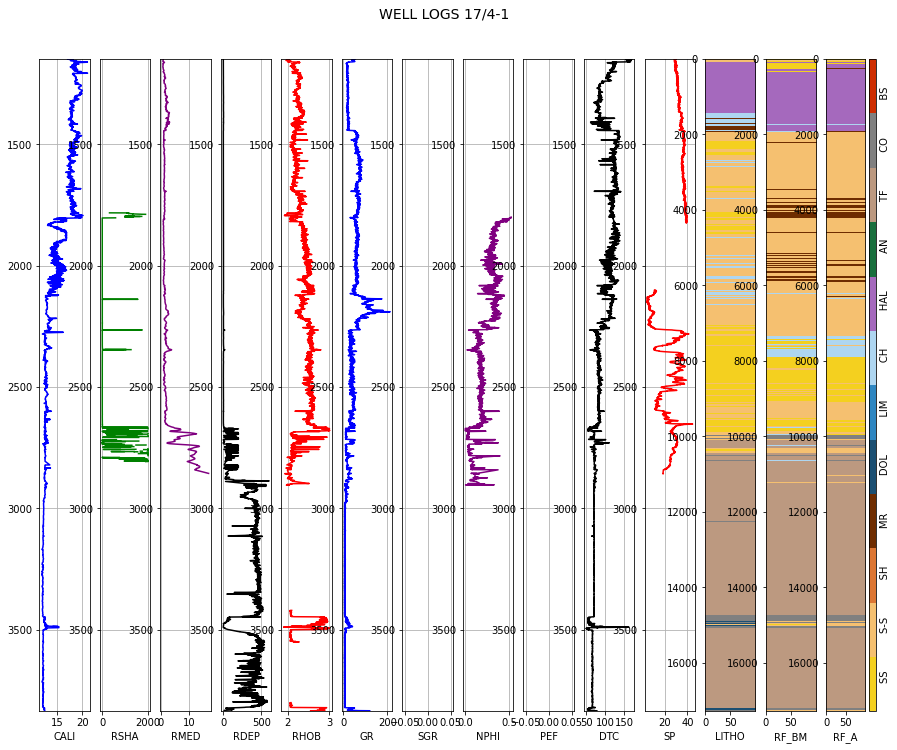

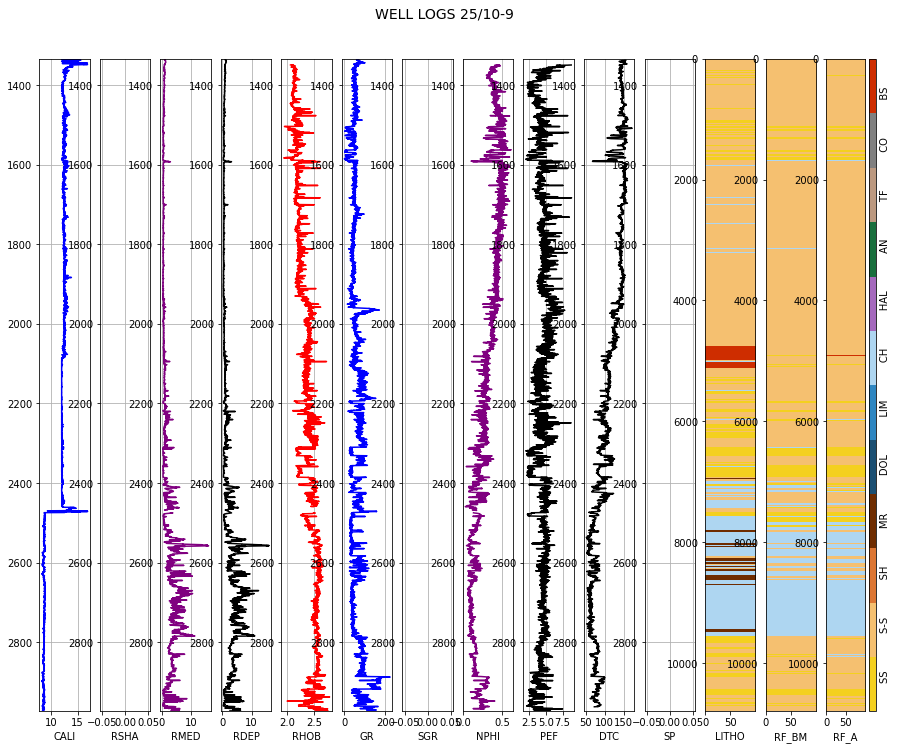

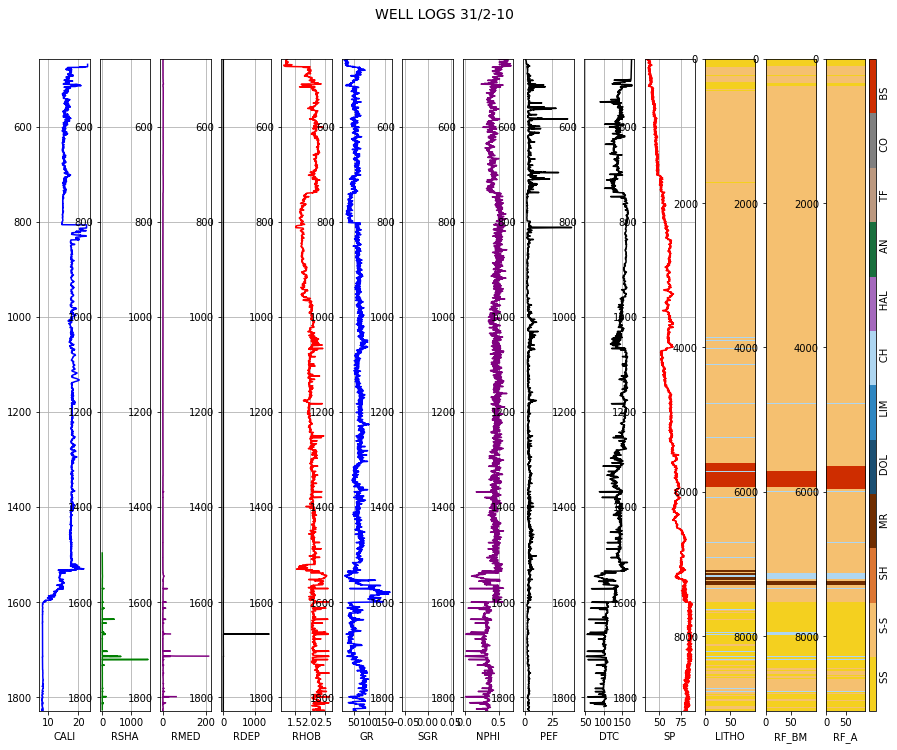

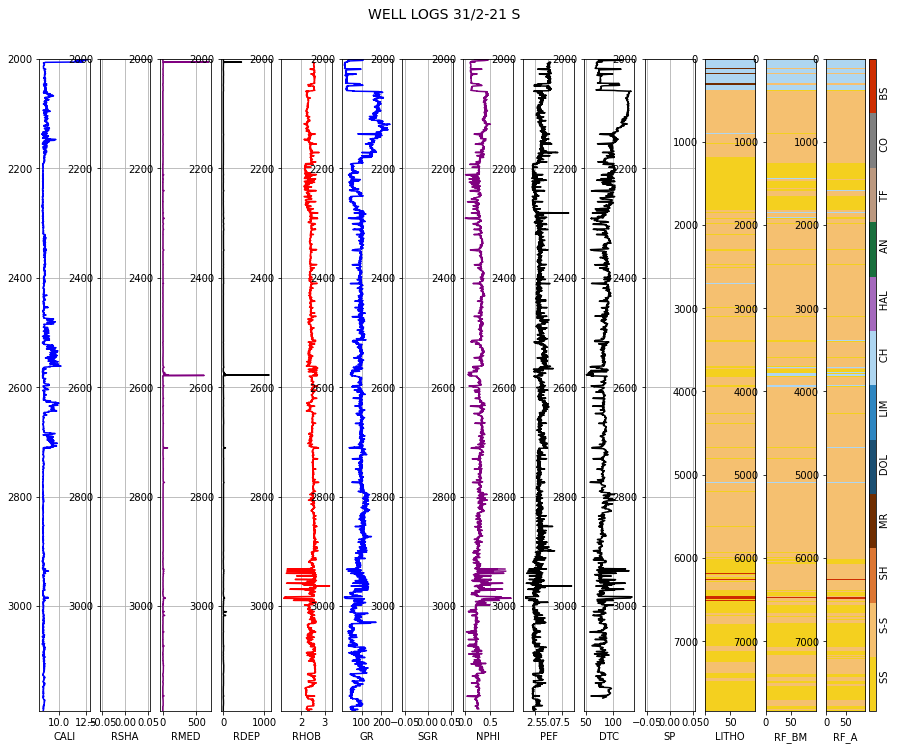

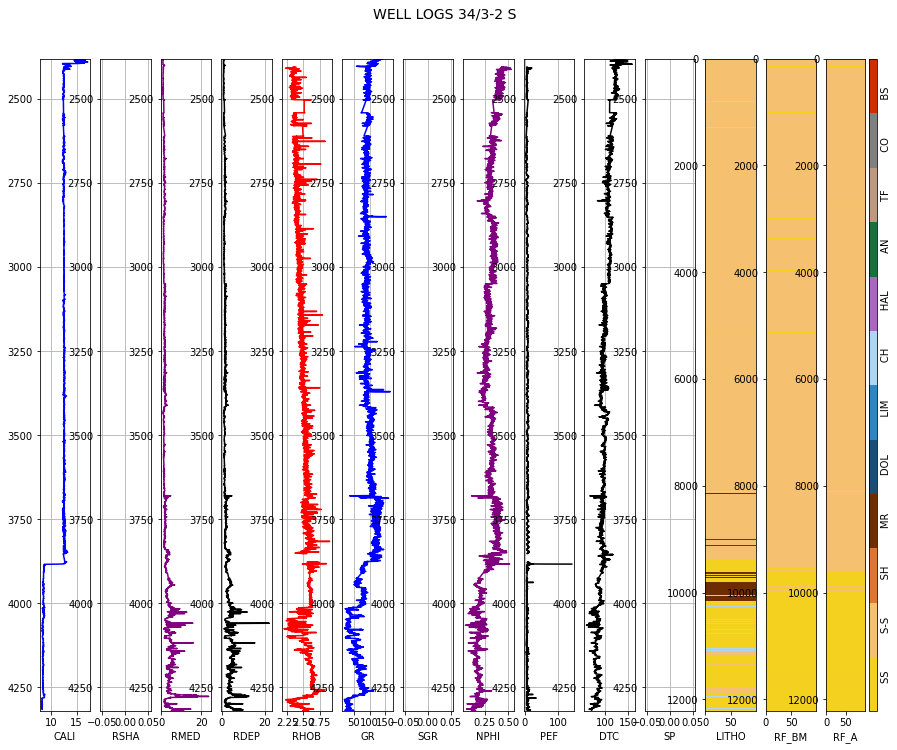

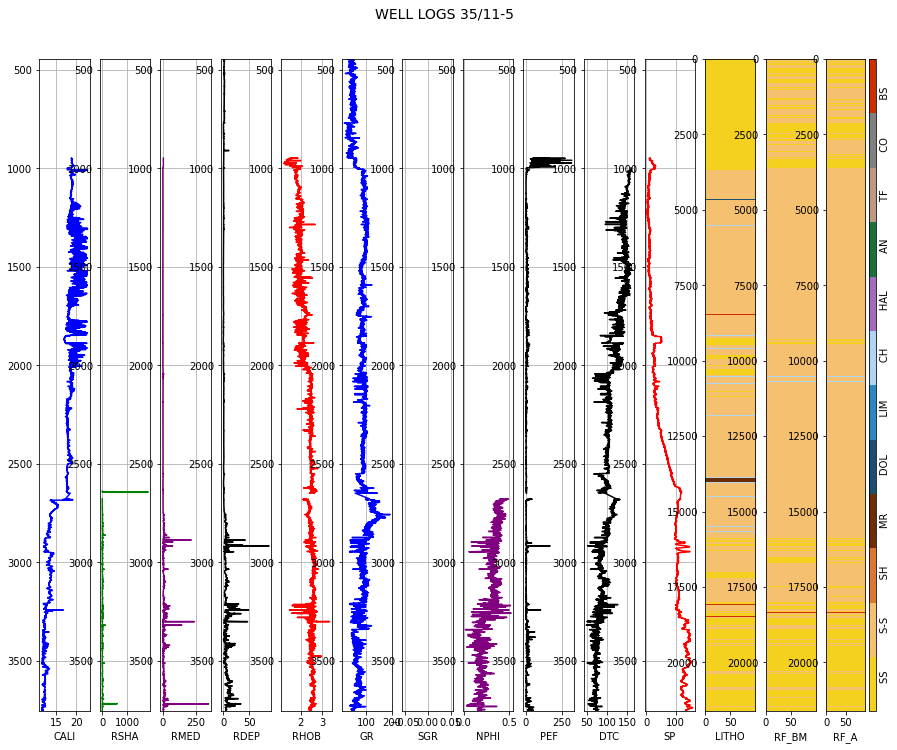

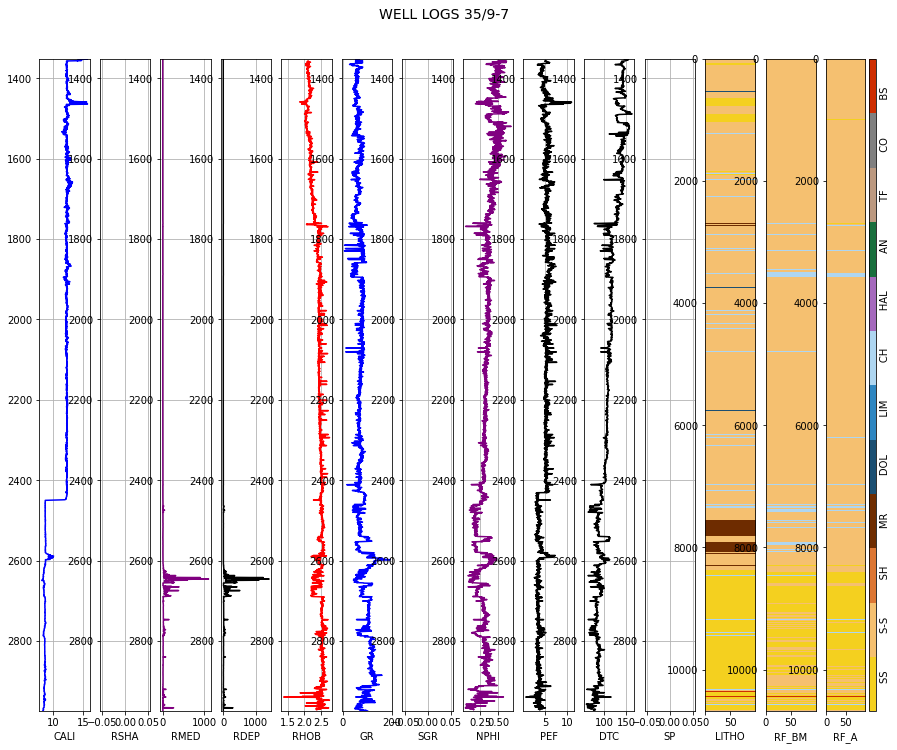

In [ ]:
#Plotting predictions - HIDDEN DATASET
for i in range(10):
  pred_log(hidden_rf_res, i, facies_colors, 2)

### **C. NEURAL NETWORK (FINISHED)**

In [ ]:
#pip install scikit-optimize

In [ ]:
##Defining the model and adding the input layer to it
import numpy as np
import seaborn as sns
import pandas as pd
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.colors as colors
import matplotlib as mpl
from tensorflow.keras import layers
from tensorflow.keras import backend as K
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import InputLayer, Input
from tensorflow.keras.layers import Dense, Dropout, Activation
from tensorflow.keras.callbacks import TensorBoard
from tensorflow.keras.optimizers import Adagrad, Adam, SGD, Adamax
from tensorflow.keras.models import load_model
from tensorflow.keras.callbacks import EarlyStopping

# Imports for Scikit Optimizer
import skopt
from skopt import gp_minimize, forest_minimize
from skopt.space import Real, Categorical, Integer
from skopt.plots import plot_convergence
from skopt.plots import plot_objective, plot_evaluations
from skopt.plots import plot_objective
from skopt.utils import use_named_args
#from sklearn.model_selection import train_test_split
#from sklearn.compose import ColumnTransformer
#from sklearn.preprocessing import StandardScaler

#### C.1 DATA PREPARATION

In [ ]:
features_selected_nn = ['RDEP','GR', 'NPHI_COMB', 'GM', 'AI_P', 
                        'AI', 'DTC', 'DTS_COMB', 'RSHA', 'DT_R', 
                        'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster',
                        'GROUP_encoded', 'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 
                        'CALI', 'BS', 'X_LOC', 'RMED', 'PEF', 
                        'SP', 'MD_TVD', 'ROP','RMIC','DRHO'
                      ]

In [ ]:
#Converting labels into categorical labels and training data into tensors
x_train_nn = tf.convert_to_tensor(x_train[features_selected_nn])
#y_train_nn = tf.keras.utils.to_categorical(y_train, dtype='int64')
x_test_nn = tf.convert_to_tensor(x_test[features_selected_nn])
#y_test_nn = tf.keras.utils.to_categorical(y_test, dtype='int64')
x_hidden_nn = tf.convert_to_tensor(x_hidden[features_selected_nn])

#### C.2 BASE MODEL SGD

In [ ]:
## Fully connected neural network base model 
def design_model(features, l_rate):
  model = Sequential(name="Litho_prediction")
  num_features = features.shape[1]
  model.add(layers.InputLayer(input_shape=(num_features, )))  #Input Layer 

  model.add(Dense(32, activation='relu',                      #Hidden Layer
                  kernel_initializer='random_normal',
                  bias_initializer='zeros'))                    

  model.add(Dense(12, activation='softmax',                   #Output layer
                  kernel_initializer='random_normal',
                  bias_initializer='zeros'))   
                   
  opt = SGD(learning_rate=l_rate)    #Adam Optimizer

  model.compile(loss='sparse_categorical_crossentropy',
                metrics=['accuracy'], optimizer=opt)          #Sparse categorical crossentropy 
  return model

In [ ]:
#------------FIRST CLASSIFICATION USING NN---------------------
#Creating a model 
nn_model = design_model(x_train_nn, 0.001)
nn_model.summary()

Model: "Litho_prediction"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_70 (Dense)             (None, 32)                992       
_________________________________________________________________
dense_71 (Dense)             (None, 12)                396       
Total params: 1,388
Trainable params: 1,388
Non-trainable params: 0
_________________________________________________________________


In [ ]:
#Fitting the model 
#with tf.device('/CPU:0'):         #It can be with '/CPU:0'

early_stopping = EarlyStopping(monitor='val_loss', 
                               patience=20, 
                               min_delta=1e-3, 
                               verbose=1, 
                               mode='auto', 
                               restore_best_weights=True
                               )

with tf.device('/GPU:0'):          #It can be with '/GPU:0'
  history = nn_model.fit(x_train_nn, 
                    y_train, 
                    epochs = 100, 
                    batch_size = 256, 
                    verbose = 1, 
                    validation_data = (x_test_nn, y_test), 
                    callbacks = [early_stopping] 
                    )

Epoch 1/100
4573/4573 [==============================] - 9s 2ms/step - loss: 1.7016 - accuracy: 0.6023 - val_loss: 1.3539 - val_accuracy: 0.6139
Epoch 2/100
4573/4573 [==============================] - 8s 2ms/step - loss: 1.1824 - accuracy: 0.6181 - val_loss: 1.1237 - val_accuracy: 0.6417
Epoch 3/100
4573/4573 [==============================] - 8s 2ms/step - loss: 1.0379 - accuracy: 0.6534 - val_loss: 1.0349 - val_accuracy: 0.6678
Epoch 4/100
4573/4573 [==============================] - 9s 2ms/step - loss: 0.9651 - accuracy: 0.6824 - val_loss: 0.9940 - val_accuracy: 0.7034
Epoch 5/100
4573/4573 [==============================] - 9s 2ms/step - loss: 0.9257 - accuracy: 0.7042 - val_loss: 0.9741 - val_accuracy: 0.7178
Epoch 6/100
4573/4573 [==============================] - 9s 2ms/step - loss: 0.9006 - accuracy: 0.7137 - val_loss: 0.9602 - val_accuracy: 0.7222
Epoch 7/100
4573/4573 [==============================] - 9s 2ms/step - loss: 0.8822 - accuracy: 0.7193 - val_loss: 0.9490 - val_ac

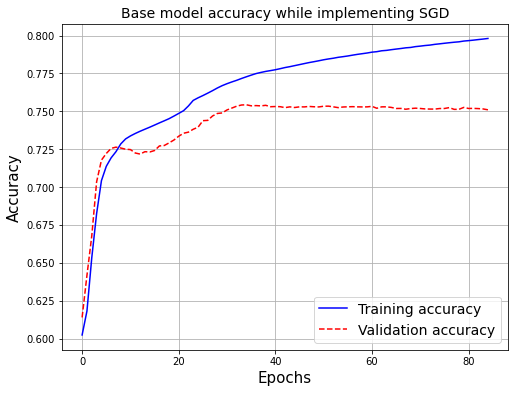

In [ ]:
# Base Model Visualization
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(8, 6))
plt.plot(history.history['accuracy'], '-b')
plt.plot(history.history['val_accuracy'], '--r' )
plt.title('Base model accuracy while implementing SGD', size=14)
plt.xlabel('Epochs', size=15)
plt.ylabel('Accuracy', size=15)
#plt.ylim(0.70, 0.85)
#plt.xlim(0, 30)
plt.legend(['Training accuracy', 'Validation accuracy'], loc='lower right', fontsize=14)
plt.grid(True)
plt.show()

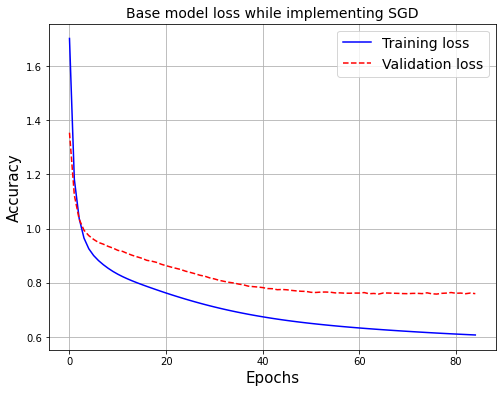

In [ ]:
## Base Model Visualization
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(8, 6))
plt.plot(history.history['loss'], '-b')
plt.plot(history.history['val_loss'], '--r' )
plt.title('Base model loss while implementing SGD', size=14)
plt.xlabel('Epochs', size=15)
plt.ylabel('Accuracy', size=15)
#plt.ylim(0.4, 1.0)
#plt.xlim(0, 35)
plt.legend(['Training loss', 'Validation loss'], loc='upper right', fontsize=14)
plt.grid(True)
plt.show()

In [ ]:
#Predicting by using NN --- HIDDEN AS VALIDATION

nn_train_prob = nn_model.predict(x_train_nn)
train_nn1 = np.array(pd.DataFrame(nn_train_prob).idxmax(axis=1))

nn_open_prob = nn_model.predict(x_test_nn)
open_nn1 = np.array(pd.DataFrame(nn_open_prob).idxmax(axis=1))

nn_hidden_prob = nn_model.predict(x_hidden_nn)
hidden_nn1 = np.array(pd.DataFrame(nn_hidden_prob).idxmax(axis=1))

print("The training set accuracy is {} and the f1 score is {}".format(accuracy_score(y_train, train_nn1), f1_score(y_train, train_nn1, average="weighted")))
print("The open set accuracy is {} and the f1 score is {}".format(accuracy_score(y_test, open_nn1), f1_score(y_test, open_nn1, average="weighted")))
print("The hidden set accuracy is {} and the f1 score is {}". format(accuracy_score(y_hidden, hidden_nn1), f1_score(y_hidden, hidden_nn1, average="weighted")))

The training set accuracy is 0.7909306277343827 and the f1 score is 0.7709009541792661
The open set accuracy is 0.7525770181158891 and the f1 score is 0.7278873463195108
The hidden set accuracy is 0.7399772870250088 and the f1 score is 0.7216317237316382


In [ ]:
print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train.values, train_nn1))
print('Training set report:', metrics.classification_report(y_train, train_nn1))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_nn1))
print('Open set report:', metrics.classification_report(y_test, open_nn1))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_hidden.values, hidden_nn1))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_nn1))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.55148018685856


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Training set report:               precision    recall  f1-score   support

           0       0.72      0.74      0.73    168937
           1       0.63      0.38      0.47    150455
           2       0.83      0.95      0.89    720803
           3       0.57      0.22      0.32     33329
           4       0.00      0.00      0.00      1688
           5       0.67      0.59      0.63     56320
           6       0.72      0.53      0.61     10513
           7       0.96      0.96      0.96      8213
           8       0.65      0.45      0.53      1085
           9       0.62      0.24      0.34     15245
          10       0.82      0.24      0.37      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.79   1170511
   macro avg       0.60      0.44      0.49   1170511
weighted avg       0.77      0.79      0.77   1170511

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.6508579094351761
O

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Open set penalty matrix score: -0.6770090361691872
Hidden set report:               precision    recall  f1-score   support

           0       0.64      0.65      0.64     14045
           1       0.37      0.19      0.25     12283
           2       0.84      0.93      0.88     71827
           3       0.17      0.17      0.17      4396
           4       0.00      0.00      0.00       287
           5       0.51      0.54      0.52      8374
           6       0.59      0.68      0.63      2905
           7       0.99      0.79      0.88      6498
           8       0.19      0.04      0.07       597
           9       0.31      0.15      0.20       941
          10       0.93      0.35      0.51       244

    accuracy                           0.74    122397
   macro avg       0.50      0.41      0.43    122397
weighted avg       0.71      0.74      0.72    122397



#### C.3 FEATURE IMPORTANCE EXPORATION

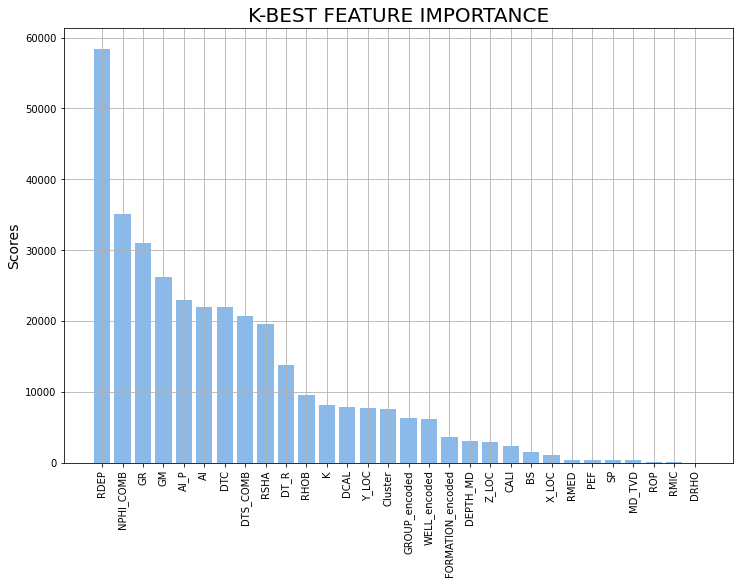

In [ ]:
#Ranking Features based on the K-Best Method
from sklearn.feature_selection import SelectKBest, chi2, f_classif

selected_features = SelectKBest(f_classif, k=30 ).fit(x_train, y_train)

selected_features_df = pd.DataFrame({'feature': list(x_train.columns),
                                     'scores': selected_features.scores_}).sort_values(by='scores', ascending=False)

#Ploting K-Best Feature Importances
#Visualizing Accuracies
f, ax = plt.subplots(figsize=(12,8))
x_pos = np.arange(len(x_train.columns))

#Create Bars
ax.bar(x_pos, selected_features_df.scores, color=(0.5, 0.7, 0.9, 0.9))
ax.set_ylabel('Scores', size=14)
ax.set_title('K-BEST FEATURE IMPORTANCE', size=20)

plt.xticks(x_pos, selected_features_df.feature, rotation=90)
plt.grid(True)
plt.show()

In [ ]:
#features_selected_nn = ['RDEP','GR', 'NPHI_COMB', 'GM', 'AI_P', 
                        #'AI', 'DTC', 'DTS_COMB', 'RSHA', 'DT_R', 
                        #'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster',
                        #'GROUP_encoded', 'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 
                        #'CALI', 'BS', 'X_LOC', 'RMED', 'PEF', 
                        #'SP', 'MD_TVD', 'ROP','RMIC','DRHO']

features_selected_nn = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
                        'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
                        'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
                        'PEF', 'RDEP', 'DTS_COMB', 'GM', 'SP',
                        'Cluster', 'K', 'AI_P', 'DRHO', 'DCAL',
                        'RSHA', 'BS', 'RMIC'
                        ]

#Converting labels into categorical labels and training data into tensors
x_train_nn = tf.convert_to_tensor(x_train[features_selected_nn])
x_test_nn = tf.convert_to_tensor(x_test[features_selected_nn])
x_hidden_nn = tf.convert_to_tensor(x_hidden[features_selected_nn])

In [ ]:
x_test_nn.shape

TensorShape([136786, 28])

In [ ]:
#------------FIRST CLASSIFICATION USING NN---------------------
#Creating a model 
nn_model2 = design_model(x_train_nn, 0.001)
nn_model2.summary()

#Fitting the model 
#with tf.device('/CPU:0'):         #It can be with '/CPU:0'

early_stopping = EarlyStopping(monitor='val_loss', 
                               patience=15, 
                               min_delta=1e-3, 
                               verbose=1, 
                               mode='auto', 
                               restore_best_weights=True
                               )

with tf.device('/GPU:0'):          #It can be with '/GPU:0'
  history = nn_model2.fit(x_train_nn, 
                    y_train, 
                    epochs = 25, 
                    batch_size = 256, 
                    verbose = 1, 
                    validation_data = (x_test_nn, y_test), 
                    callbacks = [early_stopping] 
                    )

Model: "Litho_prediction"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_39 (Dense)             (None, 32)                928       
_________________________________________________________________
dense_40 (Dense)             (None, 12)                396       
Total params: 1,324
Trainable params: 1,324
Non-trainable params: 0
_________________________________________________________________
Epoch 1/25
4573/4573 [==============================] - 13s 3ms/step - loss: 1.7061 - accuracy: 0.6033 - val_loss: 1.3933 - val_accuracy: 0.6139
Epoch 2/25
4573/4573 [==============================] - 12s 3ms/step - loss: 1.1995 - accuracy: 0.6159 - val_loss: 1.1642 - val_accuracy: 0.6193
Epoch 3/25
4573/4573 [==============================] - 12s 3ms/step - loss: 1.0599 - accuracy: 0.6415 - val_loss: 1.0687 - val_accuracy: 0.6568
Epoch 4/25
4573/4573 [==============================] - 13s 3ms/step - loss

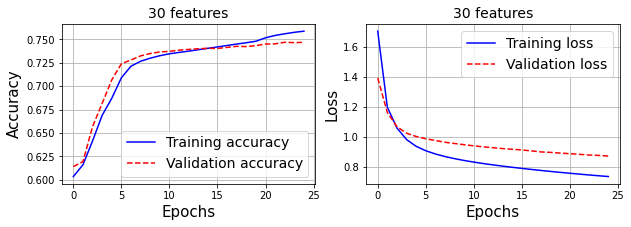

In [ ]:
# Base Model Visualization
from matplotlib import pyplot as plt
plt.figure(figsize=(10,10))

plt.subplot(3,2,1)
plt.plot(history.history['accuracy'], '-b')
plt.plot(history.history['val_accuracy'], '--r' )
plt.title('30 features', size=14)
plt.xlabel('Epochs', size=15)
plt.ylabel('Accuracy', size=15)
#plt.ylim(0.70, 0.85)
#plt.xlim(0, 30)
plt.legend(['Training accuracy', 'Validation accuracy'], loc='lower right', fontsize=14)
plt.grid(True)

## Base Model Visualization
plt.subplot(3,2,2)
plt.plot(history.history['loss'], '-b')
plt.plot(history.history['val_loss'], '--r' )
plt.title('30 features', size=14)
plt.xlabel('Epochs', size=15)
plt.ylabel('Loss', size=15)
#plt.ylim(0.4, 1.0)
#plt.xlim(0, 35)
plt.legend(['Training loss', 'Validation loss'], loc='upper right', fontsize=14)
plt.grid(True)
plt.show()

#### C.4 BAYESIAN OPTIMIZATION

**TARGETS FOR BAYESIAN OPTIMIZATION:**

1. Learning rate?
2. Number of dense layers?
3. Number of nodes for each layer?
4. Which activation function to select (relu/sigmoid)?

In [ ]:
features_selected_nn = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
                        'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
                        'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
                        'PEF', 'RDEP', 'DTS_COMB', 'GM', 'SP',
                        'Cluster', 'K', 'AI_P', 'DRHO', 'DCAL'
                        ]
                        
#Converting labels into categorical labels and training data into tensors
x_train_nn = tf.convert_to_tensor(x_train[features_selected_nn])
x_test_nn = tf.convert_to_tensor(x_test[features_selected_nn])
x_hidden_nn = tf.convert_to_tensor(x_hidden[features_selected_nn])

##### 12.3.1 Model Design and Setting Initial Parameters

In [ ]:
#Defining the dimention of the learning rate, number of layers, and layer neurons

dim_learning_rate = Real(low=1e-4, high=1e-1, prior='log-uniform', name='learning_rate')
dim_num_dense_layers = Integer(low=1, high=5, name='num_dense_layers')
dim_num_dense_nodes = Integer(low=64, high=512, name='num_dense_nodes')
dim_activation = Categorical(categories=['relu', 'sigmoid'], name='activation')

#Defining a list with all the parameters
dimensions = [dim_learning_rate,
              dim_num_dense_layers,
              dim_num_dense_nodes,
              dim_activation
              ]

defaut_parameters = [0.1, 2, 128, 'relu']

In [ ]:
# This is a function to log traning progress so that can be viewed by TnesorBoard.
def log_dir_name(learning_rate, num_dense_layers,
                 num_dense_nodes, activation):

    # The dir-name for the TensorBoard log-dir.
    s = "./19_logs/lr_{0:.0e}_layers_{1}_nodes_{2}_{3}/"

    # Insert all the hyper-parameters in the dir-name.
    log_dir = s.format(learning_rate,
                       num_dense_layers,
                       num_dense_nodes,
                       activation)
    return log_dir

In [ ]:
#Defining a neural netwotk create model function

def create_model(learning_rate, num_dense_layers, num_dense_nodes, activation):
  
  model = Sequential()
  num_features = x_train_nn.shape[1]
  model.add(layers.InputLayer(input_shape=(num_features, )))

  for i in range(num_dense_layers):                        #Adding hidden layers
    name = 'layer_dense_{0}'.format(i+1)
    model.add(Dense(num_dense_nodes,                       #Input layer
                    activation=activation,
                    name=name,
                    kernel_initializer='random_normal',    #Random normal weight initialization
                    bias_initializer='zeros'))             #Zeros bias initialization
    
  model.add(Dense(12,                                      #Output layer - 12 outputs
                  activation='softmax',                    #Softmax activation fuction
                  kernel_initializer='random_normal',      #Random normal weight initialization
                  bias_initializer='zeros'))               #Zeros bias initialization

  opt = SGD(learning_rate=learning_rate,                   #Adam optimizer  
            momentum=0.1)                                  #momentum to help covergence

  model.compile(optimizer=opt,                             #Compiling the model
                loss='sparse_categorical_crossentropy',    #Sparse categorical crossentropy loss
                metrics=['accuracy'])                          
  return model


In [ ]:
path_best_model = '19_best_model.h5'

In [ ]:
#Global variable to store accuracy
best_accuracy = 0

#Validation set
validation_data = (x_test_nn, y_test)

In [ ]:
@use_named_args(dimensions=dimensions)
def fitness(learning_rate, num_dense_layers,
            num_dense_nodes, activation):
    """
    Hyper-parameters:
    learning_rate:     Learning-rate for the optimizer.
    num_dense_layers:  Number of dense layers.
    num_dense_nodes:   Number of nodes in each dense layer.
    activation:        Activation function for all layers.
    """

    # Print the hyper-parameters.
    print('learning rate: {0:.1e}'.format(learning_rate))
    print('num_dense_layers:', num_dense_layers)
    print('num_dense_nodes:', num_dense_nodes)
    print('activation:', activation)
    print()
    
    # Create the neural network with these hyper-parameters.
    model = create_model(learning_rate=learning_rate,
                         num_dense_layers=num_dense_layers,
                         num_dense_nodes=num_dense_nodes,
                         activation=activation)

    # Dir-name for the TensorBoard log-files.
    log_dir = log_dir_name(learning_rate, num_dense_layers,
                           num_dense_nodes, activation)
    
    # Create a callback-function for Keras which will be
    # run after each epoch has ended during training.
    # This saves the log-files for TensorBoard.
    # Note that there are complications when histogram_freq=1.
    # It might give strange errors and it also does not properly
    # support Keras data-generators for the validation-set.
    callback_log = TensorBoard(
        log_dir=log_dir,
        histogram_freq=0,
        write_graph=True,
        write_grads=False,
        write_images=False)
   
    # Use Keras to train the model.
    history = model.fit(x= x_train_nn,
                        y= y_train,
                        epochs=7,
                        batch_size=256,
                        validation_data=validation_data,
                        callbacks=[callback_log])

    # Get the classification accuracy on the validation-set
    # after the last training-epoch.
    accuracy = history.history['val_accuracy'][-1]

    # Print the classification accuracy.
    print()
    print("Accuracy: {0:.2%}".format(accuracy))
    print()

    # Save the model if it improves on the best-found performance.
    # We use the global keyword so we update the variable outside
    # of this function.
    global best_accuracy

    # If the classification accuracy of the saved model is improved ...
    if accuracy > best_accuracy:
        # Save the new model to harddisk.
        model.save(path_best_model)
        
        # Update the classification accuracy.
        best_accuracy = accuracy

    # Delete the Keras model with these hyper-parameters from memory.
    del model
    
    # Clear the Keras session, otherwise it will keep adding new
    # models to the same TensorFlow graph each time we create
    # a model with a different set of hyper-parameters.
    K.clear_session()
    
    # NOTE: Scikit-optimize does minimization so it tries to
    # find a set of hyper-parameters with the LOWEST fitness-value.
    # Because we are interested in the HIGHEST classification
    # accuracy, we need to negate this number so it can be minimized.
    return -accuracy
# This function exactly comes from :Hvass-Labs, TensorFlow-Tutorials

##### 12.3.2 Testing Model With  Initial Parameter 

In [ ]:
## Test with dafault parameters
fitness(x= defaut_parameters)

learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 128
activation: relu

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.6286 - accuracy: 0.7945 - val_loss: 0.8392 - val_accuracy: 0.7420
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.4661 - accuracy: 0.8441 - val_loss: 0.9597 - val_accuracy: 0.6989
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.4178 - accuracy: 0.8590 - val_loss: 0.9062 - val_accuracy: 0.7305
Epoch 4/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.3878 - accuracy: 0.8679 - val_loss: 1.1152 - val_accuracy: 0.7000
Epoch 5/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.3683 - accuracy: 0.8737 - val_loss: 1.0502 - val_accuracy: 0.7583
Epoch 6/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.3543 - accuracy: 0.8774 - val_loss: 1.0455 - val_accuracy: 0.7261
Epoch 7/7
4573/4573 [==============================] -

-0.7204465270042419

##### 12.3.3 Bayesian Optimization

In [ ]:
## Optimization
%%time
search_result = gp_minimize(func=fitness,
                            dimensions=dimensions,
                            acq_func='EI', # Expected Improvement.
                            n_calls=75,
                            x0=defaut_parameters)

# you may examine other kind of minimization
#search_result = forest_minimize(func=fitness,
#                             dimensions=dimensions,
#                             base_estimator='RF', 
#                             n_calls=75,
#                             random_state=4)

learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 128
activation: relu

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.6322 - accuracy: 0.7928 - val_loss: 0.8203 - val_accuracy: 0.7403
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.4678 - accuracy: 0.8431 - val_loss: 0.8653 - val_accuracy: 0.7504
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.4148 - accuracy: 0.8590 - val_loss: 0.8529 - val_accuracy: 0.7456
Epoch 4/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.3850 - accuracy: 0.8681 - val_loss: 1.0552 - val_accuracy: 0.6970
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.3657 - accuracy: 0.8739 - val_loss: 0.9515 - val_accuracy: 0.7358
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.3518 - accuracy: 0.8782 - val_loss: 1.0100 - val_accuracy: 0.7036
Epoch 7/7
4573/4573 [==============================] -

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 1
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.9149 - accuracy: 0.7003 - val_loss: 0.9382 - val_accuracy: 0.6992
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.8017 - accuracy: 0.7292 - val_loss: 0.8971 - val_accuracy: 0.7247
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7549 - accuracy: 0.7440 - val_loss: 0.9571 - val_accuracy: 0.6210
Epoch 4/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7020 - accuracy: 0.7615 - val_loss: 0.7973 - val_accuracy: 0.7575
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6578 - accuracy: 0.7768 - val_loss: 0.7908 - val_accuracy: 0.7632
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6265 - accuracy: 0.7893 - val_loss: 0.7980 - val_accuracy: 0.7677
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 1
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.9130 - accuracy: 0.7009 - val_loss: 1.0631 - val_accuracy: 0.6799
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.8018 - accuracy: 0.7295 - val_loss: 0.9521 - val_accuracy: 0.6861
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7530 - accuracy: 0.7447 - val_loss: 0.9142 - val_accuracy: 0.6870
Epoch 4/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6966 - accuracy: 0.7629 - val_loss: 0.7928 - val_accuracy: 0.7627
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6496 - accuracy: 0.7792 - val_loss: 0.7844 - val_accuracy: 0.7422
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6120 - accuracy: 0.7943 - val_loss: 0.7304 - val_accuracy: 0.7751
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 1
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.9100 - accuracy: 0.7016 - val_loss: 1.0510 - val_accuracy: 0.5620
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7986 - accuracy: 0.7298 - val_loss: 0.8963 - val_accuracy: 0.7110
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7551 - accuracy: 0.7439 - val_loss: 0.8666 - val_accuracy: 0.7385
Epoch 4/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7016 - accuracy: 0.7615 - val_loss: 0.8780 - val_accuracy: 0.6821
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6557 - accuracy: 0.7782 - val_loss: 0.8047 - val_accuracy: 0.7426
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6189 - accuracy: 0.7919 - val_loss: 0.8130 - val_accuracy: 0.7464
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 1
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.9104 - accuracy: 0.7010 - val_loss: 0.9485 - val_accuracy: 0.7019
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.8003 - accuracy: 0.7295 - val_loss: 1.0249 - val_accuracy: 0.5785
Epoch 3/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7536 - accuracy: 0.7443 - val_loss: 0.9120 - val_accuracy: 0.6858
Epoch 4/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7017 - accuracy: 0.7611 - val_loss: 0.8186 - val_accuracy: 0.7166
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6559 - accuracy: 0.7773 - val_loss: 0.8163 - val_accuracy: 0.7505
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6188 - accuracy: 0.7911 - val_loss: 0.7682 - val_accuracy: 0.7576
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 17s 4ms/step - loss: 0.9148 - accuracy: 0.7020 - val_loss: 1.0161 - val_accuracy: 0.6561
Epoch 2/7
4573/4573 [==============================] - 16s 3ms/step - loss: 0.7909 - accuracy: 0.7329 - val_loss: 0.8832 - val_accuracy: 0.7295
Epoch 3/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7414 - accuracy: 0.7455 - val_loss: 0.8232 - val_accuracy: 0.7541
Epoch 4/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7062 - accuracy: 0.7562 - val_loss: 0.7919 - val_accuracy: 0.7434
Epoch 5/7
4573/4573 [==============================] - 16s 3ms/step - loss: 0.6698 - accuracy: 0.7695 - val_loss: 0.7679 - val_accuracy: 0.7518
Epoch 6/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6326 - accuracy: 0.7852 - val_loss: 0.7315 - val_accuracy: 0.7693
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 17s 4ms/step - loss: 0.9116 - accuracy: 0.7029 - val_loss: 0.9319 - val_accuracy: 0.7177
Epoch 2/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7896 - accuracy: 0.7334 - val_loss: 0.9123 - val_accuracy: 0.7085
Epoch 3/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7414 - accuracy: 0.7460 - val_loss: 0.9066 - val_accuracy: 0.6803
Epoch 4/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7047 - accuracy: 0.7574 - val_loss: 0.7985 - val_accuracy: 0.7516
Epoch 5/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6670 - accuracy: 0.7704 - val_loss: 0.7814 - val_accuracy: 0.7468
Epoch 6/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6319 - accuracy: 0.7845 - val_loss: 0.7609 - val_accuracy: 0.7549
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 17s 4ms/step - loss: 0.9123 - accuracy: 0.7032 - val_loss: 0.9529 - val_accuracy: 0.7241
Epoch 2/7
4573/4573 [==============================] - 16s 3ms/step - loss: 0.7903 - accuracy: 0.7329 - val_loss: 0.8820 - val_accuracy: 0.7193
Epoch 3/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7416 - accuracy: 0.7457 - val_loss: 0.8500 - val_accuracy: 0.7440
Epoch 4/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7074 - accuracy: 0.7559 - val_loss: 0.8291 - val_accuracy: 0.7373
Epoch 5/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6734 - accuracy: 0.7671 - val_loss: 0.7599 - val_accuracy: 0.7583
Epoch 6/7
4573/4573 [==============================] - 16s 3ms/step - loss: 0.6344 - accuracy: 0.7833 - val_loss: 0.7611 - val_accuracy: 0.7549
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 2
num_dense_nodes: 512
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 17s 4ms/step - loss: 0.9145 - accuracy: 0.7025 - val_loss: 1.0216 - val_accuracy: 0.6459
Epoch 2/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7900 - accuracy: 0.7330 - val_loss: 0.8903 - val_accuracy: 0.7103
Epoch 3/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.7402 - accuracy: 0.7460 - val_loss: 0.8389 - val_accuracy: 0.7425
Epoch 4/7
4573/4573 [==============================] - 16s 3ms/step - loss: 0.7051 - accuracy: 0.7570 - val_loss: 0.8129 - val_accuracy: 0.7459
Epoch 5/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6719 - accuracy: 0.7682 - val_loss: 0.7543 - val_accuracy: 0.7589
Epoch 6/7
4573/4573 [==============================] - 16s 4ms/step - loss: 0.6357 - accuracy: 0.7822 - val_loss: 0.7959 - val_accuracy: 0.7447
Epoch 7/7
4573/4573 [==============================

/usr/local/lib/python3.7/dist-packages/skopt/optimizer/optimizer.py:449: UserWarning:

The objective has been evaluated at this point before.



learning rate: 1.0e-01
num_dense_layers: 1
num_dense_nodes: 64
activation: sigmoid

Epoch 1/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.8730 - accuracy: 0.7121 - val_loss: 0.9326 - val_accuracy: 0.7209
Epoch 2/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.7558 - accuracy: 0.7449 - val_loss: 0.8952 - val_accuracy: 0.7354
Epoch 3/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.6911 - accuracy: 0.7676 - val_loss: 0.8115 - val_accuracy: 0.7617
Epoch 4/7
4573/4573 [==============================] - 14s 3ms/step - loss: 0.6431 - accuracy: 0.7831 - val_loss: 0.8145 - val_accuracy: 0.7601
Epoch 5/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.6064 - accuracy: 0.7966 - val_loss: 0.8028 - val_accuracy: 0.7569
Epoch 6/7
4573/4573 [==============================] - 13s 3ms/step - loss: 0.5788 - accuracy: 0.8073 - val_loss: 0.7836 - val_accuracy: 0.7547
Epoch 7/7
4573/4573 [==============================]

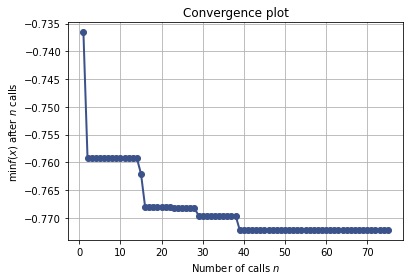

In [ ]:
#Progress Visualization 
plot_convergence(search_result) 
#plt.savefig("Converge.png", dpi=400

In [ ]:
#All hyper-parameters for each call 
sorted(zip(search_result.func_vals, search_result.x_iters)) 

[(-0.7721623778343201, [0.1, 2, 512, 'sigmoid']),
 (-0.7707367539405823, [0.1, 1, 187, 'sigmoid']),
 (-0.7695890069007874, [0.1, 1, 512, 'sigmoid']),
 (-0.768236517906189, [0.1, 2, 512, 'sigmoid']),
 (-0.7680099010467529, [0.1, 1, 512, 'sigmoid']),
 (-0.7667743563652039, [0.1, 1, 64, 'sigmoid']),
 (-0.7662991881370544, [0.1, 1, 200, 'sigmoid']),
 (-0.7658020853996277, [0.1, 1, 196, 'sigmoid']),
 (-0.7654438614845276, [0.1, 2, 512, 'sigmoid']),
 (-0.7639743685722351, [0.001754804010383925, 3, 512, 'relu']),
 (-0.763469934463501, [0.1, 1, 512, 'sigmoid']),
 (-0.7631555795669556, [0.0048140568063926165, 2, 64, 'relu']),
 (-0.7630386352539062, [0.1, 1, 512, 'sigmoid']),
 (-0.7628631591796875, [0.0020848698332195208, 2, 281, 'relu']),
 (-0.7627608180046082, [0.011241441828621678, 1, 512, 'relu']),
 (-0.7626804113388062, [0.0230872008536826, 2, 512, 'relu']),
 (-0.7620517015457153, [0.0017833918010507202, 4, 286, 'relu']),
 (-0.7609843015670776, [0.0015923220577817314, 3, 512, 'relu']),
 (-0

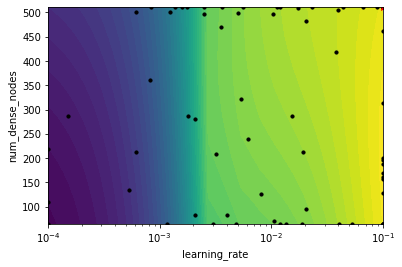

In [ ]:
#Plottign learning rate vs. number of neurons
from skopt.plots import plot_objective_2D
fig = plot_objective_2D(result=search_result,
                        dimension_identifier1='learning_rate',
                        dimension_identifier2='num_dense_nodes',
                        levels=50)
# plt.savefig("Lr_numnods.png", dpi=400)

<Figure size 3600x3600 with 0 Axes>

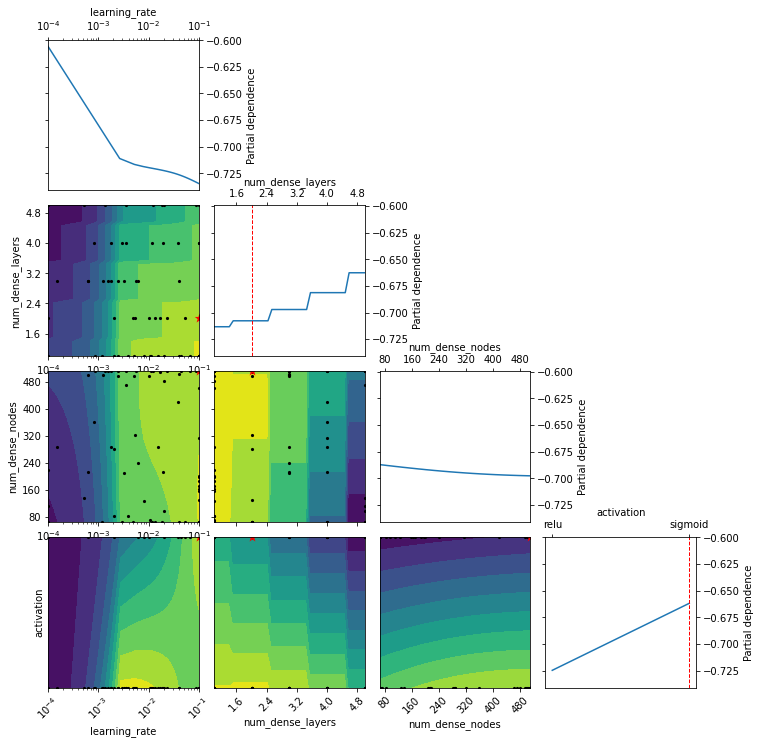

In [ ]:
# create a list for plotting
dim_names = ['learning_rate', 'num_dense_layers', 'num_dense_nodes', 'activation' ]


plt.figure(figsize=(50,50))
plot_objective(result=search_result, dimensions=dim_names, size=2.5)
plt.show()
#plt.savefig("all_dimen.png", dpi=400)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x7f41b7d8ce10>,
      dtype=object)

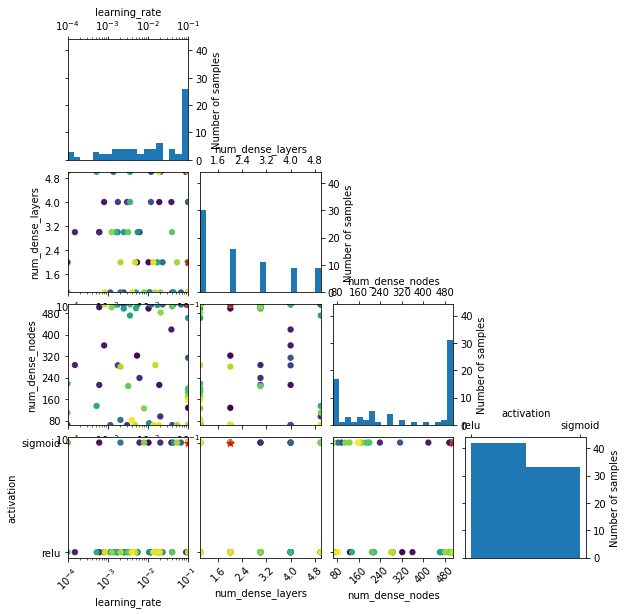

In [ ]:
#How the optimization ocurred
#plt.figure(figsize=(50,50))
plot_evaluations(result=search_result, dimensions=dim_names)

#### C.5 OPTIMIZED MODEL 

In [ ]:
features_selected_nn = ['GROUP_encoded', 'GR', 'NPHI_COMB', 'Y_LOC', 'RHOB',
                        'DEPTH_MD', 'FORMATION_encoded', 'Z_LOC', 'WELL_encoded', 'X_LOC',
                        'RMED', 'CALI', 'DTC', 'MD_TVD', 'DT_R',
                        'PEF', 'RDEP', 'DTS_COMB', 'GM', 'SP',
                        'Cluster', 'K', 'AI_P', 'DRHO', 'DCAL'
                        ]
                        
#Converting labels into categorical labels and training data into tensors
x_train_nn = tf.convert_to_tensor(x_train[features_selected_nn])
x_test_nn = tf.convert_to_tensor(x_test[features_selected_nn])
x_hidden_nn = tf.convert_to_tensor(x_hidden[features_selected_nn])

In [ ]:
## Use hyper-parameters from optimization (Stored results)
learning_rate = 0.1
num_layers = 2
num_nodes = 512
activation = 'sigmoid'

print('Best Hyperparameters are {}, {}, {}, {}'.format(learning_rate, num_layers, num_nodes, activation))

Best Hyperparameters are 0.1, 2, 512, sigmoid


In [ ]:
# Classification neural network
import numpy as np
import tensorflow.keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Activation
from tensorflow.keras.callbacks import EarlyStopping

opt_model = Sequential()
opt_model.add(InputLayer(input_shape=(x_train_nn.shape[1])))
opt_model.add(Dropout(0.1))
opt_model.add(Dense(num_nodes, activation=activation, kernel_initializer='random_normal'))
opt_model.add(Dropout(0.7))
opt_model.add(Dense(num_nodes, activation=activation, kernel_initializer='random_normal'))
opt_model.add(Dense(12, activation='softmax', kernel_initializer='random_normal'))

optimizer = SGD(learning_rate=learning_rate, momentum=0.1)
    
opt_model.compile(optimizer=optimizer, 
                  loss='sparse_categorical_crossentropy',  
                  metrics=['accuracy']
                  )

monitor = EarlyStopping(monitor='val_loss', min_delta=1e-3, patience=50, 
                        verbose=1, mode='auto', restore_best_weights=True)

histories = opt_model.fit(x_train_nn, 
                          y_train,
                          batch_size = 256,
                          validation_data = (x_test_nn, y_test),
                          callbacks = [monitor],
                          verbose=1,
                          epochs=100
                          )

Epoch 1/100
4573/4573 [==============================] - 12s 3ms/step - loss: 1.0442 - accuracy: 0.6584 - val_loss: 0.9785 - val_accuracy: 0.6705
Epoch 2/100
4573/4573 [==============================] - 12s 3ms/step - loss: 0.9259 - accuracy: 0.6923 - val_loss: 0.9255 - val_accuracy: 0.6915
Epoch 3/100
4573/4573 [==============================] - 13s 3ms/step - loss: 0.8902 - accuracy: 0.7019 - val_loss: 0.9102 - val_accuracy: 0.7070
Epoch 4/100
4573/4573 [==============================] - 12s 3ms/step - loss: 0.8668 - accuracy: 0.7077 - val_loss: 0.9069 - val_accuracy: 0.7076
Epoch 5/100
4573/4573 [==============================] - 13s 3ms/step - loss: 0.8481 - accuracy: 0.7119 - val_loss: 0.8732 - val_accuracy: 0.7146
Epoch 6/100
4573/4573 [==============================] - 12s 3ms/step - loss: 0.8324 - accuracy: 0.7159 - val_loss: 0.8445 - val_accuracy: 0.7332
Epoch 7/100
4573/4573 [==============================] - 12s 3ms/step - loss: 0.8177 - accuracy: 0.7196 - val_loss: 0.8252 -

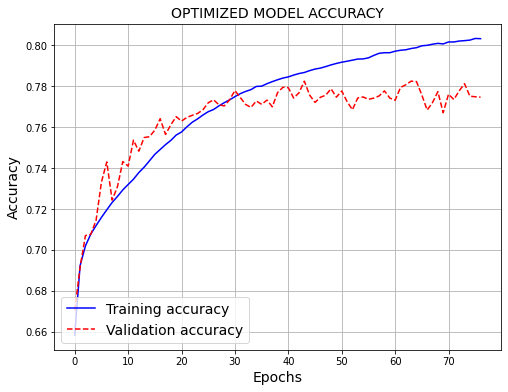

In [ ]:
## Base Model Visualization
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(8, 6))
plt.plot(histories.history['accuracy'], '-b')
plt.plot(histories.history['val_accuracy'], '--r' )
plt.title('OPTIMIZED MODEL ACCURACY', size=14)
plt.xlabel('Epochs', size=14)
plt.ylabel('Accuracy', size=14)

plt.legend(['Training accuracy', 'Validation accuracy'], loc='lower left', fontsize=14)
plt.grid(True)
plt.show()

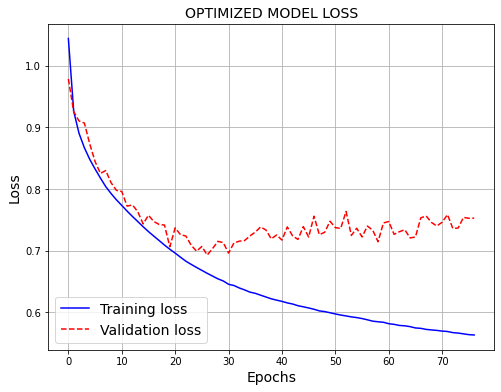

In [ ]:
## Base Model Visualization
from matplotlib import pyplot as plt
fig, ax = plt.subplots(figsize=(8, 6))
plt.plot(histories.history['loss'], '-b')
plt.plot(histories.history['val_loss'], '--r' )
plt.title('OPTIMIZED MODEL LOSS', size=14)
plt.xlabel('Epochs', size=14)
plt.ylabel('Loss', size=14)
plt.legend(['Training loss', 'Validation loss'], loc='lower left', fontsize=14)
plt.grid(True)
plt.show()

In [ ]:
#Predicting With Optimized Model

nn_train_prob = opt_model.predict(x_train_nn)
train_nn2 = np.array(pd.DataFrame(nn_train_prob).idxmax(axis=1))

nn_open_prob = opt_model.predict(x_test_nn)
open_nn2 = np.array(pd.DataFrame(nn_open_prob).idxmax(axis=1))

nn_hidden_prob = opt_model.predict(x_hidden_nn)
hidden_nn2 = np.array(pd.DataFrame(nn_hidden_prob).idxmax(axis=1))

In [ ]:
print('-----------------------TRAIN SET REPORT---------------------')
print('Training set penalty matrix score:', score(y_train.values, train_nn2))
print('Training set report:', metrics.classification_report(y_train, train_nn2))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_nn2))
print('Open set report:', metrics.classification_report(y_test, open_nn2))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_hidden.values, hidden_nn2))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_nn2))

-----------------------TRAIN SET REPORT---------------------
Training set penalty matrix score: -0.5113910719335402


/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Training set report:               precision    recall  f1-score   support

           0       0.82      0.68      0.74    168937
           1       0.67      0.39      0.49    150455
           2       0.82      0.97      0.89    720803
           3       0.68      0.49      0.57     33329
           4       0.00      0.00      0.00      1688
           5       0.76      0.60      0.67     56320
           6       0.87      0.59      0.70     10513
           7       0.96      0.99      0.98      8213
           8       0.86      0.80      0.83      1085
           9       0.73      0.55      0.62     15245
          10       0.85      0.38      0.53      3820
          11       0.00      0.00      0.00       103

    accuracy                           0.81   1170511
   macro avg       0.67      0.54      0.58   1170511
weighted avg       0.79      0.81      0.79   1170511

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.5942402731273668
O

In [ ]:
#Storing results
train_nn_res = labeled_data.copy()
test_nn_res = test_data.copy()
hidden_nn_res = hidden_data.copy()

#Appending predictions to a copy of the original datasets
train_nn_res['NN_TM'] = train_nn2
test_nn_res['NN_TM'] = open_nn2
hidden_nn_res['NN_TM'] = hidden_nn2

In [ ]:
#Saving results 3 methods
train_nn_res.to_csv('/content/drive/MyDrive/Results_folder/NN/train_nn_final_res.csv', index=False)
test_nn_res.to_csv('/content/drive/MyDrive/Results_folder/NN/tes_nn_final_res.csv', index=False)
hidden_nn_res.to_csv('/content/drive/MyDrive/Results_folder/NN/hidden_nn_final_res.csv', index=False)

#### C.6 PLOTTING RESULTS

In [ ]:
#Importing results csv files
train_nn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/train_nn_final_res.csv')
test_nn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/tes_nn_final_res.csv')
hidden_nn_res = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/hidden_nn_final_res.csv')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:19: RuntimeWarning:

invalid value encountered in long_scalars



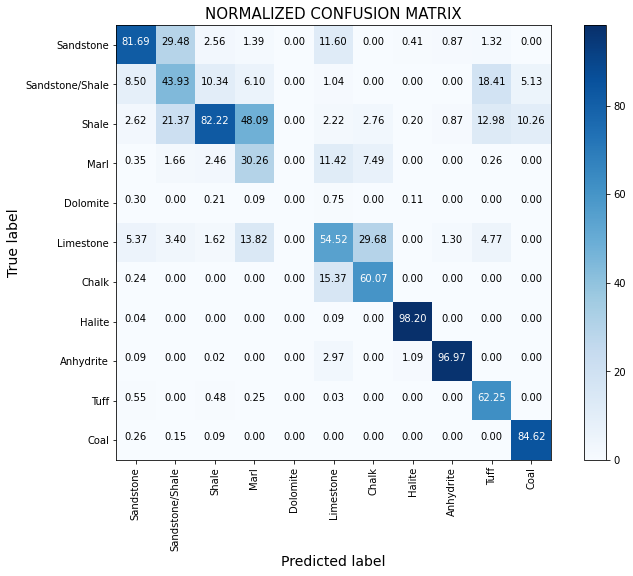

In [ ]:
litho_confusion_matrix(hidden_nn_res.LITHO, hidden_nn_res.NN_TM)

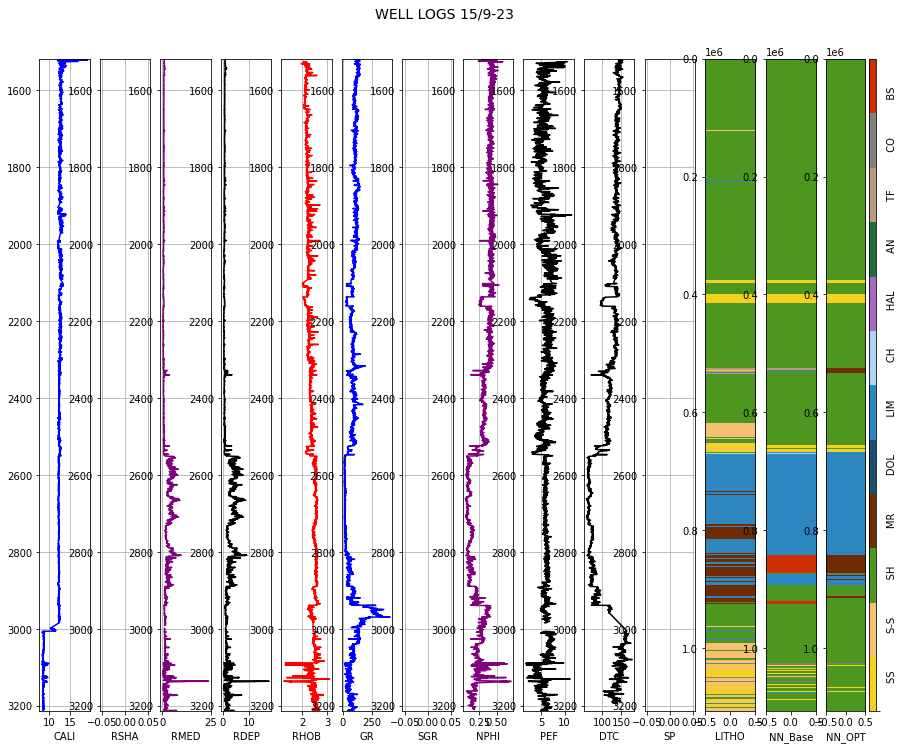

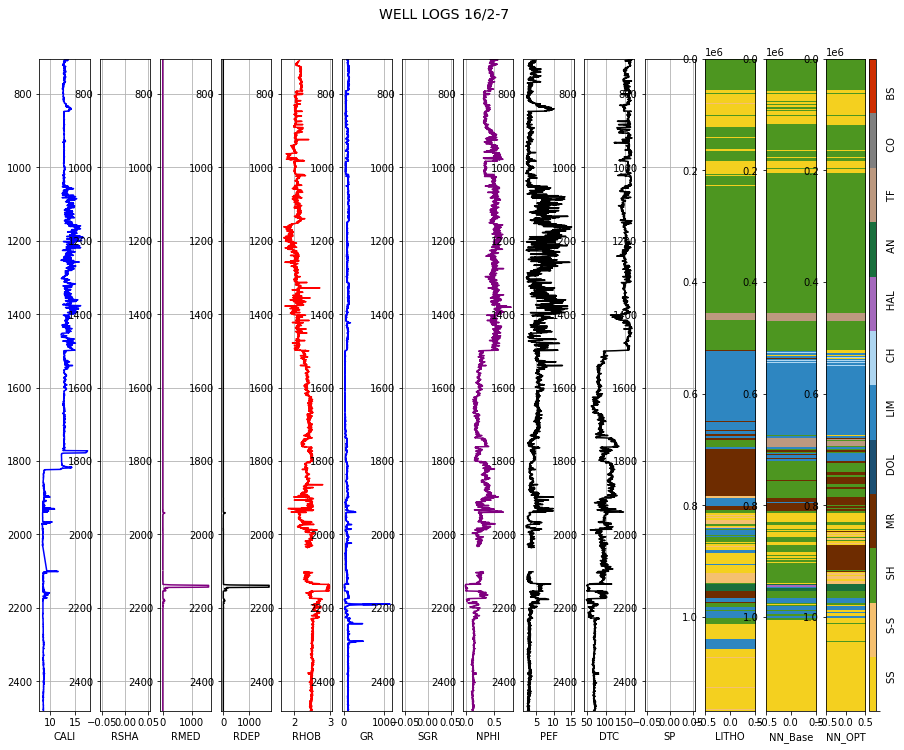

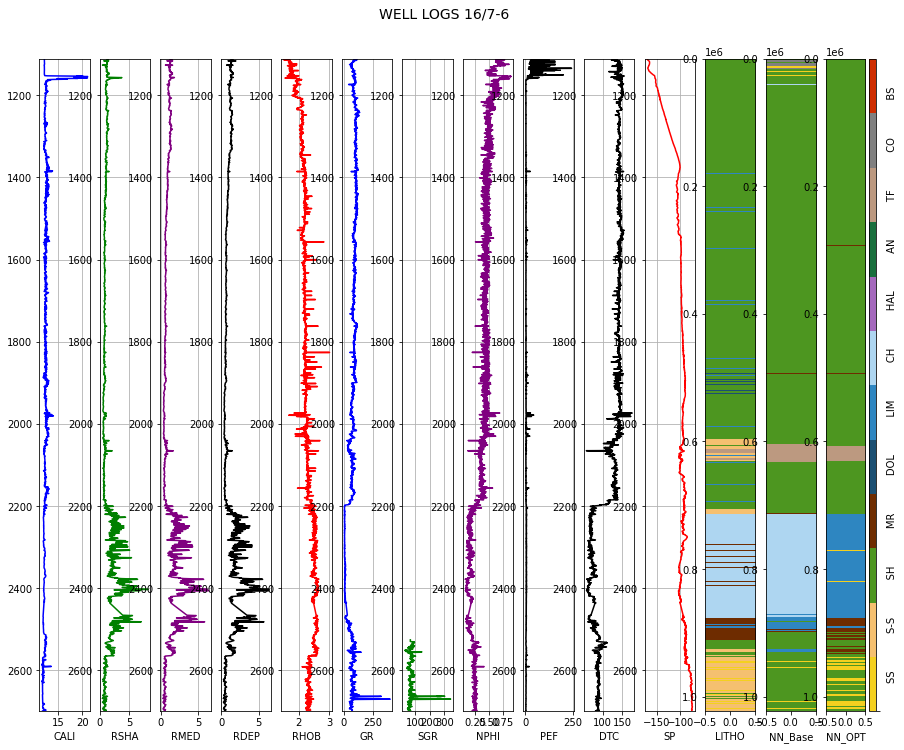

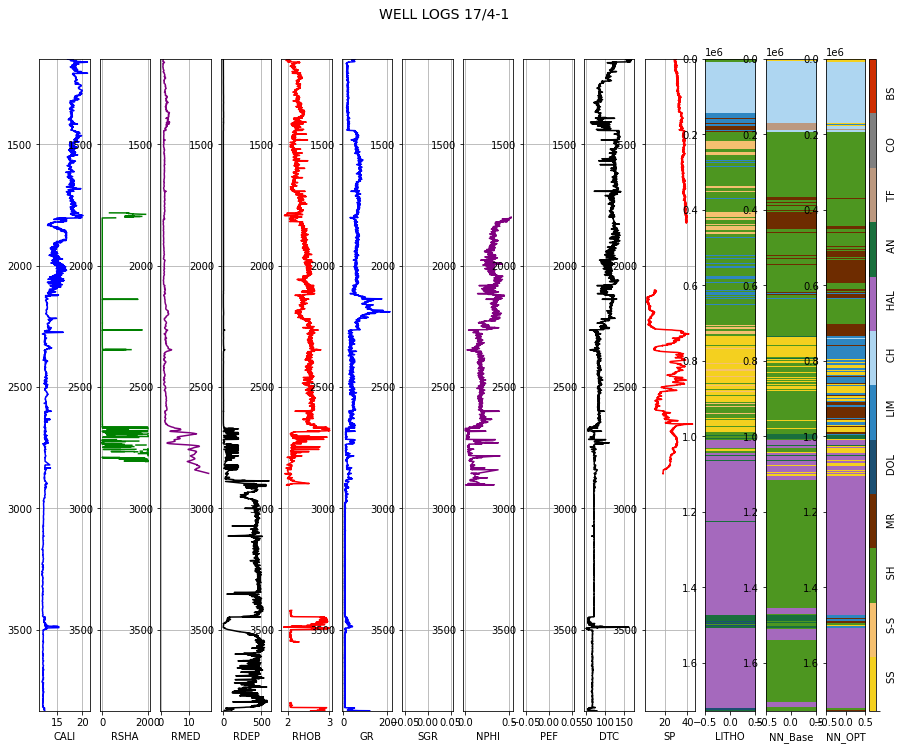

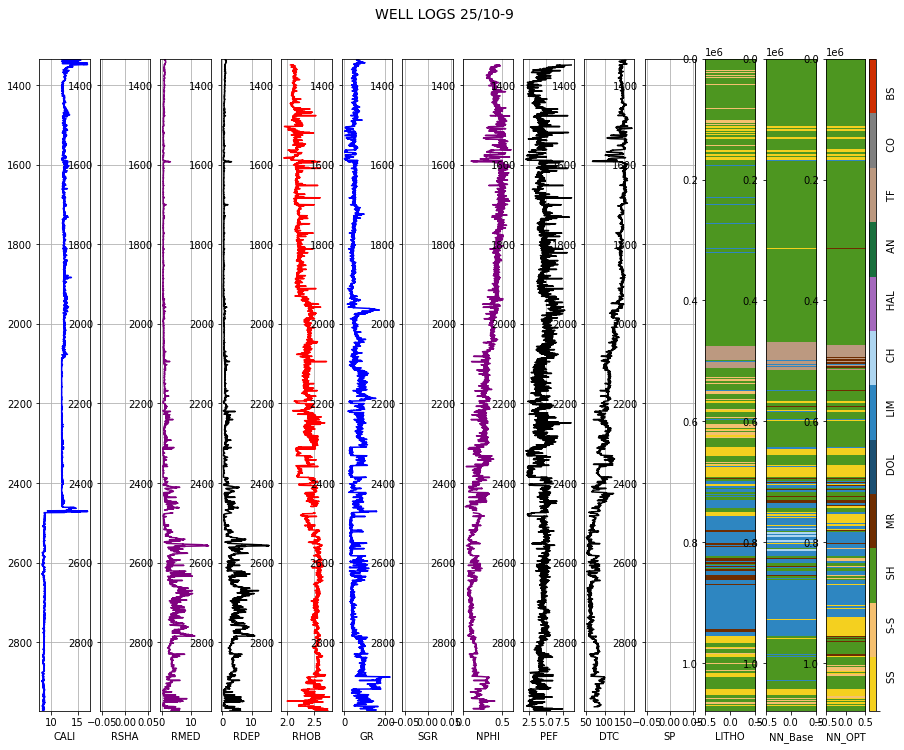

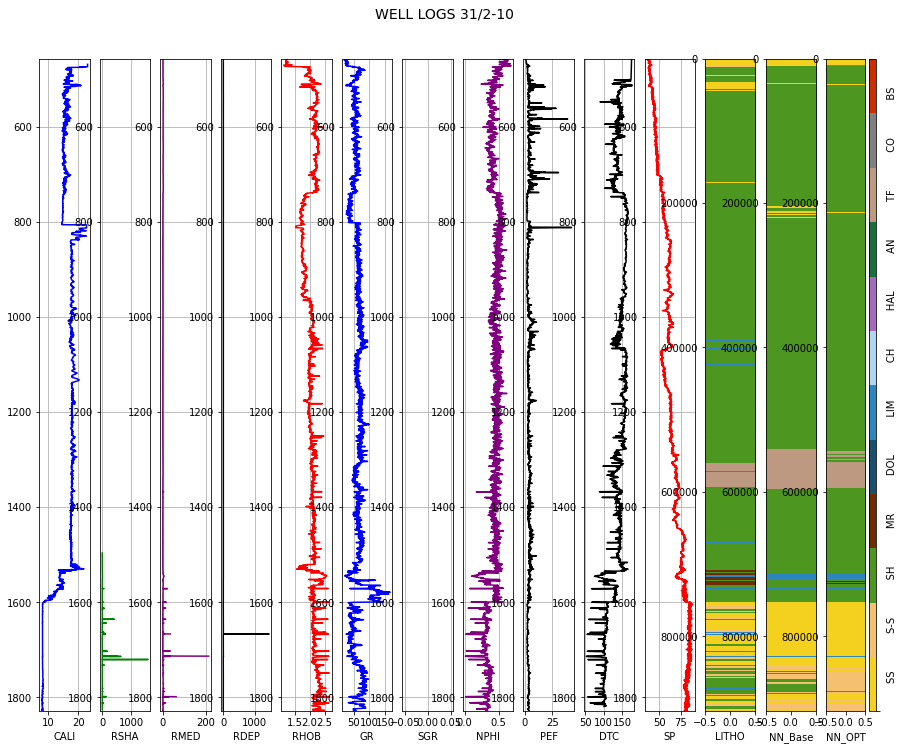

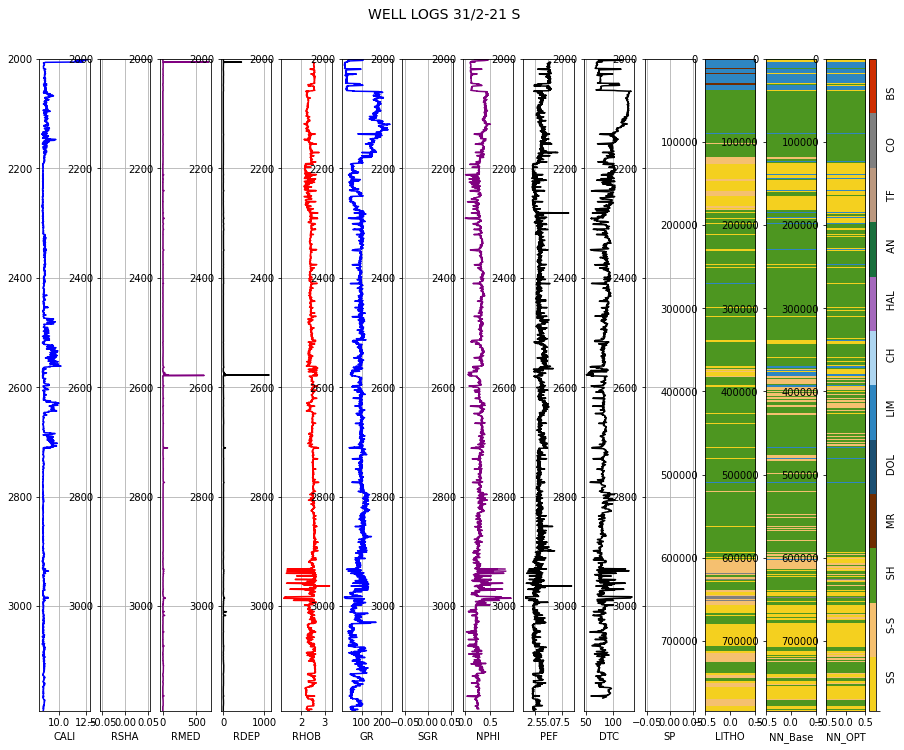

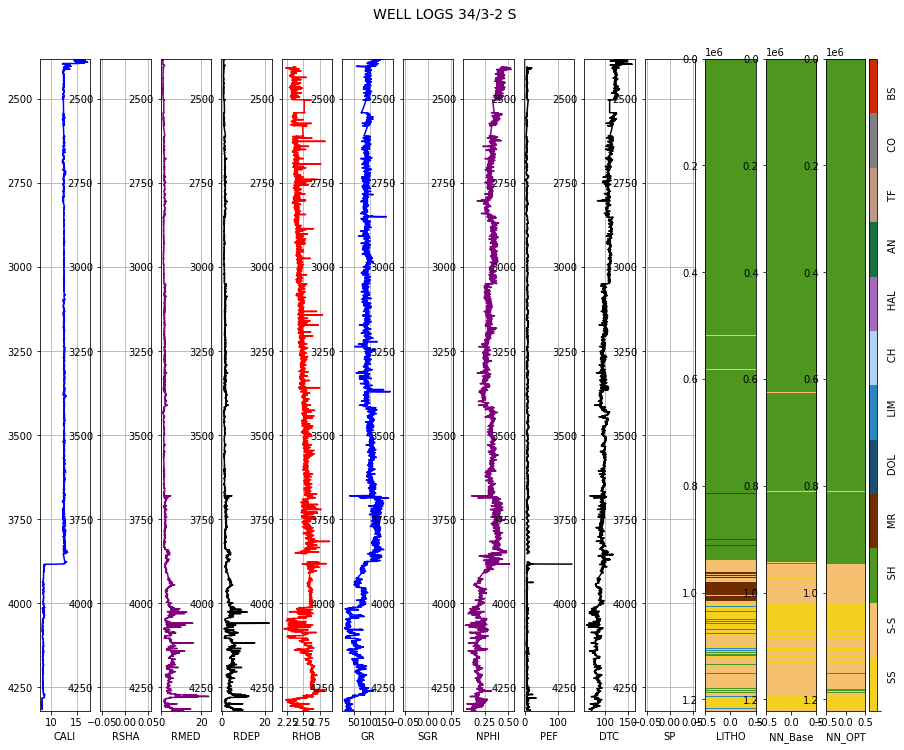

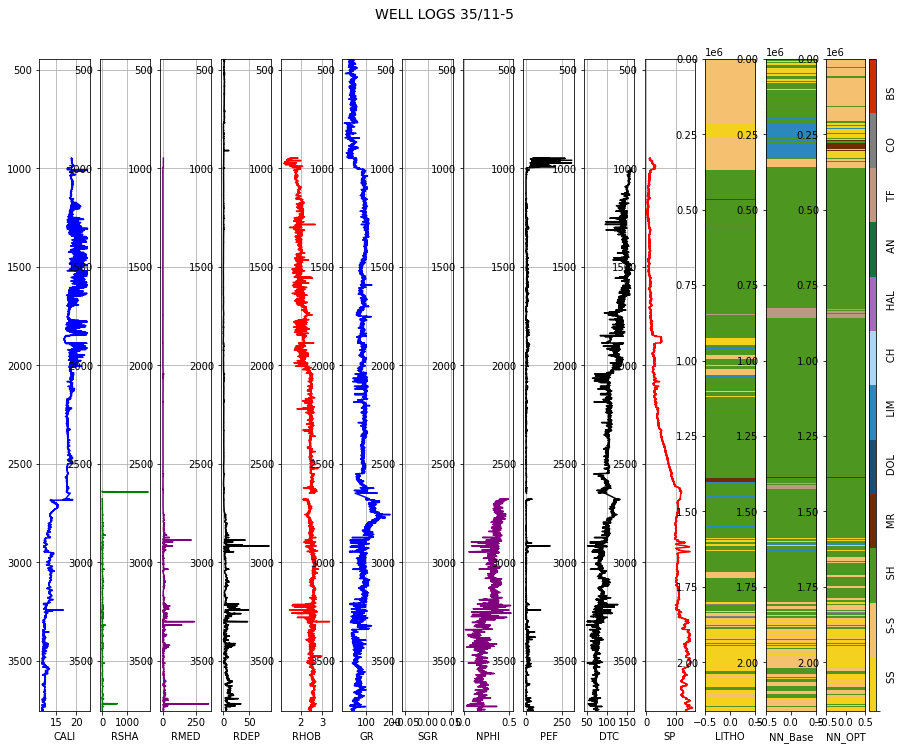

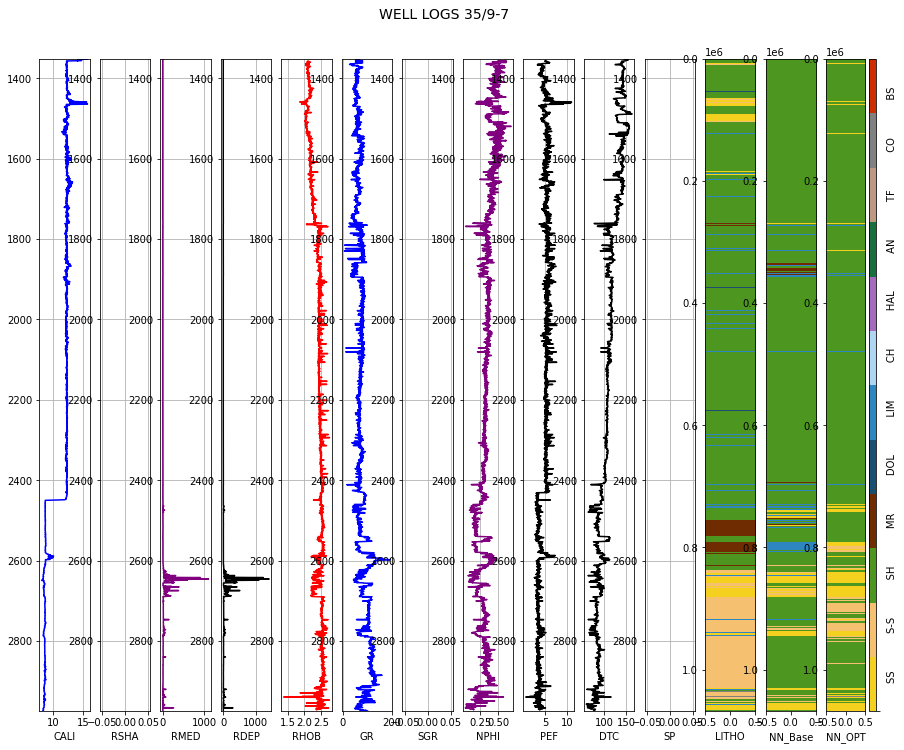

In [ ]:
#Plotting Base Model and Bayesian Optimized Model
for i in range(10):
  pred_log(hidden_nn_res, i, facies_colors, 2)

## **11. MODELS COMPARISION**

### TEST SET HISTOGRAMS

#### REPORT

In [ ]:
test_lr = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/test_lr_f_res.csv')
test_svm = pd.read_csv('/content/drive/MyDrive/Results_folder/SVM/test_svm_final_res.csv')
test_knn = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/test_knn_final_res.csv')
test_dt = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/test_dt_f_res.csv')
test_rf = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/tes_rf_final_res.csv')
test_xgb = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/test_xgb_final_res.csv')
test_lgbm = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/tes_light_f_res.csv')
test_cat = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/tes_cat_f_res.csv')
test_nn = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/tes_nn_final_res.csv')

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
model_names = ['Logistic Regression', 'Support Vector Machines', 'K-Nearest Neighbors',
               'Decision Tree', 'Random Forest', 'Extreme Boosting', 'Light Boosting', 'Categorical Boosting', 'Neural Networks']

test_frames = [test_lr.LR_TM, test_svm.SVM_TM, test_knn.KNN_TM, 
                 test_dt.DT_PRU, test_rf.RF_TM, test_xgb.XGB_TM, test_lgbm.LGBM_TM,
                 test_cat.KNN_NA, test_nn.NN_TM]

test_litho = test_lr.LITHO
test_scores = [score(test_litho.values, frame.values) for frame in test_frames]
test_accuracies = [accuracy_score(test_litho.values, frame.values)*100 for frame in test_frames]
test_precisions = [precision_score(test_litho.values, frame.values, average='weighted')*100 for frame in test_frames]
test_recalls = [recall_score(test_litho.values, frame.values, average='weighted')*100 for frame in test_frames]
test_f1s = [f1_score(test_litho.values, frame.values, average='weighted')*100 for frame in test_frames]

pd.set_option('display.float_format', lambda x: '%.2f' % x)
hidden_results = pd.DataFrame({'Algorithm': model_names,
                               'Accuracy': test_accuracies,
                               'Precision': test_precisions,
                               'Recall': test_recalls,
                               'F1 score': test_f1s,
                               'Matrix score': test_scores})
hidden_results.sort_values(by='Accuracy', ascending=False)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



,Algorithm,Accuracy,Precision,Recall,F1 score,Matrix score
7,Categorical Boosting,79.91,78.19,79.91,77.22,-0.52
5,Extreme Boosting,79.61,77.31,79.61,77.06,-0.53
6,Light Boosting,79.36,76.81,79.36,76.98,-0.53
4,Random Forest,77.71,74.84,77.71,75.05,-0.58
2,K-Nearest Neighbors,77.53,74.19,77.53,74.44,-0.59
8,Neural Networks,77.34,74.58,77.34,74.32,-0.59
1,Support Vector Machines,76.10,73.41,76.10,73.79,-0.62
3,Decision Tree,74.55,69.67,74.55,67.14,-0.69
0,Logistic Regression,71.54,67.77,71.54,69.11,-0.75


#### TOTAL PREDICTIONS

In [ ]:
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

real_litho = dict(test_lr.LITHO.map(lithology_numbers2).value_counts())
lr_dic = dict(test_lr.LR_TM.map(lithology_numbers2).value_counts())
svm_dic = dict(test_svm.SVM_TM.map(lithology_numbers2).value_counts())
knn_dic = dict(test_knn.KNN_TM.map(lithology_numbers2).value_counts())
dt_dic = dict(test_dt.DT_PRU.map(lithology_numbers2).value_counts())
rf_dic = dict(test_rf.RF_TM.map(lithology_numbers2).value_counts())
xgb_dic = dict(test_xgb.XGB_TM.map(lithology_numbers2).value_counts())
lgbm_dic = dict(test_lgbm.LGBM_TM.map(lithology_numbers2).value_counts())
cat_dic = dict(test_cat.KNN_NA.map(lithology_numbers2).value_counts())
nn_dic = dict(test_nn.NN_TM.map(lithology_numbers2).value_counts())

total_count = {'REAL LITHOLOGY': real_litho,
               'LOGISTIC REGRESSION - LR': lr_dic,
               'SUPPORT VECTOR MACHINES - SVM': svm_dic,
               'K-NEAREST NEIGHBORS - KNN': knn_dic,
               'DECISION TREE -DT': dt_dic,
               'RANDOM FOREST - RF': rf_dic,
               'EXTREME GRADIENT BOOSTING - XGB': xgb_dic,
               'LIGHT GRADIENT BOOSTING - LGBT': lgbm_dic,
               'CATEGORICAL GRADIENT BOOSTING - CAT': cat_dic,
               'NEURAL NETWORKS - NN': nn_dic}

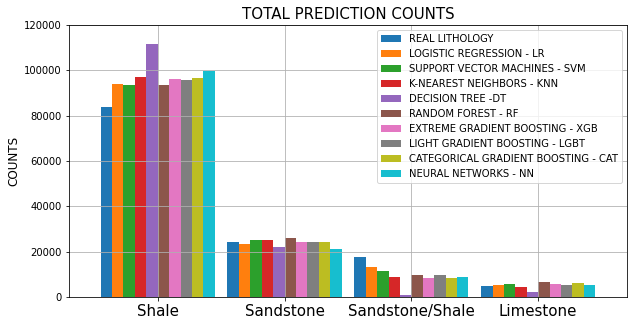

In [ ]:
ax = pd.DataFrame(total_count)[0:4].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNTS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.legend(fontsize=10)
plt.ylim(0, 120000)
plt.grid(True)
plt.show()

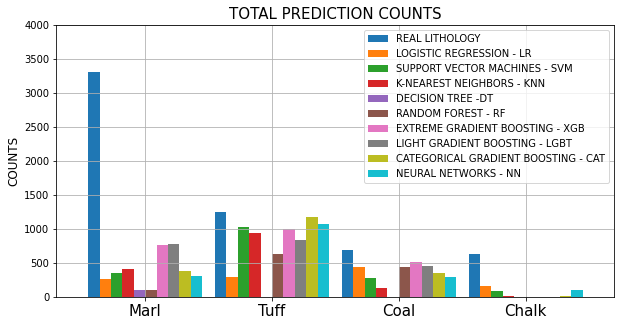

In [ ]:
ax = pd.DataFrame(total_count)[4:8].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNTS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0,4000)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

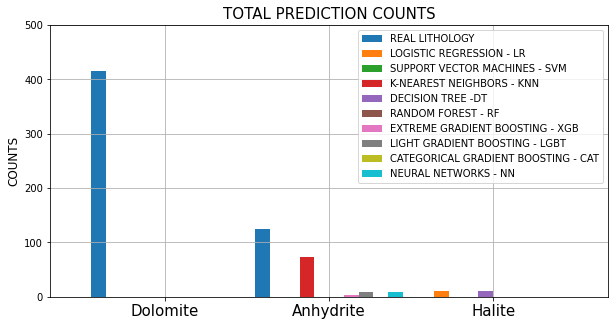

In [ ]:
ax = pd.DataFrame(total_count)[8:].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNTS', size=15)
ax.set_ylabel('COUNTS', size=12)
#ax.set_ylim(0,1500)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0,500)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

#### WRONG PREDICTIONS TEST SET

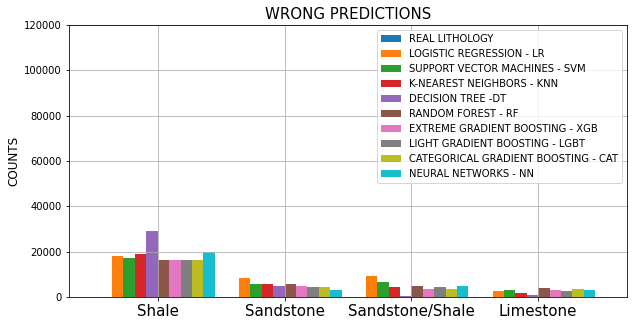

In [ ]:
test_lr1 = test_lr[test_lr.LITHO != test_lr.LR_TM]
test_svm1 = test_svm[test_svm.LITHO != test_svm.SVM_TM]
test_knn1 = test_knn[test_knn.LITHO != test_knn.KNN_TM]
test_dt1 = test_dt[test_dt.LITHO != test_dt.DT_PRU]
test_rf1 = test_rf[test_rf.LITHO != test_rf.RF_TM]
test_xgb1 = test_xgb[test_xgb.LITHO != test_xgb.XGB_TM]
test_lgbm1= test_lgbm[test_lgbm.LITHO != test_lgbm.LGBM_TM]
test_cat1 = test_cat[test_cat.LITHO != test_cat.KNN_NA]
test_nn1 = test_nn[test_nn.LITHO != test_nn.NN_TM]

lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

real_litho = dict(test_lr.LITHO.map(lithology_numbers2).value_counts())
lr_dic1 = dict(test_lr1.LR_TM.map(lithology_numbers2).value_counts())
svm_dic1 = dict(test_svm1.SVM_TM.map(lithology_numbers2).value_counts())
knn_dic1 = dict(test_knn1.KNN_TM.map(lithology_numbers2).value_counts())
dt_dic1 = dict(test_dt1.DT_PRU.map(lithology_numbers2).value_counts())
rf_dic1 = dict(test_rf1.RF_TM.map(lithology_numbers2).value_counts())
xgb_dic1 = dict(test_xgb1.XGB_TM.map(lithology_numbers2).value_counts())
lgbm_dic1 = dict(test_lgbm1.LGBM_TM.map(lithology_numbers2).value_counts())
cat_dic1 = dict(test_cat1.KNN_NA.map(lithology_numbers2).value_counts())
nn_dic1 = dict(test_nn1.NN_TM.map(lithology_numbers2).value_counts())

total_count1 = {'REAL LITHOLOGY': dict.fromkeys(real_litho, 0),
               'LOGISTIC REGRESSION - LR': lr_dic1,
               'SUPPORT VECTOR MACHINES - SVM': svm_dic1,
               'K-NEAREST NEIGHBORS - KNN': knn_dic1,
               'DECISION TREE -DT': dt_dic1,
               'RANDOM FOREST - RF': rf_dic1,
               'EXTREME GRADIENT BOOSTING - XGB': xgb_dic1,
               'LIGHT GRADIENT BOOSTING - LGBT': lgbm_dic1,
               'CATEGORICAL GRADIENT BOOSTING - CAT': cat_dic1,
               'NEURAL NETWORKS - NN': nn_dic1}

ax = pd.DataFrame(total_count1)[0:4].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0, 120000)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

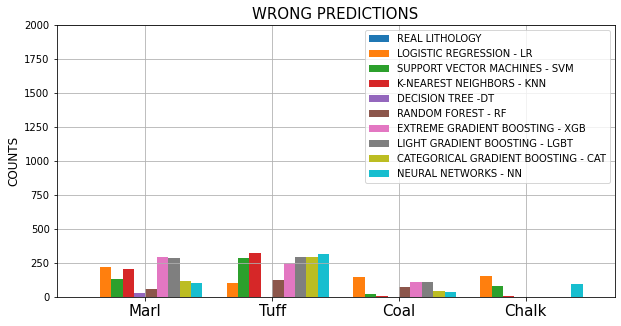

In [ ]:
ax = pd.DataFrame(total_count1)[4:8].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0,2000)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

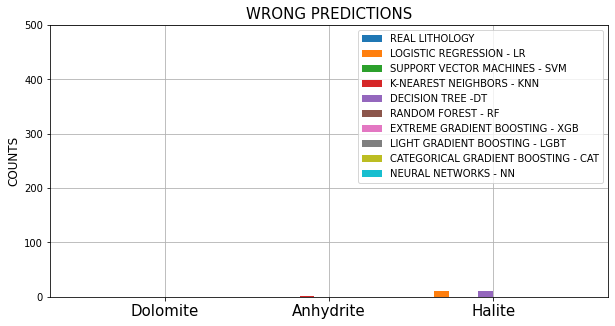

In [ ]:
ax = pd.DataFrame(total_count1)[8:].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0,500)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

### HIDDEN SET HISTOGRAMS

#### REPORT

In [ ]:
hidden_lr = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/hidden_lr_f_res.csv')
hidden_svm = pd.read_csv('/content/drive/MyDrive/Results_folder/SVM/hidden_svm_final_res.csv')
hidden_knn = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/hidden_knn_final_res.csv')
hidden_dt = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/hidden_dt_f_res.csv')
hidden_rf = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/hidden_rf_final_res.csv')
hidden_xgb = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/hidden_xgb_final_res.csv')
hidden_lgbm = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/hidden_light_f_res.csv')
hidden_cat = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/hidden_cat_f_res.csv')
hidden_nn = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/hidden_nn_final_res.csv')

In [ ]:
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
model_names = ['Logistic Regression', 'Support Vector Machines', 'K-Nearest Neighbors',
               'Decision Tree', 'Random Forest', 'Extreme Boosting', 'Light Boosting', 'Categorical Boosting', 'Neural Networks']
hidden_frames = [hidden_lr.LR_TM, hidden_svm.SVM_TM, hidden_knn.KNN_TM, 
                 hidden_dt.DT_PRU, hidden_rf.RF_TM, hidden_xgb.XGB_TM, hidden_lgbm.LGBM_TM,
                 hidden_cat.KNN_NA, hidden_nn.NN_TM]
hidden_litho = hidden_lr.LITHO
hidden_scores = [score(hidden_litho.values, frame.values) for frame in hidden_frames]
hidden_accuracies = [accuracy_score(hidden_litho.values, frame.values)*100 for frame in hidden_frames]
hidden_precisions = [precision_score(hidden_litho.values, frame.values, average='weighted')*100 for frame in hidden_frames]
hidden_recalls = [recall_score(hidden_litho.values, frame.values, average='weighted')*100 for frame in hidden_frames]
hidden_f1s = [f1_score(hidden_litho.values, frame.values, average='weighted')*100 for frame in hidden_frames]

pd.set_option('display.float_format', lambda x: '%.2f' % x)
hidden_results = pd.DataFrame({'Algorithm': model_names,
                               'Accuracy': hidden_accuracies,
                               'Precision': hidden_precisions,
                               'Recall': hidden_recalls,
                               'F1 score': hidden_f1s,
                               'Matrix score': hidden_scores})
hidden_results.sort_values(by='Accuracy', ascending=False)

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



,Algorithm,Accuracy,Precision,Recall,F1 score,Matrix score
5,Extreme Boosting,82.52,81.54,82.52,81.74,-0.43
7,Categorical Boosting,81.38,80.16,81.38,80.36,-0.45
6,Light Boosting,80.39,79.01,80.39,79.00,-0.48
4,Random Forest,79.82,77.29,79.82,77.56,-0.50
1,Support Vector Machines,79.08,76.86,79.08,77.16,-0.54
2,K-Nearest Neighbors,78.22,76.31,78.22,76.41,-0.56
8,Neural Networks,77.41,74.61,77.41,74.99,-0.56
0,Logistic Regression,75.06,71.44,75.06,72.42,-0.64
3,Decision Tree,74.59,70.40,74.59,68.54,-0.67


#### TOTAL PREDICTIONS

In [ ]:
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

real_litho2 = dict(hidden_lr.LITHO.map(lithology_numbers2).value_counts())
lr_dic2 = dict(hidden_lr.LR_TM.map(lithology_numbers2).value_counts())
svm_dic2 = dict(hidden_svm.SVM_TM.map(lithology_numbers2).value_counts())
knn_dic2 = dict(hidden_knn.KNN_TM.map(lithology_numbers2).value_counts())
dt_dic2 = dict(hidden_dt.DT_PRU.map(lithology_numbers2).value_counts())
rf_dic2 = dict(hidden_rf.RF_TM.map(lithology_numbers2).value_counts())
xgb_dic2 = dict(hidden_xgb.XGB_TM.map(lithology_numbers2).value_counts())
lgbm_dic2 = dict(hidden_lgbm.LGBM_TM.map(lithology_numbers2).value_counts())
cat_dic2 = dict(hidden_cat.KNN_NA.map(lithology_numbers2).value_counts())
nn_dic2 = dict(hidden_nn.NN_TM.map(lithology_numbers2).value_counts())

total_count = {'REAL LITHOLOGY': real_litho2,
               'LOGISTIC REGRESSION - LR': lr_dic2,
               'SUPPORT VECTOR MACHINES - SVM': svm_dic2,
               'K-NEAREST NEIGHBORS - KNN': knn_dic2,
               'DECISION TREE -DT': dt_dic2,
               'RANDOM FOREST - RF': rf_dic2,
               'EXTREME GRADIENT BOOSTING - XGB': xgb_dic2,
               'LIGHT GRADIENT BOOSTING - LGBT': lgbm_dic2,
               'CATEGORICAL GRADIENT BOOSTING - CAT': cat_dic2,
               'NEURAL NETWORKS - NN': nn_dic2}

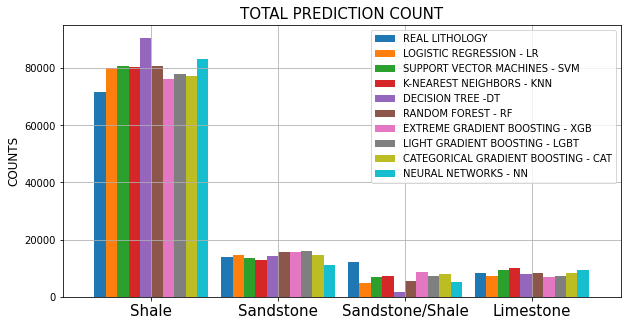

In [ ]:
ax = pd.DataFrame(total_count)[0:4].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNT', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

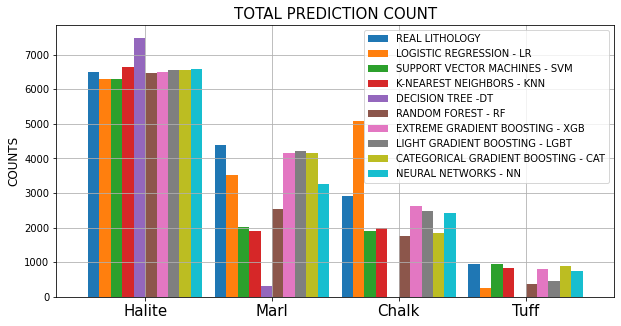

In [ ]:
ax = pd.DataFrame(total_count)[4:8].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNT', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

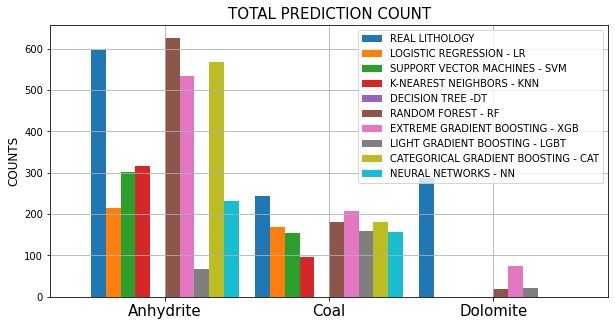

In [ ]:
ax = pd.DataFrame(total_count).reindex(['Shale', 'Sandstone', 'Sandstone/Shale', 
                                        'Limestone', 'Halite', 'Marl', 'Chalk', 
                                        'Tuff', 'Anhydrite', 'Coal', 'Dolomite'])[8:].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('TOTAL PREDICTION COUNT', size=15)
ax.set_ylabel('COUNTS', size=12)
#ax.set_ylim(0,1500)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

#### WRONG PREDICTIONS TEST SET

In [ ]:
hidden_lr1 = hidden_lr[hidden_lr.LITHO != hidden_lr.LR_TM]
hidden_svm1 = hidden_svm[hidden_svm.LITHO != hidden_svm.SVM_TM]
hidden_knn1 = hidden_knn[hidden_knn.LITHO != hidden_knn.KNN_TM]
hidden_dt1 = hidden_dt[hidden_dt.LITHO != hidden_dt.DT_PRU]
hidden_rf1 = hidden_rf[hidden_rf.LITHO != hidden_rf.RF_TM]
hidden_xgb1 = hidden_xgb[hidden_xgb.LITHO != hidden_xgb.XGB_TM]
hidden_lgbm1= hidden_lgbm[hidden_lgbm.LITHO != hidden_lgbm.LGBM_TM]
hidden_cat1 = hidden_cat[hidden_cat.LITHO != hidden_cat.KNN_NA]
hidden_nn1 = hidden_nn[hidden_nn.LITHO != hidden_nn.NN_TM]

lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

real_litho = dict(hidden_lr1.LITHO.map(lithology_numbers2).value_counts())
lr_dic1 = dict(hidden_lr1.LR_TM.map(lithology_numbers2).value_counts())
svm_dic1 = dict(hidden_svm1.SVM_TM.map(lithology_numbers2).value_counts())
knn_dic1 = dict(hidden_knn1.KNN_TM.map(lithology_numbers2).value_counts())
dt_dic1 = dict(hidden_dt1.DT_PRU.map(lithology_numbers2).value_counts())
rf_dic1 = dict(hidden_rf1.RF_TM.map(lithology_numbers2).value_counts())
xgb_dic1 = dict(hidden_xgb1.XGB_TM.map(lithology_numbers2).value_counts())
lgbm_dic1 = dict(hidden_lgbm1.LGBM_TM.map(lithology_numbers2).value_counts())
cat_dic1 = dict(hidden_cat1.KNN_NA.map(lithology_numbers2).value_counts())
nn_dic1 = dict(hidden_nn1.NN_TM.map(lithology_numbers2).value_counts())

total_count2 = {'REAL LITHOLOGY': dict.fromkeys(real_litho, 0),
               'LOGISTIC REGRESSION - LR': lr_dic1,
               'SUPPORT VECTOR MACHINES - SVM': svm_dic1,
               'K-NEAREST NEIGHBORS - KNN': knn_dic1,
               'DECISION TREE -DT': dt_dic1,
               'RANDOM FOREST - RF': rf_dic1,
               'EXTREME GRADIENT BOOSTING - XGB': xgb_dic1,
               'LIGHT GRADIENT BOOSTING - LGBT': lgbm_dic1,
               'CATEGORICAL GRADIENT BOOSTING - CAT': cat_dic1,
               'NEURAL NETWORKS - NN': nn_dic1}


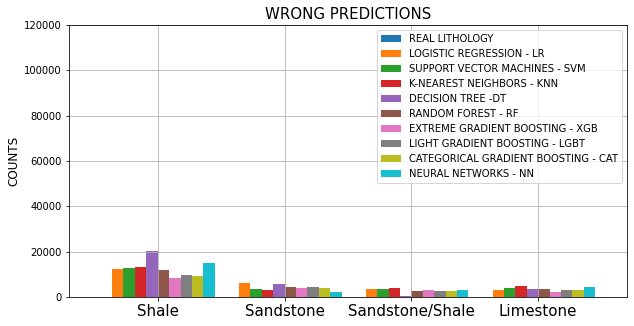

In [ ]:
ax = pd.DataFrame(total_count2).reindex(['Shale', 'Sandstone', 'Sandstone/Shale', 
                                        'Limestone'])[0:4].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0, 120000)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

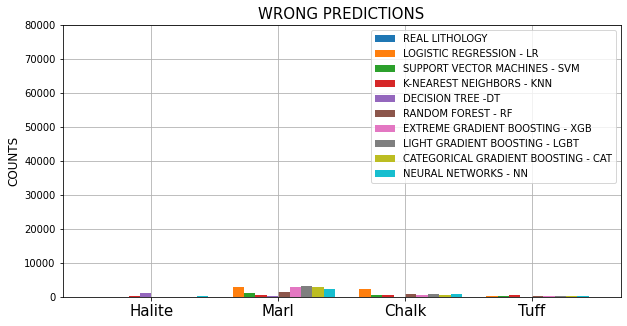

In [ ]:
ax = pd.DataFrame(total_count2).reindex(['Shale', 'Sandstone', 'Sandstone/Shale', 
                                        'Limestone', 'Halite', 'Marl', 'Chalk', 
                                        'Tuff', 'Anhydrite', 'Coal', 'Dolomite'])[4:8].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0, 80000)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

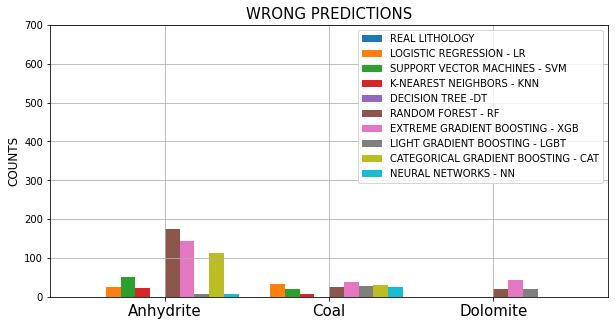

In [ ]:
ax = pd.DataFrame(total_count2).reindex(['Shale', 'Sandstone', 'Sandstone/Shale', 
                                        'Limestone', 'Halite', 'Marl', 'Chalk', 
                                        'Tuff', 'Anhydrite', 'Coal', 'Dolomite'])[8:].plot(kind='bar', figsize=(10,5), legend=True, width=0.9)
ax.set_title('WRONG PREDICTIONS', size=15)
ax.set_ylabel('COUNTS', size=12)
plt.xticks(size=15, rotation=0)
#for p in ax.patches:
#    ax.annotate(str(p.get_height()), (p.get_x(), p.get_height()), size=10)
plt.ylim(0, 700)
plt.legend(fontsize=10)
plt.grid(True)
plt.show()

## **12. PLOTTING ALL MODELS TOGETHER**

In [ ]:
test_lr = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/test_lr_f_res.csv')
test_svm = pd.read_csv('/content/drive/MyDrive/Results_folder/SVM/test_svm_final_res.csv')
test_knn = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/test_knn_final_res.csv')
test_dt = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/test_dt_f_res.csv')
test_rf = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/tes_rf_final_res.csv')
test_xgb = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/test_xgb_final_res.csv')
test_lgbm = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/tes_light_f_res.csv')
test_cat = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/tes_cat_f_res.csv')
test_nn = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/tes_nn_final_res.csv')

In [ ]:
all_models = test_data.copy()
all_models['LR'] = test_lr.LR_TM; all_models['SVM'] = test_svm.SVM_TM; all_models['KNN'] = test_knn.KNN_TM; 
all_models['DT'] = test_dt.DT_PRU; all_models['RF'] = test_rf.RF_TM; all_models['XGB'] = test_xgb.XGB_TM;
all_models['LGBM'] = test_lgbm.LGBM_TM; all_models['CAT'] = test_cat.KNN_NA; all_models['NN'] = test_nn.NN_TM

all_models_final = all_models[['WELL', 'DEPTH_MD', 'GR', 'DTC', 'NPHI', 'RHOB', 'RDEP', 'DTS', 'CALI',
                              'LR', 'SVM', 'KNN', 'DT', 'RF', 'XGB', 'LGBM', 'CAT', 'NN', 'LITHO']]

In [ ]:
all_models_final = all_models_final[all_models_final.RDEP < 40][all_models_final.GR<250]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [ ]:
#Printing accuracy scores per wel
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score
well_names = all_models_final.WELL.unique()

score_i = [accuracy_score(all_models_final[all_models_final.WELL == well].LITHO.values, all_models_final[all_models_final.WELL == well].XGB.values) for well in well_names]
recall_i = [recall_score(all_models_final[all_models_final.WELL == well].LITHO.values, all_models_final[all_models_final.WELL == well].XGB.values, average='weighted') for well in well_names]
precc_i = [precision_score(all_models_final[all_models_final.WELL == well].LITHO.values, all_models_final[all_models_final.WELL == well].XGB.values, average='weighted') for well in well_names]
f1_i = [f1_score(all_models_final[all_models_final.WELL == well].LITHO.values, all_models_final[all_models_final.WELL == well].XGB.values, average='weighted') for well in well_names]
matrix_i = [score(all_models_final[all_models_final.WELL == well].LITHO.values, all_models_final[all_models_final.WELL == well].XGB.values) for well in well_names]

test_well_df = pd.DataFrame({'well': well_names,
                             'Cluster': well_names,
                             'accuracy': score_i,
                            'recall': recall_i,
                            'prec': precc_i,
                            'f1_score': f1_i,
                             'matrix_score': matrix_i}).sort_values('accuracy', ascending=False)
test_well_df['Cluster'] = test_well_df['Cluster'].map(clust_map)
test_well_df

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



,well,Cluster,accuracy,recall,prec,f1_score,matrix_score
6,34/3-3 A,2,0.94,0.94,0.92,0.93,-0.16
3,25/5-3,0,0.88,0.88,0.86,0.86,-0.32
4,29/3-1,2,0.85,0.85,0.84,0.84,-0.40
5,34/10-16 R,2,0.85,0.85,0.83,0.83,-0.38
1,25/10-10,0,0.83,0.83,0.82,0.81,-0.54
8,35/6-2 S,1,0.74,0.74,0.69,0.70,-0.69
7,34/6-1 S,2,0.72,0.72,0.74,0.72,-0.67
2,25/11-24,0,0.70,0.70,0.70,0.60,-0.99
9,35/9-8,1,0.66,0.66,0.63,0.63,-0.85
0,15/9-14,0,0.57,0.57,0.55,0.46,-1.02


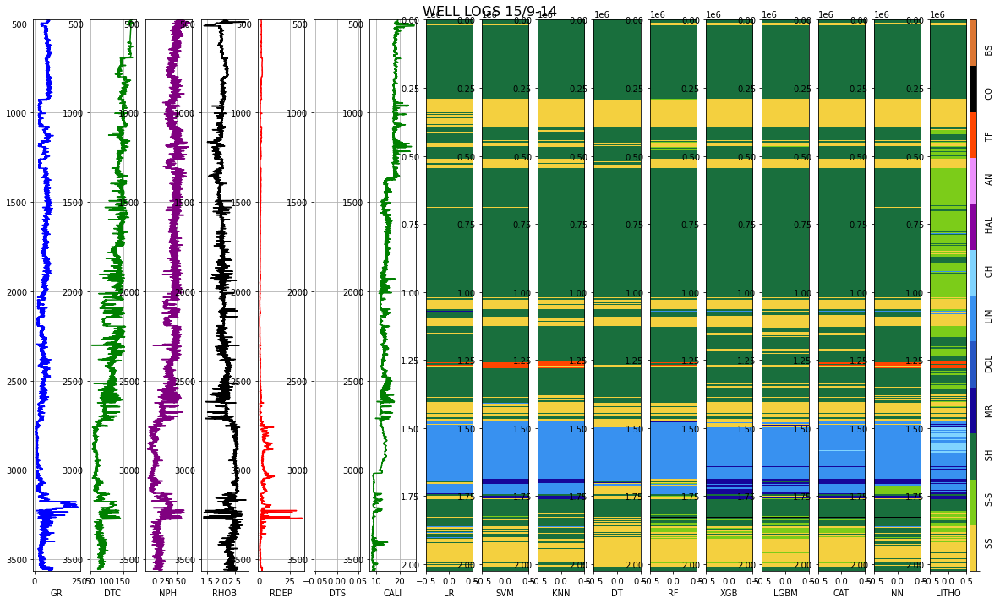

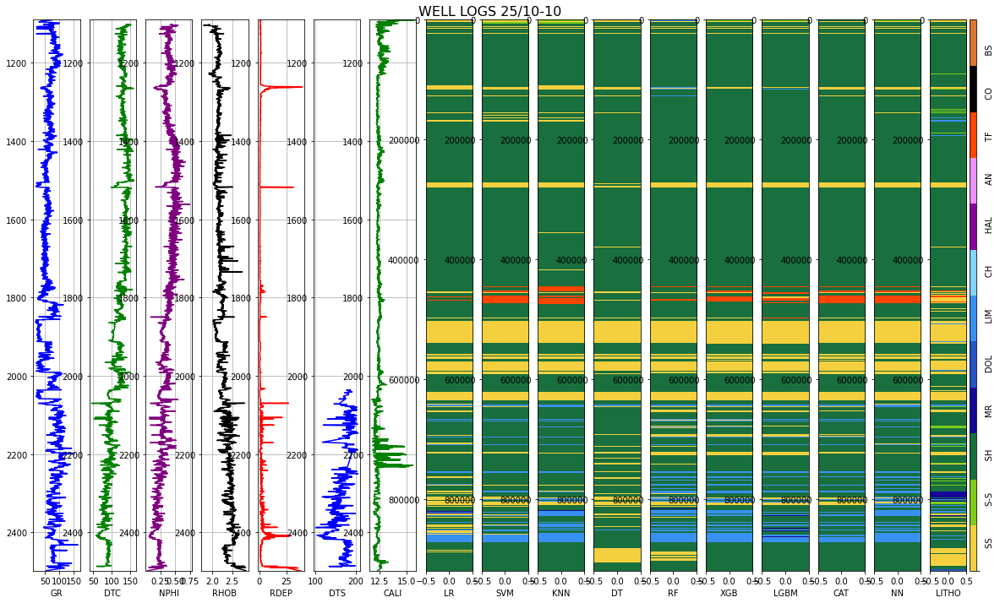

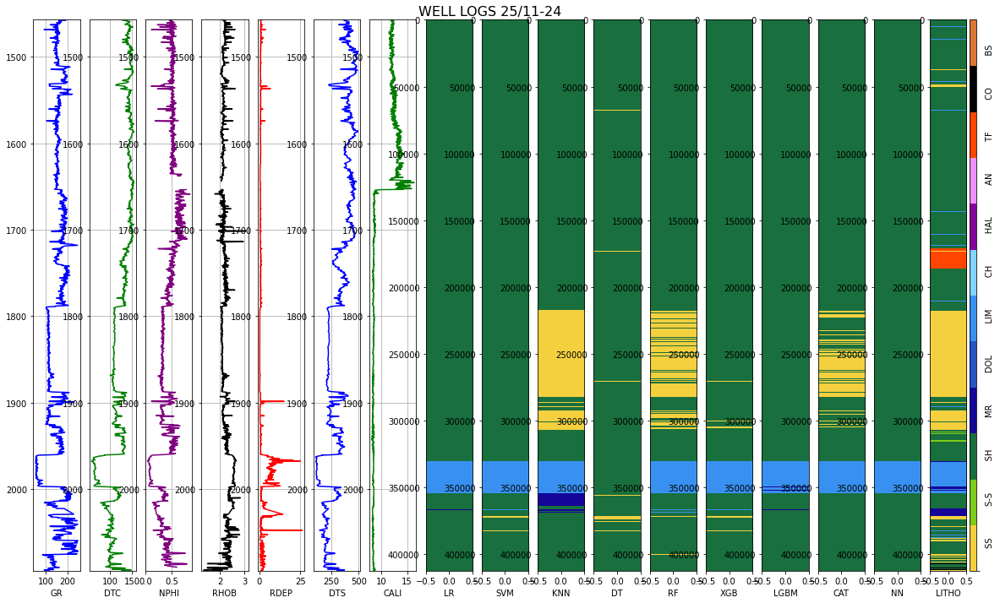

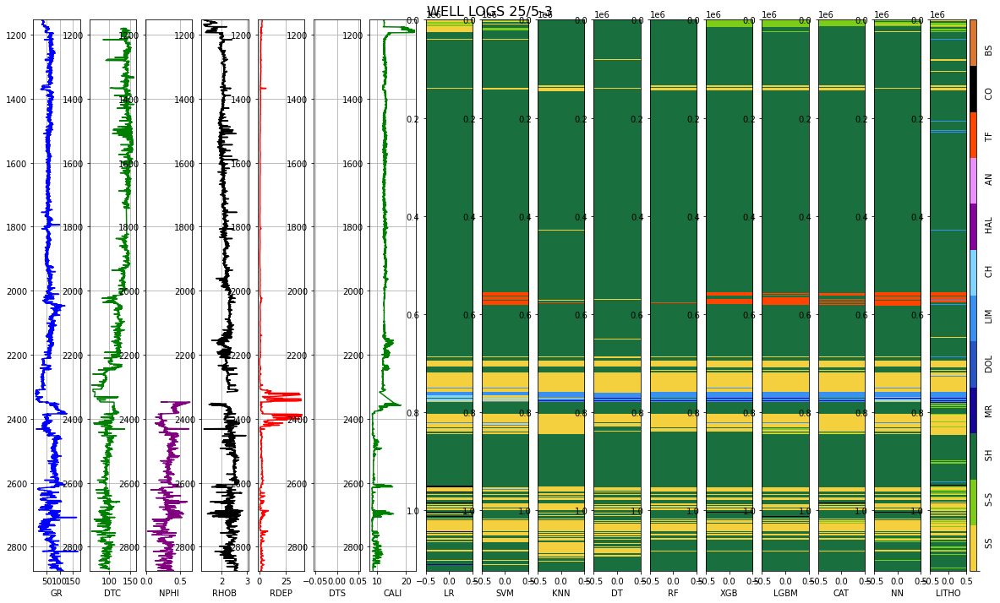

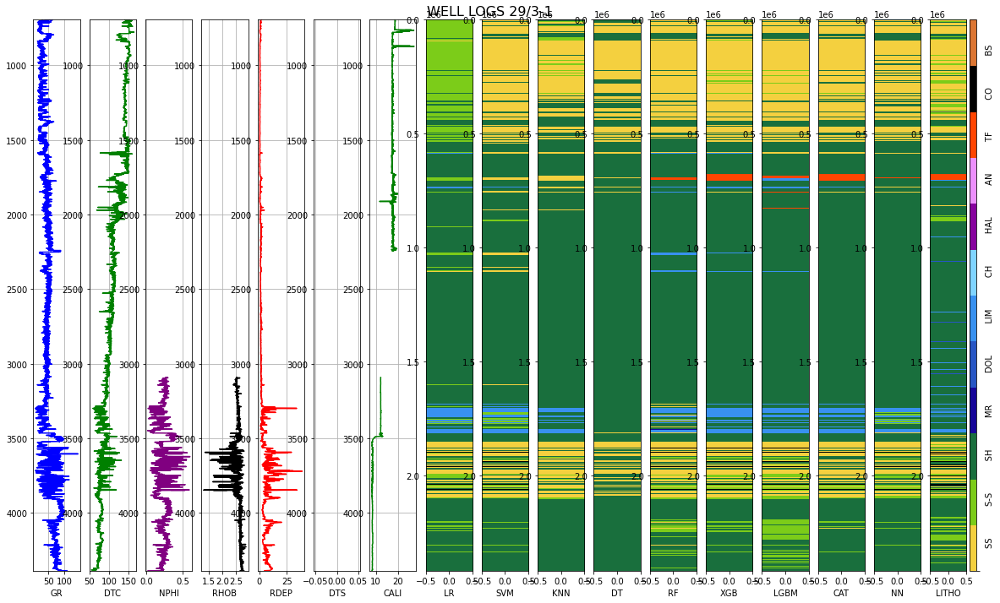

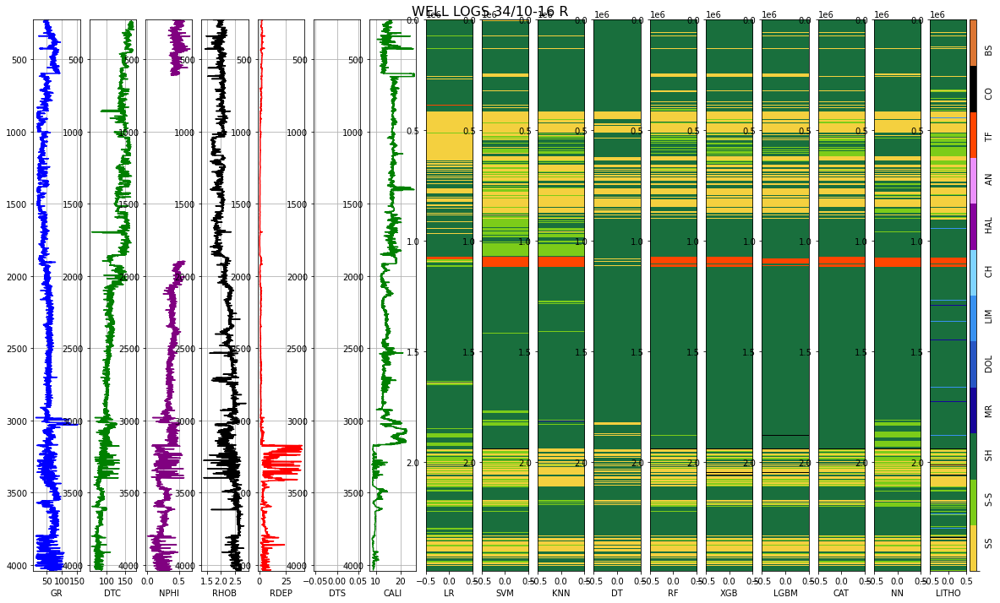

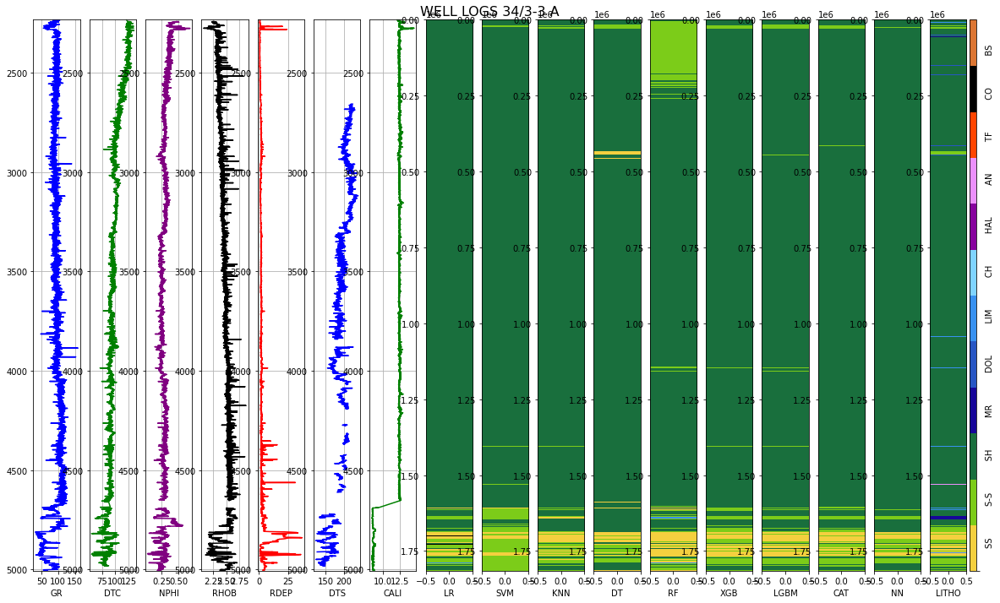

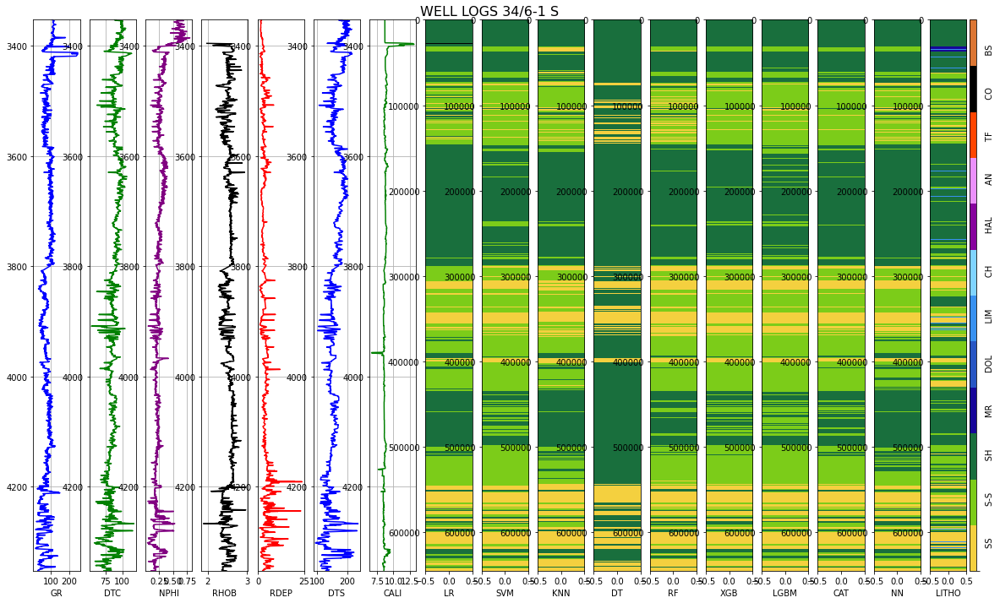

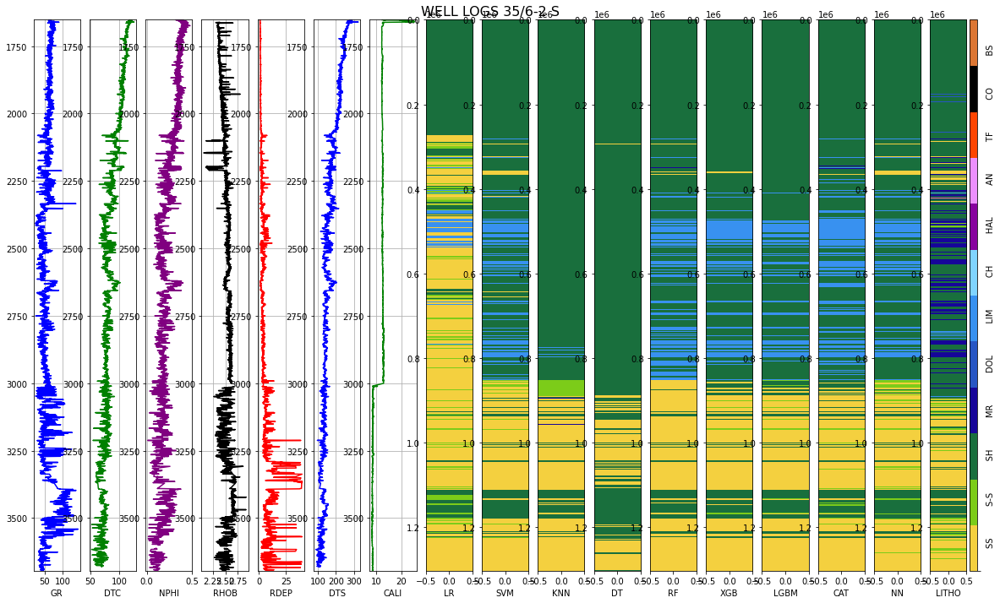

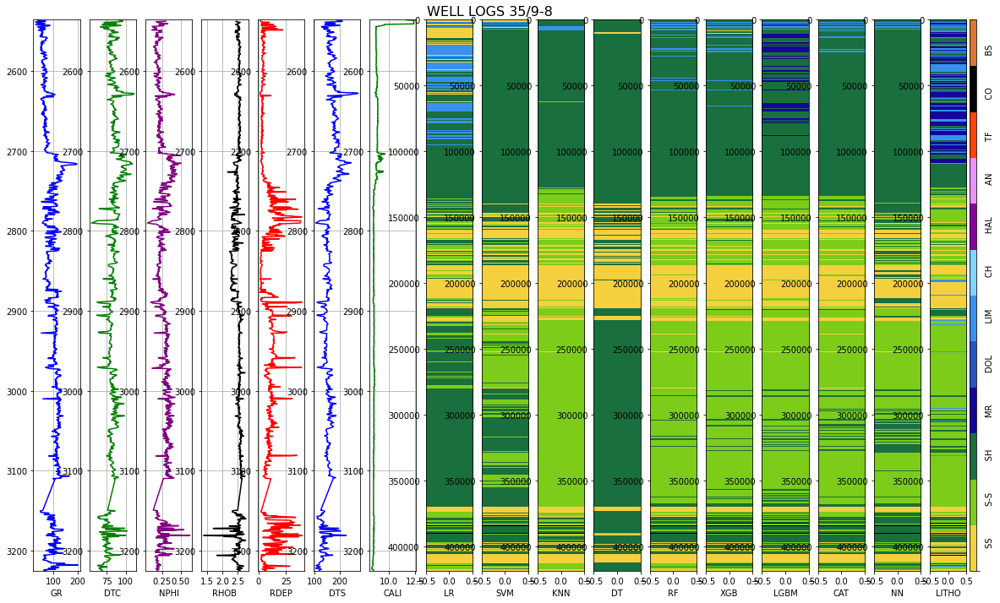

In [ ]:
for i in range(10):
  all_models_plot(all_models_final, i, facies_colors, 9)

In [ ]:
hidden_lr = pd.read_csv('/content/drive/MyDrive/Results_folder/Logistic_Regression/hidden_lr_f_res.csv')
hidden_svm = pd.read_csv('/content/drive/MyDrive/Results_folder/SVM/hidden_svm_final_res.csv')
hidden_knn = pd.read_csv('/content/drive/MyDrive/Results_folder/KNN/hidden_knn_final_res.csv')
hidden_dt = pd.read_csv('/content/drive/MyDrive/Results_folder/DT/hidden_dt_f_res.csv')
hidden_rf = pd.read_csv('/content/drive/MyDrive/Results_folder/RF/hidden_rf_final_res.csv')
hidden_xgb = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/hidden_xgb_final_res.csv')
hidden_lgbm = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/hidden_light_f_res.csv')
hidden_cat = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/hidden_cat_f_res.csv')
hidden_nn = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/hidden_nn_final_res.csv')

In [ ]:
all_models_hidden = hidden_data.copy()
all_models_hidden['LR'] = hidden_lr.LR_TM; all_models_hidden['SVM'] = hidden_svm.SVM_TM; all_models_hidden['KNN'] = hidden_knn.KNN_TM; 
all_models_hidden['DT'] = hidden_dt.DT_PRU; all_models_hidden['RF'] = hidden_rf.RF_TM; all_models_hidden['XGB'] = hidden_xgb.XGB_TM;
all_models_hidden['LGBM'] = hidden_lgbm.LGBM_TM; all_models_hidden['CAT'] = hidden_cat.KNN_NA; all_models_hidden['NN'] = hidden_nn.NN_TM

all_models_hidden_f = all_models_hidden[['WELL', 'DEPTH_MD', 'GR', 'DTC', 'NPHI', 'RHOB', 'RDEP', 'DTS', 'CALI',
                                        'LR', 'SVM', 'KNN', 'DT', 'RF', 'XGB', 'LGBM', 'CAT', 'NN', 'LITHO']]

In [ ]:
all_models_hidden_f = all_models_hidden_f[all_models_hidden_f.RDEP < 40][all_models_hidden_f.GR<250]

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: UserWarning:

Boolean Series key will be reindexed to match DataFrame index.



In [ ]:
#Printing accuracy scores per wel
from sklearn.metrics import accuracy_score, recall_score, f1_score, precision_score
well_names = all_models_hidden_f.WELL.unique()

score_i = [accuracy_score(all_models_hidden_f[all_models_hidden_f.WELL == well].LITHO.values, all_models_hidden_f[all_models_hidden_f.WELL == well].XGB.values) for well in well_names]
recall_i = [recall_score(all_models_hidden_f[all_models_hidden_f.WELL == well].LITHO.values, all_models_hidden_f[all_models_hidden_f.WELL == well].XGB.values, average='weighted') for well in well_names]
precc_i = [precision_score(all_models_hidden_f[all_models_hidden_f.WELL == well].LITHO.values, all_models_hidden_f[all_models_hidden_f.WELL == well].XGB.values, average='weighted') for well in well_names]
f1_i = [f1_score(all_models_hidden_f[all_models_hidden_f.WELL == well].LITHO.values, all_models_hidden_f[all_models_hidden_f.WELL == well].XGB.values, average='weighted') for well in well_names]
matrix_i = [score(all_models_hidden_f[all_models_hidden_f.WELL == well].LITHO.values, all_models_hidden_f[all_models_hidden_f.WELL == well].XGB.values) for well in well_names]

test_well_df = pd.DataFrame({'well': well_names,
                             'Cluster': well_names,
                             'accuracy': score_i,
                            'recall': recall_i,
                            'prec': precc_i,
                            'f1_score': f1_i,
                            'matrix_score': matrix_i}).sort_values('accuracy', ascending=False)
test_well_df['Cluster'] = test_well_df['Cluster'].map(clust_map)
test_well_df

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall is ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



,well,Cluster,accuracy,recall,prec,f1_score,matrix_score
7,34/3-2 S,2,0.90,0.90,0.85,0.87,-0.27
5,31/2-10,1,0.89,0.89,0.90,0.89,-0.31
8,35/11-5,1,0.86,0.86,0.84,0.84,-0.34
6,31/2-21 S,1,0.83,0.83,0.82,0.83,-0.41
2,16/7-6,0,0.83,0.83,0.76,0.79,-0.40
9,35/9-7,1,0.82,0.82,0.77,0.79,-0.48
0,15/9-23,0,0.82,0.82,0.81,0.77,-0.42
1,16/2-7,0,0.81,0.81,0.80,0.80,-0.50
4,25/10-9,0,0.79,0.79,0.75,0.76,-0.56
3,17/4-1,0,0.61,0.61,0.71,0.63,-0.90


In [ ]:
def all_models_plot2(logs, well_num, facies_colors, n_pred):
    wells = logs['WELL'].unique()
    logs = logs[logs['WELL'] == wells[well_num]]
    logs = logs.sort_values(by='DEPTH_MD')        #Sorting log by depth
    cmap_facies = colors.ListedColormap(facies_colors[0:len(facies_colors)], 'indexed')
    
    top = logs.DEPTH_MD.min()
    bot = logs.DEPTH_MD.max()
       
    f, ax = plt.subplots(nrows=1, ncols=(8+n_pred), figsize=(20, 12))
    log_colors = ['black', 'red', 'blue', 'green', 'purple','black', 'red', 'blue', 'green', 'purple', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black', 'black', 'red', 'blue', 'green', 'purple', 'black']

    for i in range(2,9):
      ax[i-2].plot(logs.iloc[:,i], logs.DEPTH_MD, color=log_colors[i])
      ax[i-2].set_ylim(top, bot)
      #ax[i-2].set_xlim(logs.iloc[:,i].min(), logs.iloc[:,i].max())

      ax[i-2].set_xlabel(str(logs.columns[i]))
      ax[i-2].invert_yaxis()
      ax[i-2].grid()

    for j in range((-1-n_pred), 0):
      label = np.repeat(np.expand_dims(logs.iloc[:,j].values, 1), 100, 0)
      im = ax[j].imshow(label, interpolation='none', aspect='auto', cmap=cmap_facies, vmin=0, vmax=12)
      ax[j].set_xlabel(str(logs.columns[j]))

    divider = make_axes_locatable(ax[-1])
    cax = divider.append_axes("right", size="20%", pad=0.05)
    cbar=plt.colorbar(im, cax=cax)
    cbar.set_label((12*' ').join(['SS', 'S-S', 'SH', 'MR', 'DOL','LIM', 'CH','HAL', 'AN', 'TF', 'CO', 'BS']))
    cbar.set_ticks(range(0,1)); cbar.set_ticklabels('')
        
    f.suptitle('WELL LOGS '+str(wells[well_num]), fontsize=14,y=0.94)


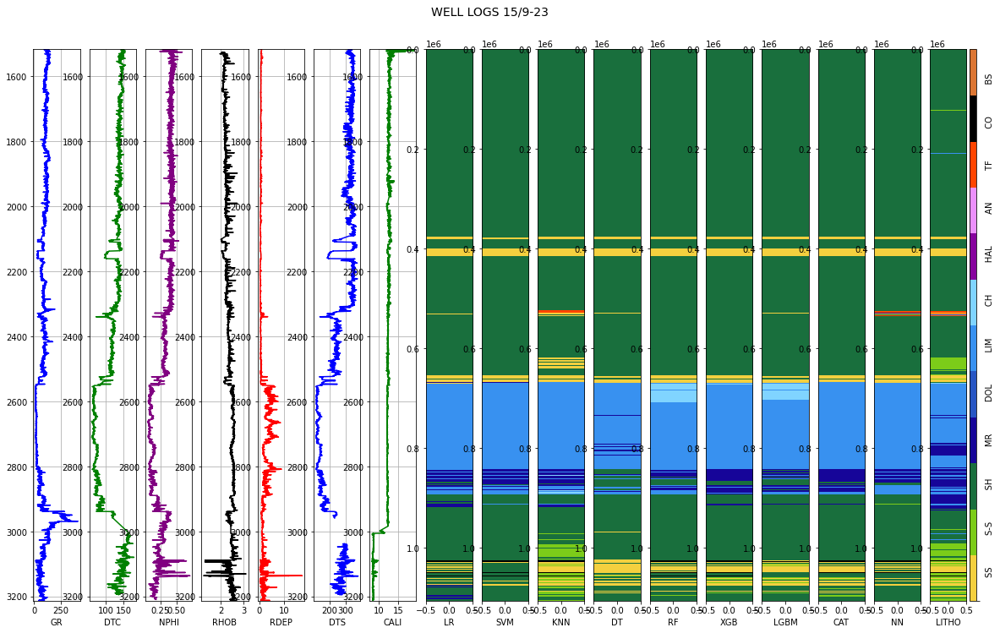

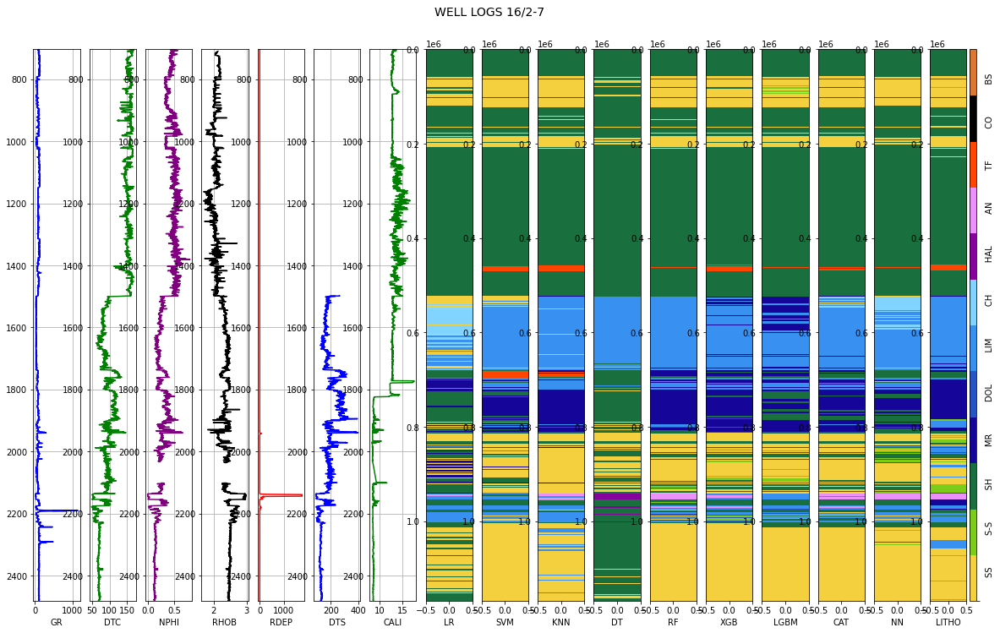

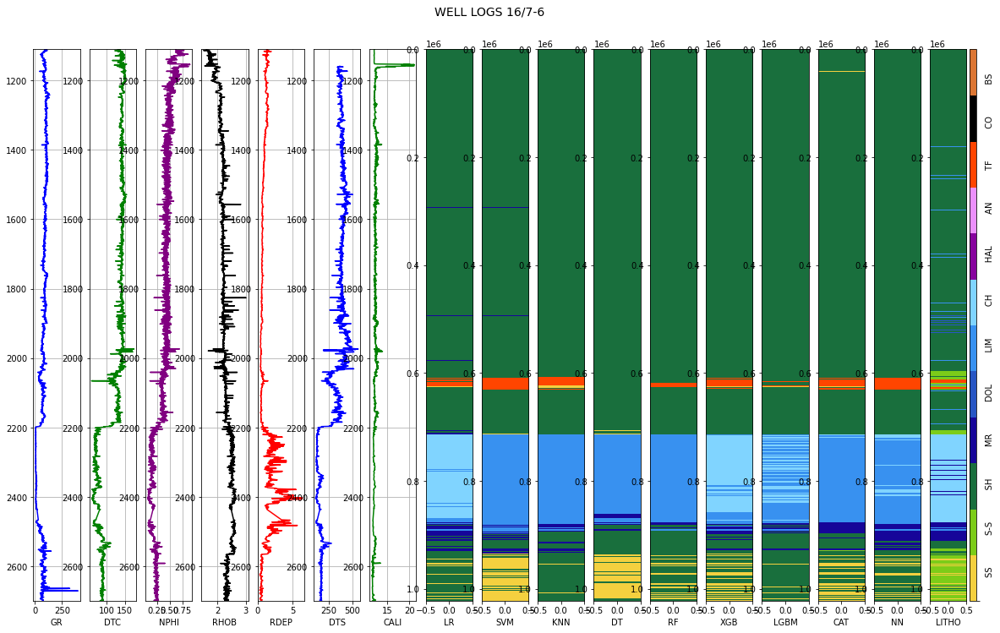

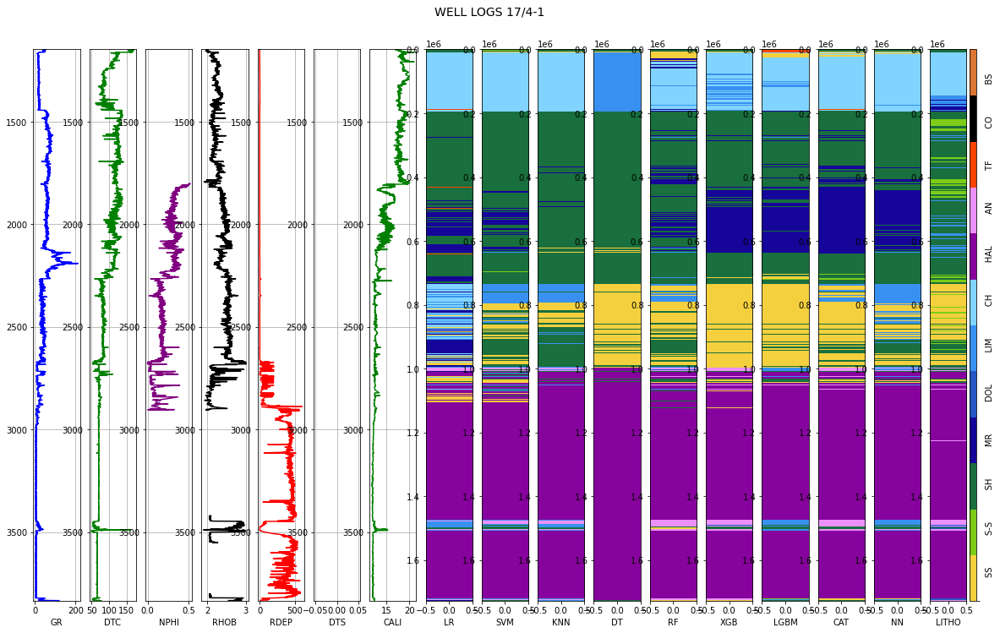

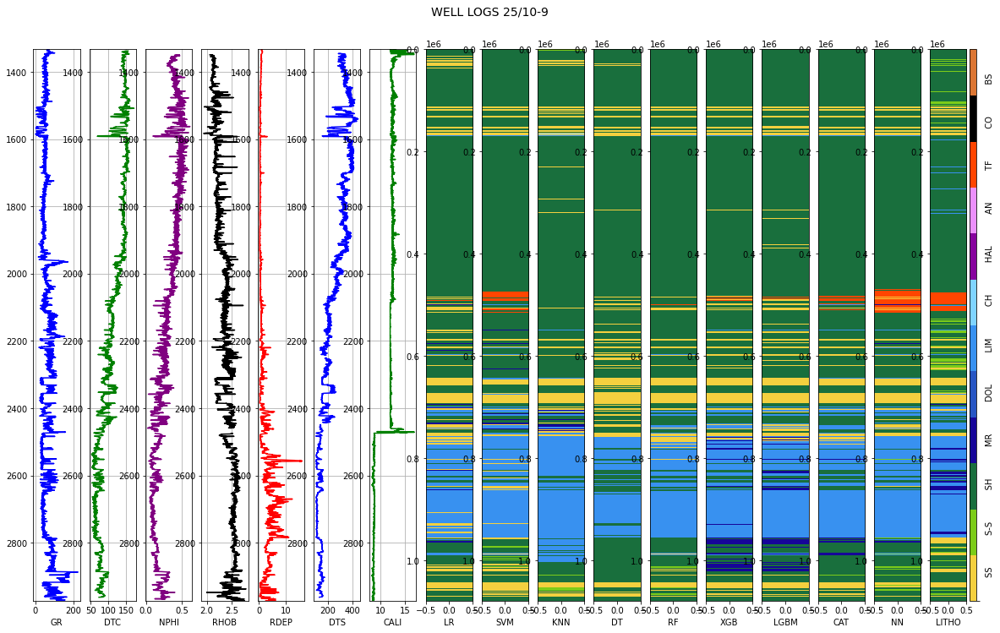

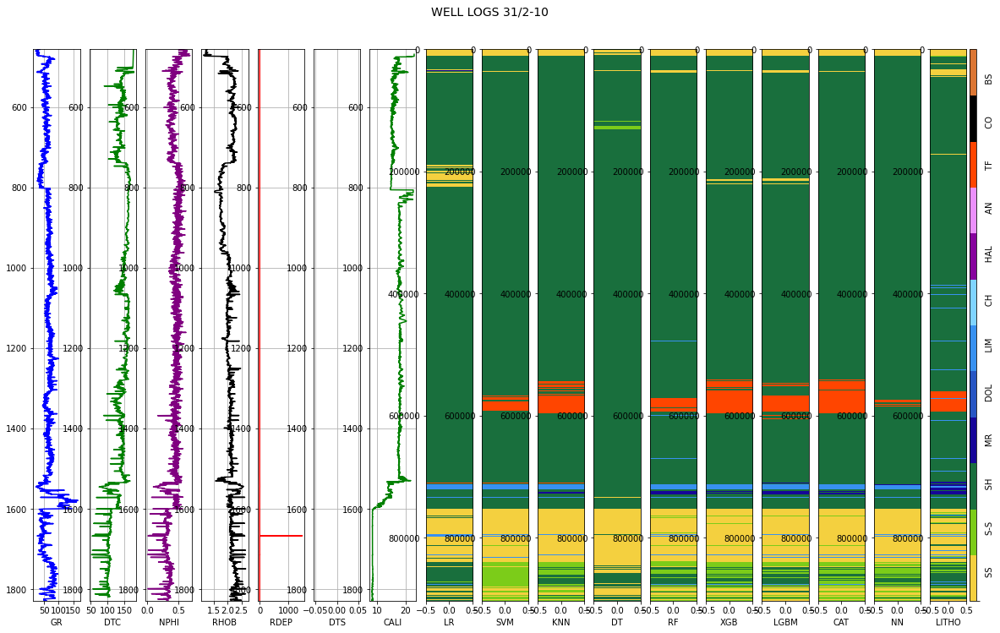

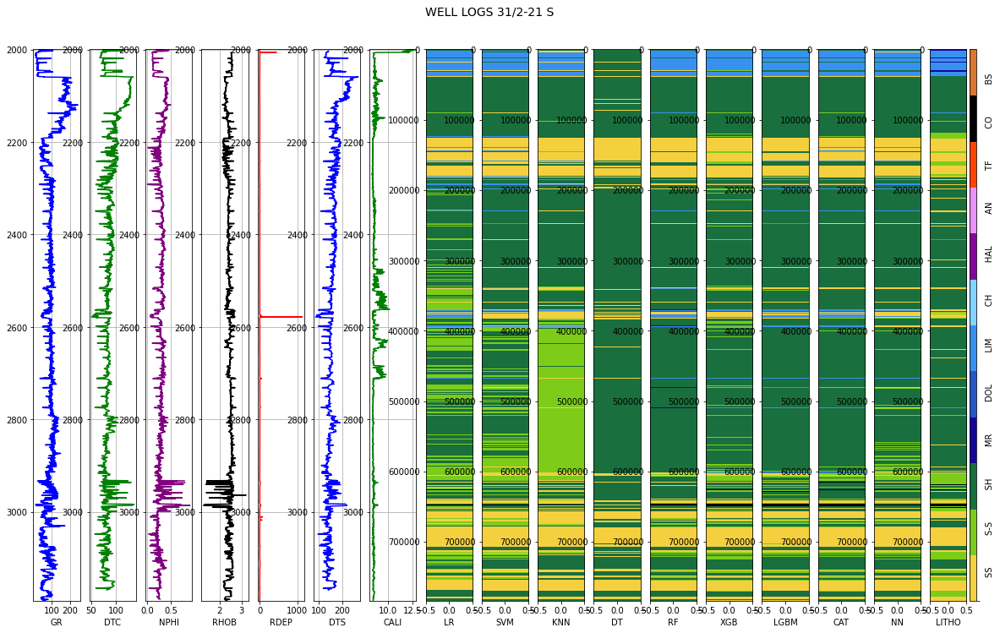

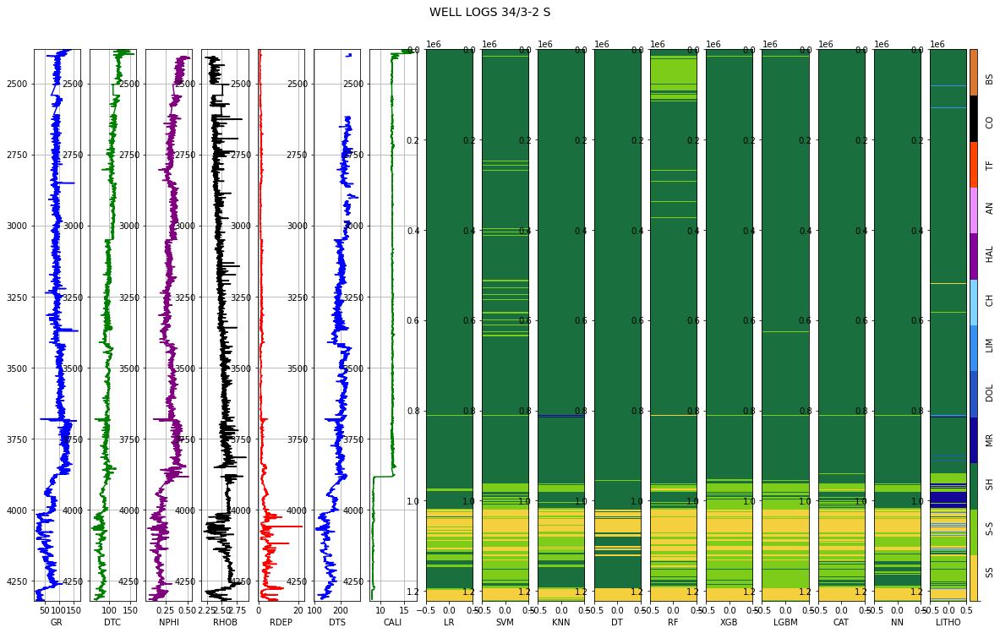

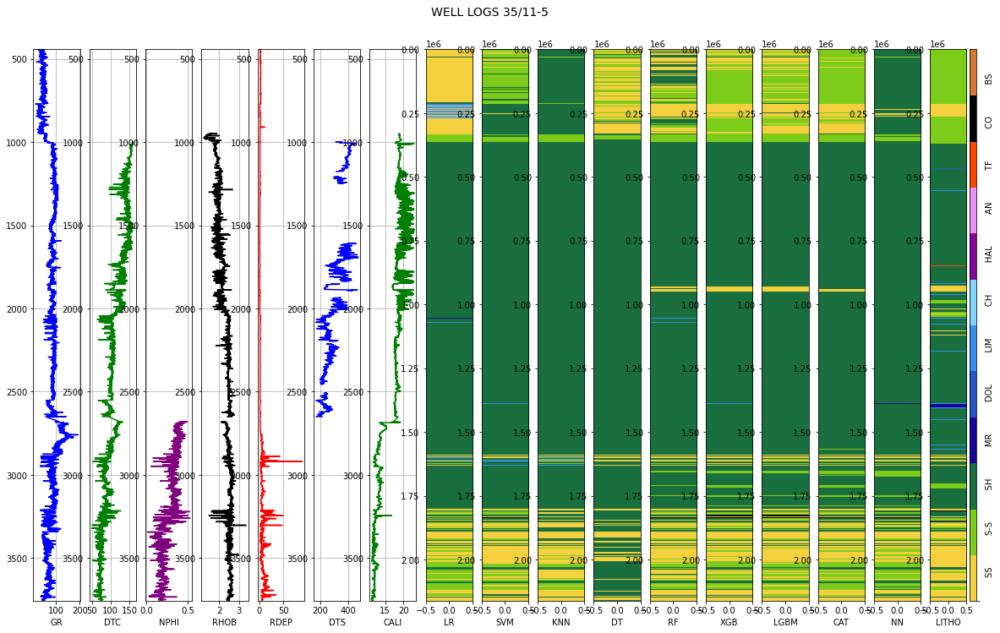

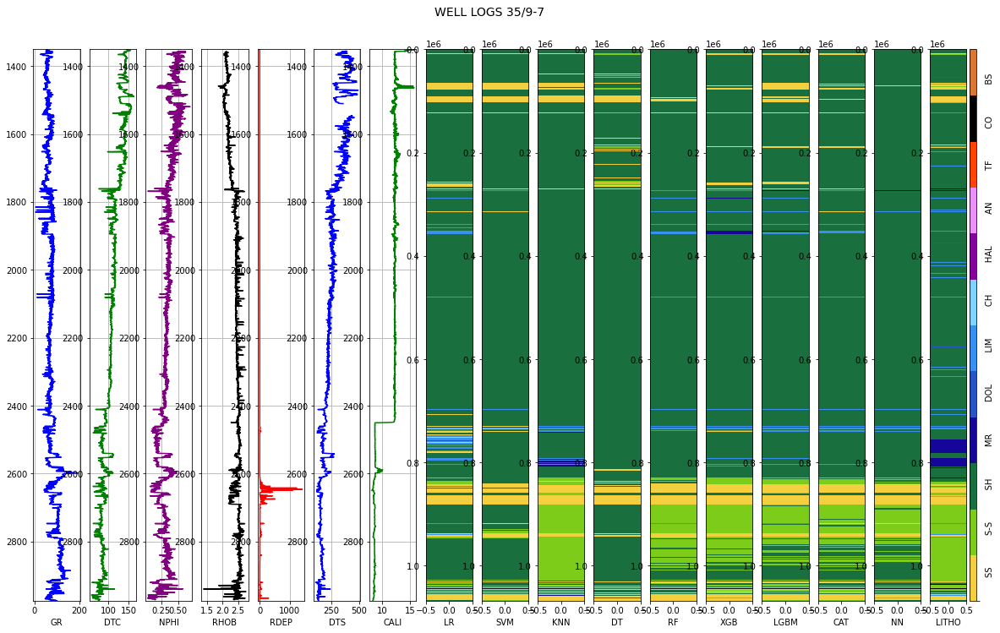

In [ ]:
for i in range(0,10):
  all_models_plot2(all_models_hidden_f, i, facies_colors, 9)

## **EXTRA1. POSTPROCESSING BASED ON XGB PROBABILITIES OUTPUTS**

In [ ]:
df_prob = pd.read_csv('/content/drive/MyDrive/prob_preddictions.csv')

Text(114.0, 0.5, 'True Label')

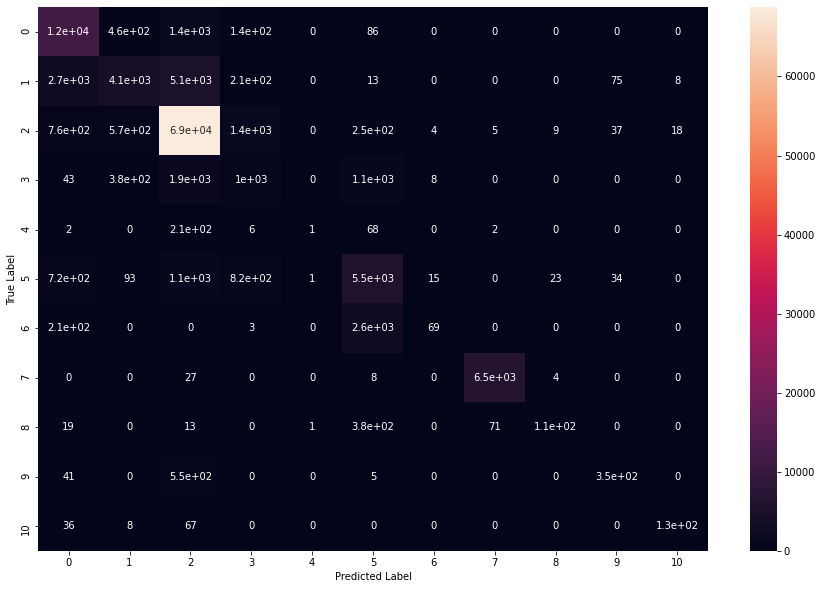

In [ ]:
## Initial Confusion Matrix 
#accuracy_confusion_matrix(xgbmodel_noarg, x_hidden, y_hidden)

cm = confusion_matrix(df_prob.Label, df_prob.Prediction)
plt.figure(figsize=(15,10))
sns.heatmap(cm, annot=True)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')

In [ ]:
#Filtering an vizualizing
df_lim = df_prob[(df_prob.Label == 0) & (df_prob.Prediction == 1)]
#df_lim

In [ ]:
#Checking data with ambiguity of 5%
probs = df_prob.values

ny = probs.shape[0]
nx = probs.shape[1]

counter = 0
target_predictions = []
target_iy = []
for iy in range(0, ny):
  l = probs[iy][3:].tolist()
  list_max = max(l)
  pred_ix = np.argmax(l)
  for ix in range(3, nx):
    diff = np.abs(list_max-probs[iy][ix])
    if diff < 0.05 and diff != 0 and probs[iy][1]!=probs[iy][2]:
      target_predictions.append(pred_ix)
      target_iy.append(iy)
      counter += 1
      #print('Uncertainity in {} between predicted {} and closest {} while real is {}'.format(iy, pred_ix, ix-3, probs[iy][1]))
print('Number of instances to be checked {}'.format(counter))

Number of instances to be checked 3790


In [ ]:
#Counting target prediction 

np.unique(target_predictions, return_counts=True)

(array([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10]),
 array([ 538,  499,  996,  288,    3, 1324,   12,   80,    6,   41,    3]))

In [ ]:
#Correcting probs function
new_probs = probs.copy()

N_neig = 3

new_preds = []
for iy_ch in target_iy:
  if iy_ch <= N_neig:     #Correcting initiasl value
    new_preds.append(probs[iy_ch][2])
  if iy_ch > N_neig and iy_ch < ny-N_neig:   #Avoiding the fist
    stacked_pred = np.zeros(nx-3)
    for i in range(iy_ch-N_neig, iy_ch+N_neig+1):     #Looping throught row
      stacked_pred += probs[i][3:]
      new_pred = np.argmax(stacked_pred)
      new_probs[iy_ch][2] = new_pred
    new_preds.append(new_pred)

In [ ]:
df_prob2 = pd.DataFrame(new_probs, columns=df_prob.columns)
#df_prob2

In [ ]:
def counting_wrong(data):
  predictions = data.Prediction
  true_label = data.Label
  counter = 0
  for i in range(len(predictions)):
    if predictions[i] != true_label[i]:
      counter += 1
  return counter

In [ ]:
counting_wrong(df_prob), counting_wrong(df_prob2)

(23941, 23251)

In [ ]:
accuracy_score(df_prob2.Label, df_prob2.Prediction)

0.810036193697558

In [ ]:
accuracy_score(df_prob.Label, df_prob.Prediction)

0.8043988006241983

In [ ]:
score(df_prob.Label, df_prob.Prediction)

-0.47552125460591355

In [ ]:
score(df_prob2.Label, df_prob2.Prediction)

-0.4613246239695417

## **EXTRA2. ADDITIONAL EXPERIMENTATION**

### TRYING STACKING METHODS BASED ON OTHER ALGORITHMS OUTPUTS

In [ ]:
#Importing train results
xgb_train = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/train_xgb_f_res.csv')
cat_train = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/train_cat_f_res.csv')
lgbm_train = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/train_light_f_res.csv')
nn_train = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/train_nn_f_res.csv')

#Importing test results
xgb_test = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/tes_xgb_f_res.csv')
cat_test = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/tes_cat_f_res.csv')
lgbm_test = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/tes_light_f_res.csv')
nn_test = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/tes_nn_f_res.csv')

#Importing hidden results
xgb_hidden = pd.read_csv('/content/drive/MyDrive/Results_folder/XGB/hidden_xgb_f_res.csv')
cat_hidden = pd.read_csv('/content/drive/MyDrive/Results_folder/CAT/hidden_cat_f_res.csv')
lgbm_hidden = pd.read_csv('/content/drive/MyDrive/Results_folder/LGBM/hidden_light_f_res.csv')
nn_hidden = pd.read_csv('/content/drive/MyDrive/Results_folder/NN/hidden_nn_f_res.csv')

In [ ]:
lgbm_train.LGBM_TM

0          2
1          2
2          2
3          2
4          2
          ..
1170506    2
1170507    2
1170508    2
1170509    2
1170510    0
Name: LGBM_TM, Length: 1170511, dtype: int64

In [ ]:
#Creating new datasets
train_new = pd.DataFrame({'XGB': xgb_train.XGB_TM,
                          'CAT': cat_train.KNN_NA,
                          'LGBM': lgbm_train.LGBM_TM,
                          'NN': nn_train.NN_TM,
                          'TRUE': xgb_train.LITHO.astype('category')})

test_new = pd.DataFrame({'XGB': xgb_test.XGB_TM,
                          'CAT': cat_test.KNN_NA,
                          'LGBM': lgbm_test.LGBM_TM,
                          'NN': nn_test.NN_TM,
                          'TRUE': xgb_test.LITHO.astype('category')})

hidden_new = pd.DataFrame({'XGB': xgb_hidden.XGB_TM,
                          'CAT': cat_hidden.KNN_NA,
                          'LGBM': lgbm_hidden.LGBM_TM,
                          'NN': nn_hidden.NN_TM,
                          'TRUE': xgb_hidden.LITHO.astype('category')})

In [ ]:
x_train_new = train_new.drop(['TRUE'], axis=1)
y_train_new = train_new['TRUE']

x_test_new = test_new.drop(['TRUE'], axis=1)
y_test_new = test_new['TRUE']

x_hidden_new = hidden_new.drop(['TRUE'], axis=1)
y_hidden_new = hidden_new['TRUE']

In [ ]:
#Tuned Model

xgb_tunned1 = XGBClassifier(n_estimators=1000, max_depth=4, booster='gbtree',
                          objective='multi:softprob', learning_rate=0.1, random_state=42,
                          subsample=1, colsample_bytree=1, tree_method='gpu_hist', 
                          predictor='gpu_predictor', verbose=2020, reg_lambda=1500)

xgb_tunned1.fit(x_train[selected_fetures_xgb], y_train, early_stopping_rounds=25, eval_set=[(x_test[selected_fetures_xgb], y_test)], verbose=100)


#Predicting
train_pred_xgb = xgb_tunned1.predict(x_train_new)
open_pred_xgb = xgb_tunned1.predict(x_test_new)
hidden_pred_xgb = xgb_tunned1.predict(x_hidden_new)

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_train_new.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(y_train_new, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test_new.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(y_test_new, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden_new.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(y_hidden_new, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.30327662448281134
Open set report:               precision    recall  f1-score   support

           0       0.85      0.84      0.85    168937
           1       0.80      0.64      0.71    150455
           2       0.91      0.97      0.94    720803
           3       0.84      0.76      0.80     33329
           4       0.69      0.17      0.27      1688
           5       0.86      0.68      0.76     56320
           6       0.92      0.93      0.93     10513
           7       0.99      0.99      0.99      8213
           8       0.93      0.91      0.92      1085
           9       0.86      0.88      0.87     15245
          10       0.83      0.66      0.74      3820
          11       0.98      0.94      0.96       103

    accuracy                           0.89   1170511
   macro avg       0.87      0.78      0.81   1170511
weighted avg       0.88      0.89      0.88   1170511

---

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.4633028178795232
Hidden set report:               precision    recall  f1-score   support

           0       0.73      0.83      0.78     14045
           1       0.65      0.38      0.48     12283
           2       0.87      0.95      0.91     71827
           3       0.22      0.21      0.21      4396
           4       0.00      0.00      0.00       287
           5       0.63      0.53      0.58      8374
           6       0.68      0.58      0.62      2905
           7       0.99      0.99      0.99      6498
           8       0.79      0.60      0.68       597
           9       0.72      0.35      0.47       941
          10       0.81      0.61      0.70       244

    accuracy                           0.81    122397
   macro avg       0.64      0.55      0.58    122397
weighted avg       0.79      0.81      0.79    122397



In [ ]:
#Model evaluation - prediction
loss, acc = model.evaluate(x_test, y_test, verbose=0)

In [ ]:
#Summarazing the results after each epoch

hist = pd.DataFrame(history.history)
hist['epoch'] = history.epoch
hist.tail()

In [ ]:
#Additional evaluation and statistics (Since the dataset is umbalanced -> F1 _score is a better metric)
from sklearn.metrics import classification_report

y_estimated = model.predict(x_test)
y_estimated = np.argmax(y_estimate, axis=1)
y_true = np.argmax(y_test, axis=1)
report = classification_report(y_true, y_estimated)
print(report)

In [ ]:
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

#Inspecting Data
for lit_to in traindata.LITHO.unique():
  fig, x = plt.subplots(figsize=(10, 8))
  sns.stripplot('Cluster', 'DTC', data=traindata[traindata.LITHO == lit_to], jitter=0.1 )
  plt.title(str(lit_to))
  plt.xticks(rotation=90)
  plt.grid(True)

### INTERPRETER SUBJECTIVITY ANALYSIS

In [ ]:
import pandas as pd

In [ ]:
## Test Data
overview_data = '/content/drive/MyDrive/Thesis_data/ML_WellOverview.csv'

overview = pd.read_csv(overview_data, sep=',').rename(columns={'Welbore':'WELL'})
overview.Interpreter.replace('ET ', 'ET', inplace=True)
#display(overview.head())

In [ ]:
overview['WELL_HEAD'] = overview.apply(lambda row: base_well_name(row), axis=1)
new_map = dict(zip(overview.WELL_HEAD, overview.Interpreter))

In [ ]:
selected_fetures_xgb = ['RDEP', 'GR', 'NPHI_COMB', 'GM', 'AI_P', 'DTC', 'DTS_COMB', 'RSHA',
                        'DT_R', 'RHOB', 'K', 'DCAL', 'Y_LOC', 'Cluster', 'GROUP_encoded',
                        'WELL_encoded', 'FORMATION_encoded', 'DEPTH_MD', 'Z_LOC', 'CALI', 'BS',
                        'X_LOC', 'RMED', 'PEF', 'SP', 'MD_TVD', 'RMIC', 'DRHO']#, 'LITHO']

In [ ]:
new_train = train_clean.copy()
new_train = new_train[selected_fetures_xgb]
new_train['WELL'] = labeled_data.WELL
new_train['WELL_HEAD'] = new_train.apply(lambda row: base_well_name(row), axis=1)
new_train['Interpreter'] = new_train.WELL_HEAD.map(new_map)

In [ ]:
new_train = new_train.dropna()

In [ ]:
new_test = test_clean.copy()
new_test = new_test[selected_fetures_xgb]
new_test['WELL'] = test_data.WELL
new_test['WELL_HEAD'] = new_test.apply(lambda row: base_well_name(row), axis=1)
new_test['Interpreter'] = new_test.WELL_HEAD.map(new_map)

new_hidden = hidden_clean.copy()
new_hidden = new_hidden[selected_fetures_xgb]
new_hidden['WELL'] = hidden_data.WELL
new_hidden['WELL_HEAD'] = new_hidden.apply(lambda row: base_well_name(row), axis=1)
new_hidden['Interpreter'] = new_hidden.WELL.map(new_map)

In [ ]:
new_hidden = new_hidden.dropna()

In [ ]:
new_train.Interpreter.value_counts()

SBH    678922
ET     240706
GL     154066
Name: Interpreter, dtype: int64

In [ ]:
new_test.Interpreter.value_counts()

SBH    94428
GL     24669
ET     17689
Name: Interpreter, dtype: int64

In [ ]:
new_hidden.Interpreter.value_counts()

SBH    48775
ET     32281
GL     21285
Name: Interpreter, dtype: int64

In [ ]:
#Spliting datasets by interpreter 

traindata_SHB = new_train[new_train.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
traindata_ET = new_train[new_train.Interpreter == 'ET'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
traindata_GL = new_train[new_train.Interpreter == 'GL'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)

testdata_SHB = new_test[new_test.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
testdata_ET = new_test[new_test.Interpreter == 'ET'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
testdata_GL = new_test[new_test.Interpreter == 'GL'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)

hiddendata_SHB = new_hidden[new_hidden.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
hiddendata_ET = new_hidden[new_hidden.Interpreter == 'ET'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
hiddendata_GL = new_hidden[new_hidden.Interpreter == 'GL'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)

#### SHB INTERPRETER

In [ ]:
#Testing SHB Intepreter subjectivity based on the best model 

#Tuned Model

xgb_tunned1 = XGBClassifier(n_estimators=1000, max_depth=4, booster='gbtree',
                          objective='multi:softprob', learning_rate=0.1, random_state=42,
                          subsample=1, colsample_bytree=1, tree_method='gpu_hist', 
                          predictor='gpu_predictor', verbose=2020, reg_lambda=1500)

xgb_tunned1.fit(traindata_SHB.drop(['LITHO'], axis=1), traindata_SHB.LITHO, early_stopping_rounds=100, eval_set=[(testdata_SHB.drop(['LITHO'], axis=1), testdata_SHB.LITHO)], verbose=100)


#Predicting
train_pred_xgb = xgb_tunned1.predict(traindata_SHB.drop(['LITHO'], axis=1))
open_pred_xgb = xgb_tunned1.predict(testdata_SHB.drop(['LITHO'], axis=1))
hidden_pred_xgb = xgb_tunned1.predict(hiddendata_SHB.drop(['LITHO'], axis=1))

[0]	validation_0-merror:0.257519
Will train until validation_0-merror hasn't improved in 100 rounds.
[100]	validation_0-merror:0.226755
[200]	validation_0-merror:0.225346
Stopping. Best iteration:
[136]	validation_0-merror:0.224372



In [ ]:
#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(traindata_SHB.LITHO.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(traindata_SHB.LITHO, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(testdata_SHB.LITHO.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(testdata_SHB.LITHO, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(hiddendata_SHB.LITHO.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(hiddendata_SHB.LITHO, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.3544287856336958
Open set report:               precision    recall  f1-score   support

           0       0.85      0.85      0.85    110500
           1       0.73      0.36      0.48     55792
           2       0.88      0.97      0.92    412365
           3       0.79      0.69      0.74     22962
           4       0.63      0.11      0.18      1282
           5       0.85      0.73      0.78     41919
           6       0.87      0.89      0.88      9432
           7       0.99      0.99      0.99      8213
           8       0.91      0.88      0.90      1080
           9       0.80      0.86      0.83     12607
          10       0.88      0.44      0.59      2667
          11       0.83      0.05      0.09       103

    accuracy                           0.87    678922
   macro avg       0.83      0.65      0.69    678922
weighted avg       0.86      0.87      0.86    678922

----

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



#### ET INTERPRETER

In [ ]:
#Testing ET Intepreter subjectivity based on the best model 

#Tuned Model

xgb_tunned1 = XGBClassifier(n_estimators=1000, max_depth=4, booster='gbtree',
                          objective='multi:softprob', learning_rate=0.1, random_state=42,
                          subsample=1, colsample_bytree=1, tree_method='gpu_hist', 
                          predictor='gpu_predictor', verbose=2020, reg_lambda=1500)

xgb_tunned1.fit(traindata_ET.drop(['LITHO'], axis=1), traindata_ET.LITHO, early_stopping_rounds=100, eval_set=[(traindata_ET.drop(['LITHO'], axis=1), traindata_ET.LITHO)], verbose=100)


#Predicting
train_pred_xgb = xgb_tunned1.predict(traindata_ET.drop(['LITHO'], axis=1))
open_pred_xgb = xgb_tunned1.predict(testdata_ET.drop(['LITHO'], axis=1))
hidden_pred_xgb = xgb_tunned1.predict(hiddendata_ET.drop(['LITHO'], axis=1))

[0]	validation_0-merror:0.201682
Will train until validation_0-merror hasn't improved in 100 rounds.
[100]	validation_0-merror:0.110359
[200]	validation_0-merror:0.095133
[300]	validation_0-merror:0.087642
[400]	validation_0-merror:0.082329
[500]	validation_0-merror:0.078494
[600]	validation_0-merror:0.075507
[700]	validation_0-merror:0.072844
[800]	validation_0-merror:0.070912
[900]	validation_0-merror:0.069009
[999]	validation_0-merror:0.067618


In [ ]:
#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(traindata_ET.LITHO.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(traindata_ET.LITHO, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(testdata_ET.LITHO.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(testdata_ET.LITHO, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(hiddendata_ET.LITHO.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(hiddendata_ET.LITHO, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.19476716409229516
Open set report:               precision    recall  f1-score   support

           0       0.88      0.86      0.87     32496
           1       0.90      0.88      0.89     33060
           2       0.95      0.98      0.97    164495
           3       0.90      0.91      0.90      2973
           4       1.00      0.02      0.04       136
           5       0.82      0.45      0.58      6788
           9       0.91      0.38      0.54       310
          10       0.82      0.59      0.69       448

    accuracy                           0.93    240706
   macro avg       0.90      0.63      0.68    240706
weighted avg       0.93      0.93      0.93    240706

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.8507335066990785
Open set report:               precision    recall  f1-score   support

           0       0.72      0.83   

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



#### GL INTERPRETER

In [ ]:
#Testing SHB Intepreter subjectivity based on the best model 

#Tuned Model

xgb_tunned1 = XGBClassifier(n_estimators=1000, max_depth=4, booster='gbtree',
                          objective='multi:softprob', learning_rate=0.1, random_state=42,
                          subsample=1, colsample_bytree=1, tree_method='gpu_hist', 
                          predictor='gpu_predictor', verbose=2020, reg_lambda=1500)

xgb_tunned1.fit(traindata_GL.drop(['LITHO'], axis=1), traindata_GL.LITHO, early_stopping_rounds=100, eval_set=[(testdata_GL.drop(['LITHO'], axis=1), testdata_GL.LITHO)], verbose=100)


#Predicting
train_pred_xgb = xgb_tunned1.predict(traindata_GL.drop(['LITHO'], axis=1))
open_pred_xgb = xgb_tunned1.predict(testdata_GL.drop(['LITHO'], axis=1))
hidden_pred_xgb = xgb_tunned1.predict(hiddendata_GL.drop(['LITHO'], axis=1))

[0]	validation_0-merror:0.19563
Will train until validation_0-merror hasn't improved in 100 rounds.
[100]	validation_0-merror:0.120921
Stopping. Best iteration:
[21]	validation_0-merror:0.109287



In [ ]:
#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(traindata_GL.LITHO.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(traindata_GL.LITHO, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(testdata_GL.LITHO.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(testdata_GL.LITHO, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(hiddendata_GL.LITHO.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(hiddendata_GL.LITHO, hidden_pred_xgb))

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.5086172484519621
Open set report:               precision    recall  f1-score   support

           0       0.84      0.52      0.64     12136
           1       0.71      0.74      0.72     45742
           2       0.83      0.94      0.88     86095
           3       0.81      0.06      0.11      2849
           4       0.00      0.00      0.00       227
           5       0.78      0.15      0.25      4141
           6       0.93      1.00      0.96       969
           8       0.00      0.00      0.00         5
           9       0.92      0.16      0.27      1608
          10       0.00      0.00      0.00       294

    accuracy                           0.80    154066
   macro avg       0.58      0.36      0.38    154066
weighted avg       0.79      0.80      0.78    154066

-----------------------OPEN SET REPORT---------------------
Open set penalty matrix score: -0.2775244233653573
O

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



#### Combining interpreters' data

In [ ]:
train_combined = new_train[new_train.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
test_combined = new_test[new_test.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)
hidden_combined = new_hidden[new_hidden.Interpreter == 'SBH'].drop(['Interpreter', 'WELL', 'WELL_HEAD'], axis=1)

In [ ]:
train_combined.LITHO.unique()

array([ 2,  0,  1,  5,  9,  3,  8,  4,  6, 10,  7, 11])

In [ ]:
#Testing SHB Intepreter subjectivity based on the best model 

#Tuned Model

xgb_tunned1 = XGBClassifier(n_estimators=1000)

xgb_tunned1.fit(train_combined.drop(['LITHO'], axis=1), train_combined.LITHO, early_stopping_rounds=100, eval_set=[(x_test[selected_fetures_xgb], y_test)], verbose=100)


#Predicting
train_pred_xgb = xgb_tunned1.predict(train_combined.drop(['LITHO'], axis=1))
open_pred_xgb = xgb_tunned1.predict(x_test[selected_fetures_xgb])
hidden_pred_xgb = xgb_tunned1.predict(x_hidden[selected_fetures_xgb])

#Printing Reports 
print('-----------------------TRAIN SET REPORT---------------------')
print('Open set penalty matrix score:', score(train_combined.LITHO.values, train_pred_xgb))
print('Open set report:', metrics.classification_report(train_combined.LITHO, train_pred_xgb))
print('-----------------------OPEN SET REPORT---------------------')
print('Open set penalty matrix score:', score(y_test.values, open_pred_xgb))
print('Open set report:', metrics.classification_report(y_test, open_pred_xgb))
print('-----------------------HIDDEN SET REPORT---------------------')
print('Hidden set penalty matrix score:', score(y_hidden.values, hidden_pred_xgb))
print('Hidden set report:', metrics.classification_report(y_hidden, hidden_pred_xgb))

[0]	validation_0-merror:0.337725
Will train until validation_0-merror hasn't improved in 100 rounds.
[100]	validation_0-merror:0.26037
Stopping. Best iteration:
[35]	validation_0-merror:0.248461

-----------------------TRAIN SET REPORT---------------------
Open set penalty matrix score: -0.49943973681807335
Open set report:               precision    recall  f1-score   support

           0       0.83      0.73      0.78    110500
           1       0.69      0.12      0.20     55792
           2       0.82      0.97      0.89    412365
           3       0.77      0.40      0.53     22962
           4       0.67      0.14      0.23      1282
           5       0.81      0.68      0.74     41919
           6       0.83      0.81      0.82      9432
           7       0.99      1.00      0.99      8213
           8       0.91      0.87      0.89      1080
           9       0.75      0.83      0.79     12607
          10       0.90      0.34      0.50      2667
          11       1.00  

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning:

Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



Hidden set penalty matrix score: -0.7949224654199041
Hidden set report:               precision    recall  f1-score   support

           0       0.48      0.53      0.50     14045
           1       0.46      0.07      0.12     12283
           2       0.80      0.98      0.88     71827
           3       0.39      0.08      0.14      4396
           4       0.46      0.20      0.27       287
           5       0.48      0.64      0.55      8374
           6       0.73      0.14      0.24      2905
           7       0.97      0.29      0.45      6498
           8       0.76      0.78      0.77       597
           9       0.56      0.83      0.67       941
          10       0.93      0.51      0.66       244

    accuracy                           0.72    122397
   macro avg       0.64      0.46      0.48    122397
weighted avg       0.69      0.72      0.67    122397



In [ ]:
lithology_numbers2 = {0:'Sandstone', 1:'Sandstone/Shale', 2:'Shale', 
                     3:'Marl', 4:'Dolomite', 5:'Limestone', 6:'Chalk', 
                     7:'Halite', 8:'Anhydrite', 9:'Tuff', 10:'Coal', 11:'Basement'}

#Inspecting Data
for lit_to in traindata.LITHO.unique():
  fig, x = plt.subplots(figsize=(10, 8))
  sns.stripplot('Cluster', 'DTC', data=traindata[traindata.LITHO == lit_to], jitter=0.1 )
  plt.title(str(lit_to))
  plt.xticks(rotation=90)
  plt.grid(True)